In [2]:
import pandas as pd
import zipfile
import urllib.request
import time
import copy
import math
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable
from torch.optim import Optimizer
from sklearn.model_selection import KFold

from torchvision import datasets, transforms
from torchvision.utils import make_grid
from tqdm import tqdm, trange

from torch_geometric.data import DataLoader
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.tensorboard import SummaryWriter
from torch.optim.lr_scheduler import StepLR

from gnn import GNN

import os
from tqdm import tqdm
import argparse
import time
import numpy as np
import random

torch.cuda.is_available()

True

In [3]:
import os.path as osp
import numpy as np

from ogb.lsc import PygPCQM4MDataset, PCQM4MEvaluator

In [4]:
import os

# get args from main_gnn CLI
class Argument(object):
    name = "args"
    
args = Argument()
args.batch_size = 256
args.num_workers = 0
args.num_layers = 5
args.emb_dim = 600
args.drop_ratio = 0
args.graph_pooling = "sum"
args.checkpoint_dir = "checkpoint"
args.device = 0

# embedding input and output
input_dim = 600
output_dim = 1

## 1. load training embeddings

In [4]:
Ntrain = 11896

"""
load from storage
"""
y_true = []
y_pred = []

for step in tqdm(range(Ntrain)):
    filename = osp.join("checkpoint", "trainingEmbeddings", "preds", "{}.npy".format(step))
    pred_np = np.load(filename)
    y_pred.extend(pred_np)
    
    filename = osp.join("checkpoint", "trainingEmbeddings", "labels", "{}.npy".format(step))
    label = np.load(filename)
    y_true.extend(label)

100%|███████████████████████████████████████████████████████████████████████████| 11896/11896 [00:18<00:00, 659.90it/s]


In [5]:
"""
combine embeddings
"""
Ndata = len(y_true)
dim = 600
graphEmbeddings = np.zeros((Ndata, dim))

# load separately as np.concatenate is too slow
for step in tqdm(range(Ntrain)):
    filename = osp.join("checkpoint", "trainingEmbeddings", "embeddings", "{}.npy".format(step))
    h_graph_np = np.load(filename)
    
    minVal = step*256
    maxVal = min((step+1)*256, Ndata)
    graphEmbeddings[minVal:maxVal, :] = h_graph_np

100%|███████████████████████████████████████████████████████████████████████████| 11896/11896 [00:45<00:00, 262.11it/s]


In [6]:
"""
evaluate
"""
evaluator = PCQM4MEvaluator()
input_dict = {"y_true": torch.tensor(y_true), "y_pred": torch.tensor(y_pred)}
evaluator.eval(input_dict)["mae"]

0.10943220555782318

In [37]:
"""
prepare training data
"""
x_train = graphEmbeddings
y_train = np.expand_dims(np.array(y_true), axis=-1)

x_train.shape

(3045360, 600)

### 2. define BBP

In [8]:
# def KLD_cost(mu_p, sig_p, mu_q, sig_q):
#     KLD = 0.5 * (2 * torch.log(sig_p / sig_q) - 1 + (sig_q / sig_p).pow(2) + ((mu_p - mu_q) / sig_p).pow(2)).sum()
#     # https://arxiv.org/abs/1312.6114 0.5 * sum(1 + log(sigma^2) - mu^2 - sigma^2)
#     #print(2 * torch.log(sig_p / sig_q).sum())
#     #print(((sig_q / sig_p).pow(2)).sum())
#     #print((((mu_p - mu_q) / sig_p).pow(2)).sum())
#     return KLD


# class BayesLinear(nn.Module):
    
#     """
#     Linear Layer where activations are sampled from a fully factorised normal which is given by aggregating
#     the moments of each weight's normal distribution. The KL divergence is obtained in closed form. Only works
#     with gaussian priors.
#     """
    
#     def __init__(self, n_in, n_out, prior_sig, bias = True):
        
#         super(BayesLinear, self).__init__()
        
#         self.n_in = n_in
#         self.n_out = n_out
#         self.bias = bias
#         self.prior_sig = prior_sig
        
#         # initialise mu for weights
#         self.W_mu = nn.Parameter(torch.Tensor(self.n_in, self.n_out).uniform_(-0.02, 0.02))
        
#         # initialise mu for biases
#         if self.bias:
#             self.b_mu = nn.Parameter(torch.Tensor(self.n_out).uniform_(-0.02, 0.02))

            
#     def init_rho(self, p_min, p_max):
#         self.W_p = nn.Parameter(torch.Tensor(self.n_in, self.n_out).uniform_(p_min, p_max))
#         if self.bias:
#             self.b_p = nn.Parameter(torch.Tensor(self.n_out).uniform_(p_min, p_max))     


#     def forward(self, X, sample=False):
        
#         if sample:

#             ### weights
            
#             std_w = 1e-6 + F.softplus(self.W_p, beta=1, threshold=20) # compute stds for weights
#             act_W_mu = torch.mm(X, self.W_mu)  # activation means
#             act_W_std = torch.sqrt(torch.clamp_min(torch.mm(X.pow(2), std_w.pow(2)),1e-6)) # actiavtion stds
            
#             eps_W = Variable(self.W_mu.data.new(act_W_std.size()).normal_(mean=0, std=1)) # draw samples from 0,1 gaussian
#             act_W_out = act_W_mu + act_W_std * eps_W # sample weights from 'posterior'
            
#             output = act_W_out
#             kld = KLD_cost(mu_p=0, sig_p=self.prior_sig, mu_q=self.W_mu, sig_q=std_w)
            
#             if self.bias:
                
#                 std_b = 1e-6 + F.softplus(self.b_p, beta=1, threshold=20) # compute stds for biases
#                 eps_b = Variable(self.b_mu.data.new(std_b.size()).normal_(mean=0, std=1)) # draw samples from 0,1 gaussian
#                 act_b_out = self.b_mu + std_b * eps_b # sample biases from 'posterior'
#                 output += act_b_out.unsqueeze(0).expand(X.shape[0], -1)
#                 kld += KLD_cost(mu_p=0, sig_p=self.prior_sig, mu_q=self.b_mu, sig_q=std_b)
       
#             return output, kld
        
        
#         else:
            
#             output = torch.mm(X, self.W_mu)
            
#             # kld is just standard regularisation term
#             kld = (0.5*((self.W_mu / self.prior_sig).pow(2))+torch.log(self.prior_sig*torch.sqrt(torch.tensor(2*np.pi)))).sum()
            
#             if self.bias:
#                 output += self.b_mu.expand(X.size()[0], self.n_out)
                
#                 kld += (0.5*((self.b_mu / self.prior_sig).pow(2))+torch.log(self.prior_sig*torch.sqrt(torch.tensor(2*np.pi)))).sum()
            
            
#             return output, kld

In [9]:
# class ModelBBP(nn.Module):
#     def __init__(self, input_dim, output_dim):
#         super(ModelBBP, self).__init__()
# #         self.prior_sig = 0.01
        
#         self.input_dim = input_dim
#         hidden_dim = 200
#         self.output_dim = output_dim
        
#         self.l1 = BayesLinear(n_in=self.input_dim, n_out=hidden_dim, prior_sig=1, bias = True)
#         self.l1.init_rho(-5.5, -1)
#         self.l2a = BayesLinear(n_in=hidden_dim, n_out=hidden_dim, prior_sig=1, bias = True)
#         self.l2a.init_rho(-5.5, -1)
#         self.l2b = BayesLinear(n_in=hidden_dim, n_out=hidden_dim, prior_sig=1, bias = True)
#         self.l2b.init_rho(-5.5, -1)
#         self.l3 = BayesLinear(n_in=hidden_dim, n_out=self.output_dim, prior_sig=1, bias = True)
#         self.l3.init_rho(-5.5, -1)
#         self.activation = nn.ReLU(inplace=True)
        
#     def forward(self, X, sample=False):
        
#         X, tkl = self.l1(X, sample)
#         X = self.activation(X)

#         X, kl = self.l2a(X, sample)
#         X = self.activation(X)
#         tkl += kl

#         X, kl = self.l2b(X, sample)
#         X = self.activation(X)
#         tkl += kl
        
#         X, kl = self.l3(X, sample)
# #         X = self.activation(X)
#         X = torch.clamp(X, min=0, max=50)
#         tkl += kl
        
#         return X, tkl

In [10]:
# def neg_log_like(output, target, sigma):
#     """
#     Negative gaussian log likelihood (scaled, per example)
#     """
    
#     exponent = -0.5*torch.sum(
#         (target - output)**2/sigma**2
#         , 1)

#     log_coeff = -torch.sum(torch.log(sigma)) - len(sigma) * torch.log(torch.sqrt(torch.tensor(2*np.pi)))
    
#     scale = 1 / len(exponent)
    
#     return - scale * (log_coeff + exponent).sum()

In [11]:
# """
# train BBP model
# """
# # define model
# model = ModelBBP(input_dim=input_dim, output_dim=output_dim)
# model.cuda()
# # define optimizer
# optimizer = torch.optim.Adam(model.parameters(), lr = 0.1)
# # train
# log_noise = nn.Parameter(torch.ones(1))
# log_noise = torch.exp(log_noise).cuda()

# # iteration loop
# nb_epochs = 2000 
# batch_size = 256
# losses = []

# bestLoss = np.float("inf")
# bestModel = None

# for i in tqdm(range(nb_epochs)):
#     """ pick subgraphs """
#     sub_idx = np.random.choice(np.arange(0, len(x_train)), size = batch_size, replace=True)
#     x_train_sub, y_train_sub = x_train[sub_idx], y_train[sub_idx]
#     train_data_size = x_train_sub.shape[0]

#     # train on subset
#     optimizer.zero_grad()

#     # move to cuda
#     x_train_sub = torch.Tensor(x_train_sub).cuda()
#     y_train_sub = torch.Tensor(y_train_sub).cuda()

#     # get out and loss
#     out, kld = model.forward(x_train_sub, sample=False)

#     # total loss = prediction error + kld
#     kl_loss = kld / train_data_size
#     loss = neg_log_like(out, y_train_sub, log_noise) + kl_loss 

#     # train
#     loss.backward(retain_graph=True)
#     optimizer.step()

#     # append loss
#     lossVal = loss.cpu().data.numpy().tolist()
#     losses.append(lossVal)

#     if lossVal < bestLoss:
#         bestLoss = lossVal
#         bestModel = copy.deepcopy(model)

#     if (i % 200 == 0) | (i == nb_epochs-1):
#         plt.plot(losses[-300:])
#         plt.show()


In [12]:
# """
# visualise regression output
# """
# net = bestModel

# # get batch by batch
# values = []
# labels = []
# for i in tqdm(range(0, x_train.shape[0], batch_size)):
#     xinput = x_train[i:i+batch_size]
#     xinput = torch.from_numpy(xinput).type(torch.FloatTensor).cuda()

#     yinput = y_train[i:i+batch_size]

#     preds, _ = net(xinput, sample=False)
#     values.extend(
#         list(preds[:, 0].cpu().data.numpy())
#     )

#     labels.extend(
#         list(yinput.flatten())
#     )


# # visualise
# plt.figure(figsize=(10, 10))
# plt.scatter(values, labels, alpha=0.1)
# plt.show()

# plt.plot(values, "r")
# plt.plot(labels, "b")
# plt.show()

# """
# check error
# """
# input_dict = {"y_true": torch.tensor(labels), "y_pred": torch.tensor(values)}
# evaluator.eval(input_dict)["mae"]

In [13]:
# """
# save model
# """
# torch.save(bestModel, os.path.join(args.checkpoint_dir, 'bnn-bbp-model-checkpoint.pt'))

### alternative bbp

In [4]:
import torchbnn as bnn
import torch
import torch.nn as nn
import torch.optim as optim

import numpy as np

In [15]:
# BBP
model = nn.Sequential(
    bnn.BayesLinear(prior_mu=0, prior_sigma=0.1, in_features=input_dim, out_features=100),
    nn.ReLU(),
    bnn.BayesLinear(prior_mu=0, prior_sigma=0.1, in_features=100, out_features=100),
    nn.ReLU(),
    bnn.BayesLinear(prior_mu=0, prior_sigma=0.1, in_features=100, out_features=100),
    nn.ReLU(),
    bnn.BayesLinear(prior_mu=0, prior_sigma=0.1, in_features=100, out_features=output_dim),
)
model.cuda()

# mse_loss = nn.MSELoss()
mse_loss = nn.L1Loss()
kl_loss = bnn.BKLLoss(reduction='mean', last_layer_only=False)
kl_weight = 0.01

optimizer = optim.Adam(model.parameters(), lr=0.01)

In [38]:
dataset = torch.utils.data.TensorDataset(torch.Tensor(x_train), torch.Tensor(y_train))
dataset

In [39]:
trainloader=torch.utils.data.DataLoader(dataset, batch_size=32, shuffle=True, num_workers=8)
trainloader

In [40]:
for i, data in enumerate(trainloader):
    break

C:\Users\eek31\AppData\Local\Continuum\anaconda3\envs\my-rdkit-env\lib\site-packages\ipykernel_launcher.py:6: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  
0it [00:00, ?it/s]

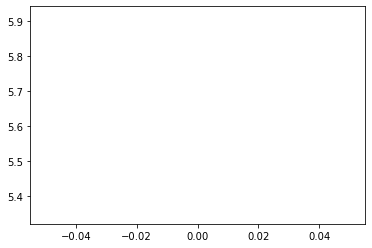

189it [00:02, 147.68it/s]

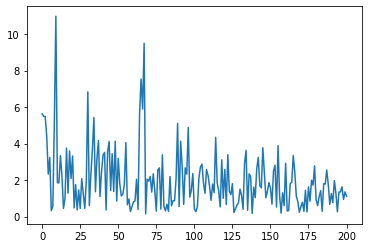

395it [00:03, 152.29it/s]

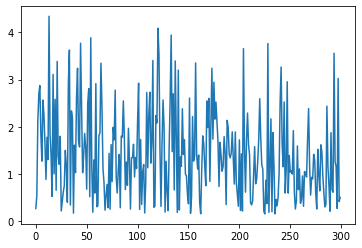

585it [00:05, 154.61it/s]

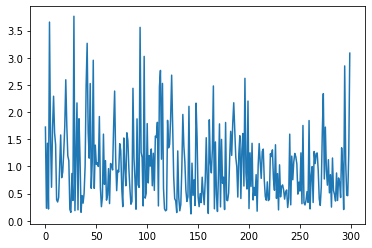

800it [00:06, 149.11it/s]

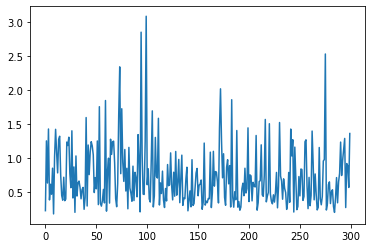

992it [00:08, 154.71it/s]

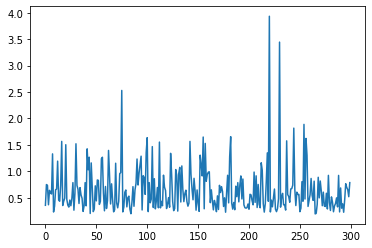

1199it [00:09, 156.58it/s]

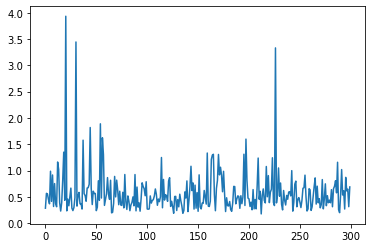

1391it [00:10, 155.02it/s]

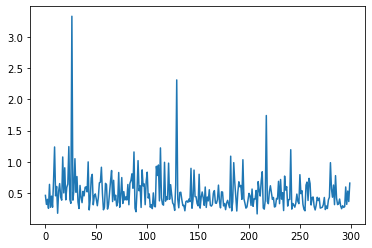

1600it [00:12, 156.46it/s]

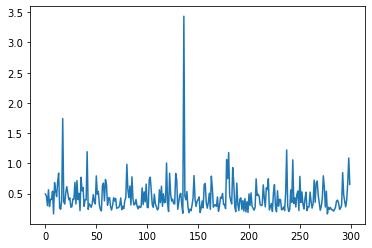

1791it [00:13, 156.23it/s]

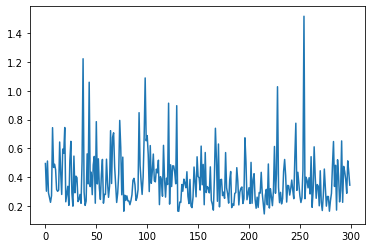

1990it [00:14, 144.80it/s]

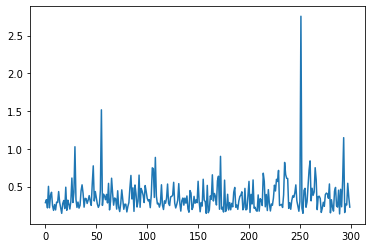

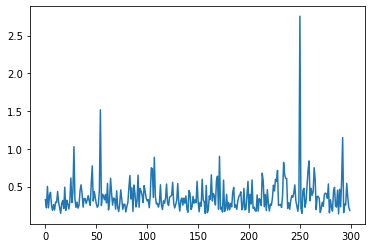

2186it [00:18, 138.81it/s]

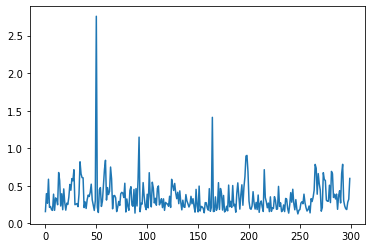

2393it [00:19, 151.56it/s]

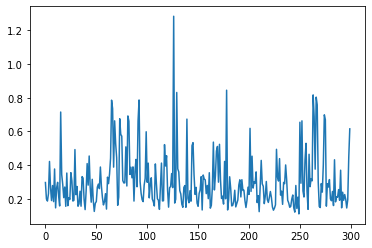

2585it [00:20, 155.40it/s]

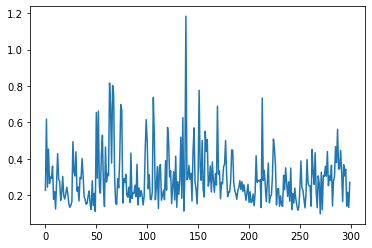

2792it [00:22, 153.08it/s]

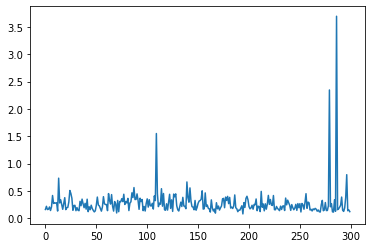

2998it [00:23, 154.32it/s]

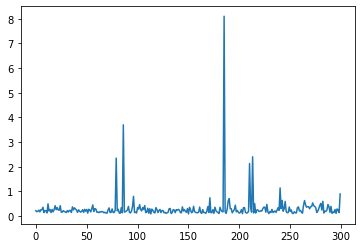

3190it [00:25, 154.73it/s]

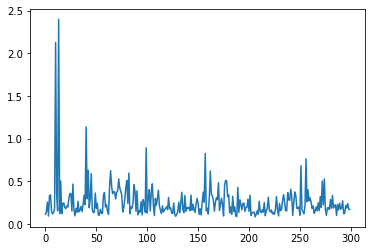

3397it [00:26, 152.06it/s]

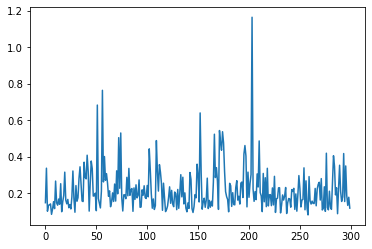

3589it [00:27, 156.24it/s]

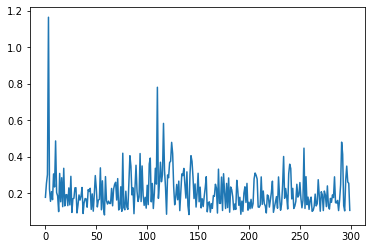

3796it [00:29, 153.32it/s]

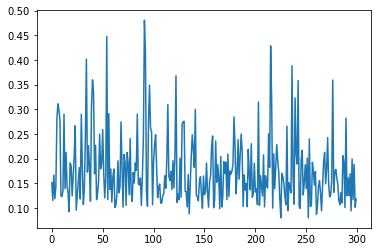

3987it [00:30, 154.05it/s]

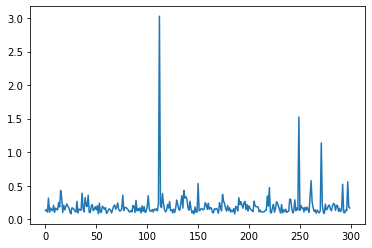

4195it [00:32, 153.72it/s]

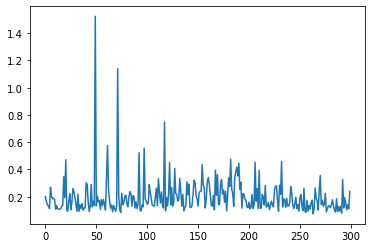

4386it [00:33, 155.67it/s]

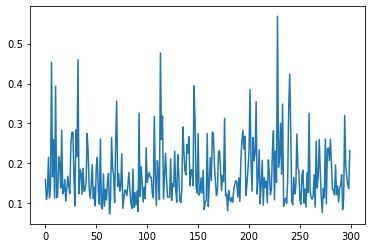

4600it [00:34, 146.67it/s]

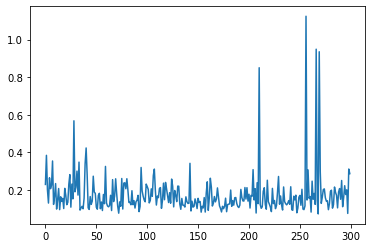

4800it [00:36, 147.48it/s]

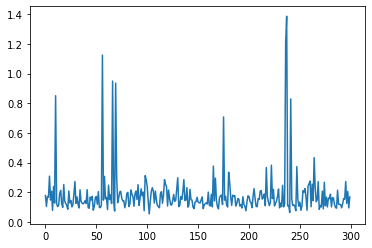

4985it [00:37, 140.49it/s]

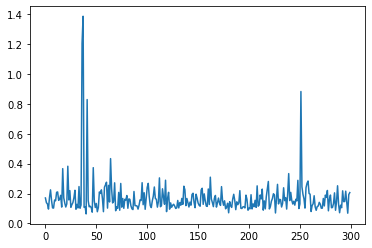

5200it [00:39, 144.75it/s]

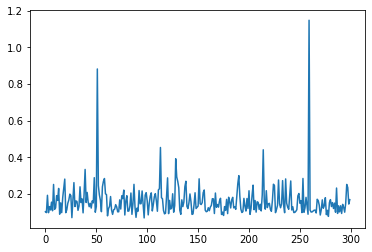

5389it [00:40, 149.58it/s]

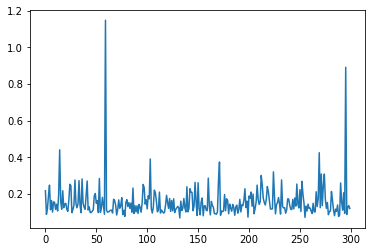

5591it [00:42, 150.34it/s]

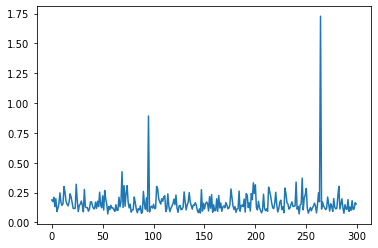

5799it [00:43, 150.55it/s]

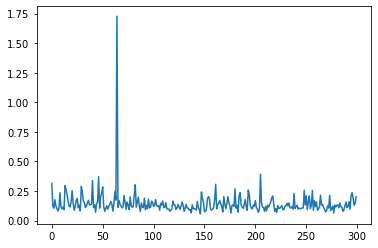

5990it [00:45, 150.14it/s]

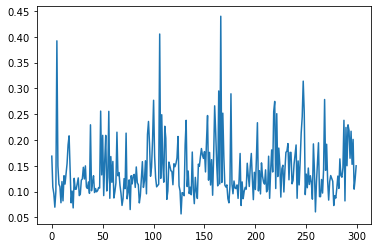

6198it [00:46, 150.82it/s]

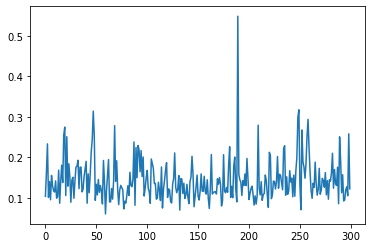

6387it [00:47, 149.49it/s]

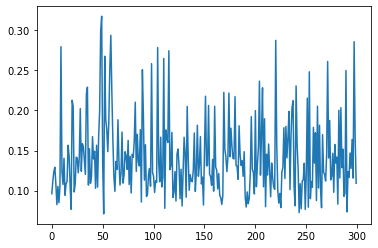

6593it [00:49, 148.38it/s]

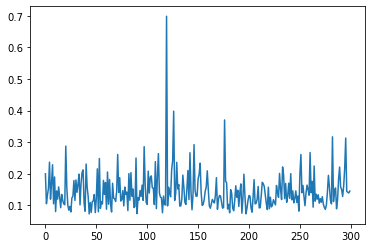

6795it [00:50, 149.11it/s]

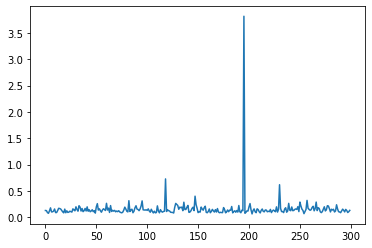

7000it [00:52, 150.57it/s]

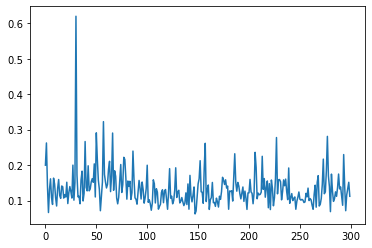

7186it [00:53, 148.43it/s]

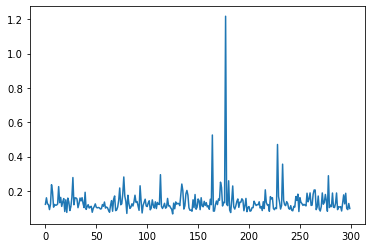

7387it [00:55, 149.19it/s]

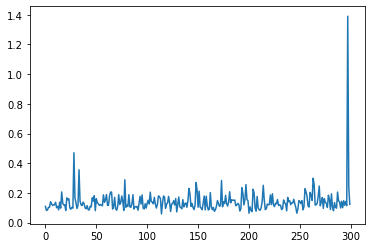

7600it [00:56, 147.46it/s]

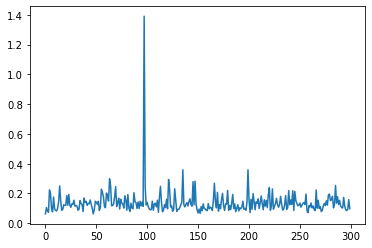

7785it [00:58, 148.92it/s]

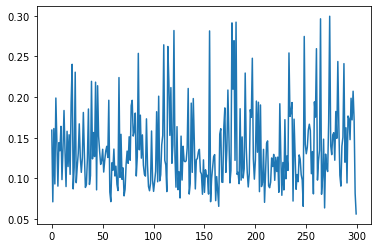

7986it [00:59, 149.24it/s]

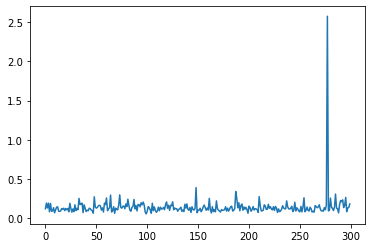

8199it [01:00, 149.14it/s]

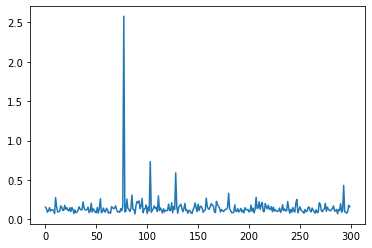

8399it [01:02, 149.19it/s]

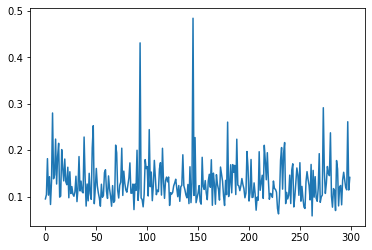

8599it [01:03, 148.52it/s]

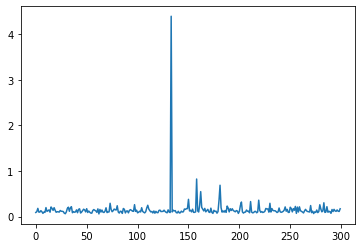

8797it [01:05, 148.39it/s]

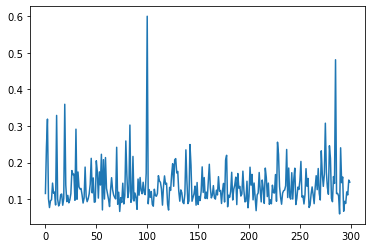

8993it [01:06, 146.75it/s]

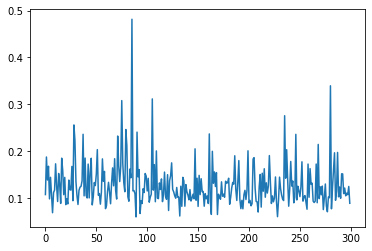

9191it [01:08, 148.83it/s]

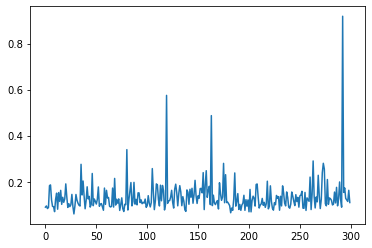

9387it [01:09, 148.38it/s]

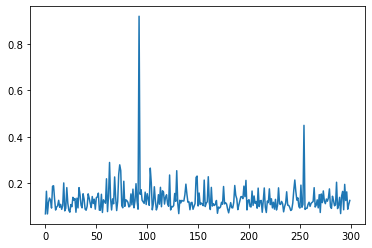

9596it [01:11, 144.37it/s]

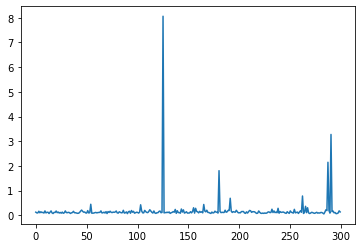

9792it [01:12, 147.69it/s]

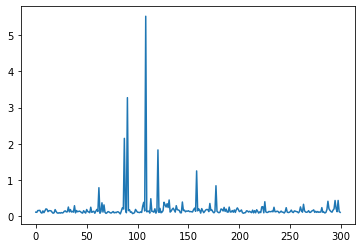

9987it [01:13, 147.19it/s]

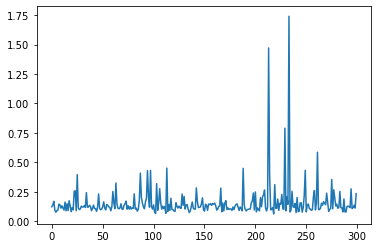

10197it [01:15, 145.48it/s]

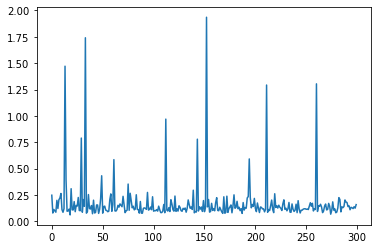

10394it [01:16, 145.65it/s]

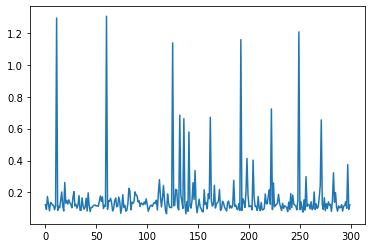

10591it [01:18, 147.68it/s]

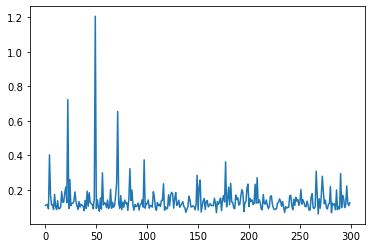

10786it [01:19, 146.73it/s]

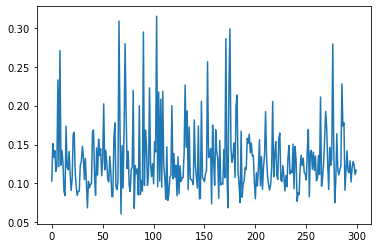

10996it [01:21, 140.23it/s]

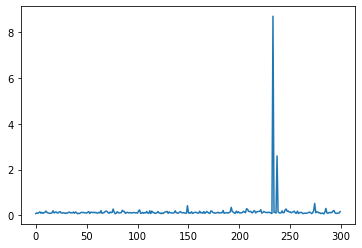

11192it [01:22, 147.49it/s]

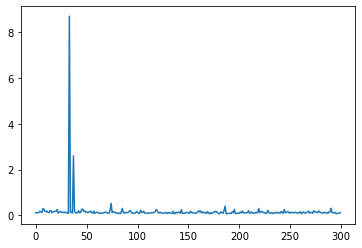

11387it [01:24, 147.13it/s]

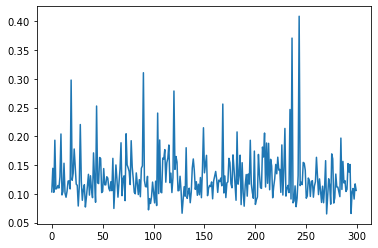

11598it [01:25, 147.07it/s]

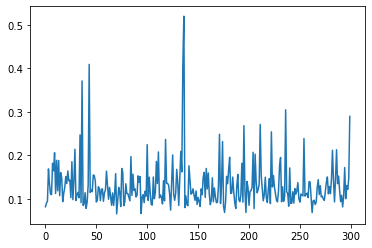

11795it [01:27, 147.01it/s]

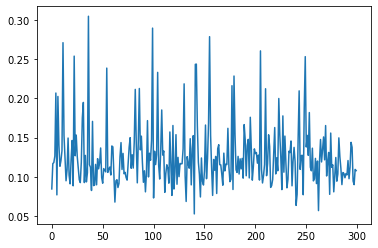

11991it [01:28, 147.61it/s]

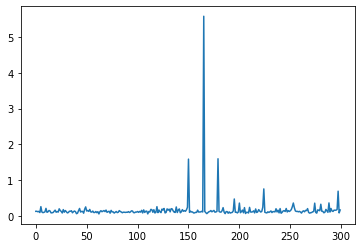

12186it [01:30, 147.09it/s]

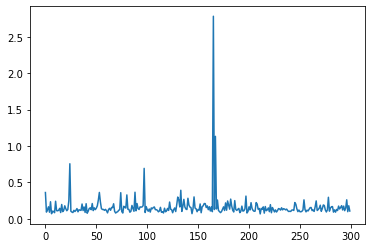

12397it [01:31, 146.85it/s]

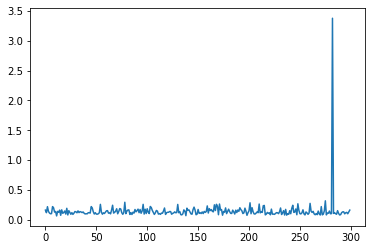

12592it [01:33, 145.93it/s]

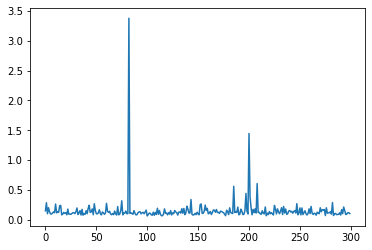

12788it [01:34, 147.23it/s]

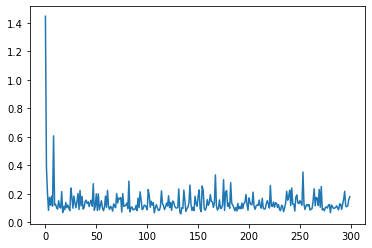

12999it [01:36, 146.31it/s]

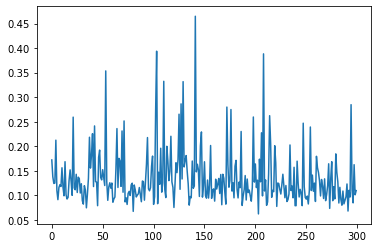

13196it [01:37, 147.29it/s]

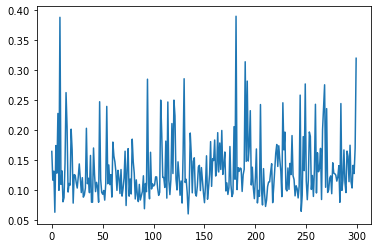

13393it [01:38, 145.41it/s]

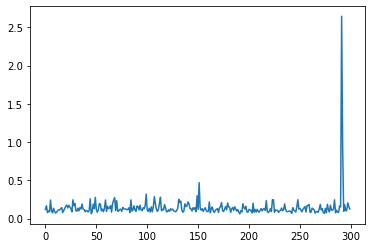

13589it [01:40, 144.30it/s]

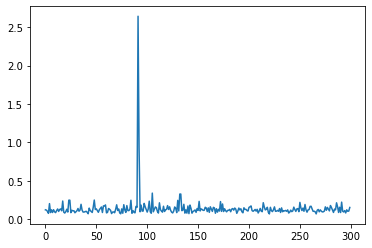

13800it [01:41, 145.45it/s]

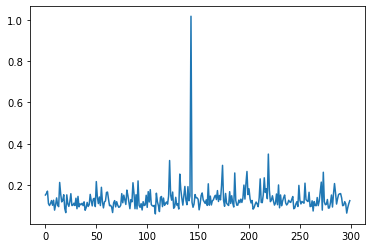

13995it [01:43, 146.77it/s]

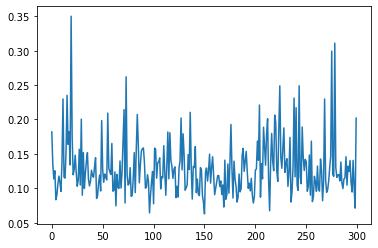

14190it [01:44, 144.99it/s]

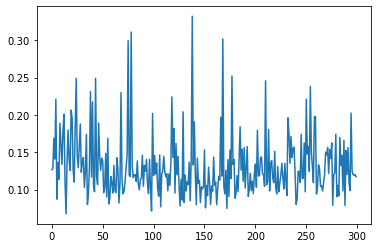

14398it [01:46, 138.61it/s]

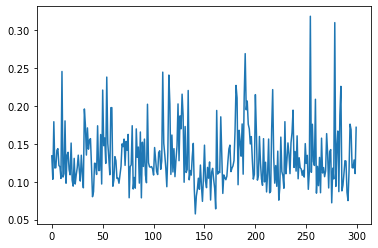

14590it [01:47, 145.20it/s]

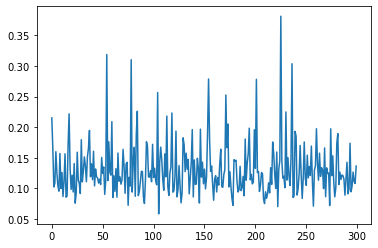

14786it [01:49, 140.35it/s]

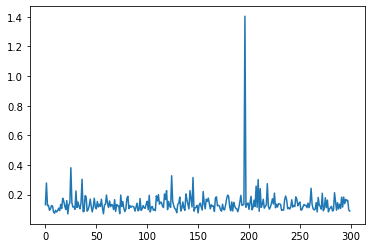

14995it [01:51, 142.64it/s]

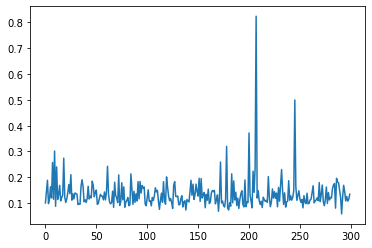

15189it [01:52, 138.14it/s]

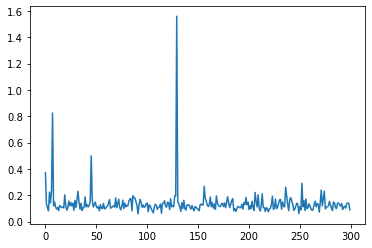

15398it [01:54, 141.66it/s]

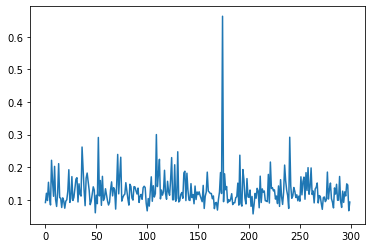

15593it [01:55, 145.21it/s]

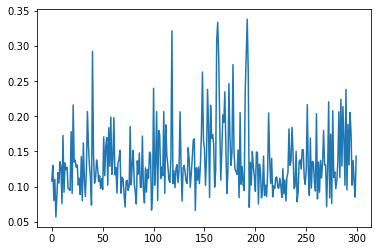

15788it [01:56, 138.76it/s]

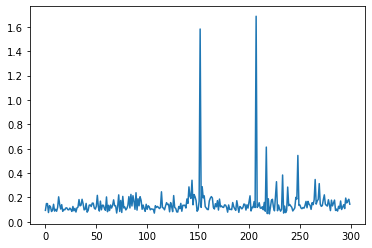

15996it [01:58, 143.48it/s]

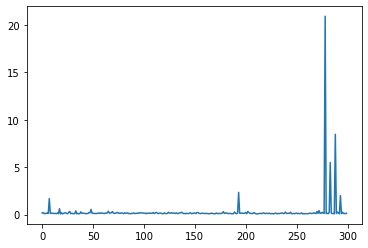

16191it [01:59, 146.68it/s]

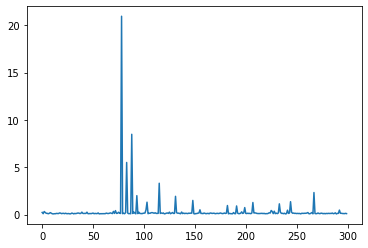

16386it [02:01, 141.41it/s]

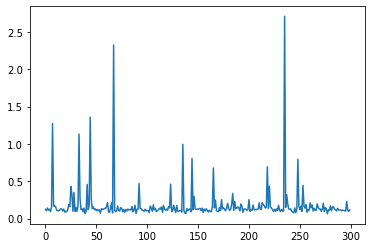

16596it [02:02, 147.09it/s]

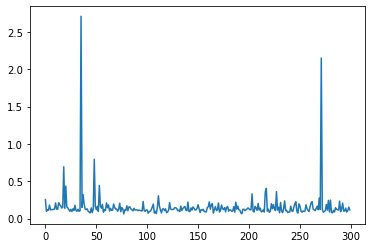

16791it [02:04, 142.04it/s]

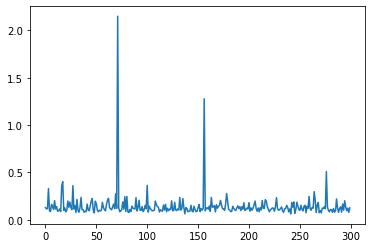

17000it [02:05, 145.50it/s]

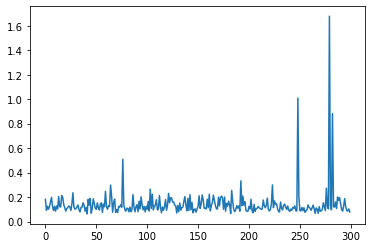

17195it [02:07, 141.06it/s]

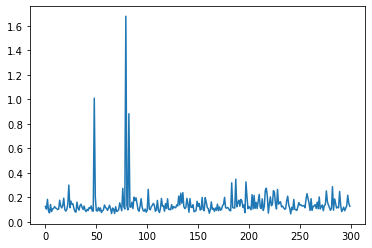

17390it [02:08, 146.53it/s]

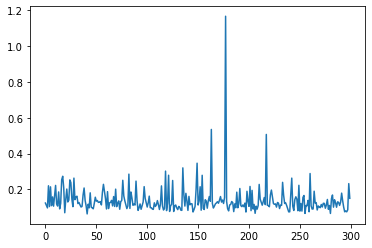

17600it [02:10, 145.85it/s]

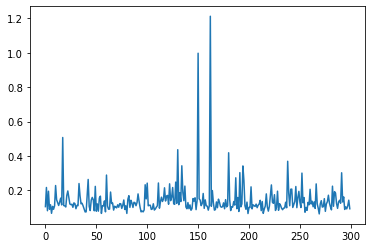

17795it [02:11, 146.16it/s]

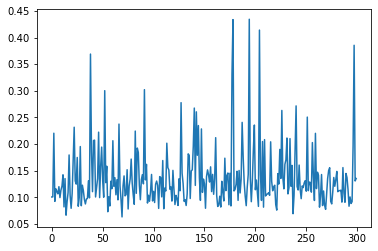

17990it [02:13, 142.61it/s]

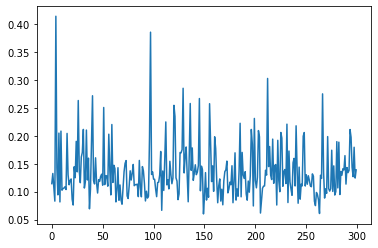

18200it [02:14, 143.30it/s]

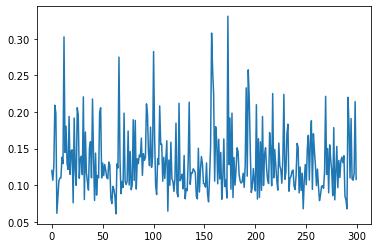

18394it [02:16, 142.45it/s]

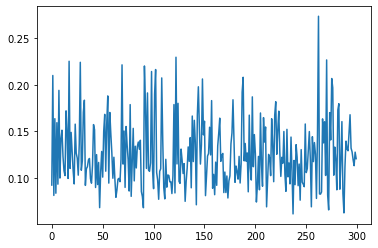

18597it [02:17, 136.03it/s]

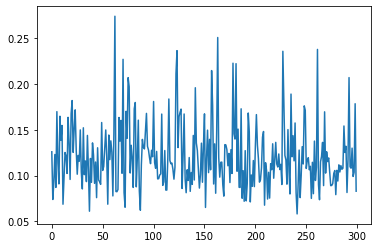

18791it [02:19, 144.94it/s]

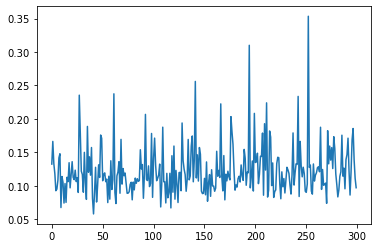

18986it [02:20, 141.67it/s]

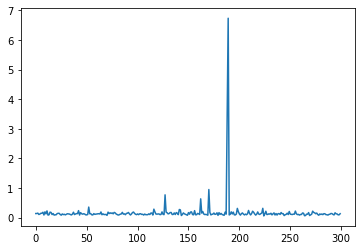

19193it [02:22, 139.63it/s]

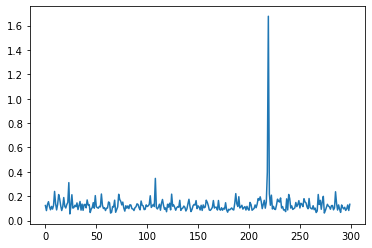

19386it [02:24, 142.95it/s]

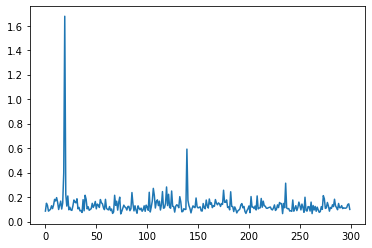

19595it [02:25, 143.92it/s]

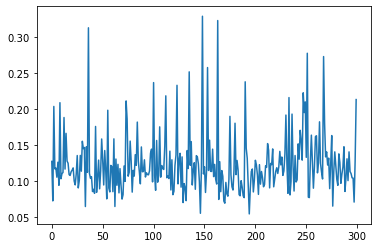

19790it [02:27, 145.60it/s]

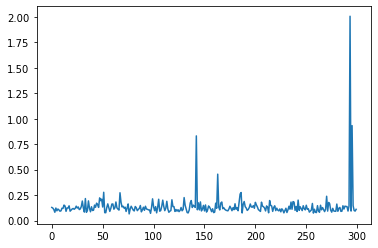

19998it [02:28, 136.92it/s]

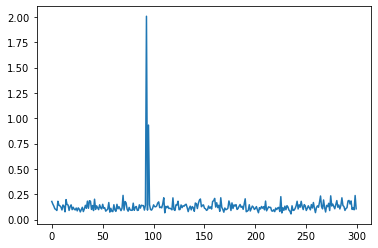

20192it [02:30, 141.21it/s]

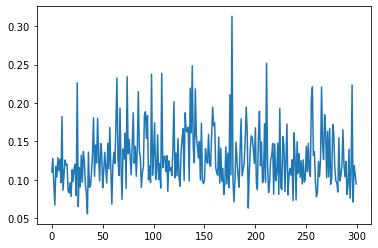

20387it [02:31, 144.15it/s]

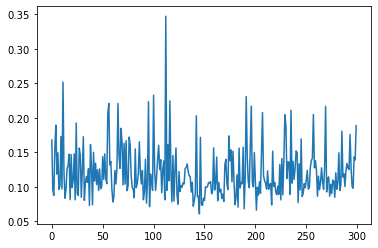

20594it [02:33, 140.04it/s]

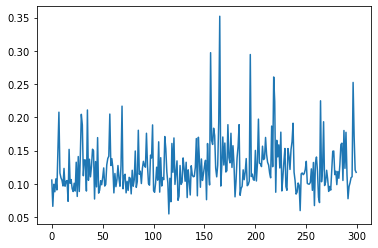

20788it [02:34, 140.60it/s]

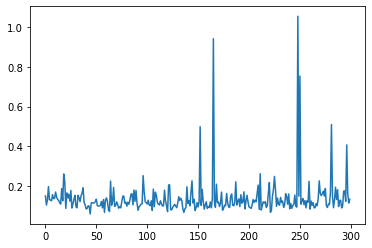

20997it [02:36, 140.15it/s]

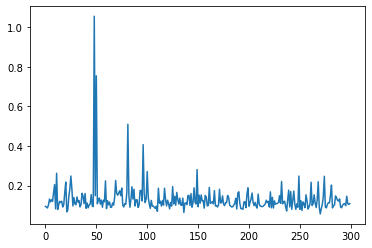

21191it [02:37, 142.79it/s]

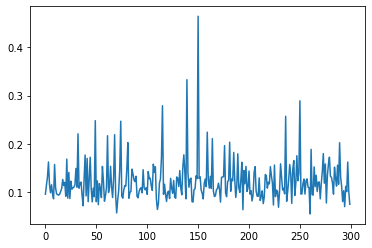

21386it [02:39, 141.71it/s]

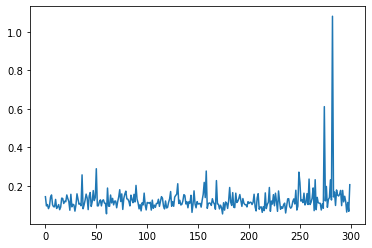

21594it [02:40, 140.20it/s]

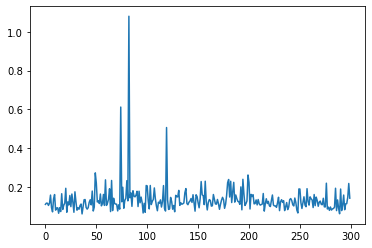

21788it [02:42, 144.49it/s]

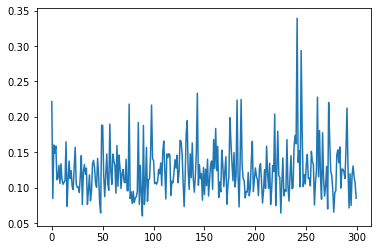

21995it [02:43, 144.75it/s]

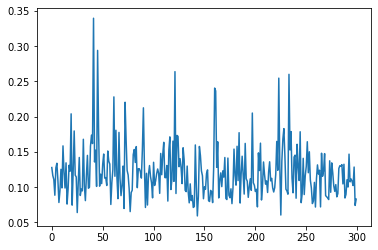

22190it [02:45, 144.83it/s]

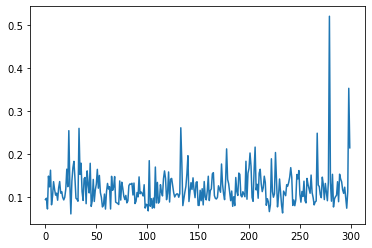

22400it [02:46, 145.15it/s]

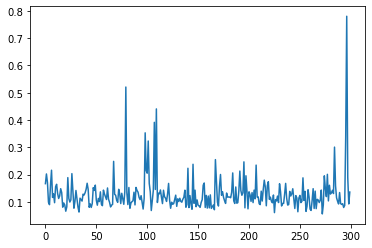

22595it [02:48, 145.08it/s]

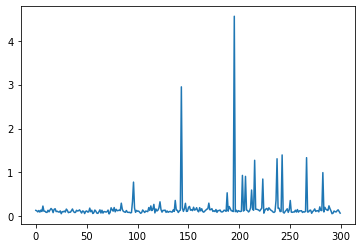

22790it [02:49, 144.69it/s]

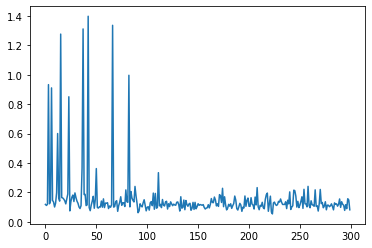

23000it [02:51, 145.91it/s]

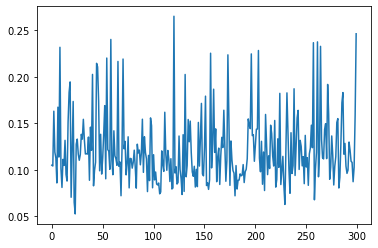

23195it [02:52, 144.30it/s]

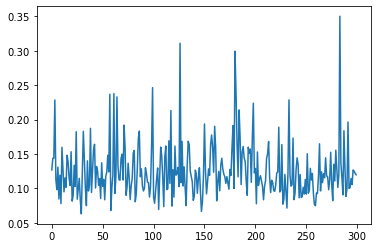

23390it [02:54, 145.69it/s]

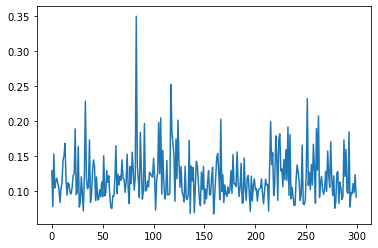

23600it [02:55, 145.30it/s]

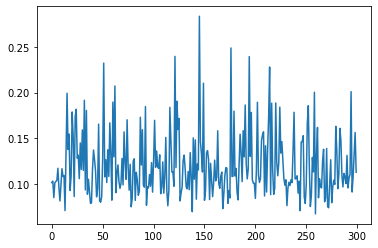

23795it [02:57, 145.97it/s]

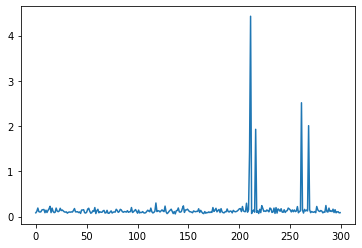

23989it [02:58, 144.68it/s]

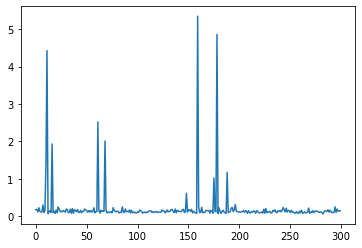

24199it [03:00, 144.67it/s]

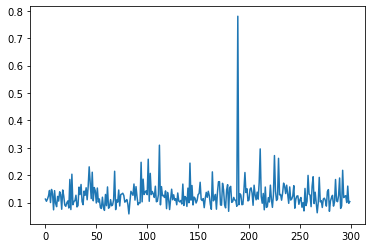

24394it [03:01, 145.40it/s]

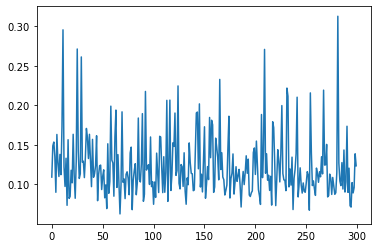

24589it [03:02, 145.08it/s]

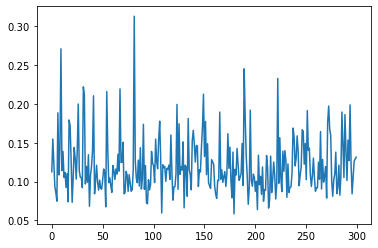

24799it [03:04, 144.90it/s]

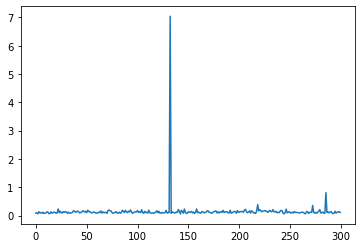

24994it [03:05, 143.65it/s]

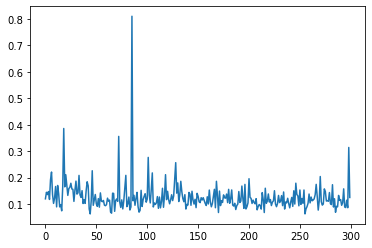

25189it [03:07, 143.91it/s]

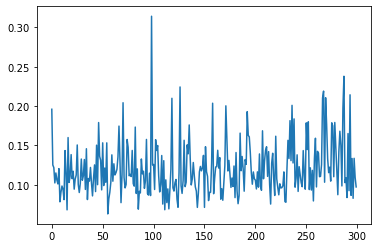

25399it [03:08, 145.83it/s]

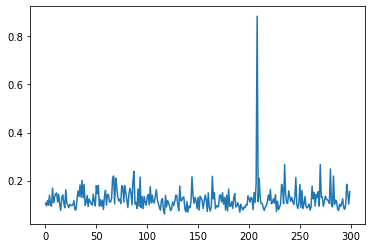

25594it [03:10, 143.32it/s]

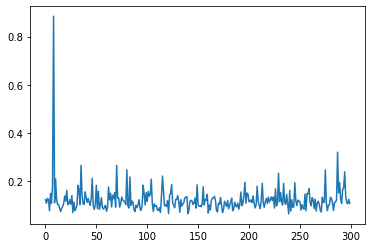

25789it [03:11, 145.30it/s]

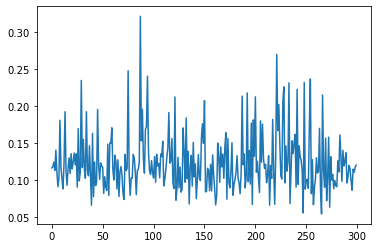

25999it [03:13, 144.71it/s]

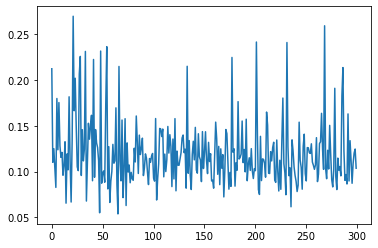

26194it [03:14, 144.92it/s]

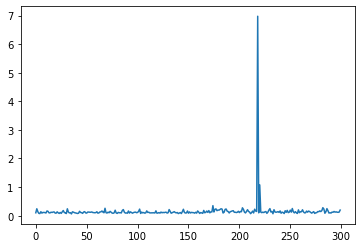

26389it [03:16, 143.52it/s]

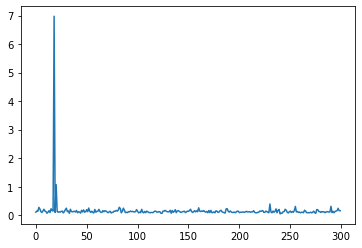

26599it [03:17, 144.76it/s]

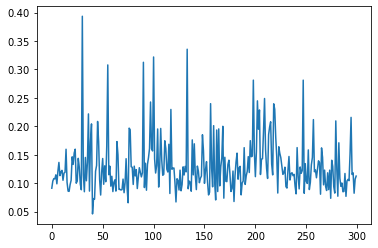

26793it [03:19, 137.75it/s]

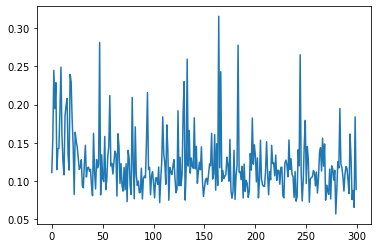

26986it [03:20, 144.14it/s]

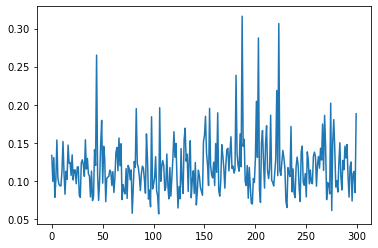

27196it [03:22, 143.90it/s]

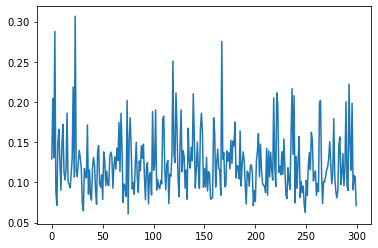

27391it [03:23, 144.30it/s]

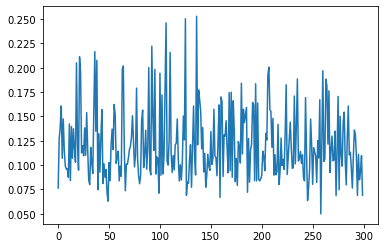

27586it [03:25, 143.88it/s]

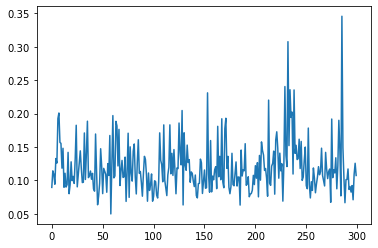

27796it [03:26, 145.35it/s]

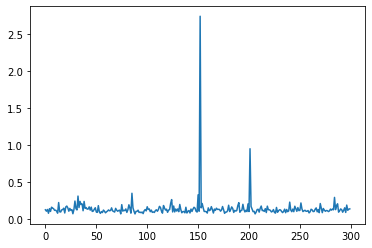

27989it [03:28, 143.06it/s]

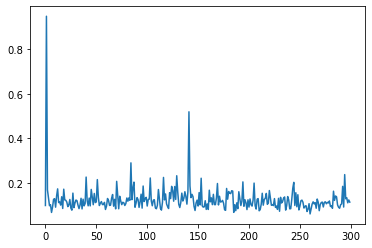

28199it [03:29, 145.31it/s]

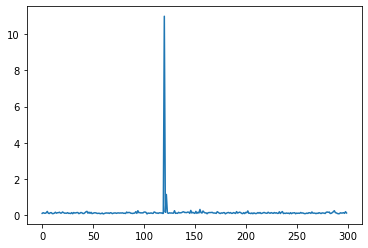

28394it [03:31, 144.63it/s]

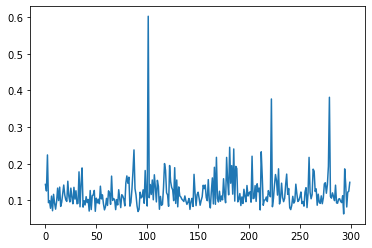

28589it [03:32, 145.51it/s]

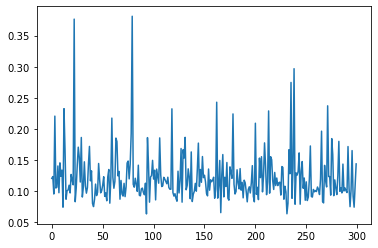

28799it [03:34, 143.50it/s]

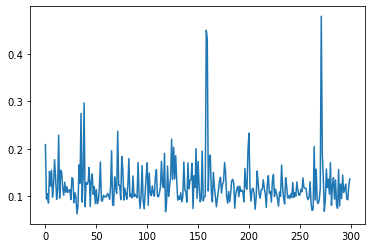

28994it [03:35, 145.25it/s]

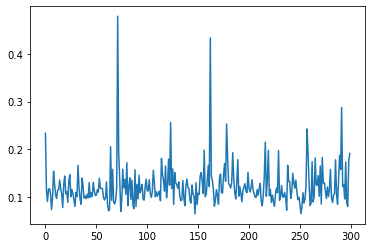

29189it [03:37, 144.62it/s]

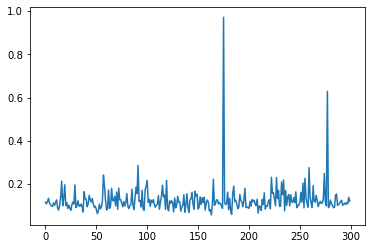

29399it [03:38, 145.01it/s]

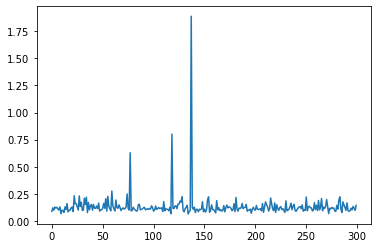

29594it [03:40, 144.24it/s]

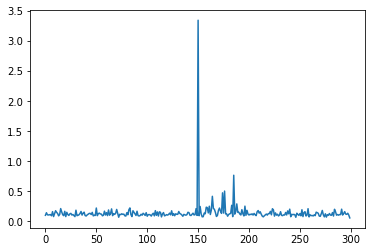

29789it [03:41, 145.14it/s]

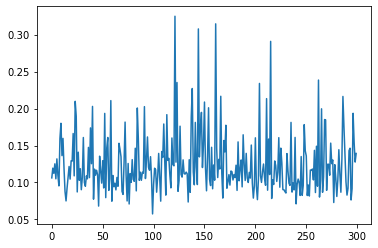

29999it [03:43, 144.63it/s]

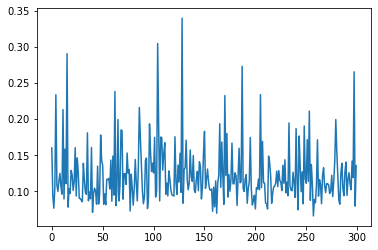

30194it [03:44, 144.82it/s]

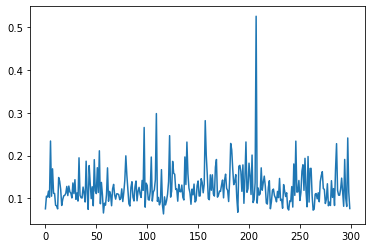

30389it [03:46, 145.27it/s]

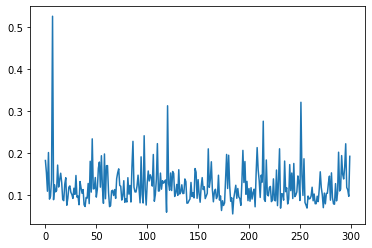

30599it [03:47, 144.35it/s]

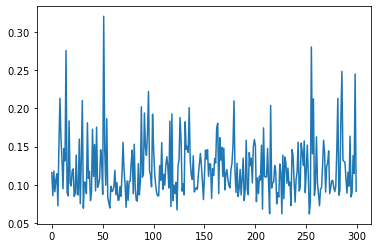

30794it [03:49, 145.57it/s]

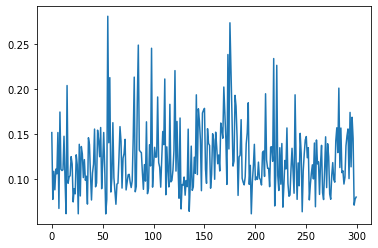

30989it [03:50, 144.86it/s]

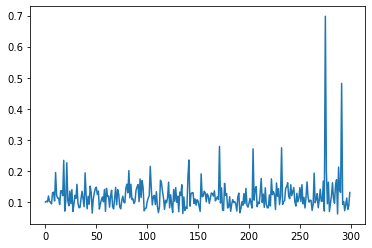

31199it [03:52, 145.11it/s]

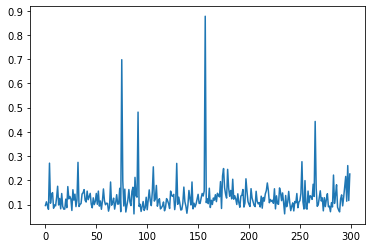

31394it [03:53, 144.64it/s]

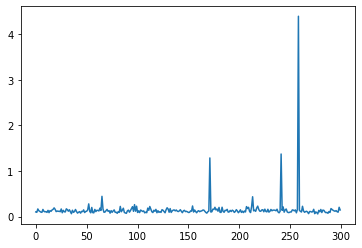

31589it [03:55, 145.63it/s]

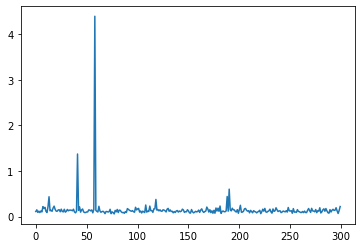

31799it [03:56, 145.12it/s]

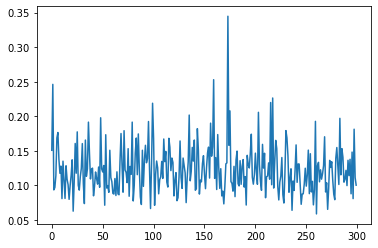

31994it [03:58, 145.25it/s]

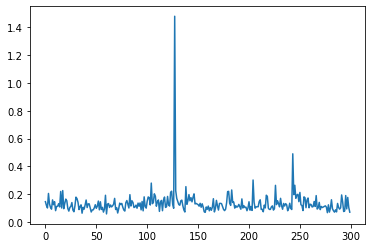

32189it [03:59, 144.47it/s]

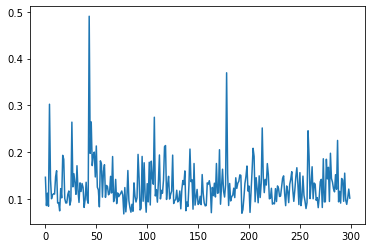

32399it [04:01, 144.89it/s]

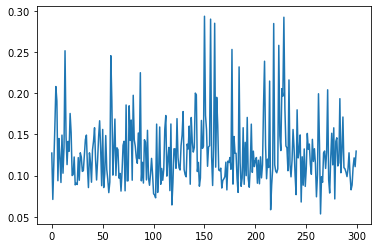

32594it [04:02, 144.90it/s]

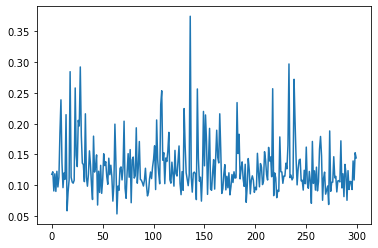

32789it [04:03, 144.76it/s]

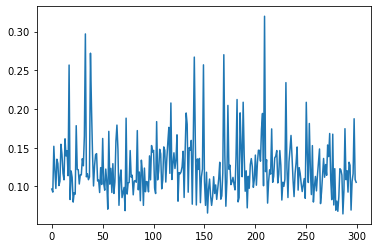

32999it [04:05, 144.95it/s]

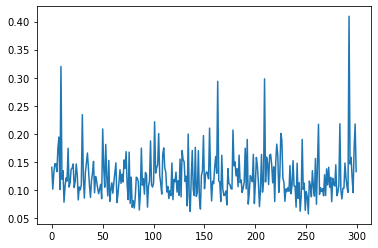

33194it [04:06, 145.14it/s]

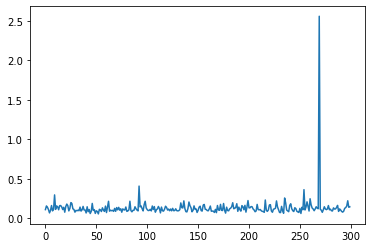

33387it [04:08, 144.99it/s]

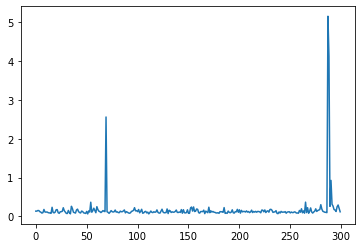

33597it [04:09, 145.08it/s]

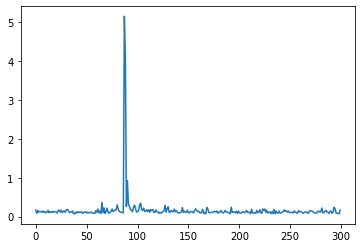

33791it [04:11, 145.25it/s]

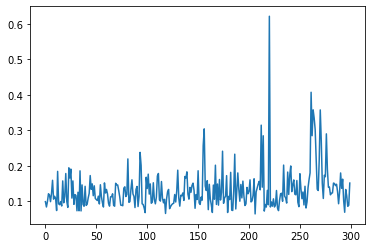

33986it [04:12, 145.16it/s]

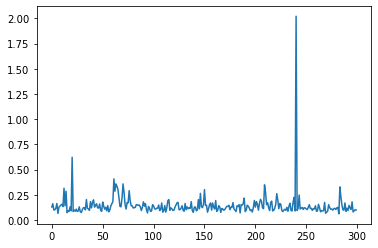

34195it [04:14, 144.93it/s]

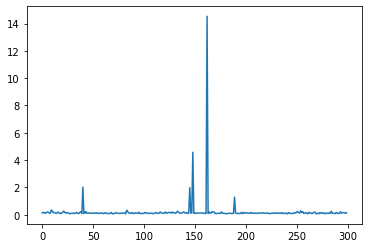

34390it [04:15, 144.91it/s]

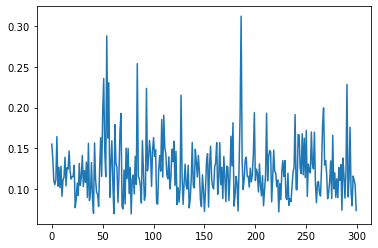

34599it [04:17, 145.53it/s]

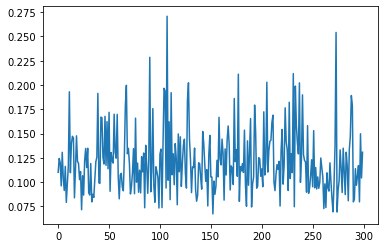

34794it [04:18, 144.39it/s]

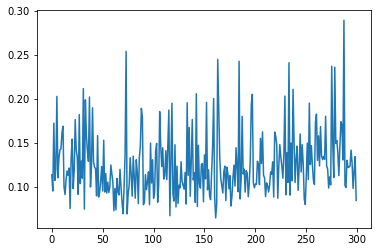

34988it [04:20, 144.79it/s]

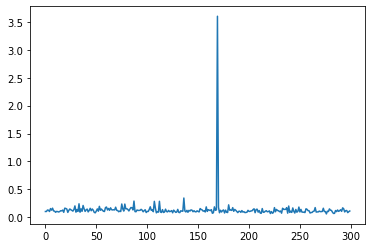

35198it [04:21, 144.46it/s]

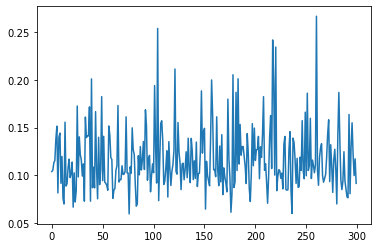

35399it [04:23, 139.42it/s]

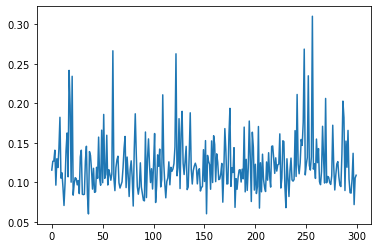

35593it [04:24, 143.76it/s]

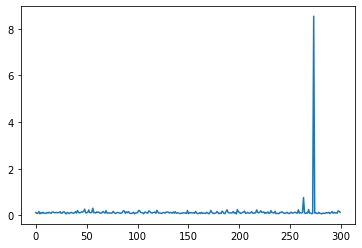

35787it [04:26, 143.67it/s]

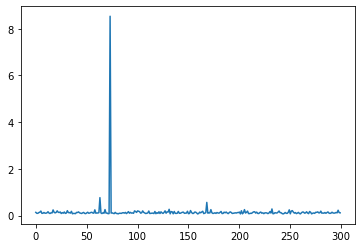

35997it [04:27, 144.27it/s]

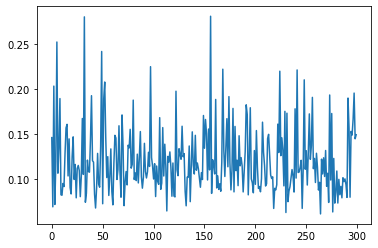

36190it [04:29, 144.37it/s]

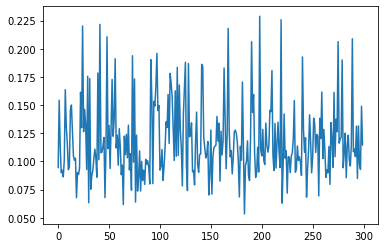

36400it [04:30, 144.58it/s]

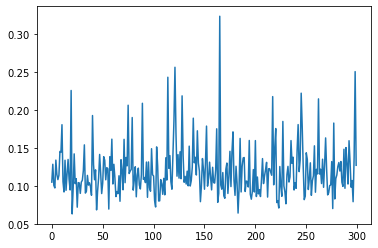

36594it [04:32, 144.56it/s]

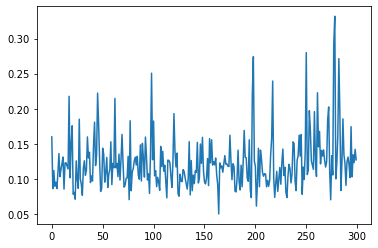

36789it [04:33, 144.16it/s]

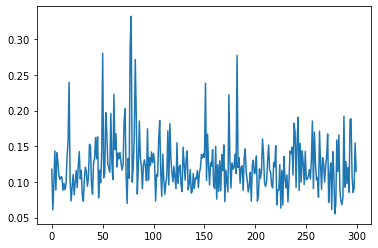

36994it [04:35, 136.81it/s]

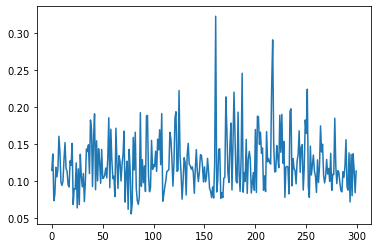

37187it [04:36, 142.58it/s]

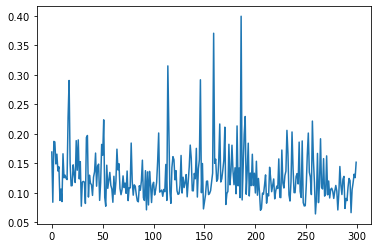

37393it [04:38, 134.98it/s]

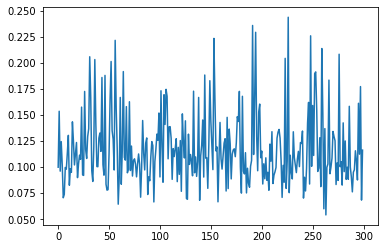

37599it [04:40, 144.27it/s]

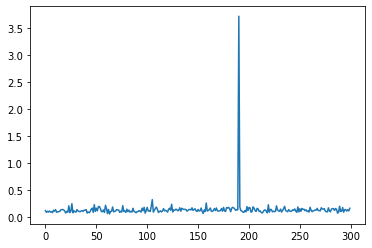

37794it [04:41, 144.53it/s]

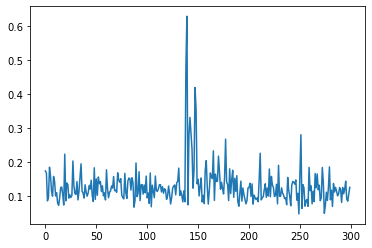

37989it [04:42, 143.71it/s]

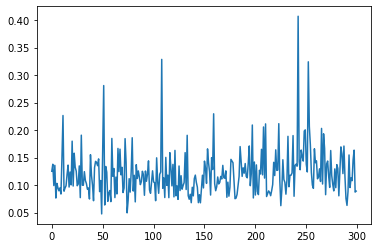

38199it [04:44, 143.54it/s]

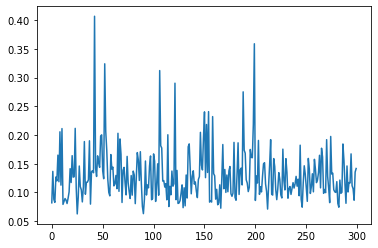

38393it [04:45, 144.31it/s]

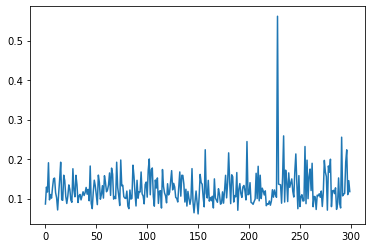

38587it [04:47, 144.15it/s]

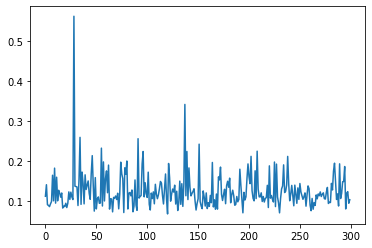

38797it [04:48, 144.50it/s]

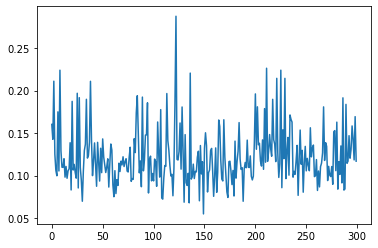

38992it [04:50, 144.36it/s]

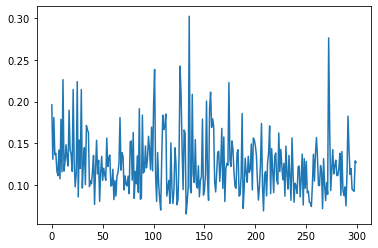

39187it [04:51, 143.98it/s]

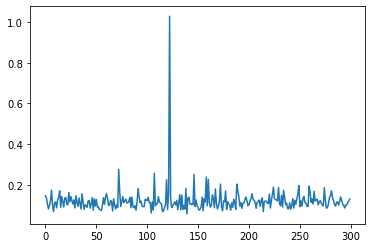

39397it [04:53, 143.74it/s]

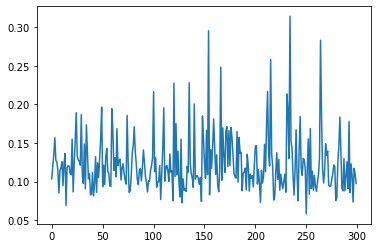

39592it [04:54, 144.55it/s]

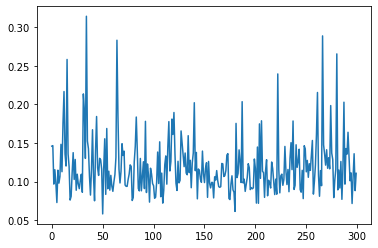

39787it [04:56, 144.07it/s]

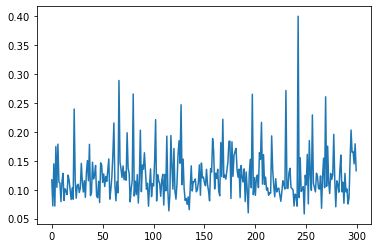

39997it [04:58, 143.33it/s]

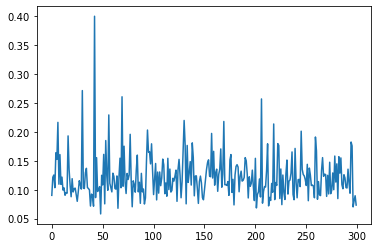

40192it [04:59, 144.24it/s]

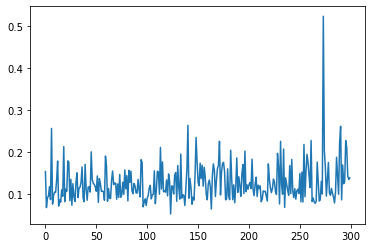

40387it [05:00, 143.94it/s]

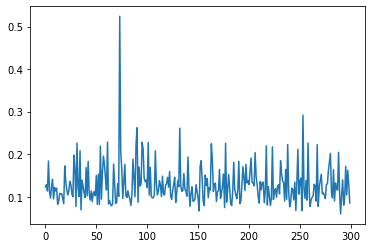

40597it [05:02, 144.69it/s]

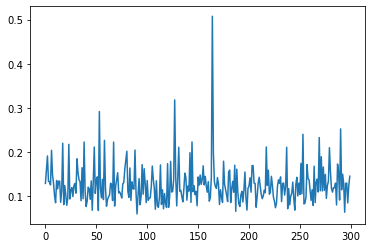

40792it [05:03, 144.59it/s]

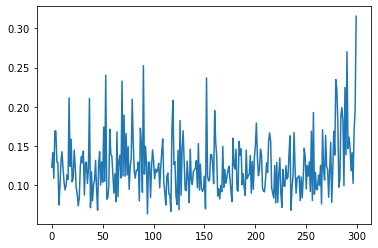

40987it [05:05, 143.49it/s]

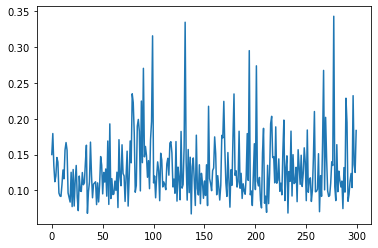

41197it [05:06, 145.23it/s]

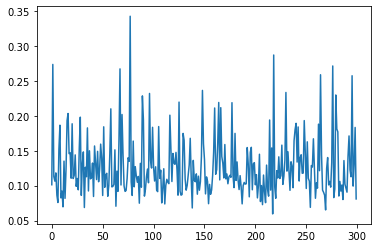

41392it [05:08, 143.64it/s]

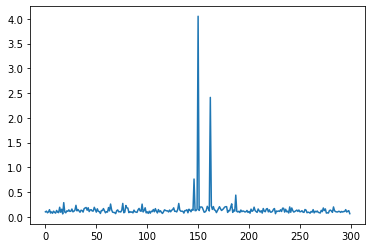

41587it [05:09, 144.82it/s]

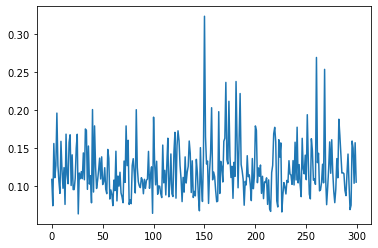

41796it [05:11, 144.52it/s]

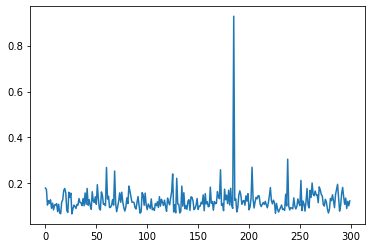

41991it [05:12, 144.76it/s]

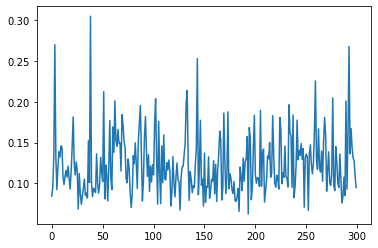

42186it [05:14, 143.28it/s]

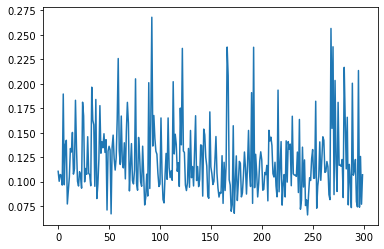

42396it [05:15, 144.41it/s]

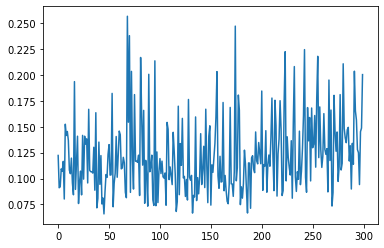

42591it [05:17, 141.21it/s]

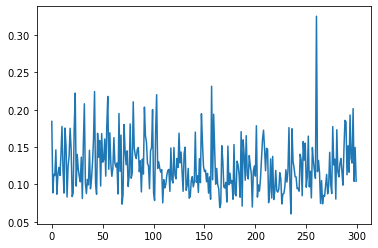

42786it [05:18, 144.88it/s]

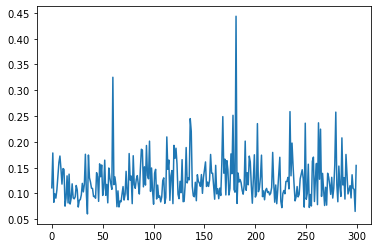

42986it [05:20, 140.76it/s]

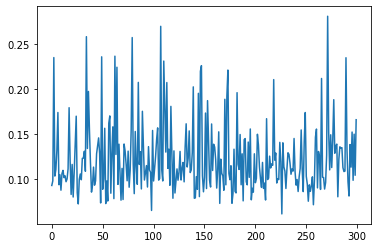

43196it [05:22, 143.34it/s]

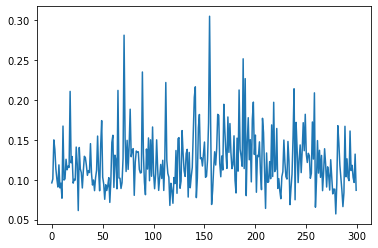

43391it [05:23, 141.87it/s]

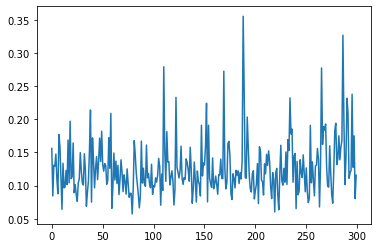

43586it [05:24, 143.84it/s]

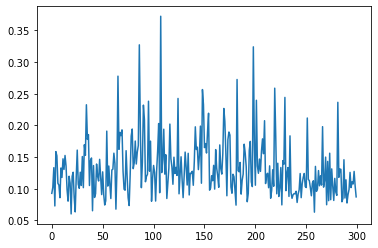

43795it [05:26, 143.74it/s]

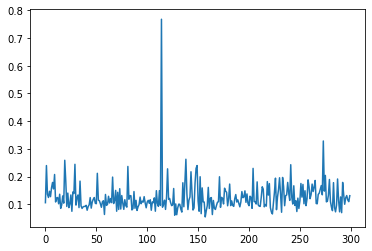

43989it [05:27, 138.44it/s]

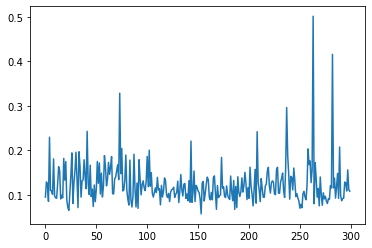

44198it [05:29, 143.39it/s]

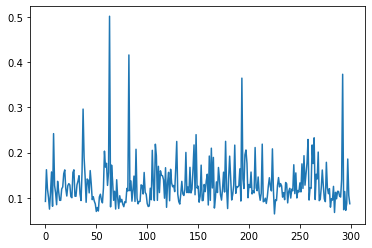

44393it [05:31, 144.28it/s]

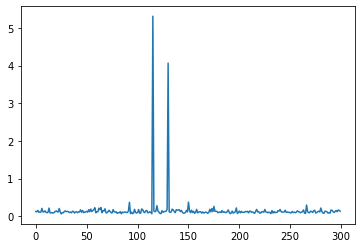

44588it [05:32, 142.71it/s]

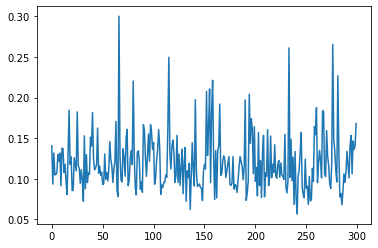

44798it [05:34, 145.07it/s]

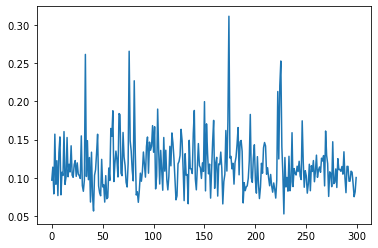

44993it [05:35, 142.69it/s]

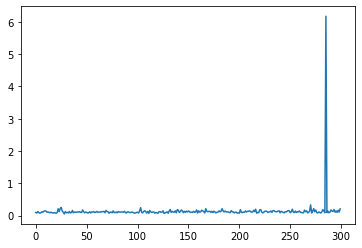

45188it [05:37, 144.18it/s]

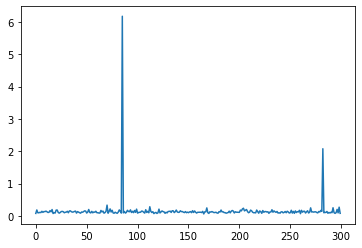

45398it [05:38, 143.02it/s]

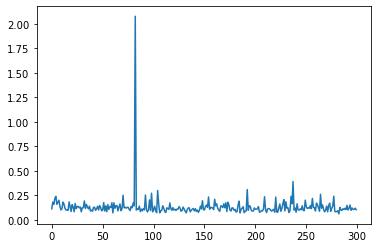

45593it [05:40, 140.33it/s]

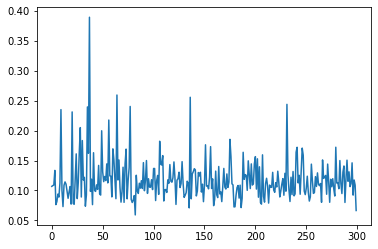

45788it [05:41, 135.13it/s]

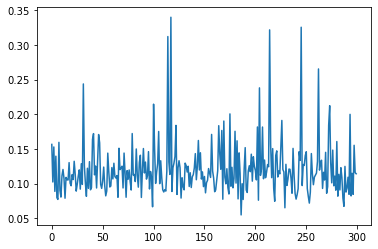

45991it [05:43, 128.61it/s]

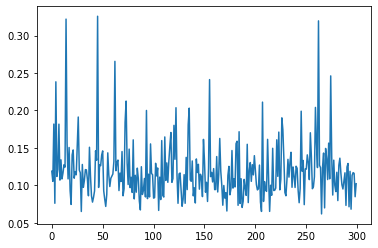

46186it [05:44, 132.50it/s]

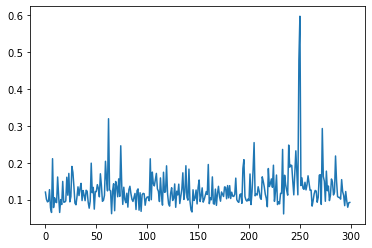

46395it [05:46, 143.72it/s]

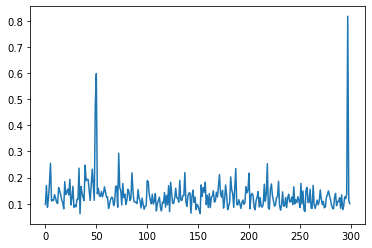

46590it [05:47, 142.82it/s]

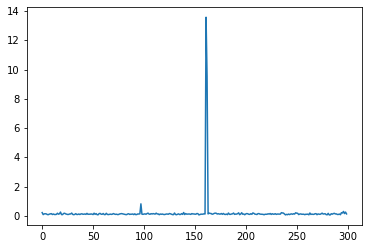

46800it [05:49, 142.08it/s]

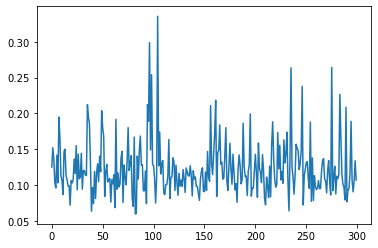

46995it [05:50, 142.60it/s]

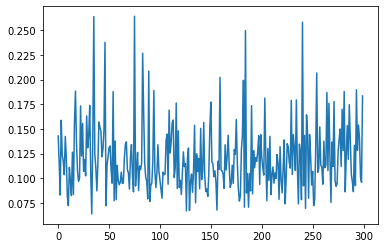

47190it [05:52, 143.34it/s]

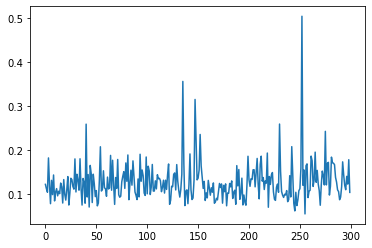

47400it [05:53, 143.35it/s]

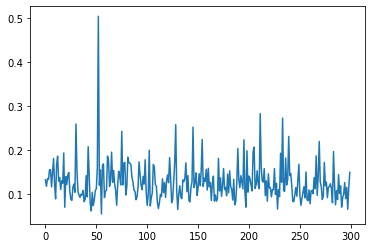

47595it [05:55, 143.99it/s]

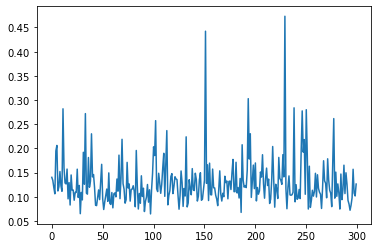

47790it [05:56, 143.35it/s]

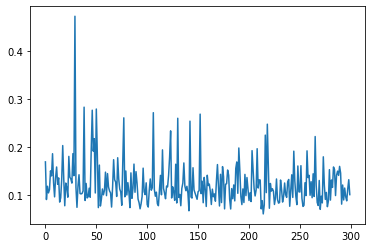

48000it [05:58, 143.31it/s]

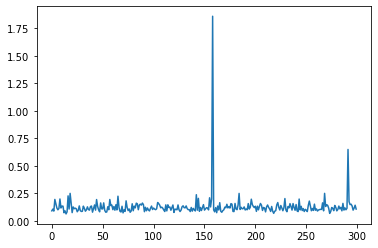

48195it [05:59, 143.24it/s]

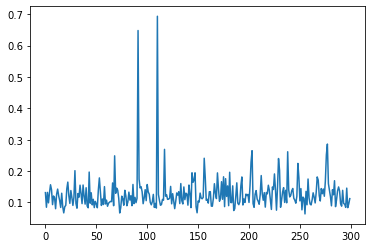

48390it [06:01, 143.39it/s]

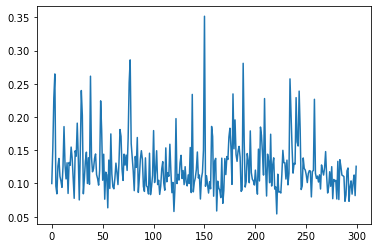

48600it [06:03, 143.62it/s]

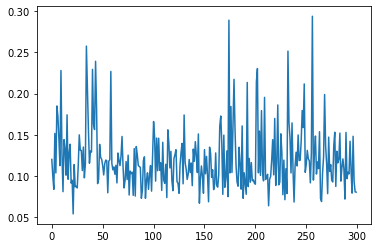

48795it [06:04, 144.16it/s]

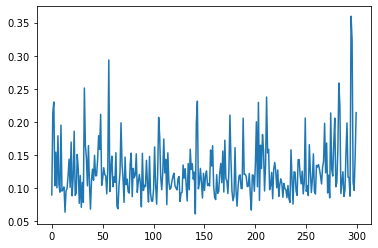

48990it [06:05, 143.89it/s]

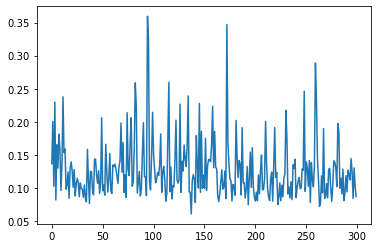

49200it [06:07, 144.03it/s]

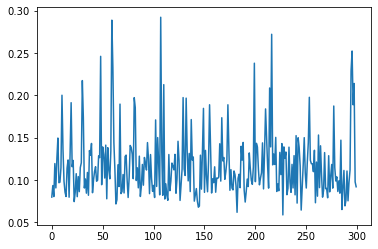

49395it [06:08, 143.84it/s]

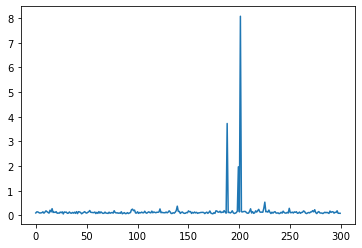

49590it [06:10, 144.43it/s]

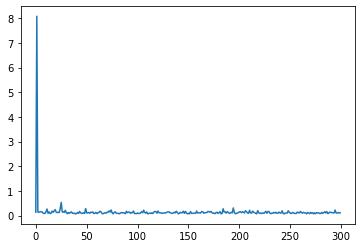

49800it [06:12, 143.26it/s]

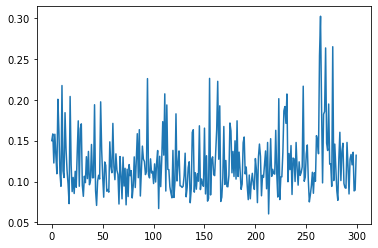

49995it [06:13, 144.70it/s]

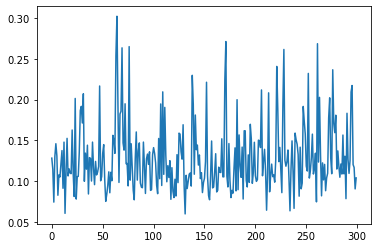

50190it [06:14, 144.34it/s]

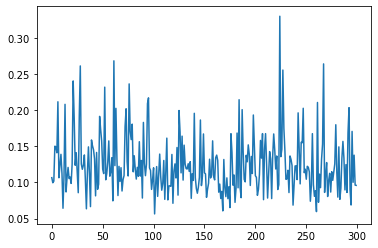

50400it [06:16, 144.30it/s]

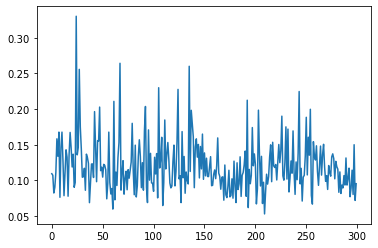

50595it [06:17, 143.71it/s]

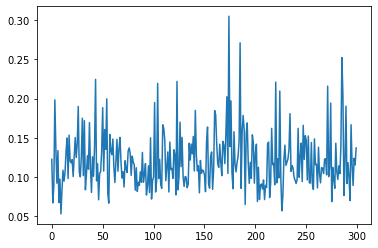

50790it [06:19, 144.25it/s]

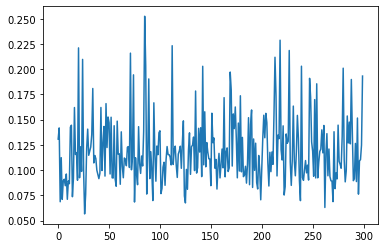

51000it [06:20, 143.96it/s]

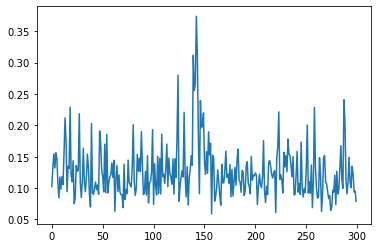

51195it [06:22, 144.62it/s]

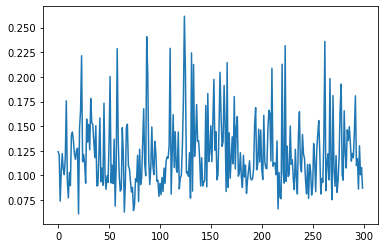

51390it [06:23, 143.63it/s]

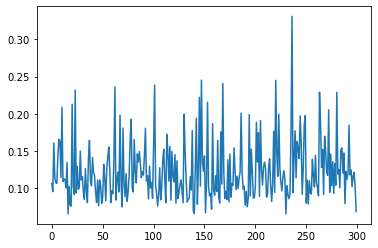

51600it [06:25, 144.48it/s]

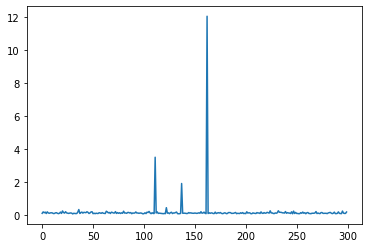

51795it [06:26, 142.94it/s]

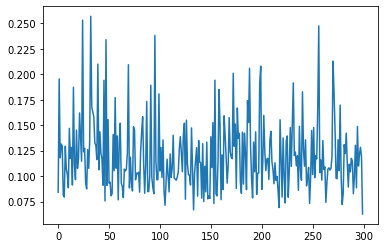

51990it [06:28, 142.24it/s]

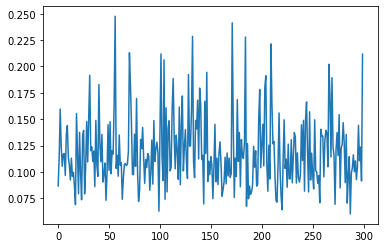

52200it [06:29, 143.12it/s]

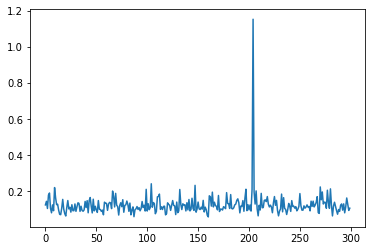

52395it [06:31, 144.09it/s]

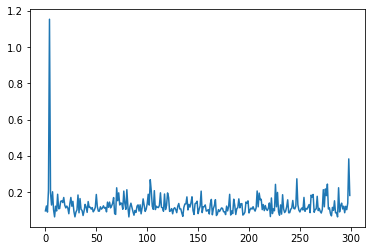

52590it [06:32, 143.00it/s]

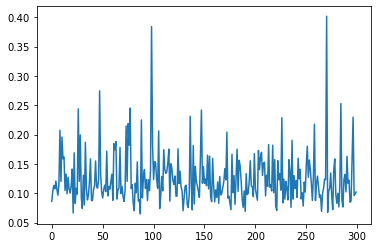

52800it [06:34, 144.46it/s]

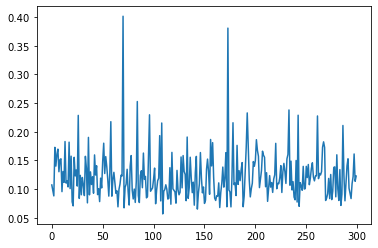

52995it [06:35, 143.89it/s]

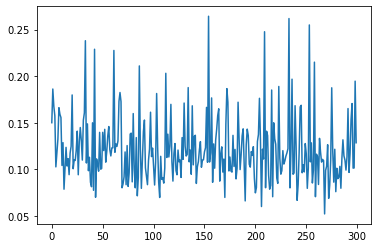

53190it [06:37, 144.32it/s]

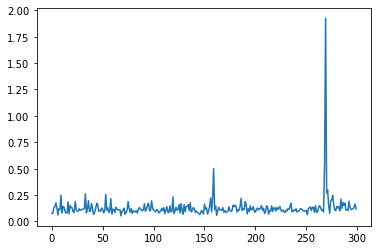

53400it [06:38, 137.45it/s]

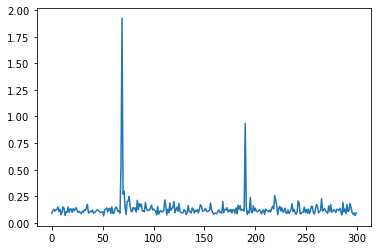

53594it [06:40, 144.29it/s]

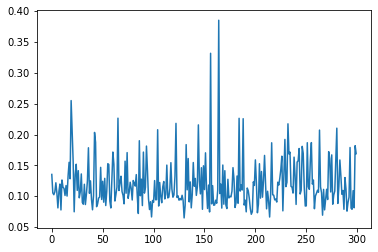

53789it [06:41, 143.54it/s]

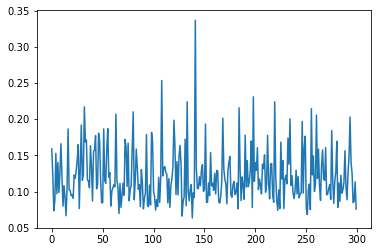

53999it [06:43, 144.65it/s]

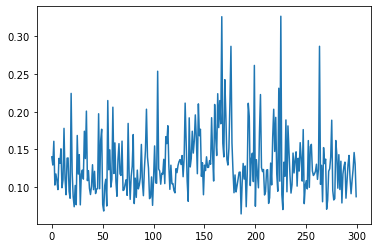

54194it [06:44, 143.64it/s]

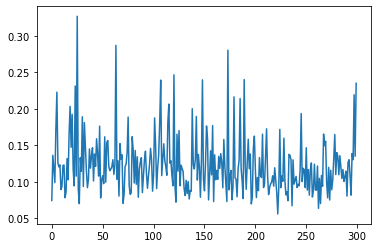

54388it [06:46, 144.28it/s]

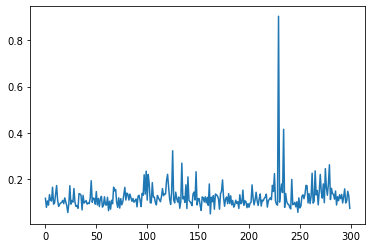

54598it [06:47, 142.89it/s]

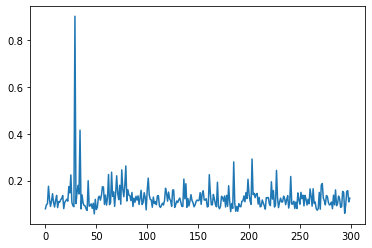

54793it [06:49, 144.21it/s]

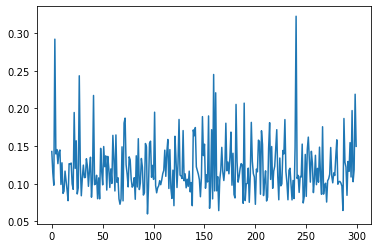

54988it [06:50, 143.93it/s]

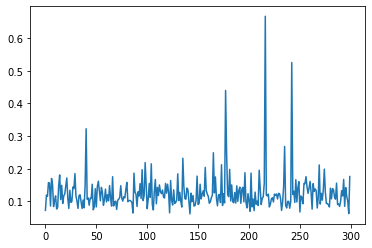

55198it [06:52, 143.55it/s]

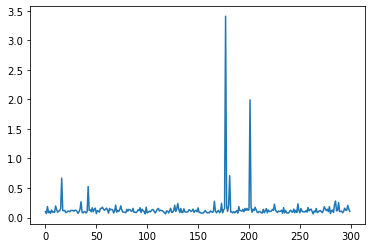

55390it [06:53, 142.82it/s]

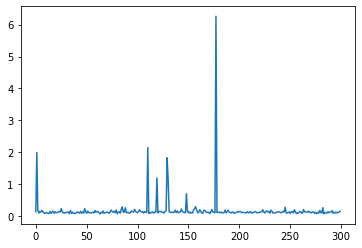

55600it [06:55, 144.76it/s]

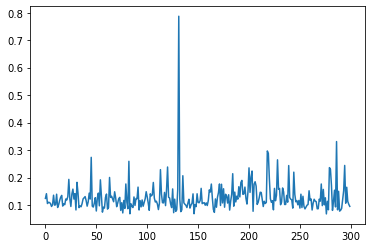

55795it [06:56, 143.55it/s]

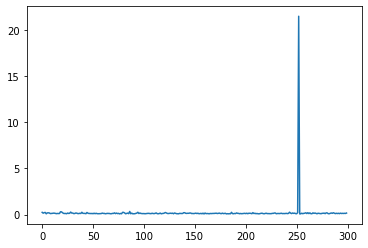

55990it [06:58, 143.33it/s]

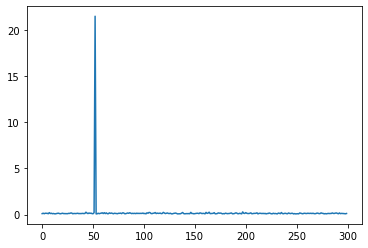

56200it [06:59, 143.57it/s]

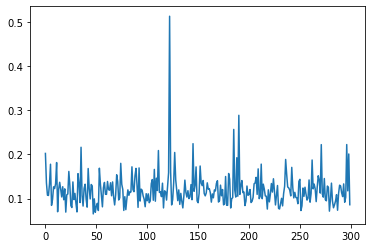

56395it [07:01, 143.74it/s]

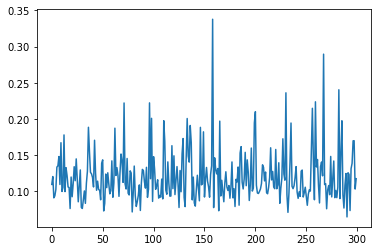

56590it [07:02, 144.35it/s]

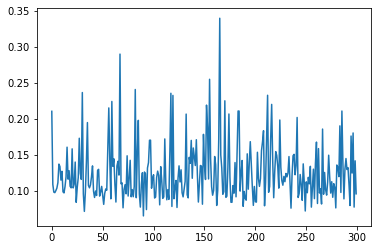

56800it [07:04, 143.85it/s]

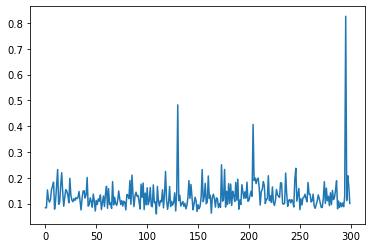

56995it [07:05, 144.03it/s]

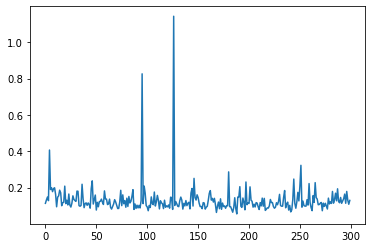

57190it [07:07, 144.73it/s]

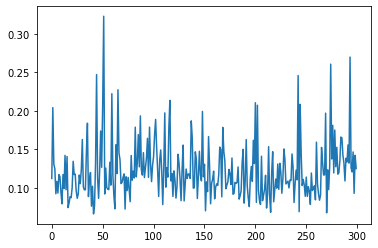

57400it [07:08, 144.36it/s]

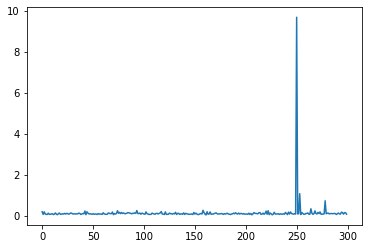

57595it [07:10, 144.17it/s]

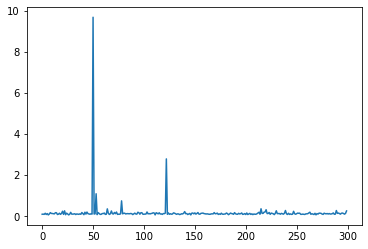

57790it [07:11, 144.37it/s]

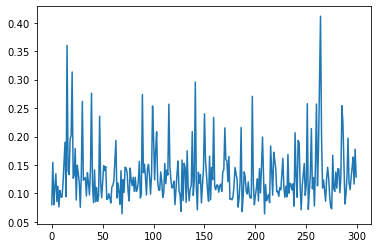

58000it [07:13, 144.75it/s]

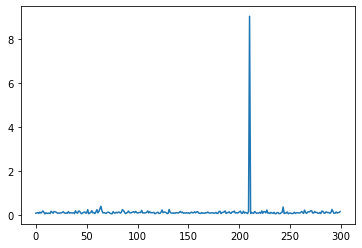

58194it [07:14, 143.34it/s]

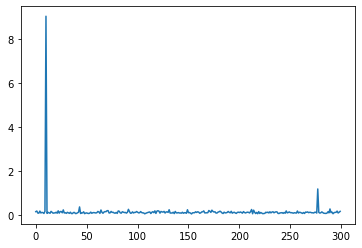

58389it [07:16, 142.82it/s]

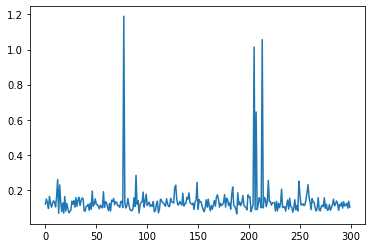

58599it [07:17, 143.86it/s]

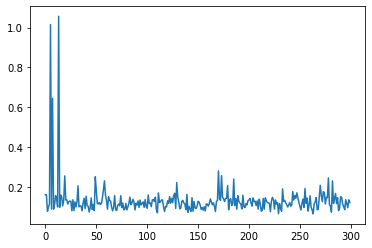

58790it [07:19, 133.99it/s]

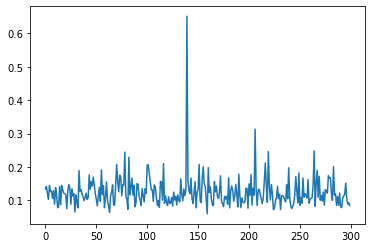

58986it [07:20, 139.70it/s]

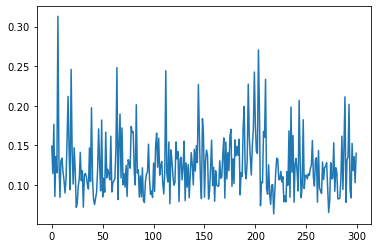

59195it [07:22, 143.40it/s]

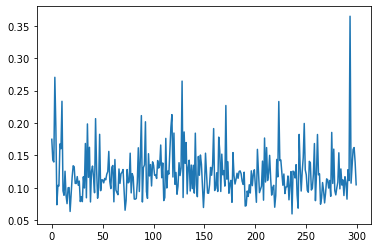

59390it [07:23, 142.06it/s]

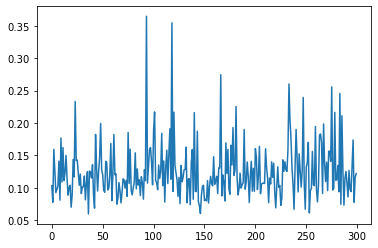

59592it [07:25, 139.14it/s]

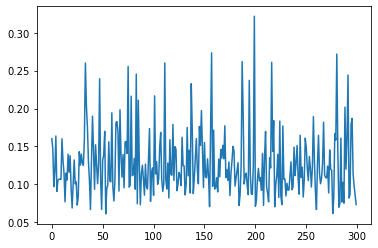

59786it [07:26, 143.56it/s]

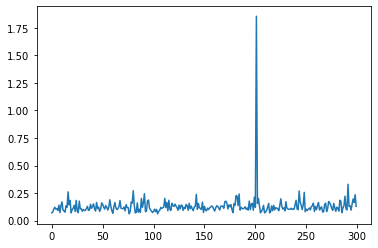

59995it [07:28, 142.91it/s]

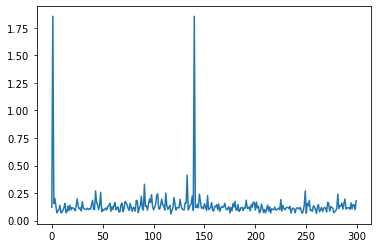

60190it [07:29, 142.68it/s]

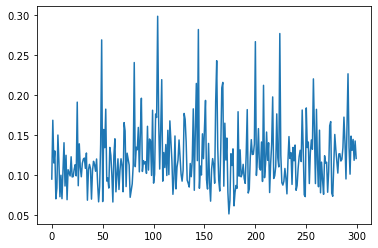

60400it [07:31, 143.35it/s]

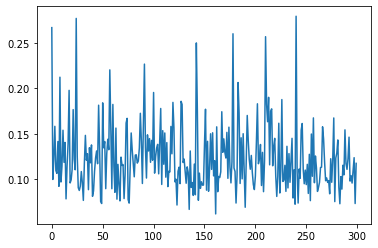

60589it [07:33, 140.84it/s]

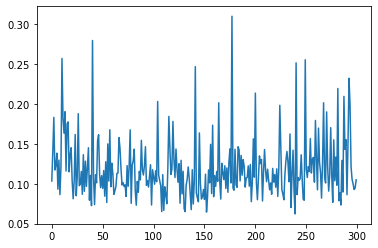

60798it [07:34, 143.16it/s]

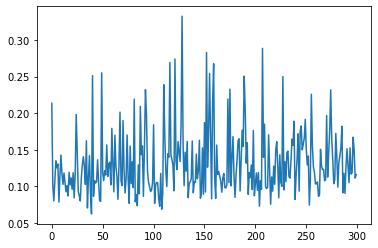

60992it [07:36, 139.89it/s]

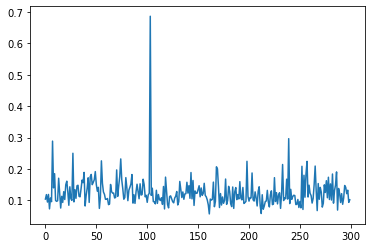

61187it [07:37, 143.29it/s]

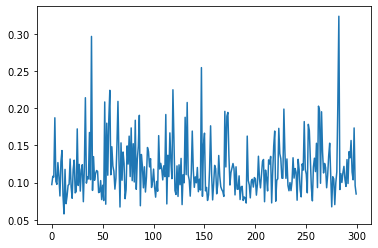

61397it [07:39, 143.74it/s]

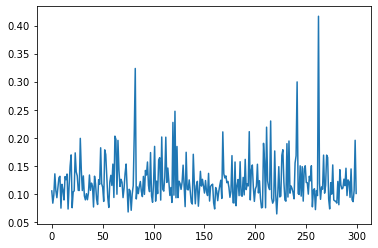

61592it [07:40, 143.17it/s]

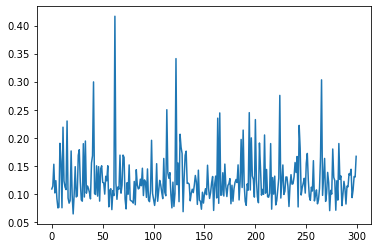

61786it [07:42, 142.09it/s]

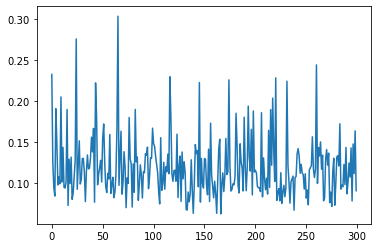

61996it [07:43, 143.56it/s]

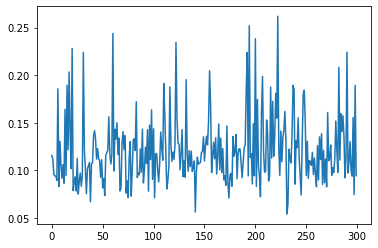

62191it [07:45, 143.37it/s]

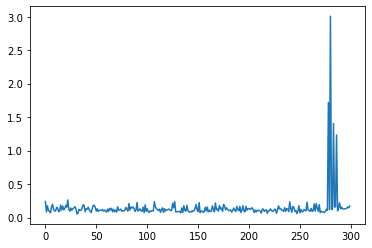

62386it [07:46, 142.61it/s]

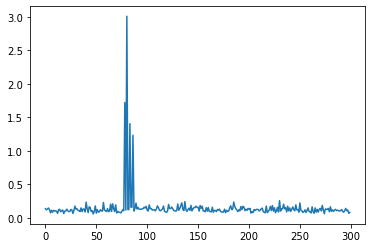

62596it [07:48, 143.82it/s]

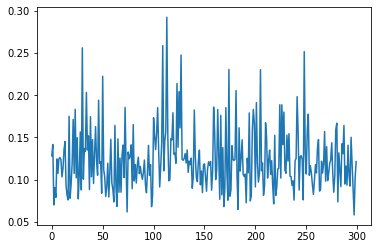

62791it [07:49, 142.92it/s]

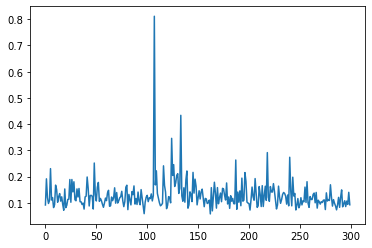

62986it [07:51, 143.70it/s]

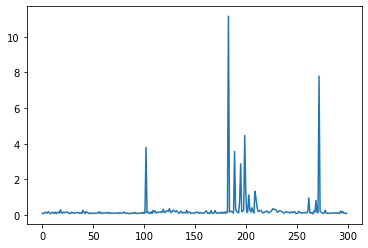

63194it [07:52, 143.95it/s]

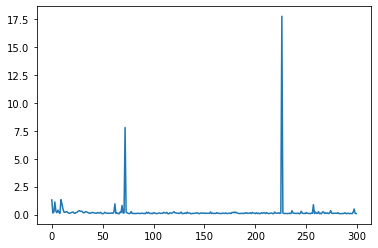

63389it [07:54, 144.08it/s]

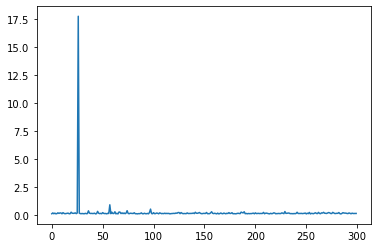

63599it [07:55, 143.73it/s]

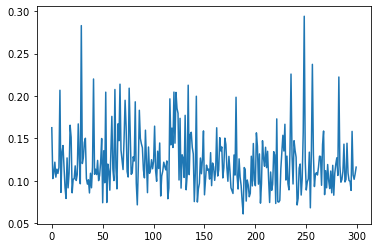

63794it [07:57, 144.38it/s]

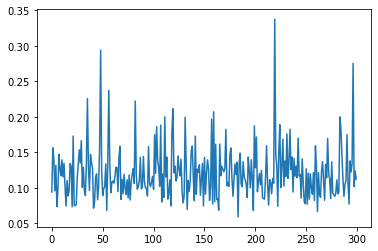

63989it [07:58, 142.49it/s]

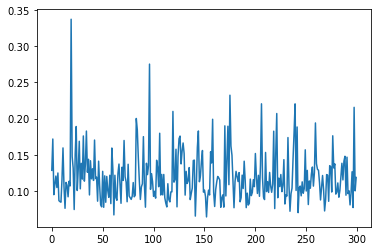

64199it [08:00, 144.18it/s]

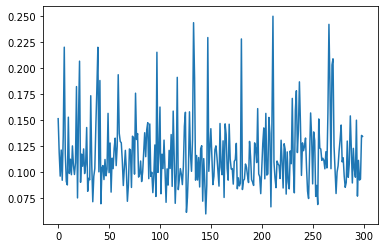

64393it [08:01, 143.13it/s]

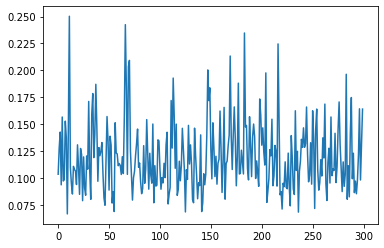

64588it [08:03, 143.55it/s]

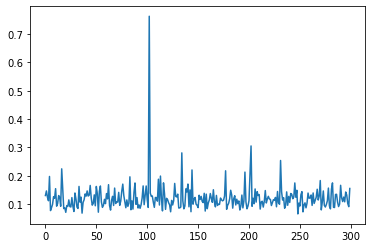

64798it [08:04, 143.62it/s]

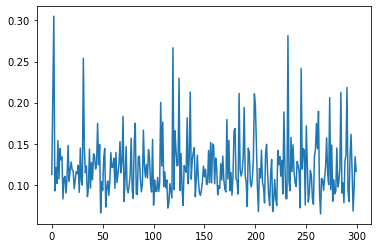

64993it [08:06, 144.74it/s]

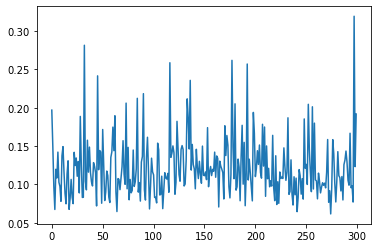

65188it [08:07, 143.10it/s]

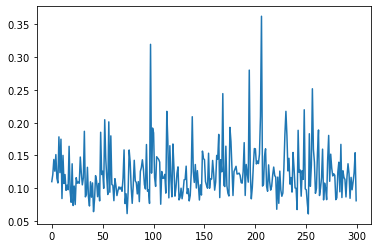

65397it [08:09, 143.61it/s]

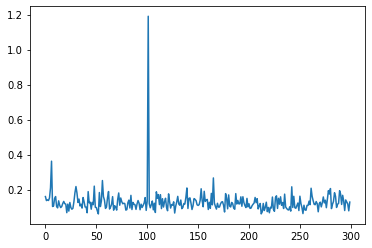

65592it [08:10, 143.63it/s]

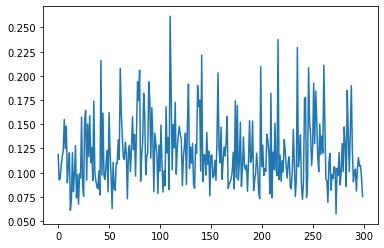

65787it [08:12, 144.65it/s]

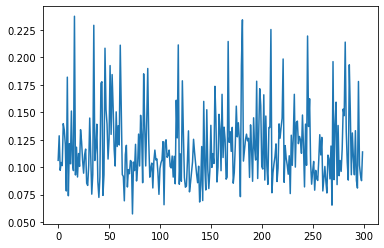

65996it [08:13, 144.06it/s]

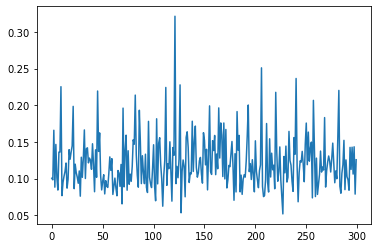

66191it [08:15, 144.57it/s]

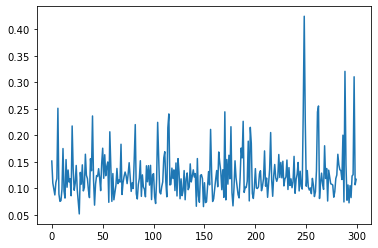

66386it [08:16, 142.93it/s]

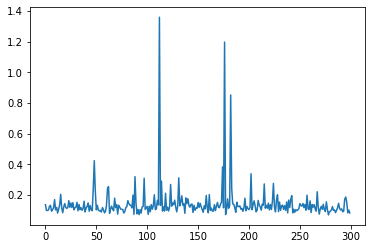

66596it [08:18, 145.33it/s]

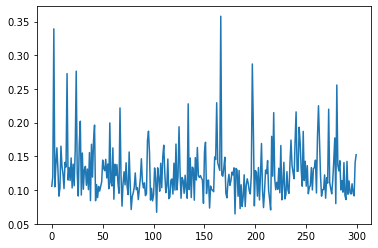

66790it [08:19, 143.62it/s]

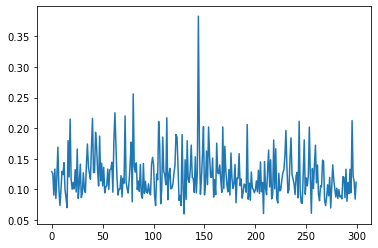

67000it [08:21, 144.71it/s]

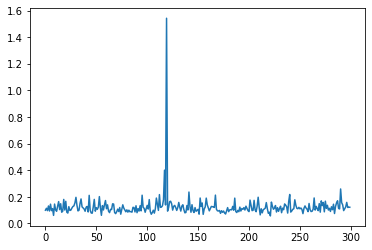

67194it [08:22, 143.52it/s]

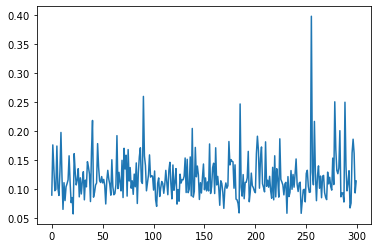

67389it [08:24, 144.10it/s]

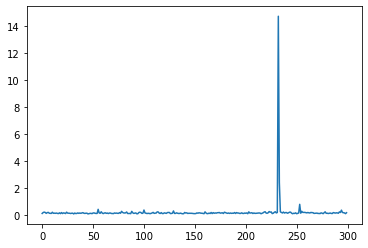

67598it [08:25, 144.18it/s]

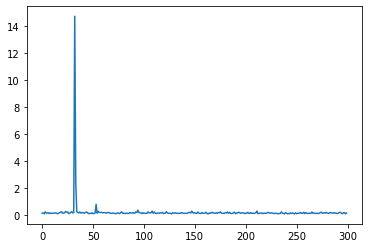

67793it [08:27, 143.78it/s]

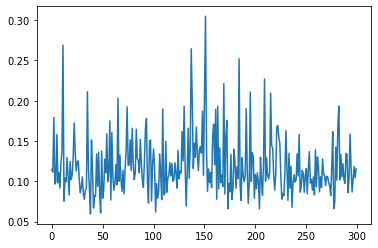

67988it [08:28, 143.28it/s]

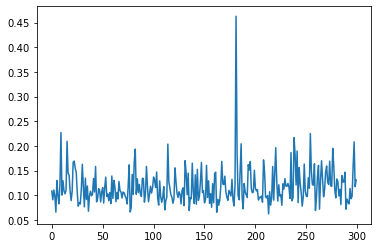

68198it [08:30, 145.07it/s]

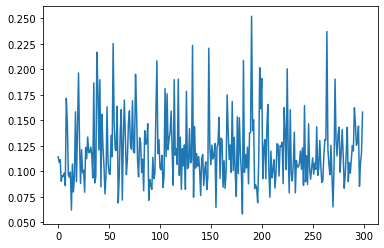

68393it [08:31, 143.90it/s]

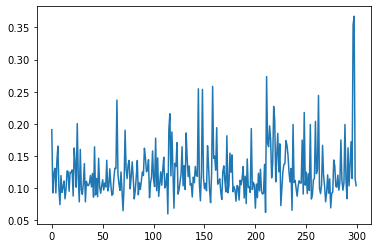

68588it [08:33, 144.44it/s]

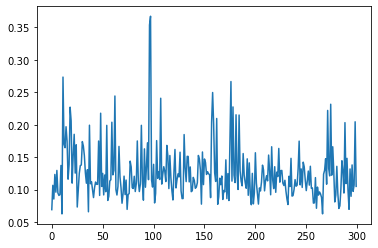

68798it [08:34, 143.97it/s]

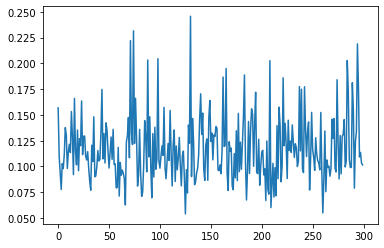

68993it [08:36, 143.84it/s]

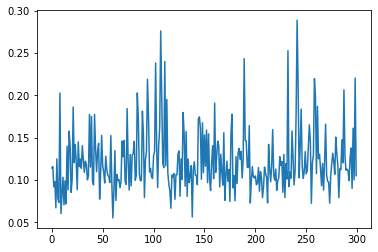

69187it [08:37, 143.41it/s]

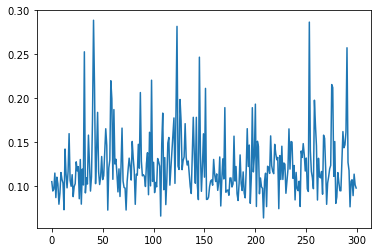

69397it [08:39, 144.39it/s]

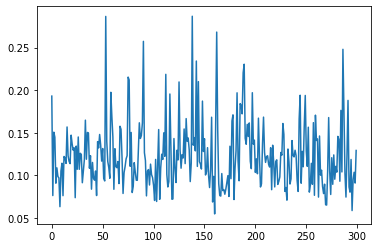

69590it [08:40, 135.27it/s]

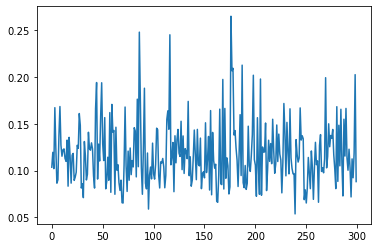

69798it [08:42, 123.40it/s]

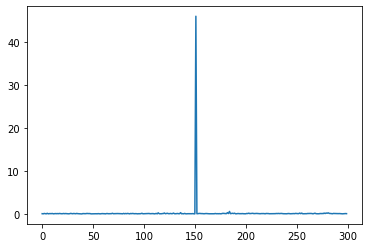

69988it [08:44, 142.13it/s]

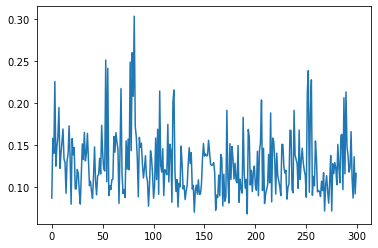

70198it [08:45, 142.49it/s]

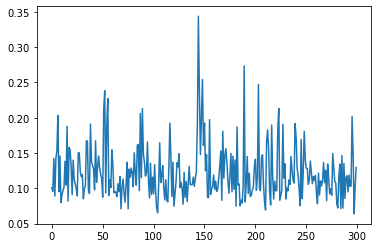

70392it [08:47, 143.04it/s]

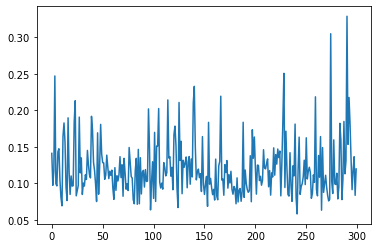

70587it [08:48, 143.68it/s]

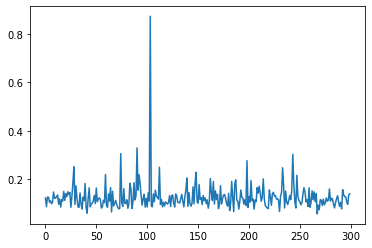

70797it [08:50, 143.58it/s]

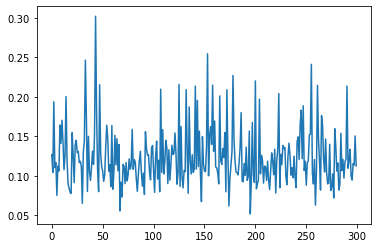

70992it [08:51, 142.17it/s]

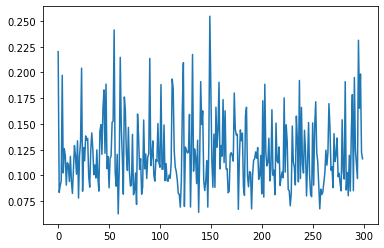

71186it [08:53, 143.05it/s]

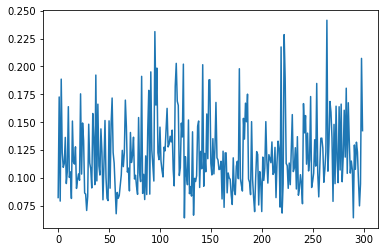

71396it [08:54, 143.71it/s]

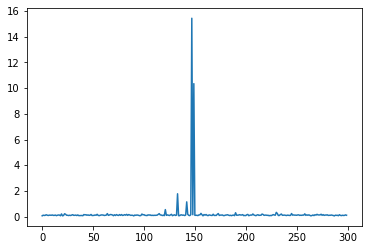

71590it [08:56, 143.32it/s]

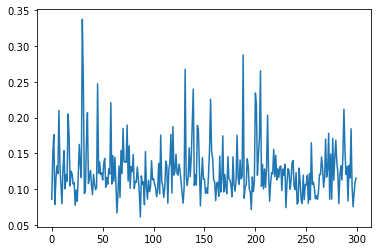

71800it [08:57, 143.62it/s]

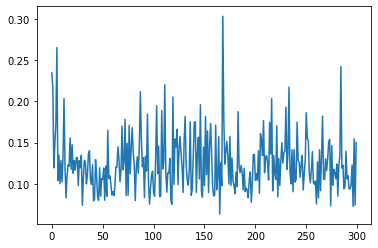

71995it [08:59, 142.72it/s]

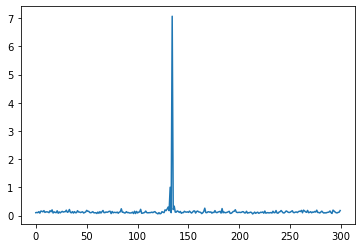

72190it [09:00, 143.79it/s]

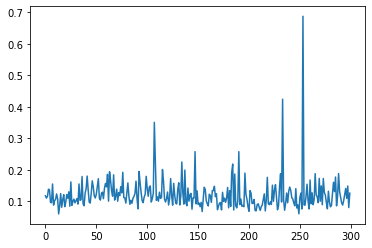

72399it [09:02, 143.23it/s]

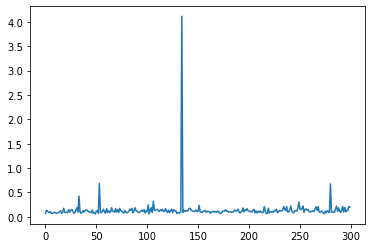

72594it [09:03, 142.93it/s]

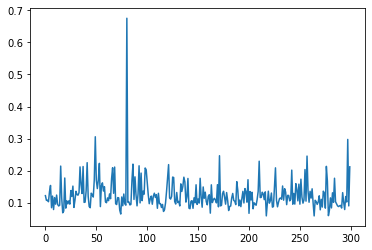

72788it [09:05, 143.64it/s]

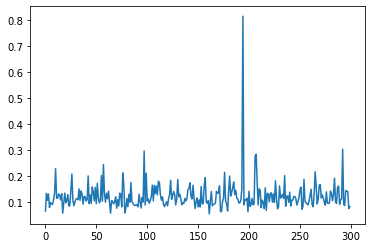

72998it [09:06, 142.91it/s]

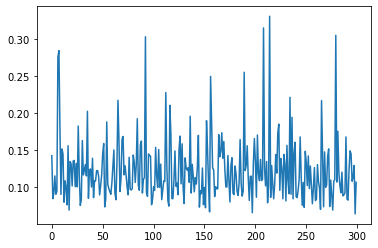

73192it [09:08, 143.55it/s]

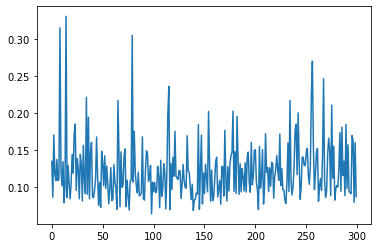

73387it [09:09, 143.51it/s]

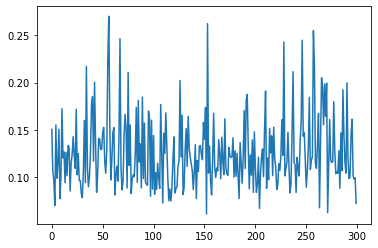

73595it [09:11, 142.52it/s]

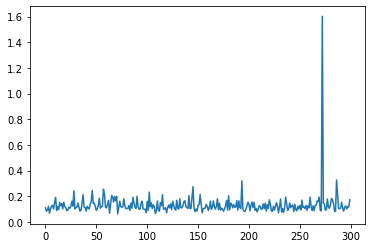

73790it [09:12, 143.53it/s]

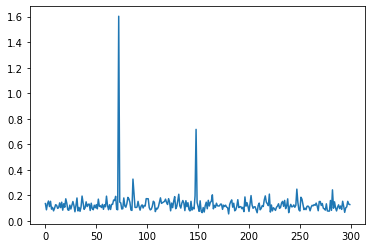

73999it [09:14, 142.98it/s]

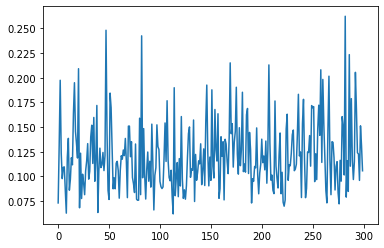

74194it [09:15, 143.31it/s]

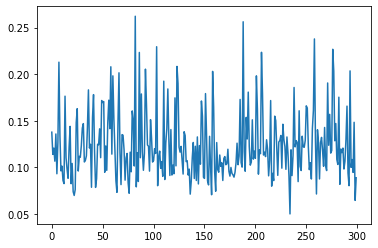

74388it [09:17, 143.76it/s]

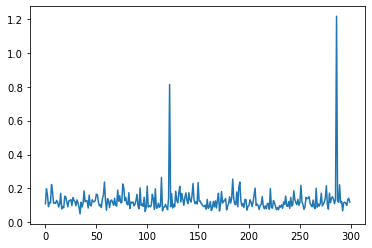

74598it [09:18, 143.33it/s]

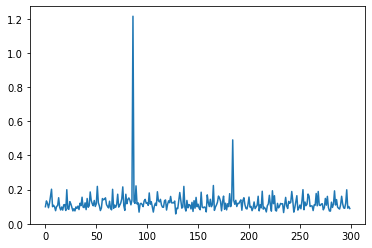

74792it [09:20, 131.53it/s]

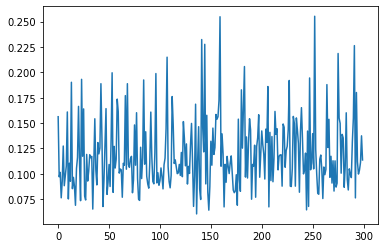

74986it [09:21, 143.02it/s]

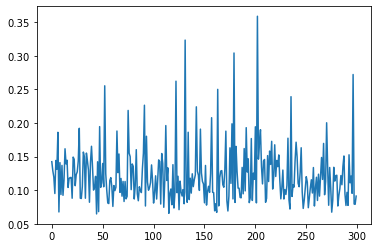

75195it [09:23, 142.41it/s]

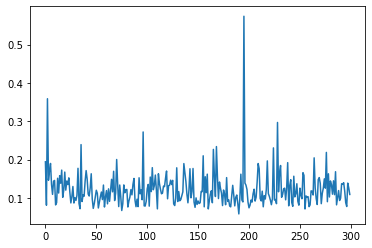

75390it [09:24, 143.57it/s]

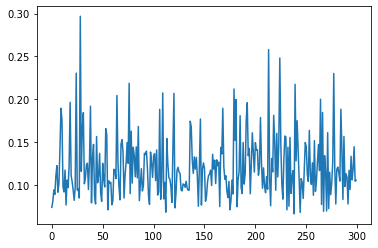

75597it [09:26, 138.55it/s]

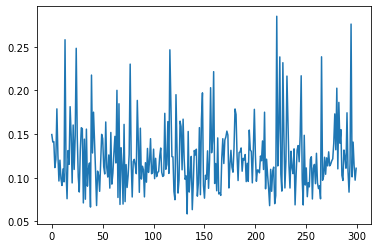

75791it [09:27, 142.53it/s]

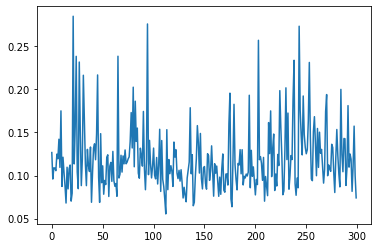

76000it [09:29, 142.84it/s]

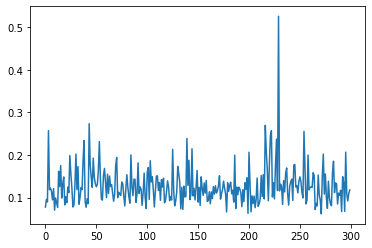

76195it [09:30, 143.76it/s]

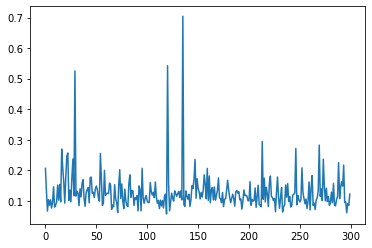

76390it [09:32, 143.88it/s]

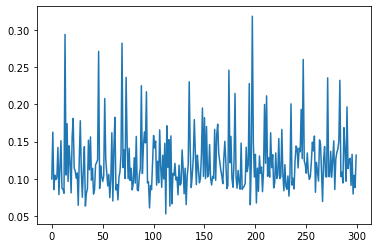

76600it [09:33, 144.44it/s]

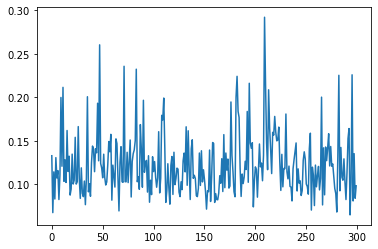

76794it [09:35, 137.46it/s]

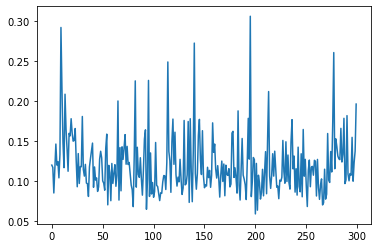

76987it [09:36, 142.90it/s]

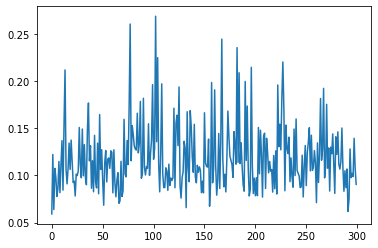

77195it [09:38, 132.83it/s]

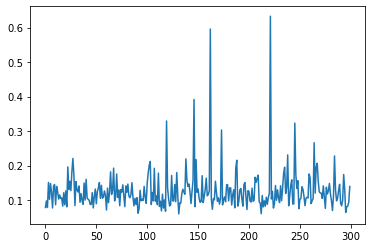

77386it [09:39, 140.03it/s]

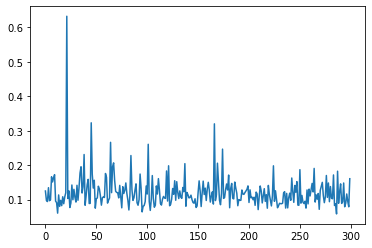

77595it [09:41, 143.58it/s]

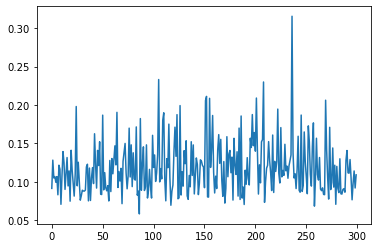

77790it [09:43, 143.00it/s]

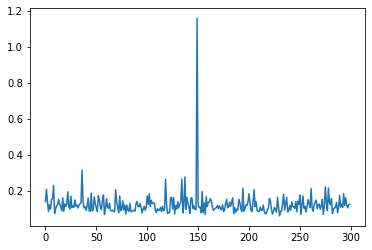

77999it [09:44, 142.11it/s]

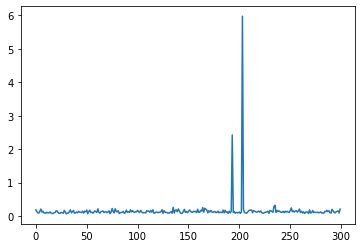

78194it [09:46, 143.84it/s]

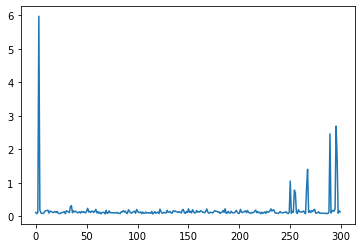

78388it [09:47, 143.31it/s]

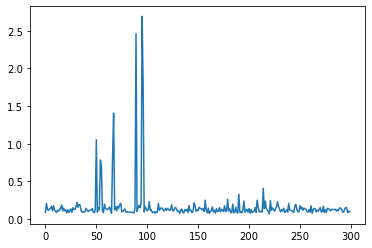

78598it [09:49, 143.32it/s]

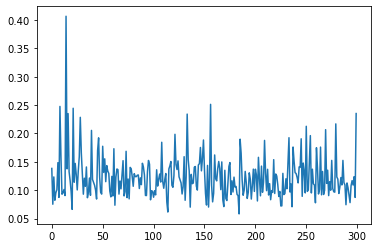

78792it [09:50, 143.03it/s]

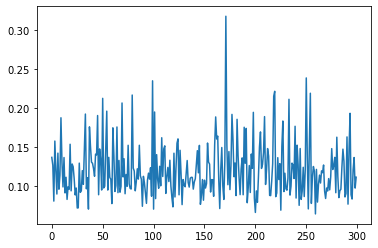

78987it [09:52, 144.06it/s]

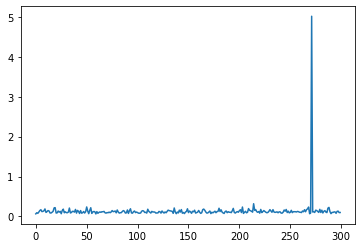

79196it [09:53, 142.88it/s]

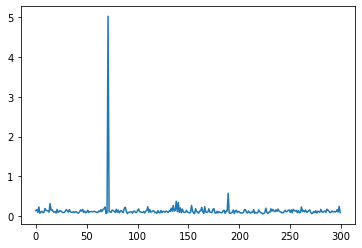

79391it [09:55, 143.97it/s]

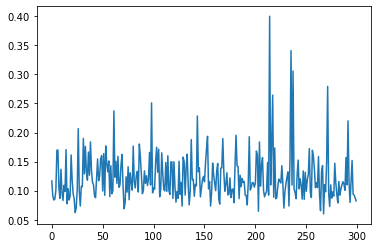

79586it [09:56, 143.94it/s]

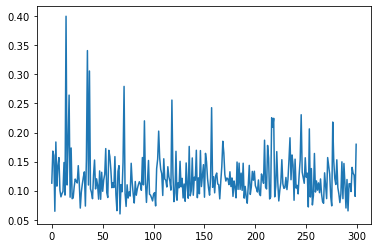

79796it [09:58, 143.55it/s]

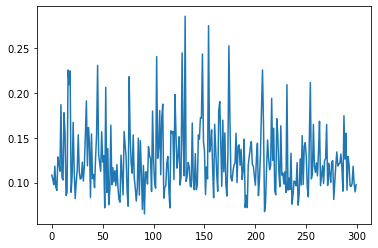

79991it [09:59, 143.69it/s]

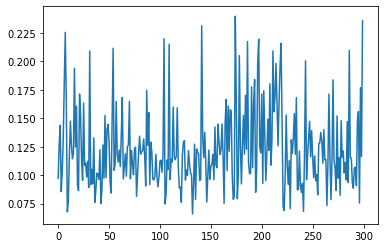

80186it [10:01, 144.31it/s]

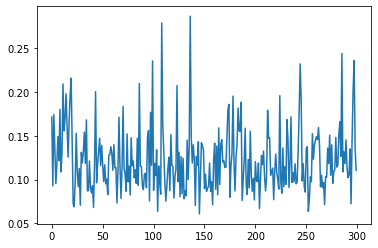

80395it [10:02, 143.94it/s]

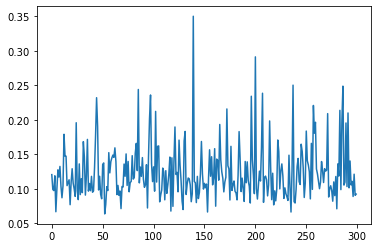

80590it [10:04, 144.16it/s]

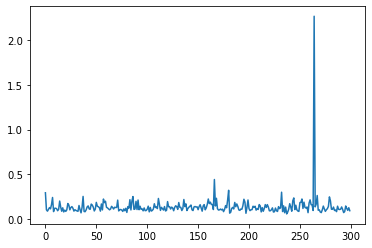

80799it [10:05, 143.31it/s]

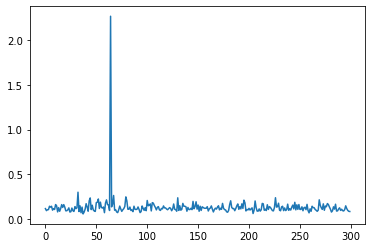

80994it [10:07, 144.09it/s]

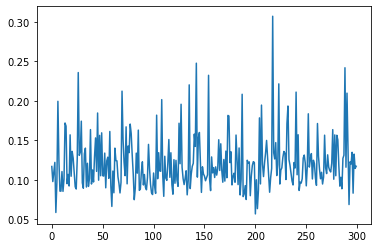

81189it [10:08, 144.22it/s]

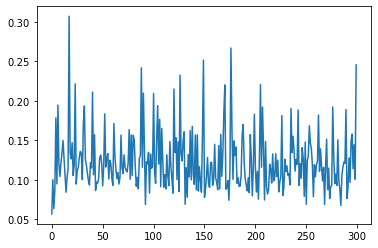

81399it [10:10, 142.58it/s]

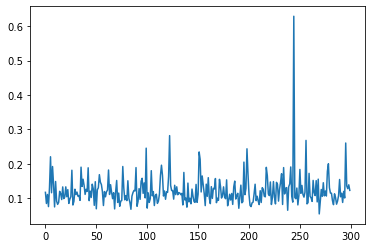

81594it [10:11, 143.43it/s]

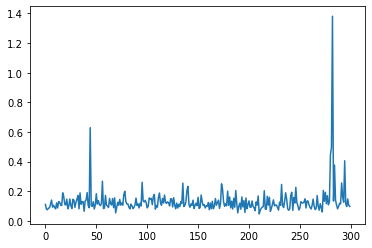

81789it [10:12, 143.17it/s]

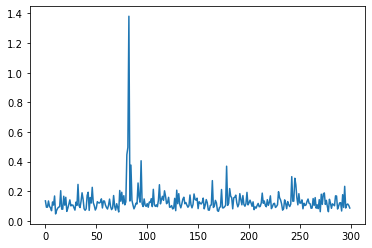

81996it [10:14, 134.08it/s]

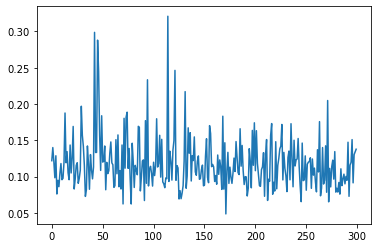

82190it [10:16, 142.08it/s]

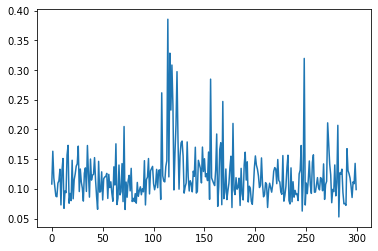

82398it [10:17, 143.09it/s]

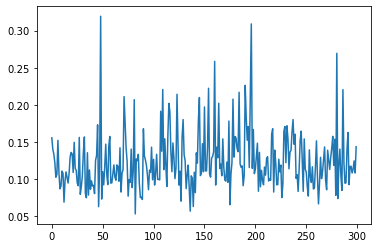

82590it [10:19, 142.96it/s]

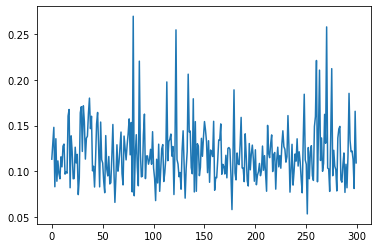

82800it [10:20, 144.23it/s]

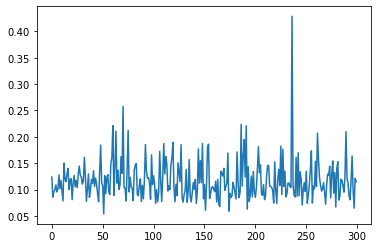

82995it [10:22, 144.11it/s]

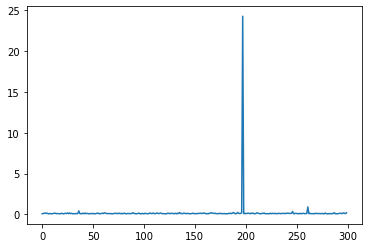

83189it [10:23, 142.76it/s]

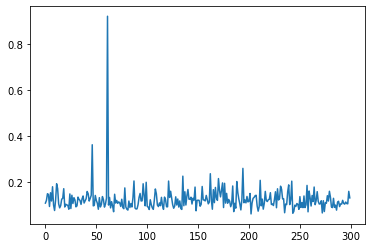

83399it [10:25, 144.17it/s]

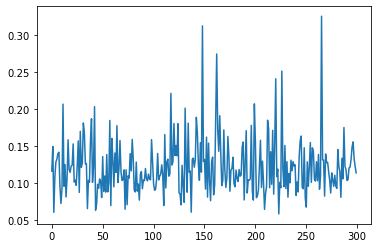

83594it [10:26, 143.06it/s]

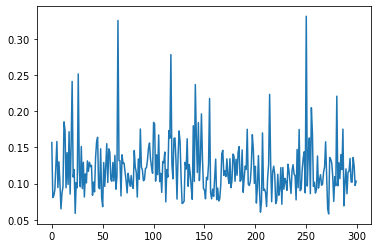

83788it [10:28, 144.80it/s]

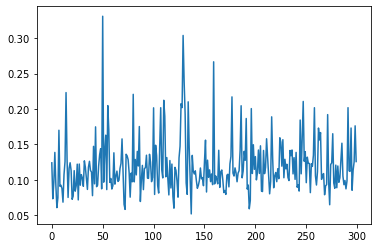

83998it [10:29, 143.40it/s]

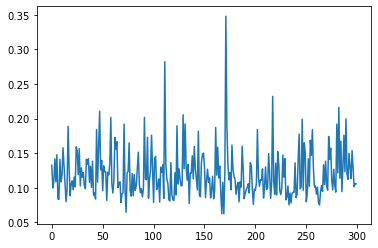

84193it [10:31, 143.95it/s]

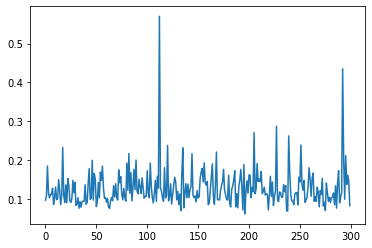

84388it [10:32, 142.89it/s]

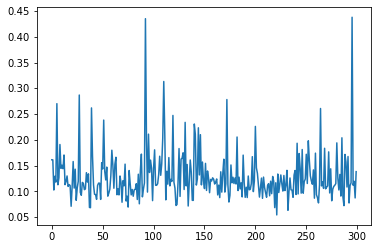

84598it [10:34, 144.02it/s]

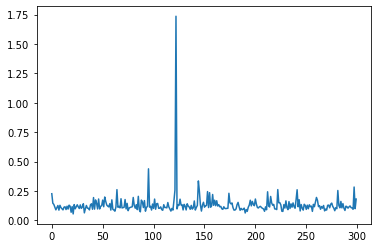

84793it [10:35, 143.45it/s]

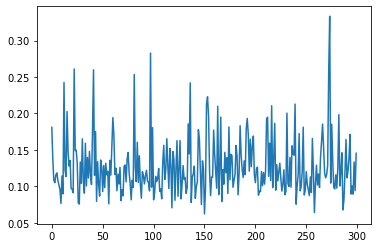

84988it [10:37, 144.22it/s]

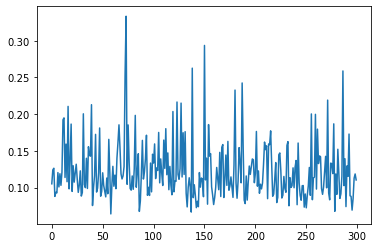

85198it [10:38, 143.05it/s]

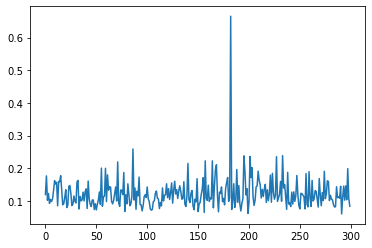

85392it [10:40, 143.89it/s]

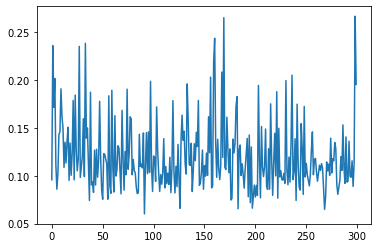

85587it [10:41, 143.31it/s]

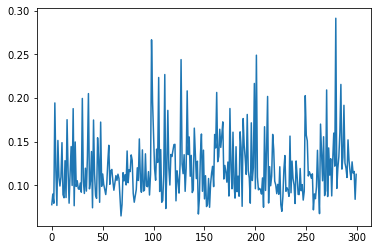

85797it [10:43, 144.02it/s]

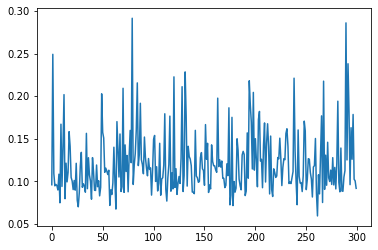

85992it [10:44, 143.61it/s]

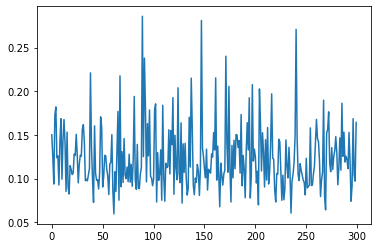

86186it [10:46, 142.55it/s]

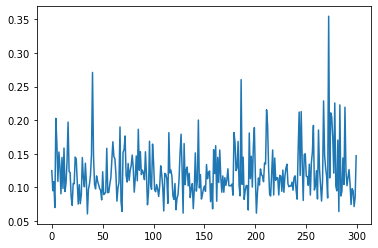

86396it [10:47, 143.00it/s]

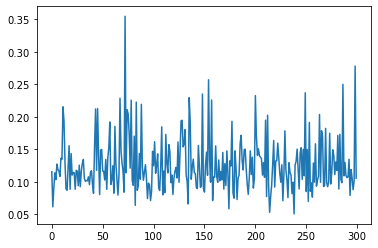

86591it [10:49, 143.09it/s]

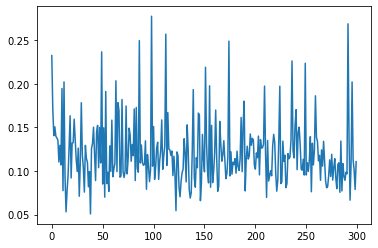

86786it [10:50, 143.31it/s]

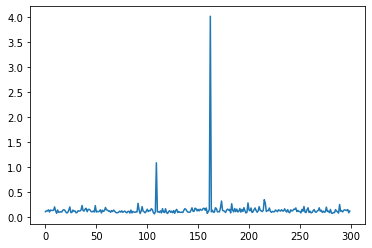

86996it [10:52, 144.29it/s]

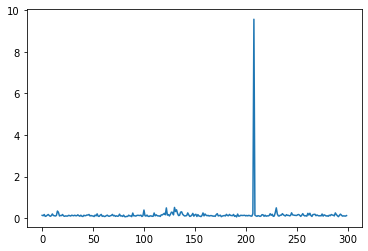

87190it [10:53, 143.01it/s]

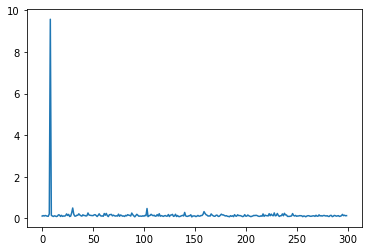

87400it [10:55, 144.63it/s]

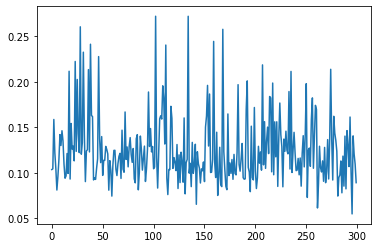

87594it [10:56, 143.05it/s]

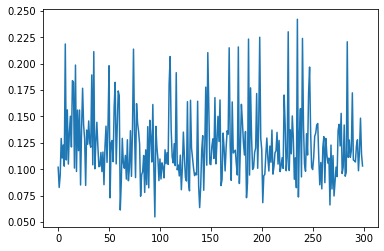

87789it [10:58, 144.30it/s]

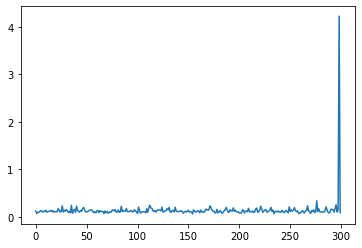

87999it [10:59, 143.63it/s]

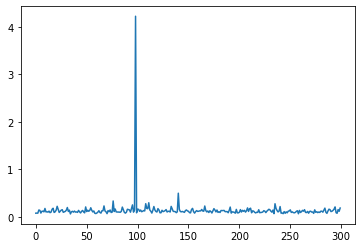

88194it [11:01, 144.37it/s]

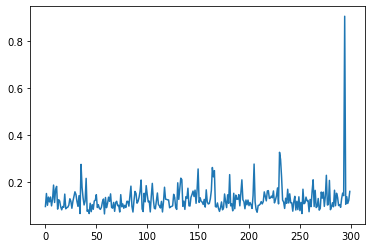

88389it [11:02, 142.67it/s]

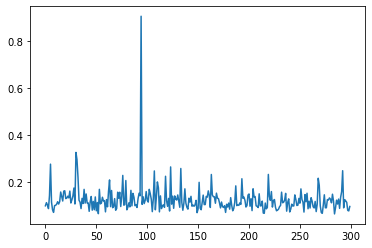

88599it [11:04, 145.23it/s]

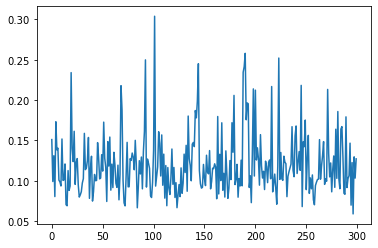

88794it [11:05, 142.16it/s]

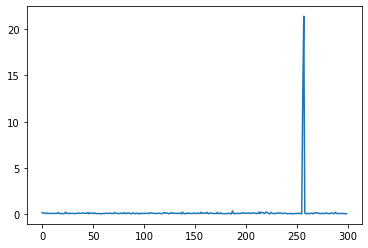

88989it [11:07, 144.16it/s]

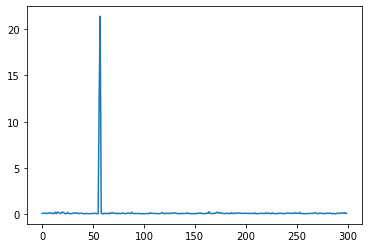

89198it [11:08, 143.61it/s]

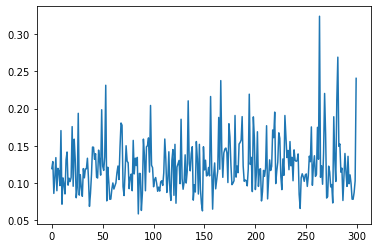

89393it [11:10, 143.30it/s]

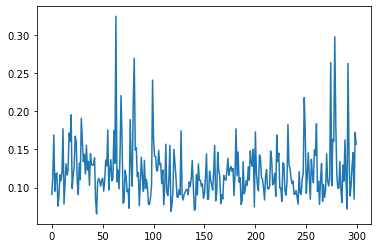

89588it [11:11, 142.05it/s]

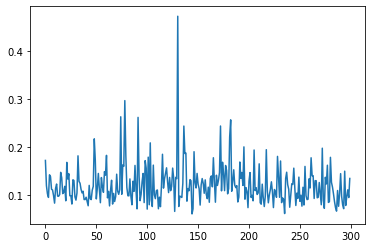

89797it [11:13, 144.21it/s]

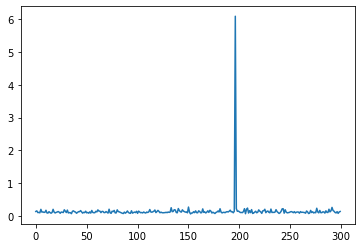

89991it [11:14, 141.90it/s]

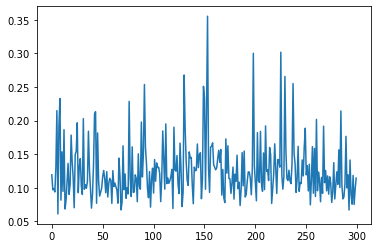

90186it [11:15, 144.21it/s]

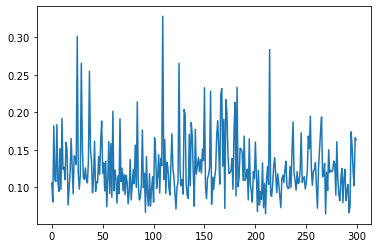

90396it [11:17, 142.91it/s]

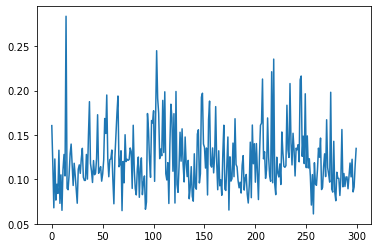

90591it [11:19, 133.75it/s]

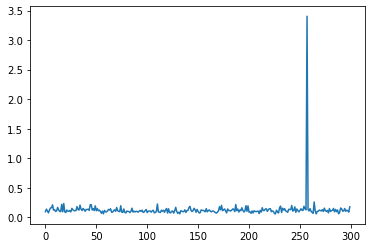

90790it [11:20, 135.89it/s]

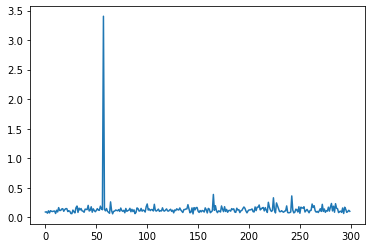

90999it [11:22, 143.00it/s]

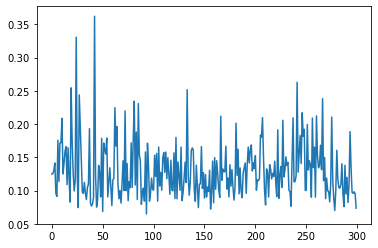

91199it [11:23, 103.53it/s]

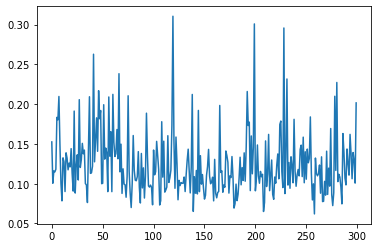

91391it [11:25, 105.05it/s]

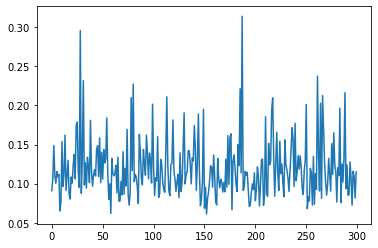

91591it [11:27, 130.70it/s]

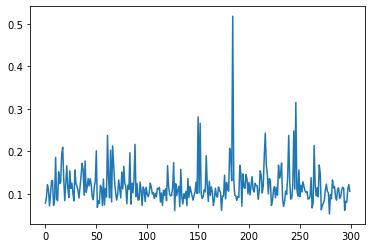

91800it [11:29, 130.16it/s]

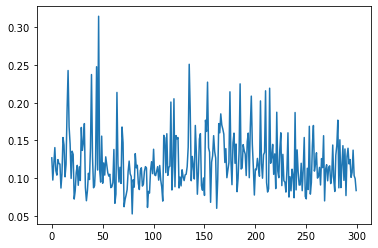

91995it [11:30, 130.40it/s]

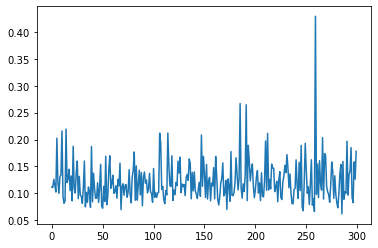

92191it [11:32, 126.38it/s]

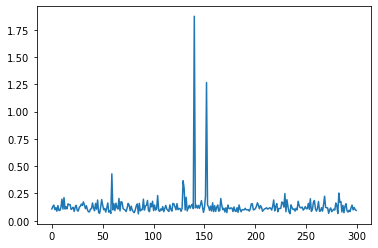

92390it [11:34, 125.56it/s]

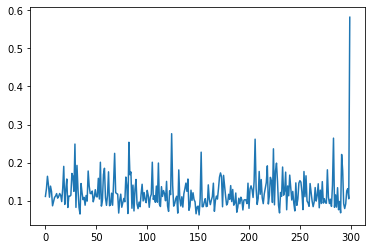

92595it [11:35, 130.80it/s]

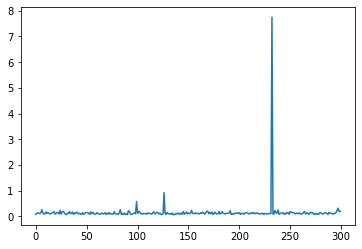

92792it [11:37, 129.43it/s]

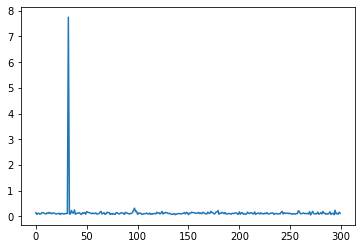

92999it [11:39, 132.50it/s]

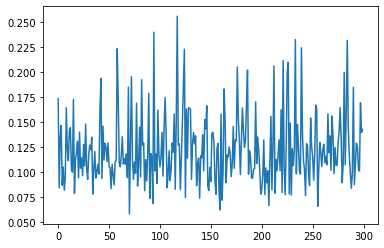

93197it [11:40, 129.51it/s]

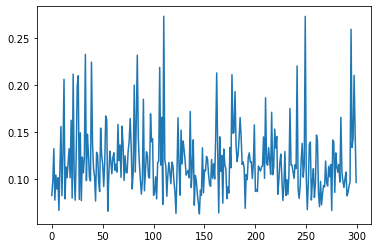

93389it [11:42, 129.93it/s]

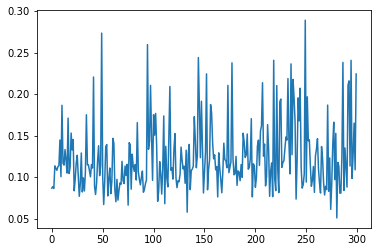

93594it [11:44, 129.26it/s]

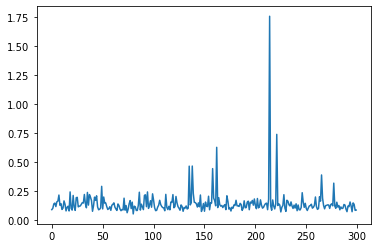

93800it [11:45, 124.11it/s]

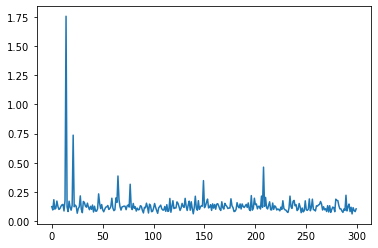

93996it [11:47, 127.92it/s]

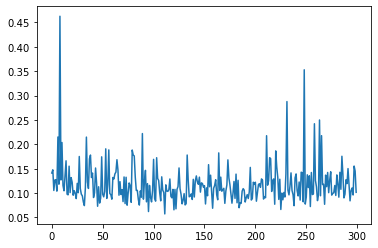

94192it [11:49, 123.45it/s]

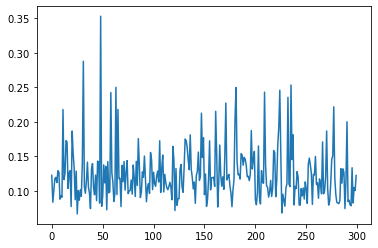

94394it [11:50, 123.74it/s]

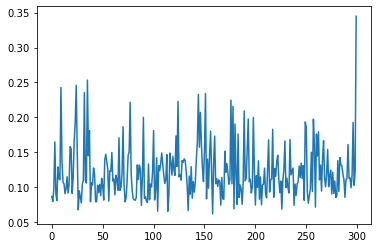

94599it [11:52, 112.50it/s]

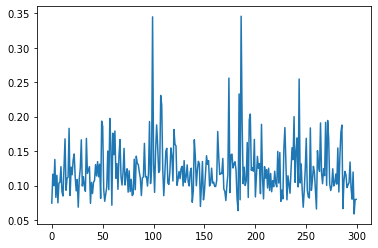

94799it [11:54, 137.06it/s]

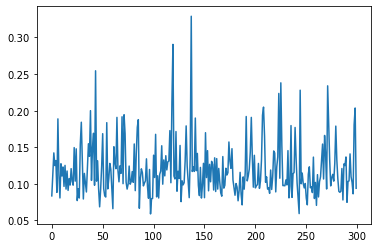

94992it [11:56, 139.00it/s]

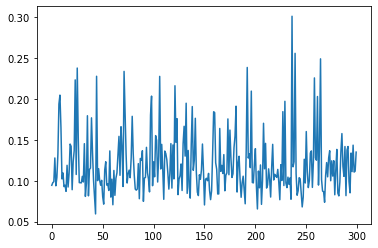

95168it [11:57, 132.59it/s]
0it [00:00, ?it/s]

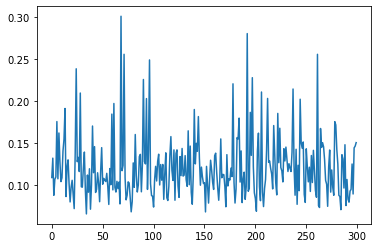

193it [00:05, 126.40it/s]

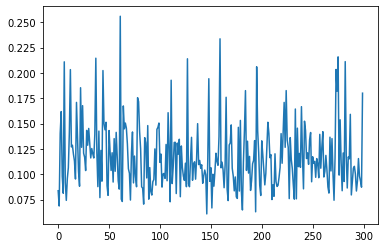

397it [00:07, 139.61it/s]

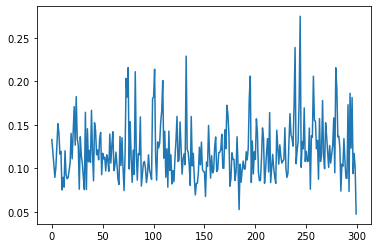

599it [00:08, 139.27it/s]

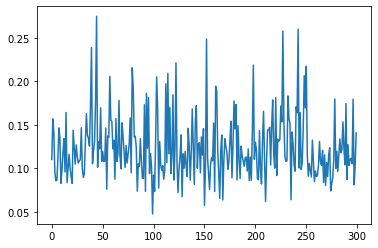

799it [00:10, 138.29it/s]

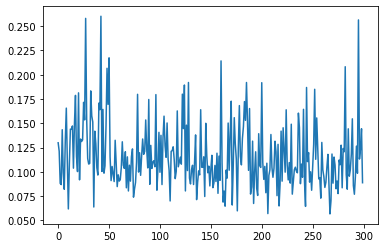

989it [00:11, 140.28it/s]

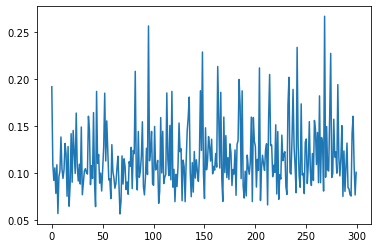

1197it [00:13, 141.41it/s]

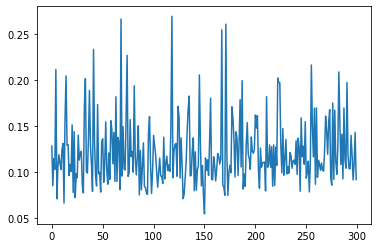

1389it [00:14, 141.28it/s]

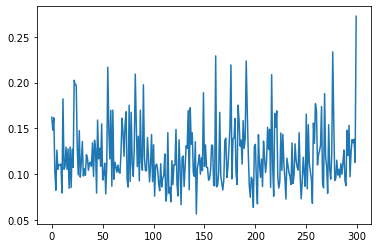

1598it [00:16, 139.77it/s]

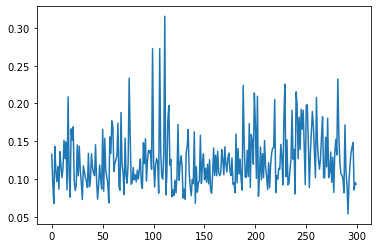

1791it [00:17, 140.63it/s]

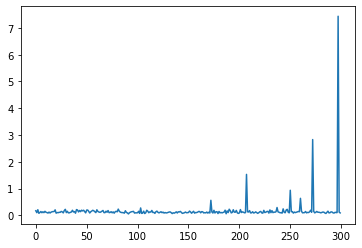

1998it [00:19, 140.48it/s]

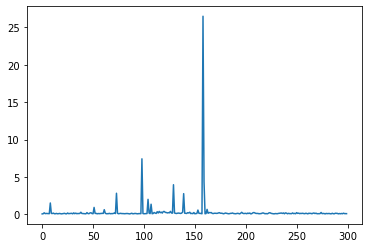

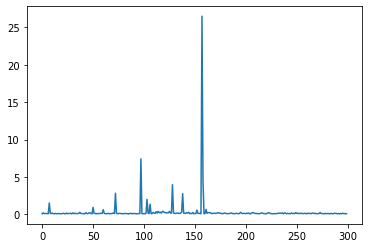

2190it [00:20, 140.90it/s]

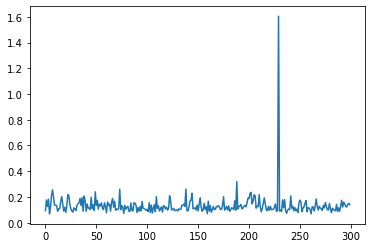

2398it [00:22, 141.79it/s]

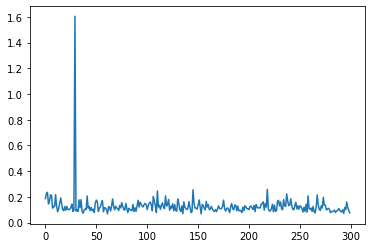

2591it [00:23, 142.06it/s]

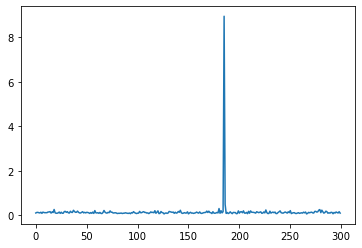

2799it [00:25, 138.78it/s]

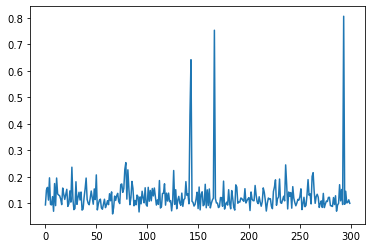

2990it [00:27, 138.43it/s]

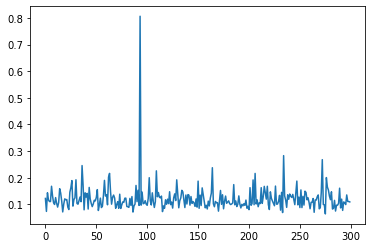

3197it [00:28, 140.48it/s]

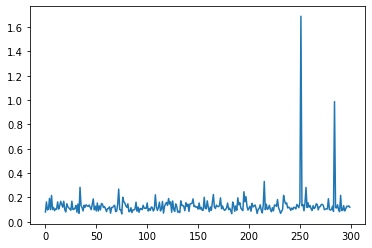

3387it [00:30, 139.12it/s]

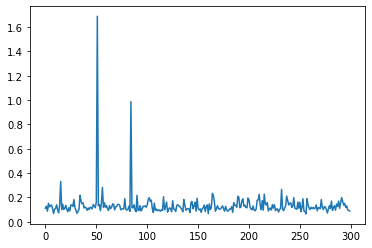

3591it [00:31, 139.10it/s]

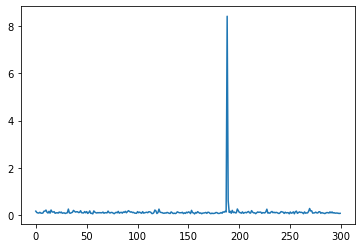

3800it [00:33, 140.32it/s]

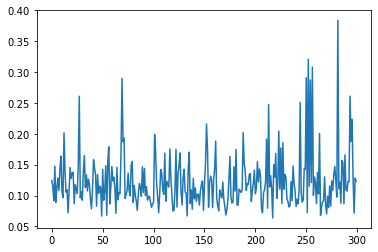

3994it [00:34, 140.00it/s]

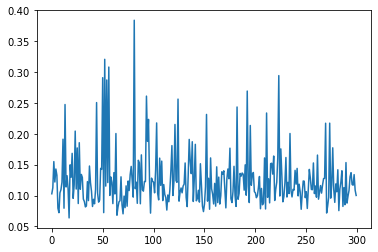

4188it [00:36, 141.11it/s]

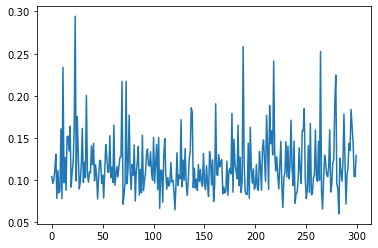

4397it [00:37, 140.77it/s]

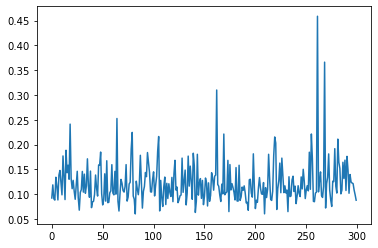

4592it [00:39, 141.64it/s]

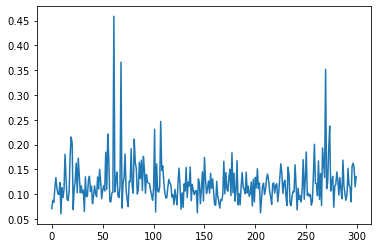

4786it [00:40, 140.92it/s]

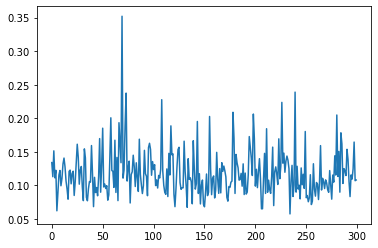

4994it [00:42, 141.31it/s]

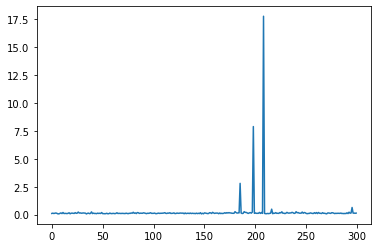

5188it [00:43, 140.57it/s]

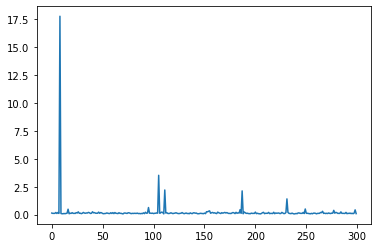

5397it [00:45, 139.69it/s]

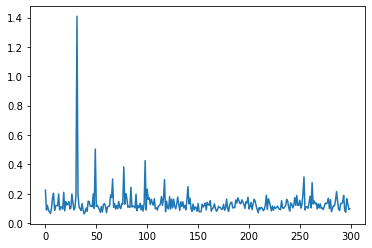

5587it [00:47, 139.90it/s]

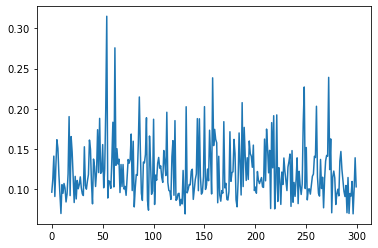

5789it [00:48, 131.47it/s]

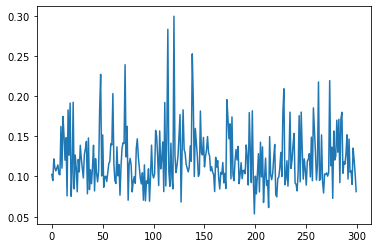

5992it [00:50, 139.06it/s]

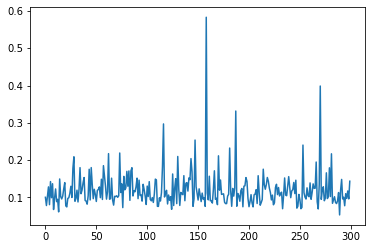

6195it [00:51, 139.44it/s]

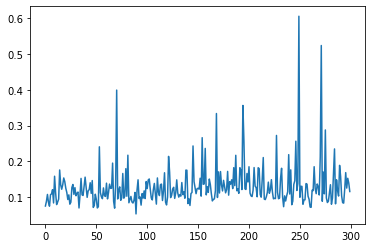

6399it [00:53, 138.12it/s]

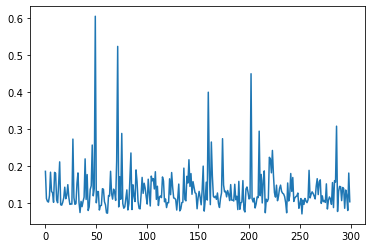

6590it [00:54, 140.83it/s]

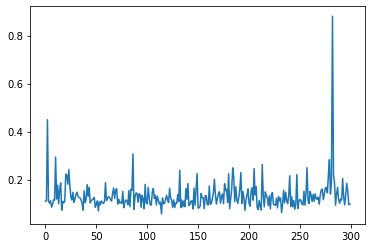

6797it [00:56, 139.28it/s]

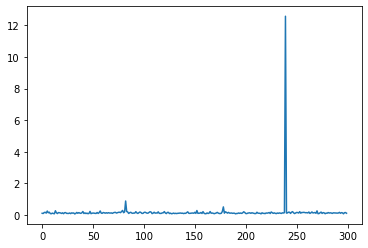

6988it [00:57, 140.64it/s]

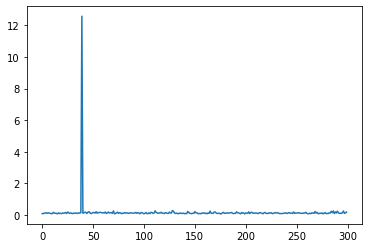

7197it [00:59, 140.11it/s]

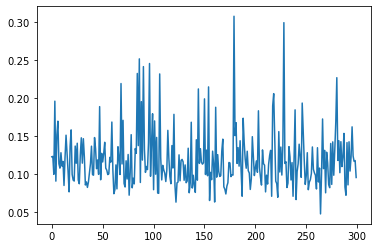

7389it [01:00, 139.79it/s]

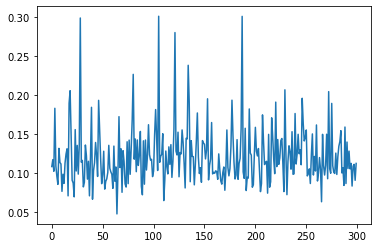

7593it [01:02, 140.20it/s]

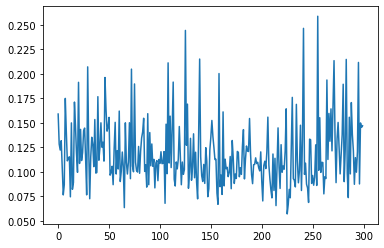

7787it [01:04, 139.94it/s]

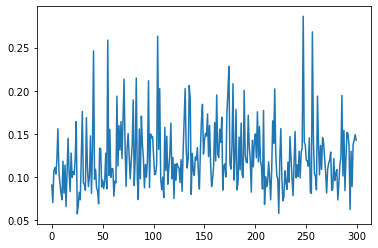

7994it [01:05, 140.28it/s]

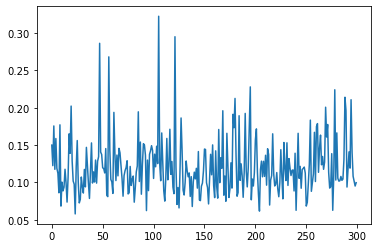

8188it [01:07, 140.51it/s]

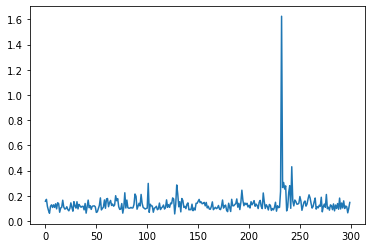

8396it [01:08, 140.48it/s]

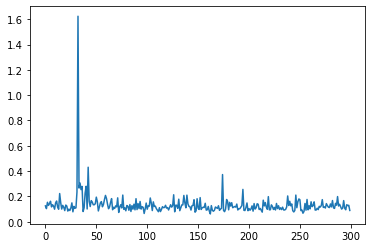

8589it [01:10, 141.16it/s]

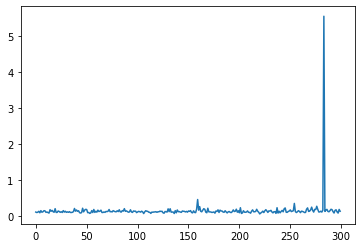

8793it [01:11, 139.77it/s]

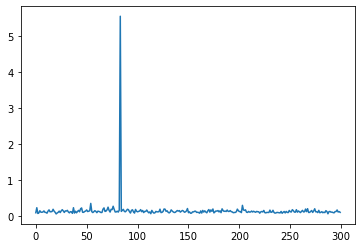

8997it [01:13, 139.09it/s]

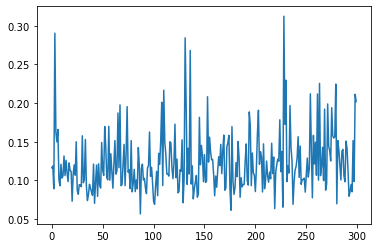

9189it [01:14, 140.70it/s]

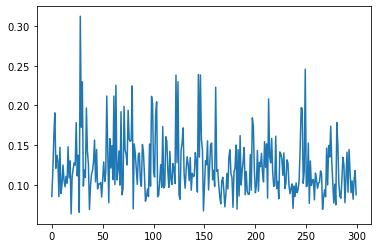

9394it [01:16, 139.76it/s]

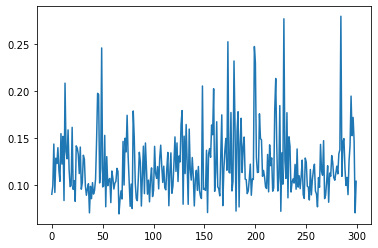

9597it [01:17, 138.41it/s]

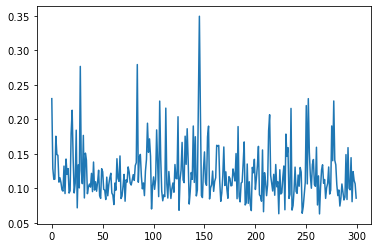

9786it [01:19, 140.10it/s]

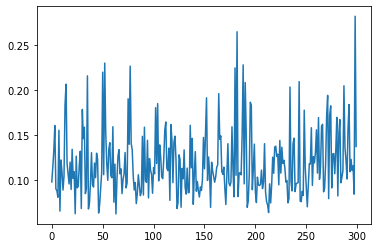

9989it [01:20, 119.44it/s]

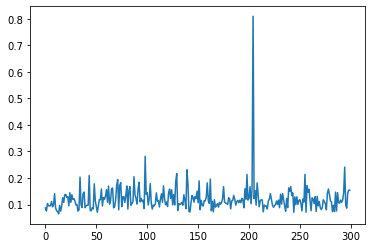

10186it [01:22, 131.91it/s]

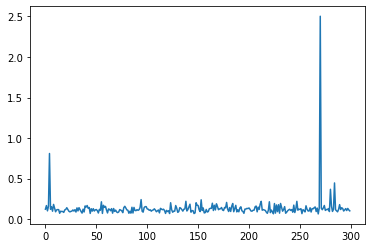

10394it [01:24, 140.58it/s]

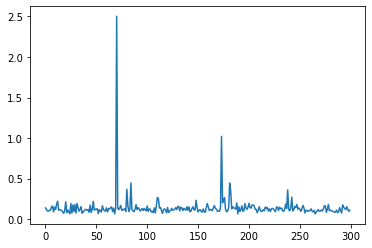

10600it [01:25, 140.46it/s]

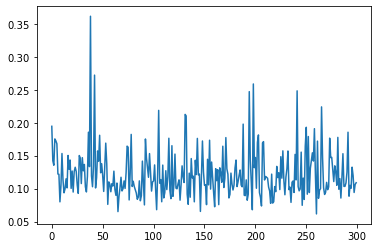

10800it [01:27, 138.71it/s]

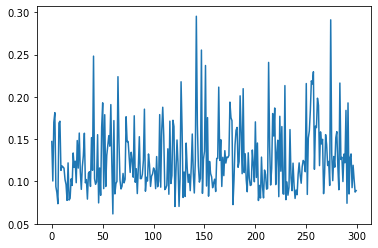

10992it [01:28, 141.05it/s]

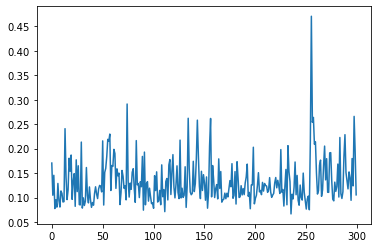

11199it [01:30, 140.11it/s]

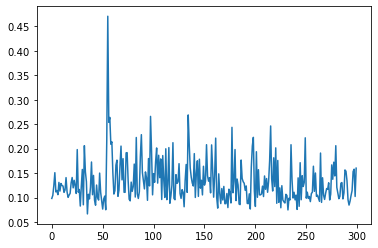

11392it [01:31, 139.75it/s]

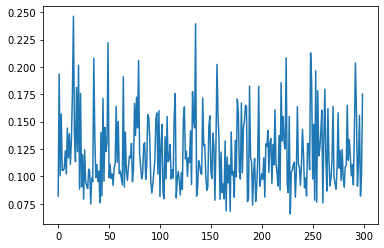

11599it [01:33, 140.47it/s]

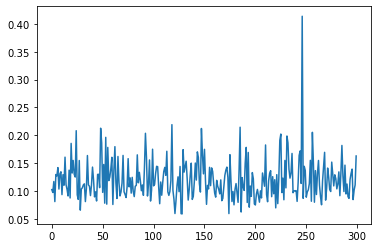

11793it [01:35, 141.28it/s]

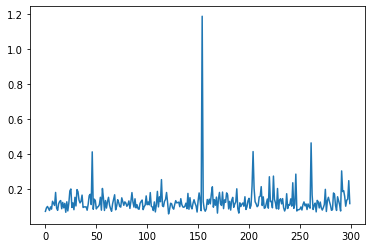

11988it [01:36, 140.11it/s]

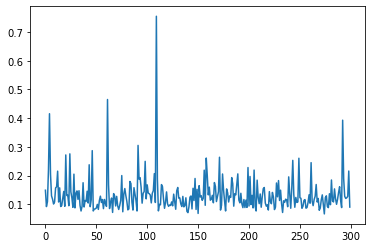

12193it [01:38, 139.68it/s]

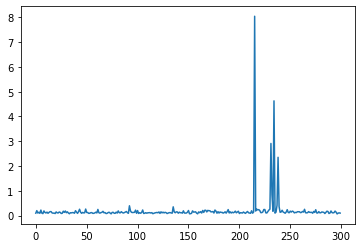

12399it [01:39, 140.80it/s]

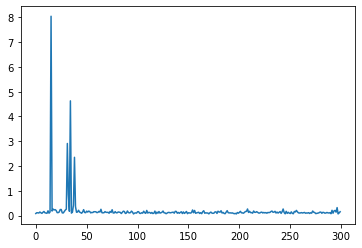

12594it [01:41, 140.11it/s]

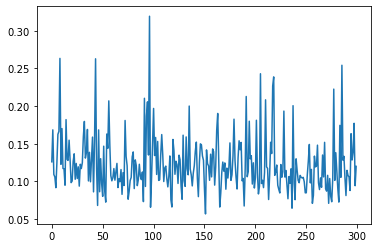

12799it [01:42, 141.14it/s]

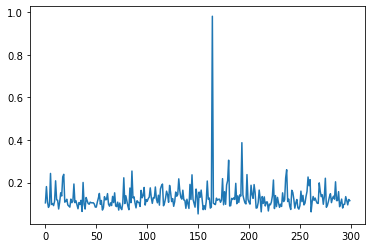

12992it [01:44, 140.21it/s]

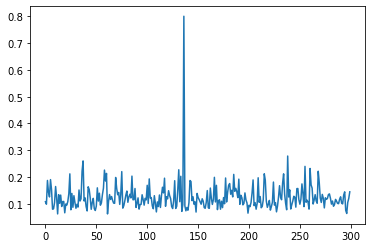

13199it [01:45, 140.22it/s]

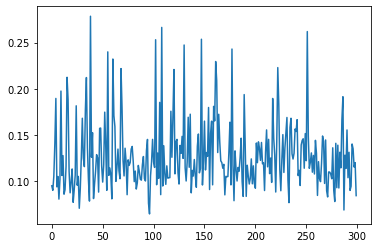

13393it [01:47, 139.40it/s]

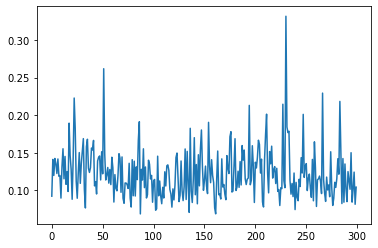

13600it [01:48, 140.81it/s]

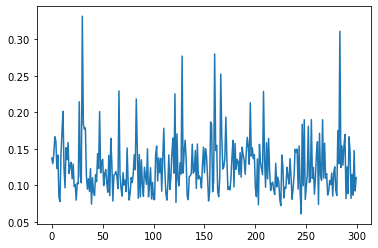

13796it [01:50, 117.44it/s]

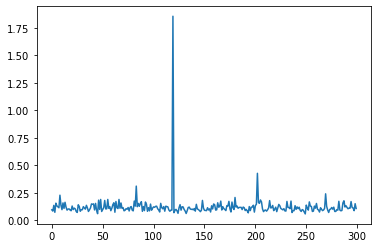

13994it [01:52, 126.63it/s]

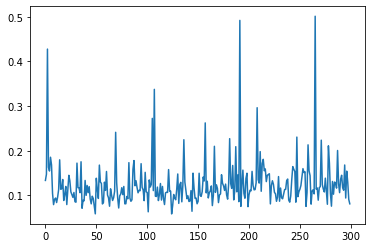

14200it [01:53, 141.53it/s]

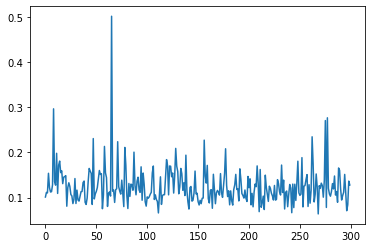

14395it [01:55, 141.70it/s]

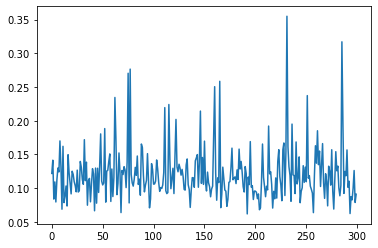

14590it [01:56, 142.31it/s]

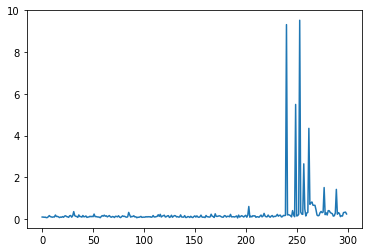

14800it [01:58, 142.83it/s]

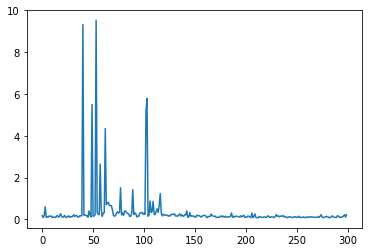

14995it [01:59, 140.98it/s]

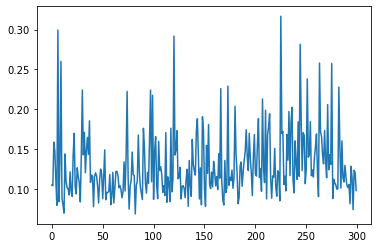

15190it [02:01, 142.51it/s]

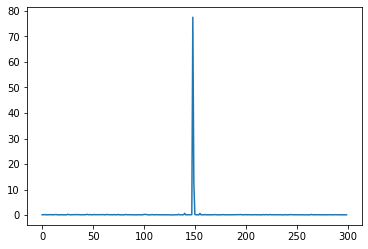

15399it [02:02, 142.08it/s]

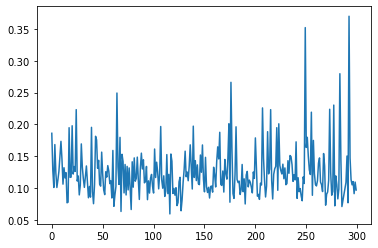

15594it [02:04, 142.27it/s]

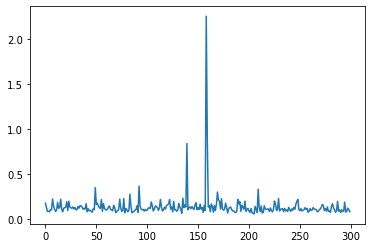

15789it [02:05, 141.53it/s]

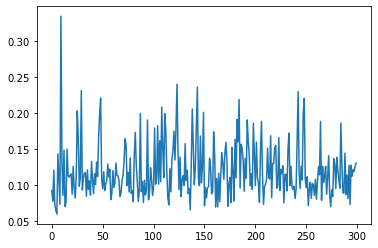

15998it [02:07, 142.14it/s]

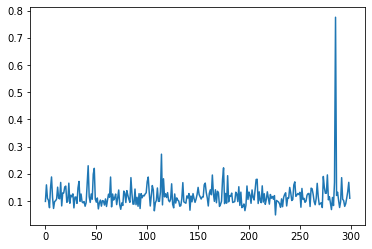

16193it [02:08, 141.90it/s]

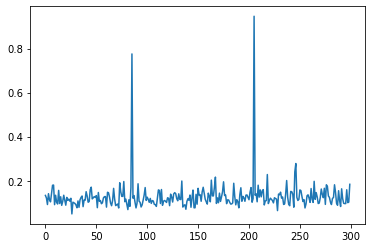

16388it [02:10, 142.92it/s]

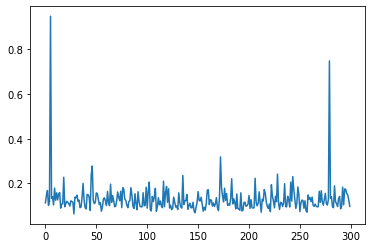

16598it [02:12, 142.44it/s]

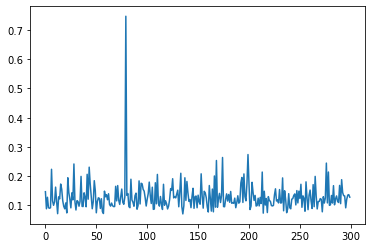

16791it [02:13, 142.98it/s]

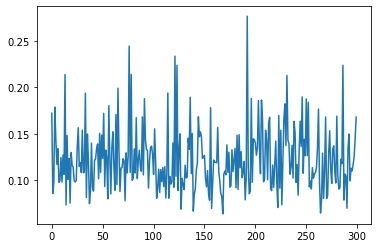

16986it [02:14, 142.47it/s]

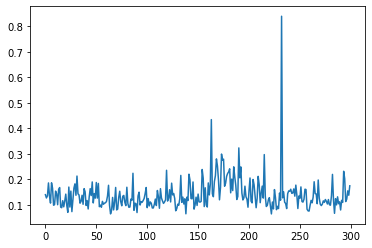

17196it [02:16, 141.86it/s]

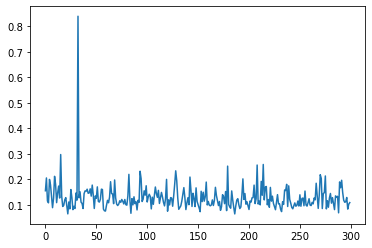

17391it [02:17, 140.89it/s]

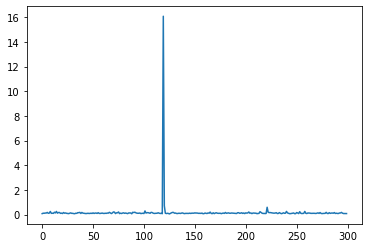

17586it [02:19, 142.77it/s]

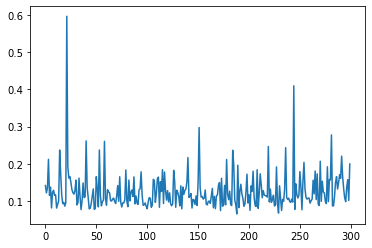

17796it [02:21, 141.67it/s]

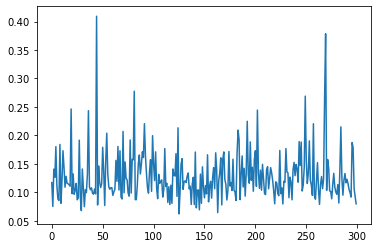

17990it [02:22, 142.78it/s]

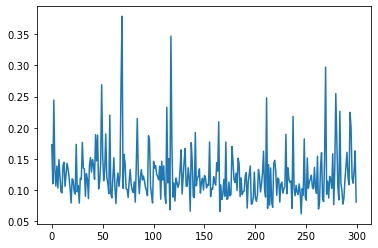

18200it [02:24, 142.34it/s]

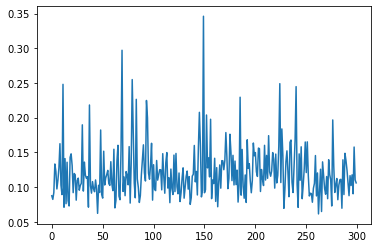

18395it [02:25, 142.74it/s]

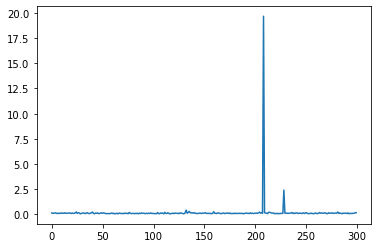

18590it [02:27, 141.56it/s]

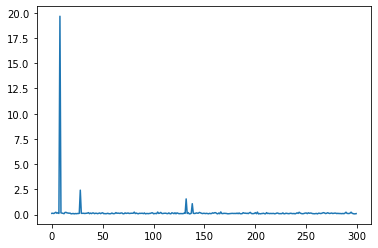

18800it [02:28, 143.80it/s]

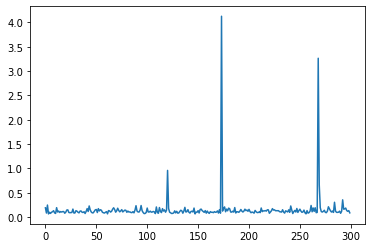

18995it [02:30, 142.26it/s]

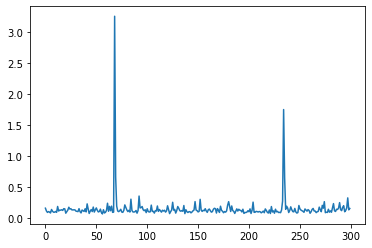

19189it [02:31, 142.77it/s]

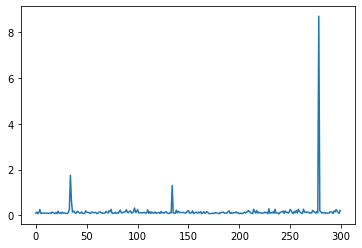

19399it [02:33, 142.08it/s]

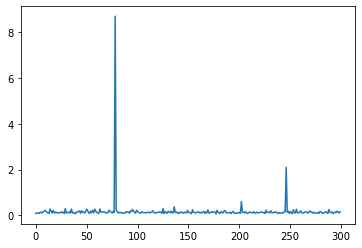

19594it [02:34, 142.80it/s]

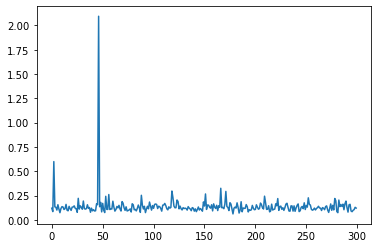

19789it [02:36, 143.20it/s]

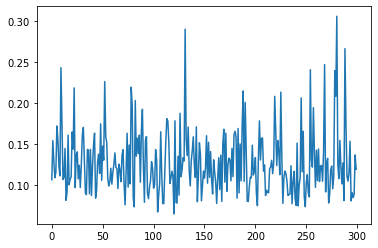

19999it [02:37, 142.77it/s]

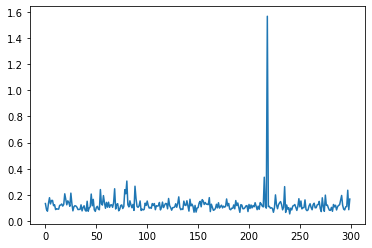

20193it [02:39, 143.46it/s]

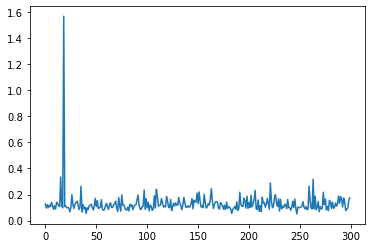

20388it [02:40, 142.96it/s]

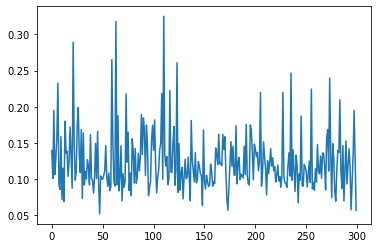

20598it [02:42, 141.43it/s]

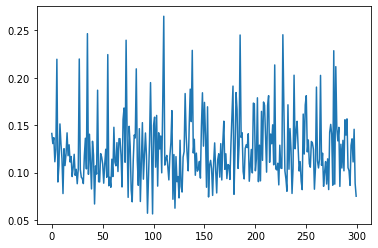

20793it [02:43, 143.64it/s]

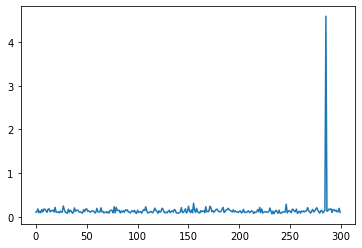

20988it [02:45, 144.20it/s]

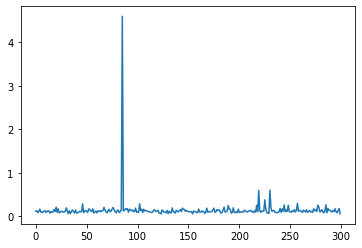

21198it [02:46, 142.44it/s]

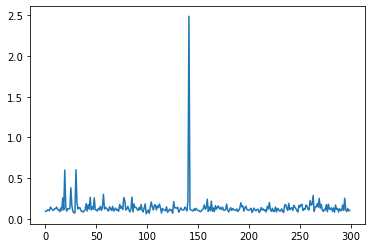

21393it [02:48, 143.84it/s]

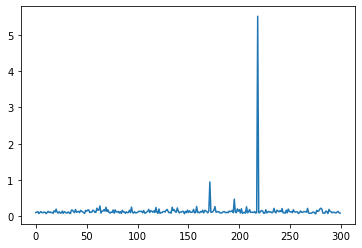

21588it [02:49, 143.36it/s]

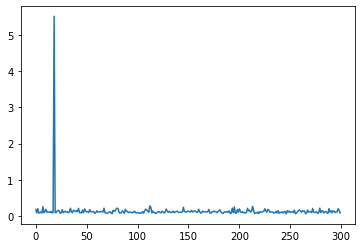

21798it [02:51, 142.81it/s]

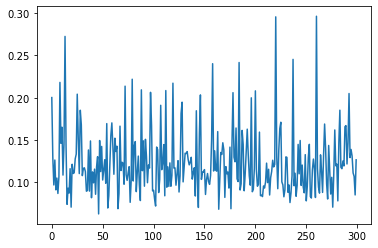

21992it [02:52, 142.89it/s]

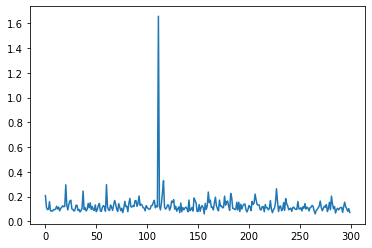

22187it [02:54, 143.59it/s]

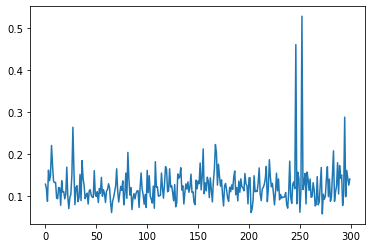

22397it [02:55, 143.01it/s]

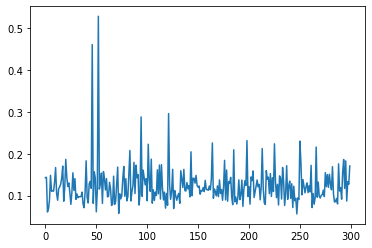

22592it [02:57, 143.36it/s]

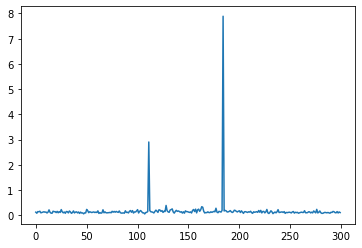

22787it [02:58, 143.13it/s]

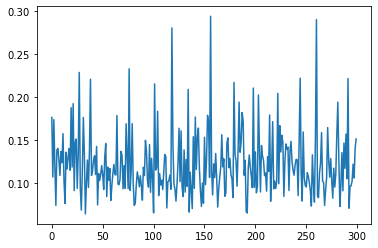

22997it [03:00, 143.93it/s]

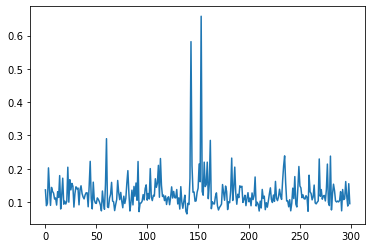

23192it [03:01, 142.73it/s]

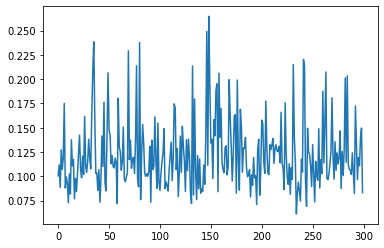

23387it [03:03, 142.61it/s]

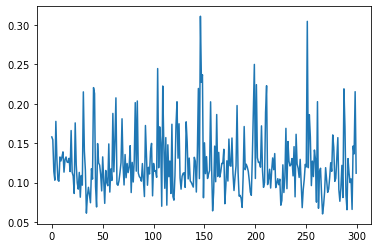

23596it [03:04, 142.52it/s]

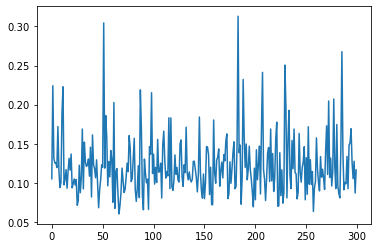

23791it [03:06, 142.83it/s]

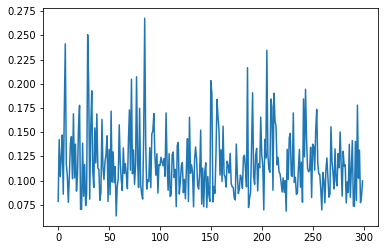

23986it [03:07, 142.37it/s]

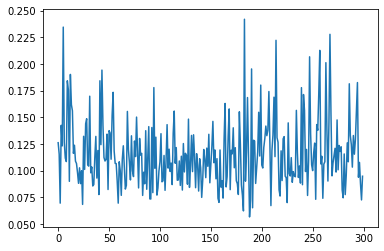

24196it [03:09, 143.17it/s]

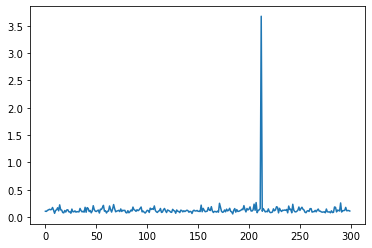

24391it [03:10, 143.26it/s]

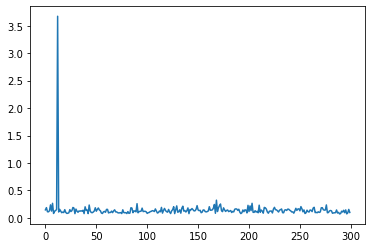

24586it [03:12, 141.55it/s]

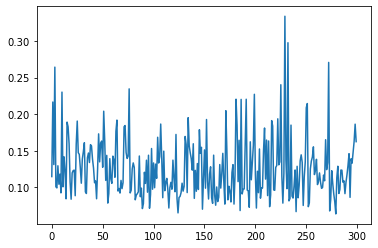

24795it [03:13, 142.94it/s]

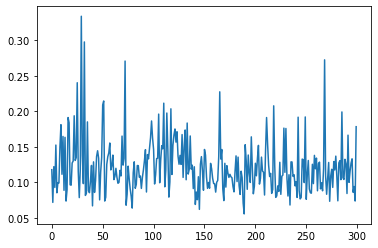

24990it [03:15, 143.46it/s]

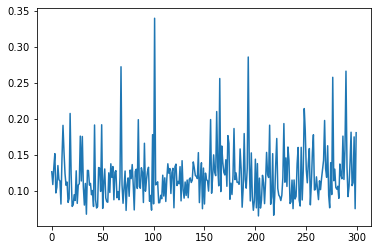

25200it [03:16, 143.88it/s]

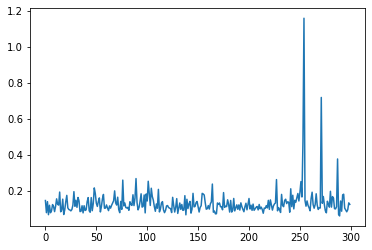

25395it [03:18, 142.49it/s]

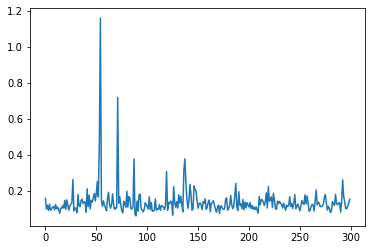

25590it [03:19, 141.51it/s]

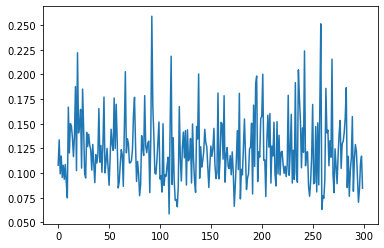

25793it [03:21, 126.13it/s]

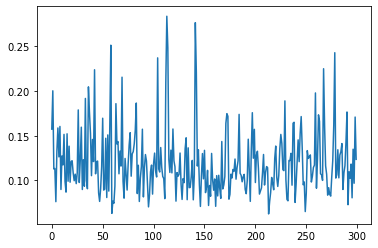

26000it [03:23, 137.58it/s]

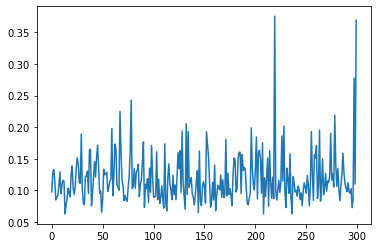

26194it [03:24, 141.65it/s]

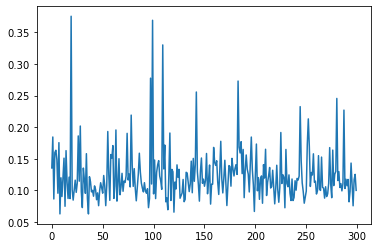

26389it [03:26, 143.78it/s]

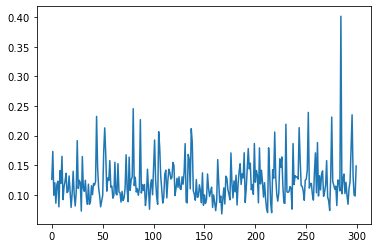

26598it [03:27, 142.47it/s]

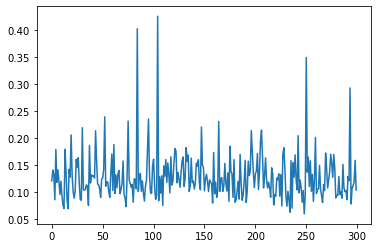

26789it [03:29, 141.72it/s]

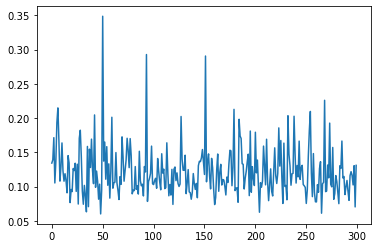

26998it [03:30, 142.19it/s]

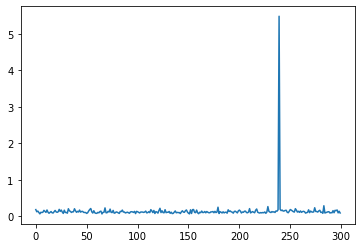

27193it [03:32, 142.72it/s]

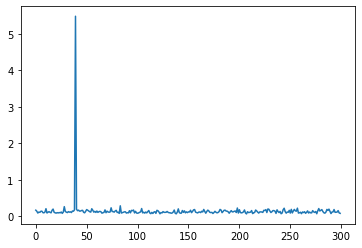

27388it [03:33, 138.06it/s]

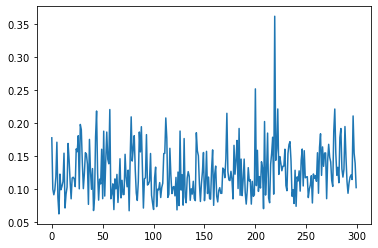

27597it [03:35, 143.62it/s]

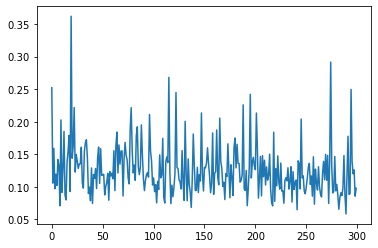

27792it [03:36, 143.49it/s]

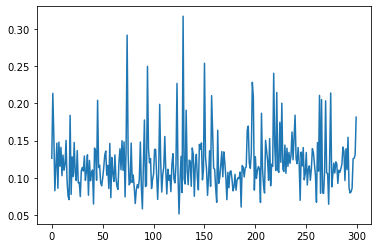

27987it [03:38, 143.49it/s]

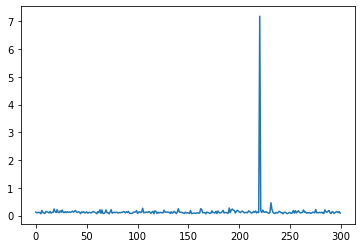

28197it [03:39, 143.26it/s]

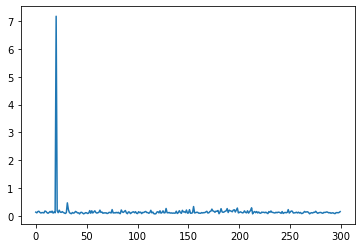

28392it [03:41, 143.89it/s]

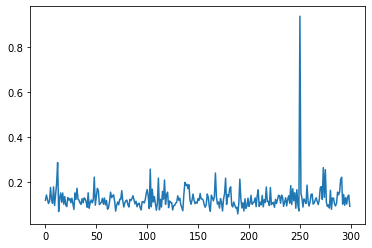

28587it [03:42, 143.08it/s]

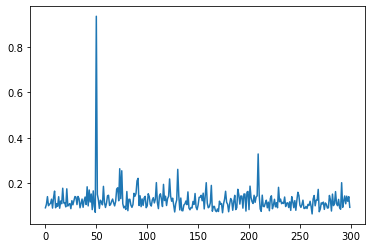

28797it [03:44, 143.41it/s]

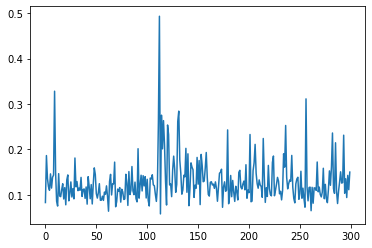

28991it [03:45, 142.01it/s]

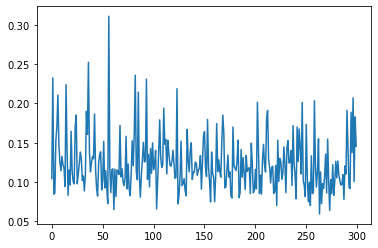

29186it [03:47, 143.40it/s]

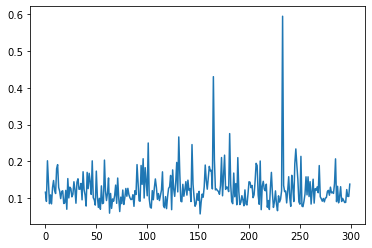

29396it [03:48, 143.68it/s]

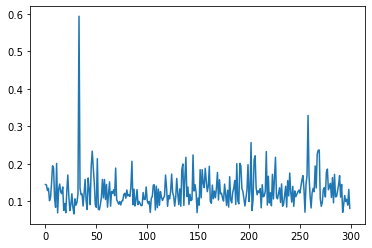

29591it [03:50, 143.45it/s]

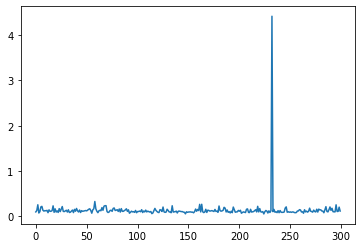

29786it [03:51, 142.62it/s]

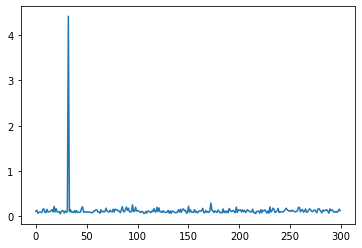

29996it [03:53, 143.28it/s]

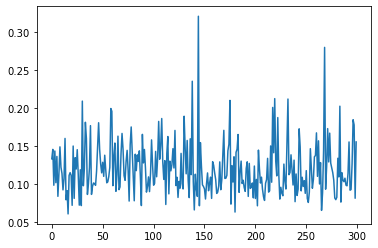

30191it [03:54, 143.05it/s]

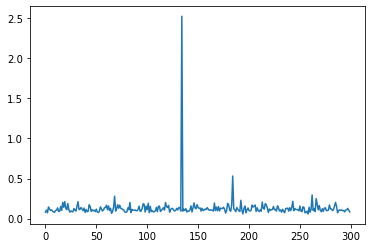

30386it [03:56, 143.34it/s]

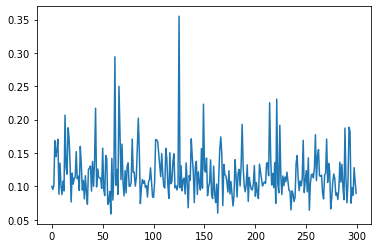

30596it [03:57, 143.57it/s]

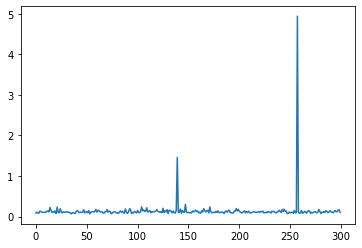

30791it [03:59, 143.70it/s]

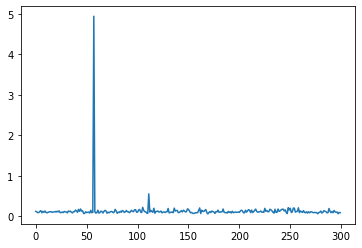

30986it [04:00, 143.26it/s]

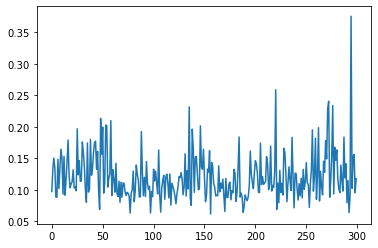

31195it [04:02, 142.72it/s]

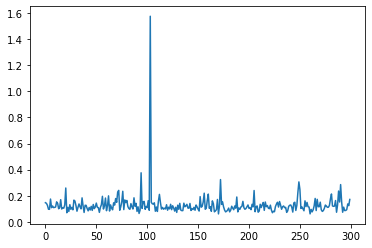

31390it [04:03, 143.20it/s]

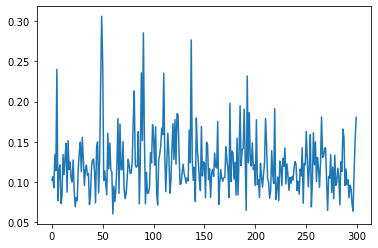

31600it [04:05, 143.90it/s]

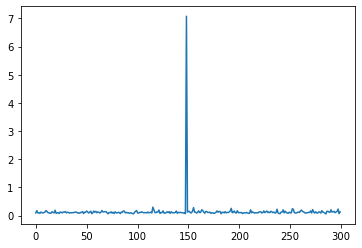

31795it [04:06, 143.49it/s]

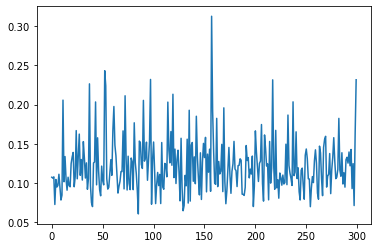

31990it [04:08, 142.96it/s]

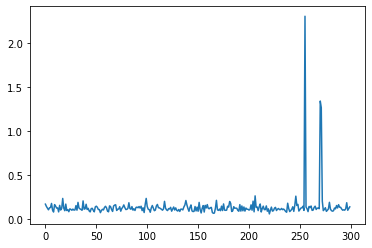

32192it [04:09, 138.03it/s]

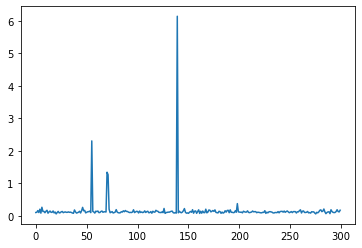

32398it [04:11, 141.96it/s]

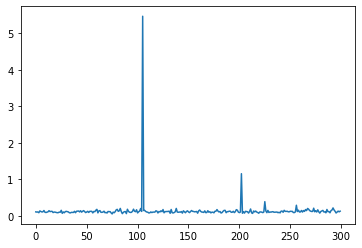

32593it [04:12, 142.38it/s]

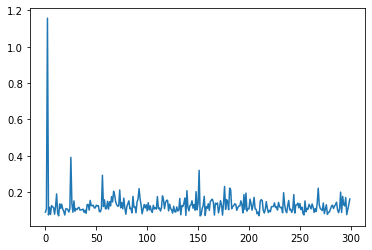

32787it [04:14, 141.79it/s]

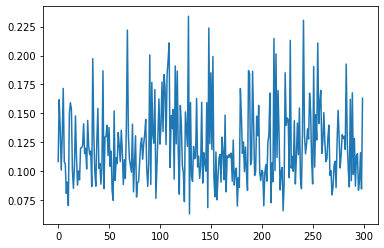

32997it [04:15, 142.15it/s]

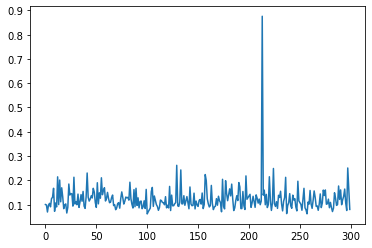

33192it [04:17, 142.23it/s]

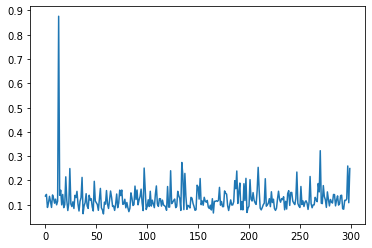

33386it [04:18, 143.10it/s]

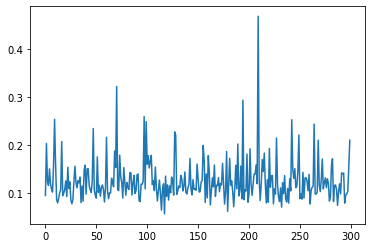

33596it [04:20, 143.21it/s]

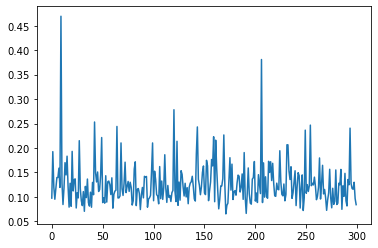

33791it [04:21, 142.71it/s]

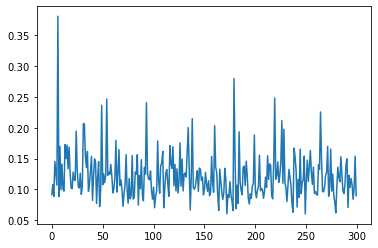

34000it [04:23, 141.97it/s]

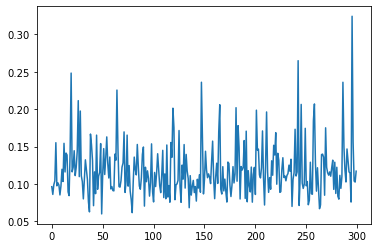

34195it [04:25, 142.15it/s]

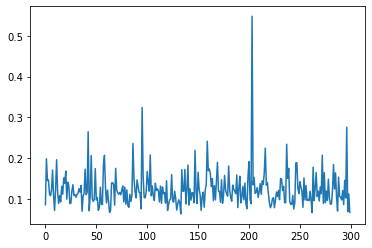

34390it [04:26, 141.68it/s]

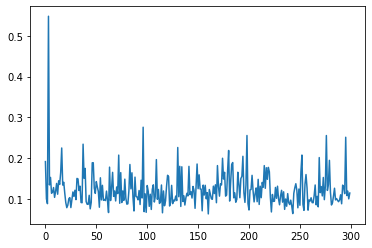

34600it [04:28, 142.82it/s]

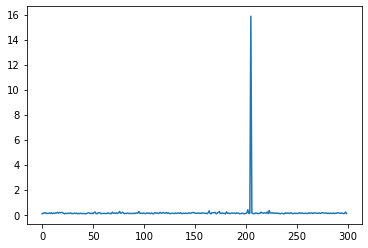

34794it [04:29, 142.68it/s]

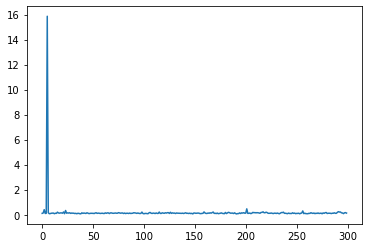

34989it [04:30, 141.93it/s]

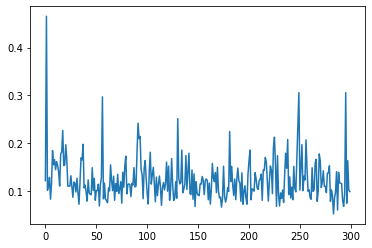

35198it [04:32, 143.47it/s]

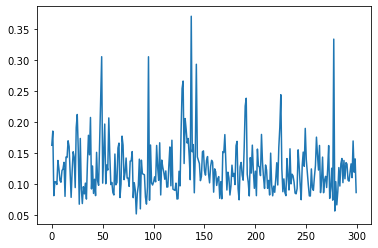

35393it [04:34, 142.27it/s]

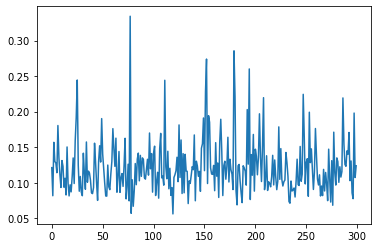

35587it [04:35, 142.94it/s]

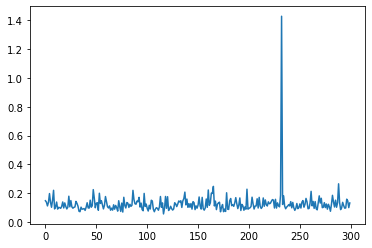

35797it [04:37, 143.66it/s]

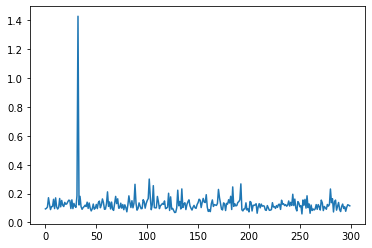

35992it [04:38, 143.19it/s]

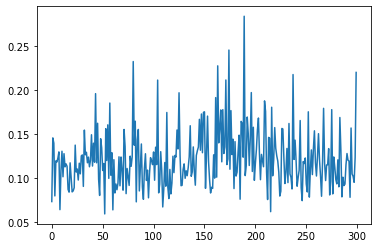

36187it [04:39, 142.89it/s]

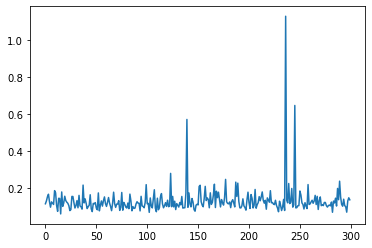

36396it [04:41, 143.13it/s]

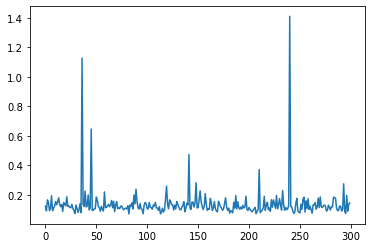

36590it [04:43, 143.59it/s]

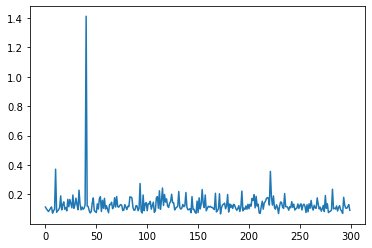

36799it [04:44, 143.37it/s]

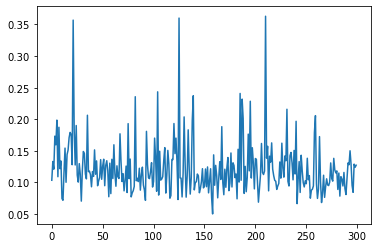

36993it [04:46, 143.60it/s]

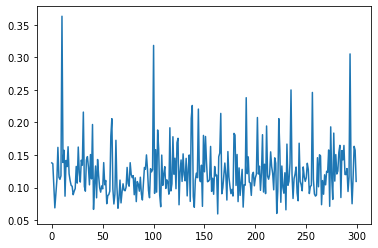

37188it [04:47, 142.35it/s]

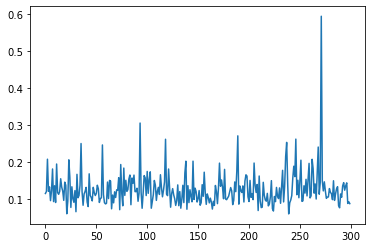

37398it [04:49, 143.85it/s]

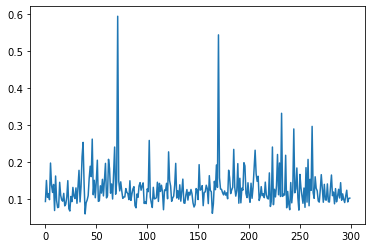

37593it [04:50, 143.40it/s]

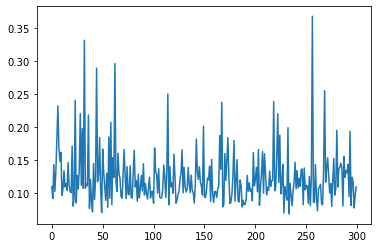

37788it [04:52, 143.69it/s]

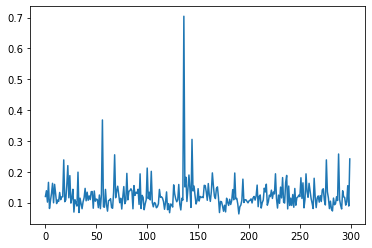

37998it [04:53, 142.80it/s]

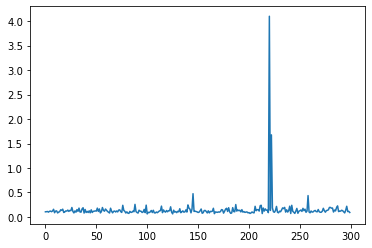

38193it [04:55, 142.85it/s]

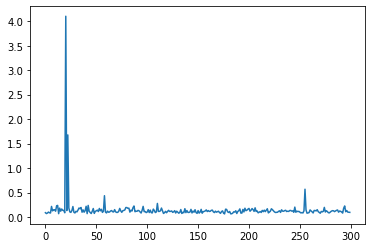

38386it [04:56, 143.42it/s]

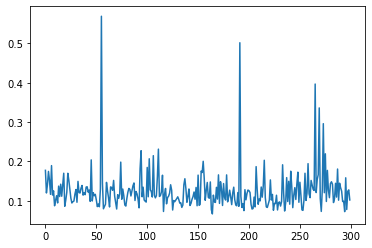

38596it [04:58, 143.65it/s]

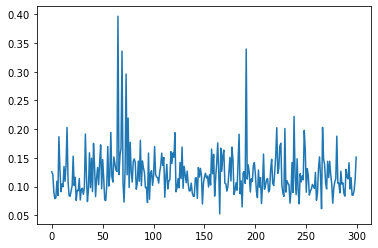

38791it [04:59, 143.14it/s]

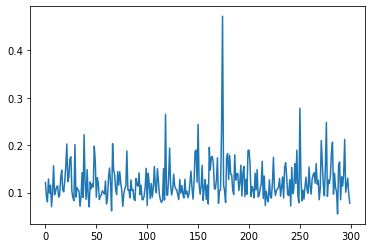

38986it [05:01, 143.16it/s]

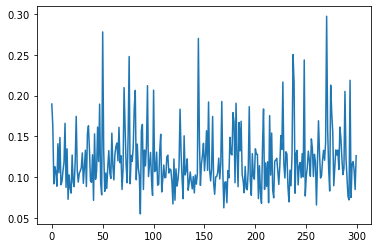

39196it [05:02, 143.78it/s]

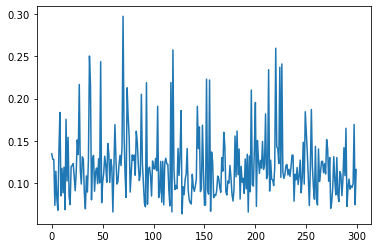

39391it [05:04, 142.97it/s]

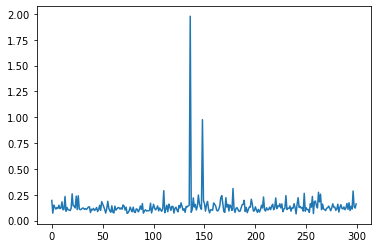

39600it [05:05, 143.03it/s]

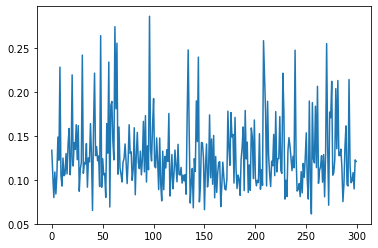

39795it [05:07, 144.18it/s]

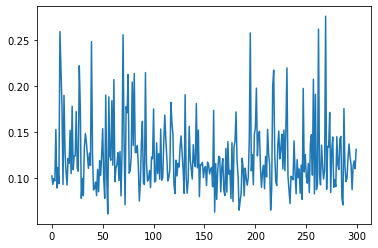

39990it [05:08, 143.76it/s]

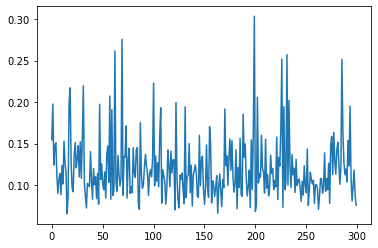

40200it [05:10, 143.63it/s]

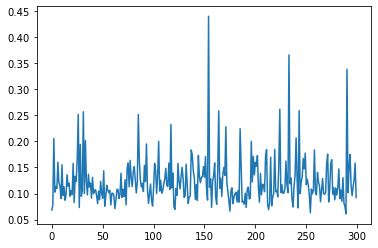

40395it [05:11, 143.04it/s]

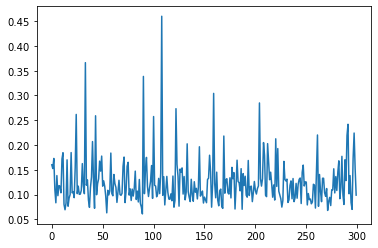

40590it [05:13, 141.26it/s]

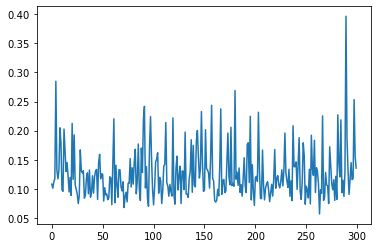

40799it [05:14, 143.57it/s]

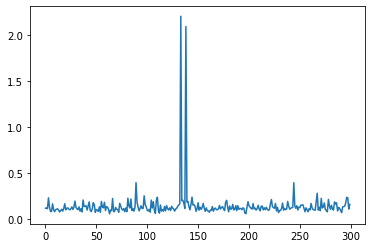

40994it [05:16, 142.87it/s]

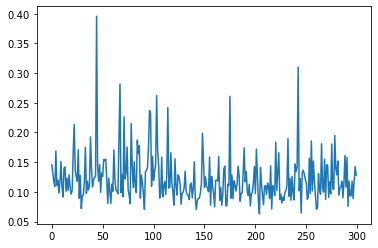

41188it [05:17, 142.90it/s]

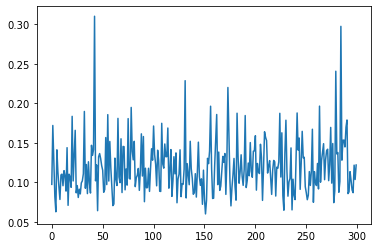

41398it [05:19, 143.04it/s]

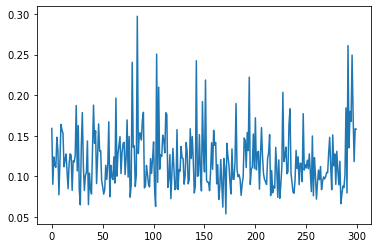

41593it [05:20, 131.64it/s]

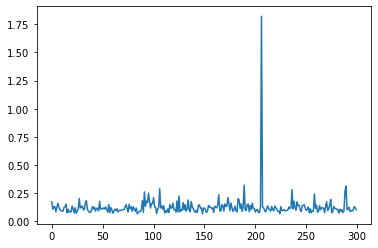

41800it [05:22, 124.22it/s]

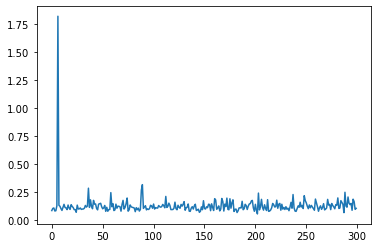

41990it [05:24, 142.62it/s]

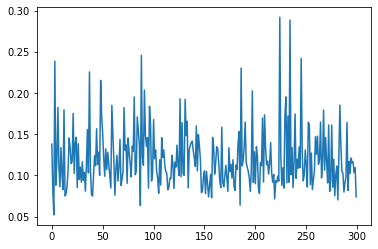

42200it [05:25, 140.89it/s]

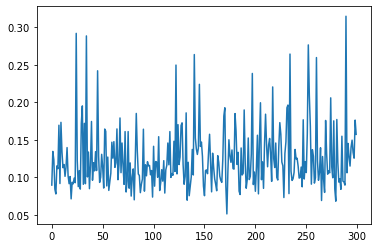

42395it [05:27, 142.89it/s]

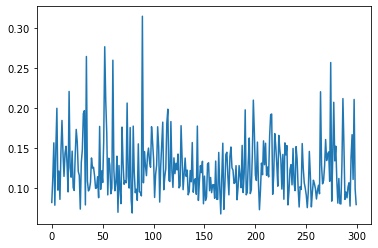

42590it [05:28, 143.14it/s]

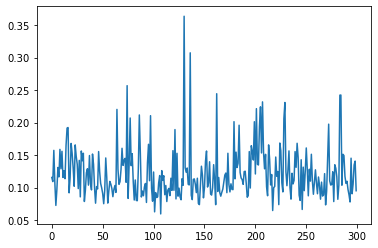

42800it [05:30, 143.01it/s]

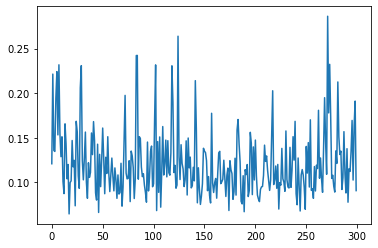

42995it [05:31, 143.36it/s]

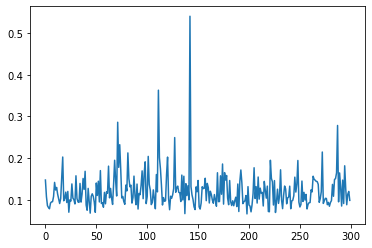

43190it [05:33, 143.62it/s]

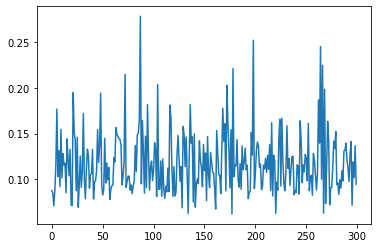

43400it [05:34, 143.55it/s]

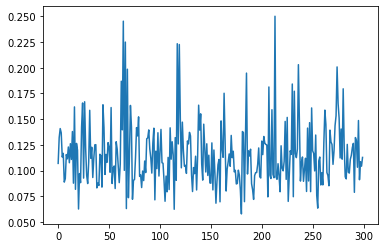

43595it [05:36, 142.83it/s]

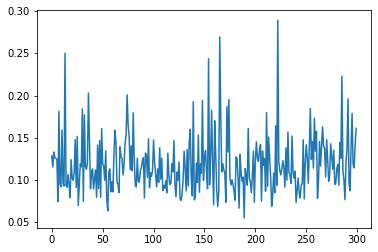

43790it [05:37, 143.81it/s]

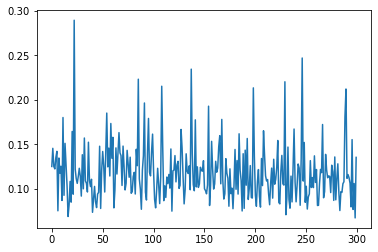

43998it [05:39, 143.57it/s]

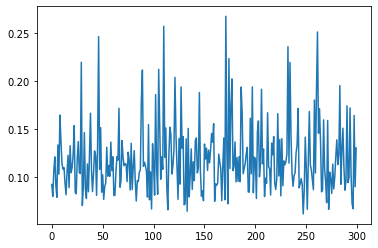

44193it [05:40, 143.16it/s]

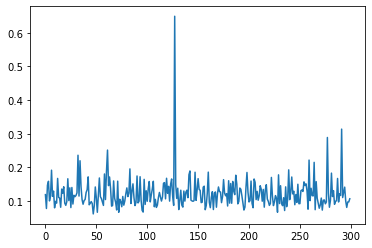

44388it [05:42, 143.79it/s]

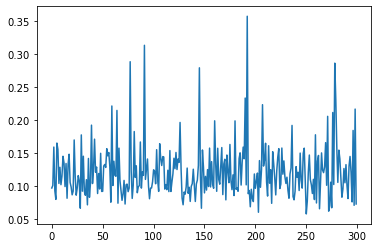

44598it [05:43, 142.82it/s]

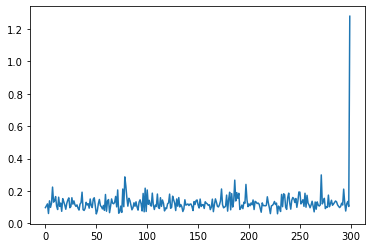

44793it [05:45, 136.90it/s]

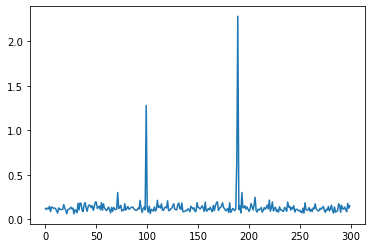

44986it [05:46, 142.81it/s]

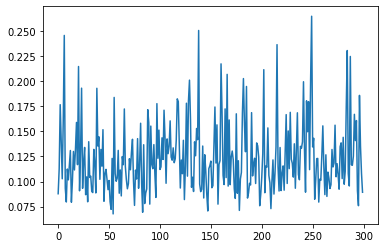

45196it [05:48, 143.14it/s]

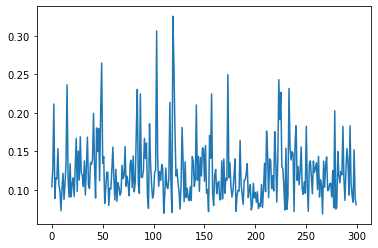

45391it [05:49, 143.36it/s]

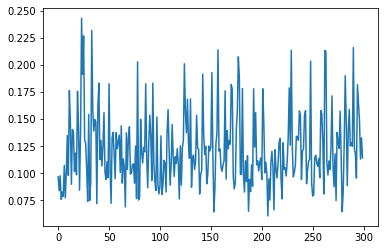

45586it [05:51, 142.12it/s]

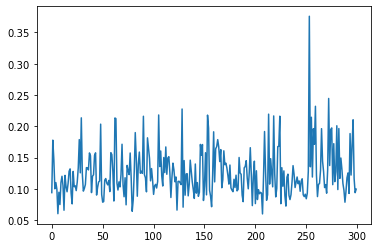

45796it [05:52, 142.64it/s]

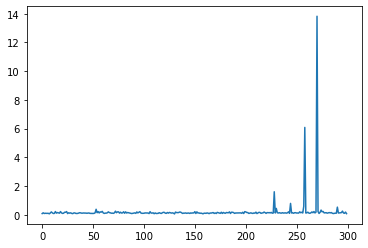

45991it [05:54, 142.64it/s]

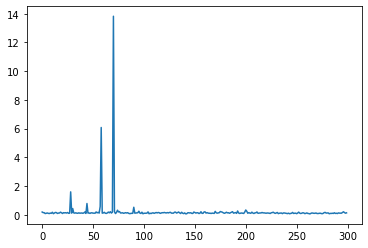

46186it [05:55, 143.42it/s]

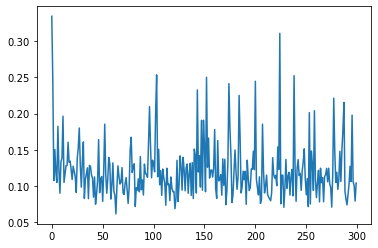

46395it [05:57, 142.90it/s]

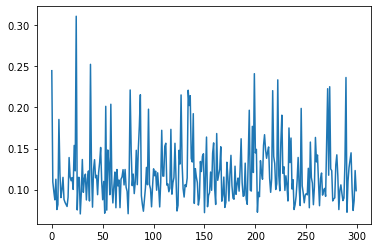

46590it [05:58, 143.15it/s]

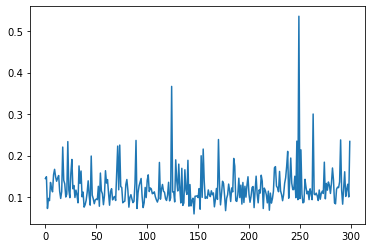

46799it [06:00, 142.84it/s]

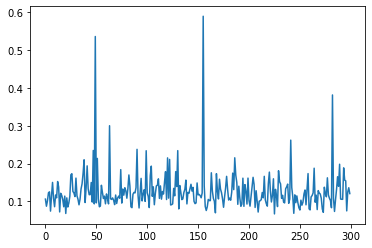

46994it [06:01, 143.00it/s]

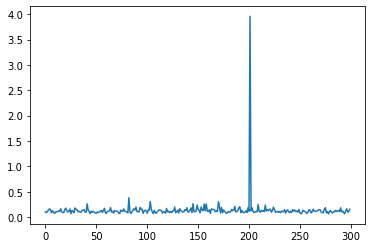

47189it [06:03, 142.81it/s]

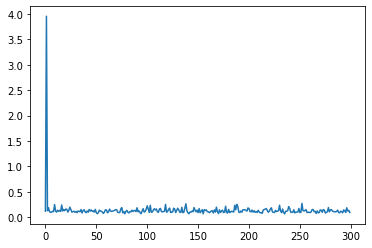

47399it [06:04, 143.71it/s]

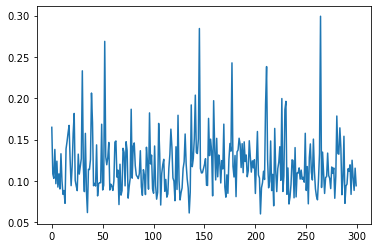

47594it [06:06, 143.07it/s]

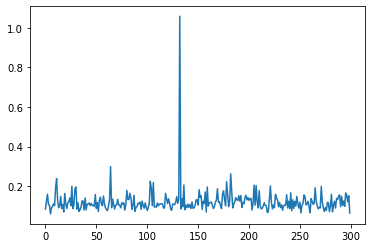

47789it [06:07, 143.24it/s]

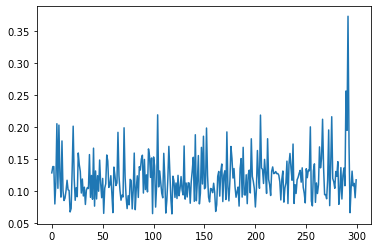

47999it [06:09, 143.01it/s]

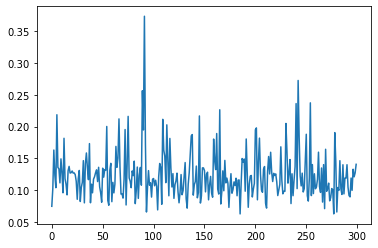

48194it [06:10, 143.34it/s]

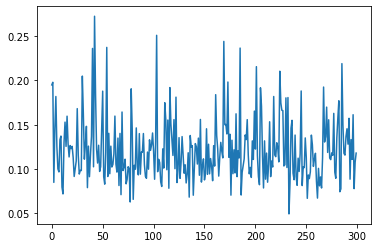

48389it [06:12, 142.59it/s]

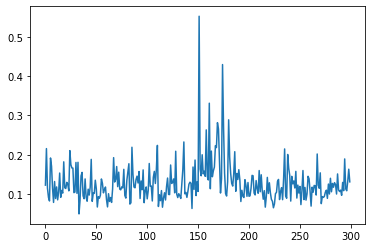

48599it [06:13, 143.59it/s]

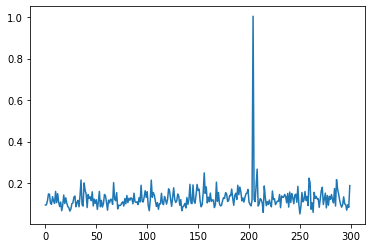

48793it [06:15, 142.88it/s]

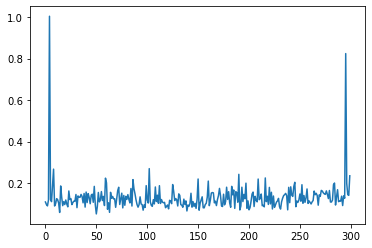

48988it [06:16, 143.27it/s]

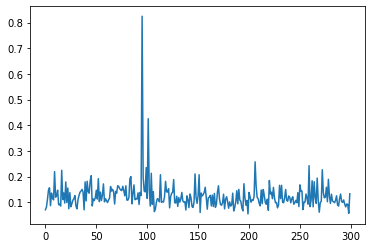

49197it [06:18, 142.73it/s]

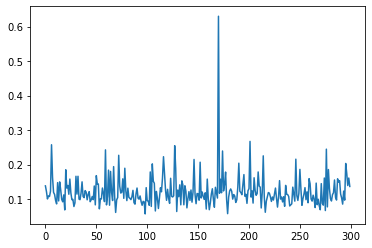

49392it [06:19, 142.97it/s]

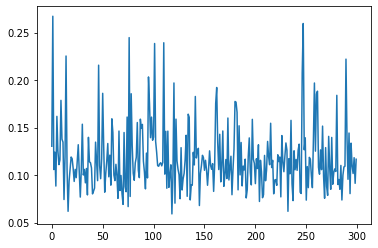

49586it [06:21, 141.92it/s]

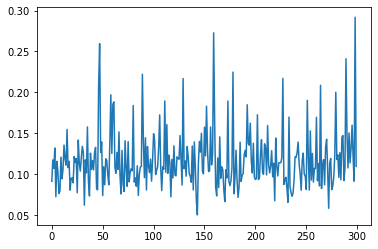

49796it [06:22, 142.58it/s]

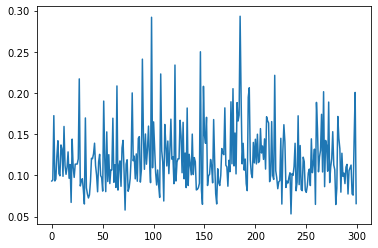

49990it [06:24, 141.68it/s]

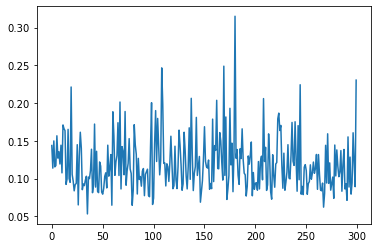

50200it [06:26, 143.38it/s]

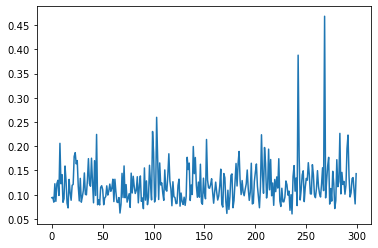

50395it [06:27, 141.92it/s]

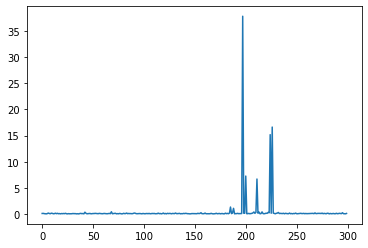

50590it [06:28, 142.64it/s]

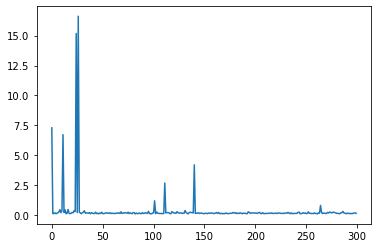

50800it [06:30, 143.50it/s]

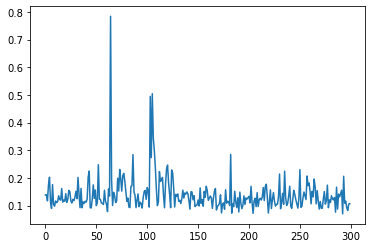

50994it [06:32, 143.02it/s]

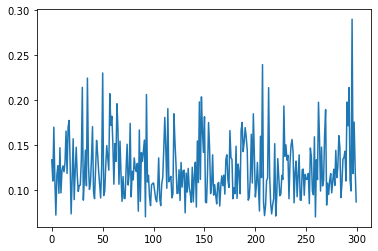

51189it [06:33, 142.65it/s]

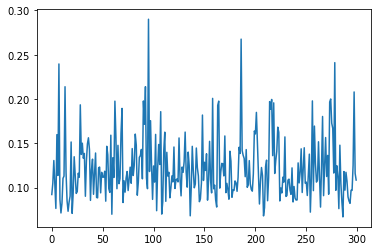

51399it [06:35, 143.65it/s]

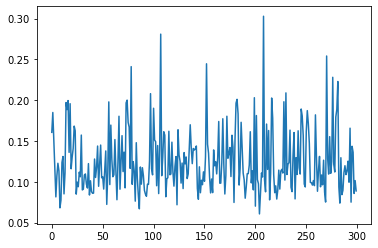

51593it [06:36, 142.25it/s]

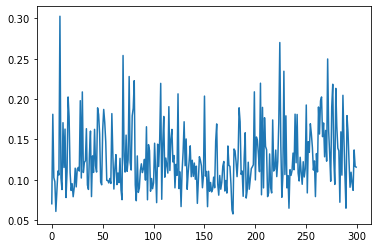

51788it [06:37, 143.38it/s]

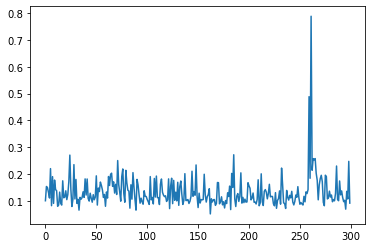

51998it [06:39, 143.30it/s]

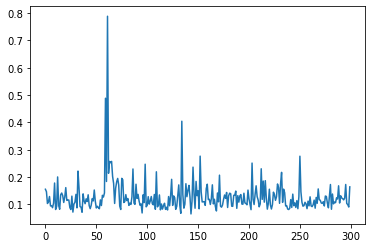

52193it [06:40, 143.05it/s]

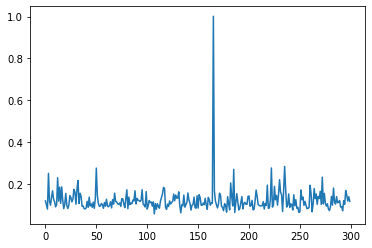

52388it [06:42, 141.65it/s]

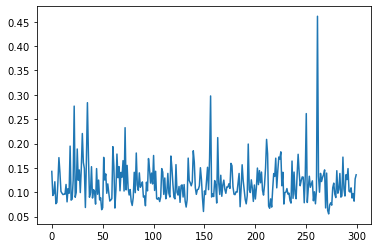

52597it [06:44, 142.46it/s]

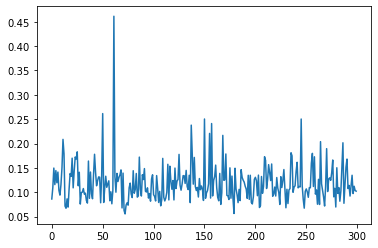

52791it [06:45, 141.83it/s]

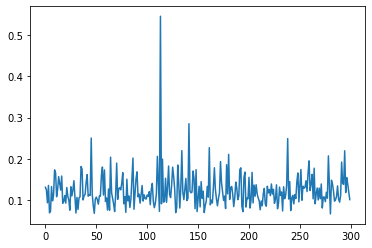

52986it [06:46, 143.16it/s]

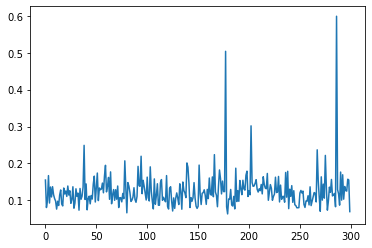

53193it [06:48, 142.86it/s]

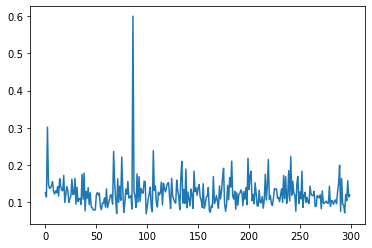

53388it [06:50, 143.43it/s]

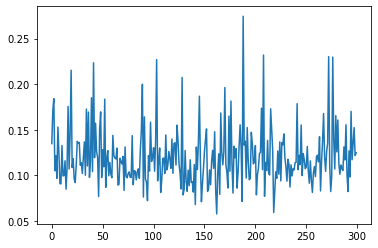

53597it [06:51, 143.18it/s]

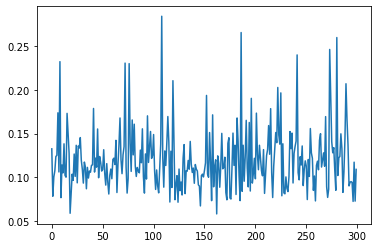

53792it [06:53, 142.42it/s]

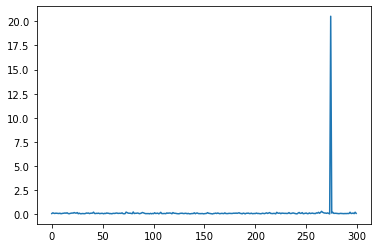

53986it [06:54, 143.27it/s]

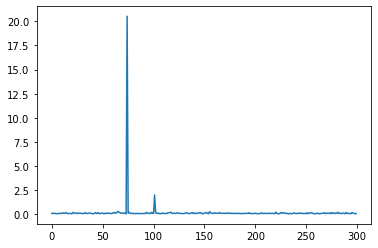

54195it [06:56, 143.05it/s]

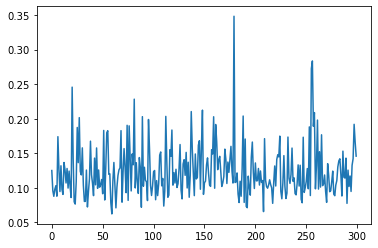

54389it [06:57, 143.05it/s]

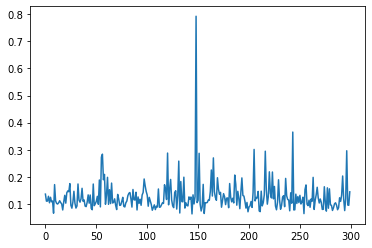

54599it [06:59, 143.82it/s]

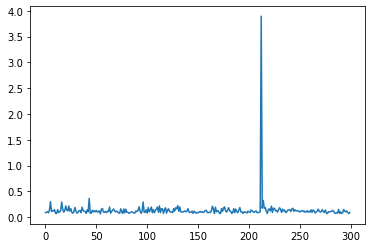

54794it [07:00, 142.84it/s]

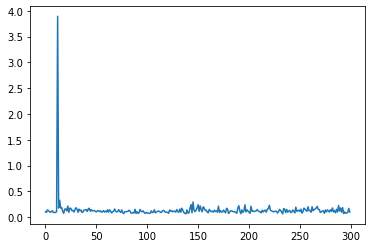

54989it [07:02, 143.26it/s]

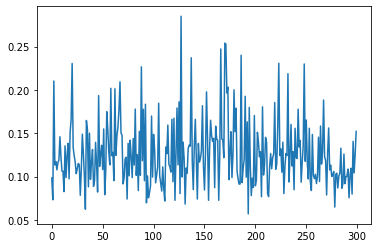

55198it [07:03, 143.44it/s]

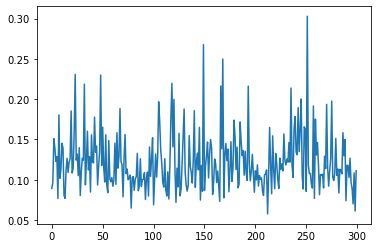

55393it [07:05, 143.08it/s]

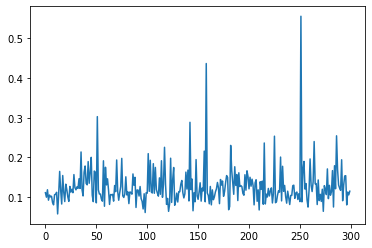

55588it [07:06, 143.07it/s]

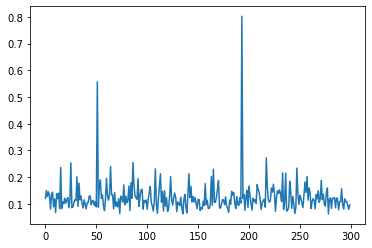

55798it [07:08, 143.62it/s]

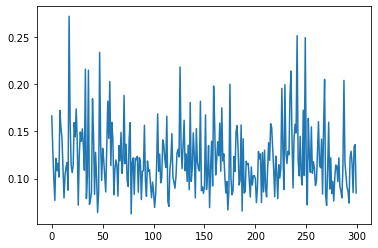

55993it [07:09, 144.05it/s]

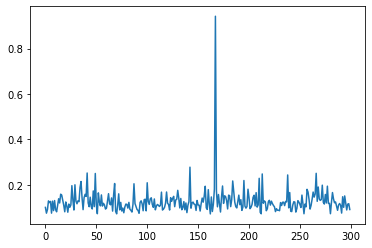

56188it [07:11, 142.41it/s]

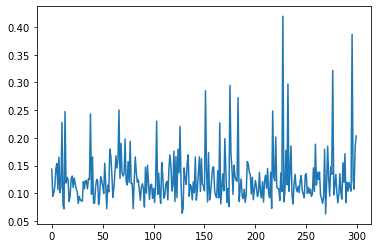

56398it [07:12, 142.74it/s]

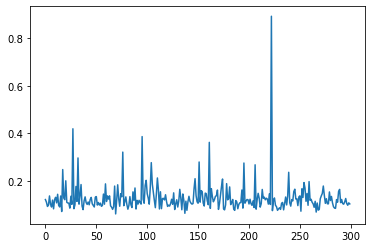

56592it [07:14, 143.82it/s]

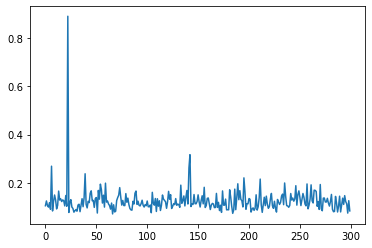

56787it [07:15, 143.14it/s]

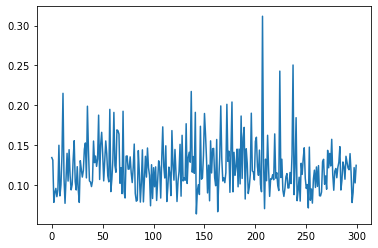

56997it [07:17, 143.69it/s]

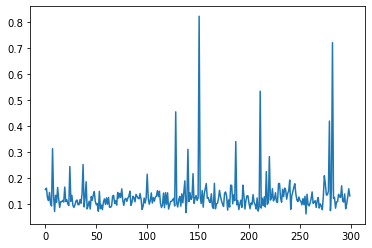

57190it [07:18, 142.72it/s]

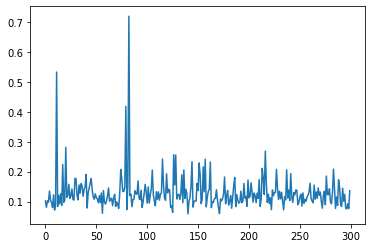

57400it [07:20, 143.14it/s]

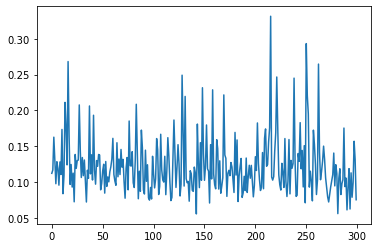

57593it [07:21, 115.19it/s]

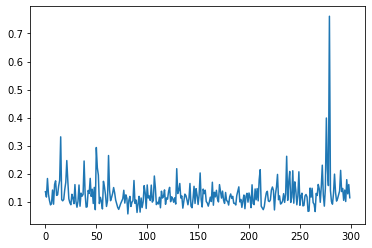

57793it [07:23, 136.13it/s]

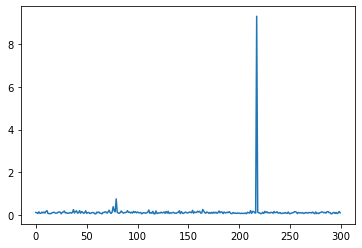

57986it [07:24, 142.10it/s]

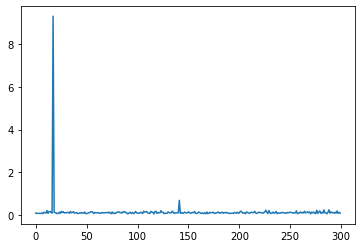

58195it [07:26, 142.90it/s]

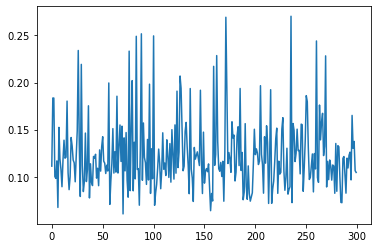

58389it [07:28, 142.78it/s]

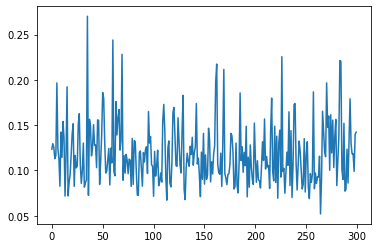

58599it [07:29, 142.83it/s]

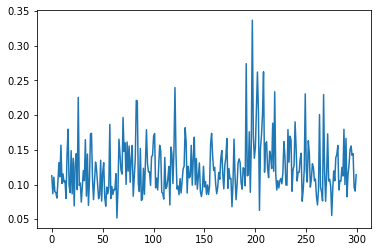

58794it [07:31, 143.39it/s]

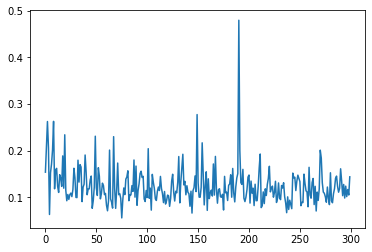

58989it [07:32, 142.81it/s]

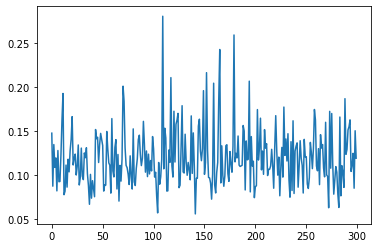

59197it [07:34, 143.01it/s]

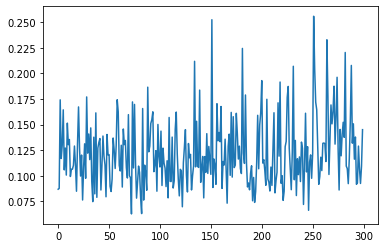

59392it [07:35, 143.57it/s]

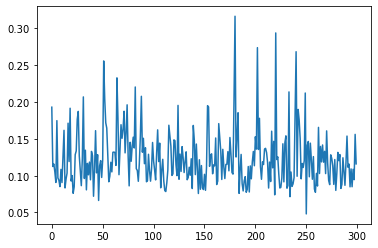

59587it [07:37, 143.36it/s]

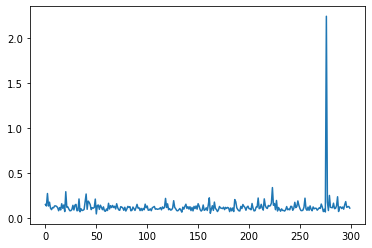

59797it [07:38, 143.19it/s]

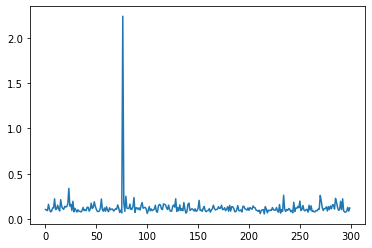

59991it [07:40, 142.92it/s]

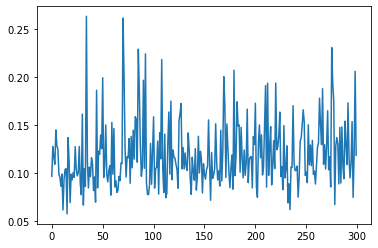

60186it [07:41, 143.08it/s]

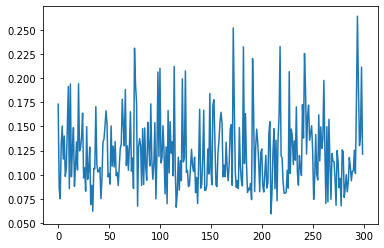

60395it [07:43, 142.88it/s]

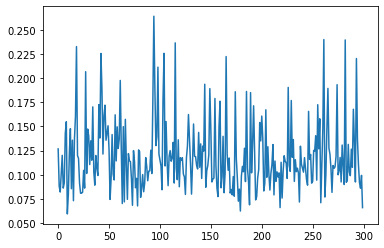

60590it [07:44, 143.14it/s]

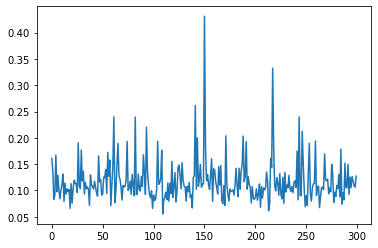

60795it [07:46, 140.78it/s]

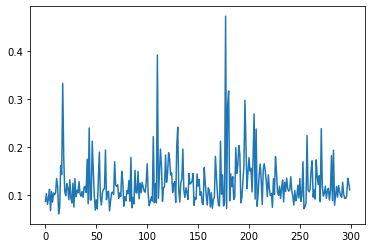

60990it [07:47, 142.81it/s]

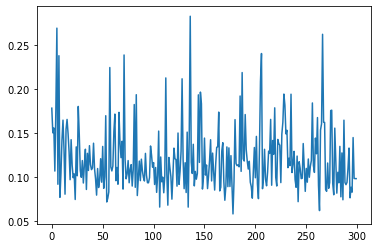

61198it [07:49, 143.73it/s]

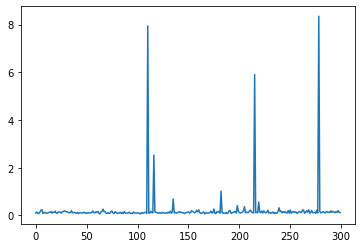

61393it [07:50, 142.67it/s]

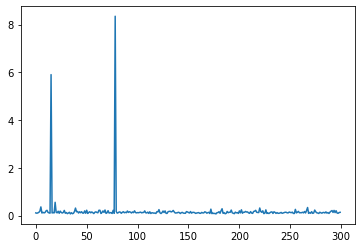

61587it [07:52, 143.61it/s]

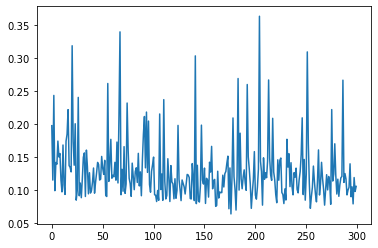

61797it [07:53, 143.26it/s]

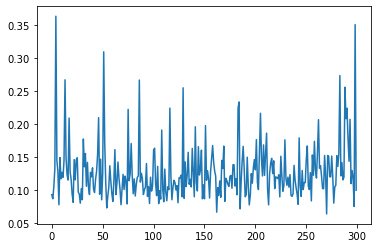

61991it [07:55, 142.83it/s]

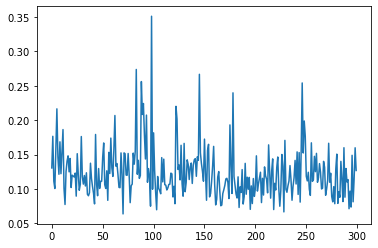

62186it [07:56, 143.27it/s]

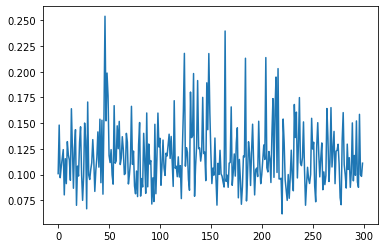

62396it [07:58, 143.20it/s]

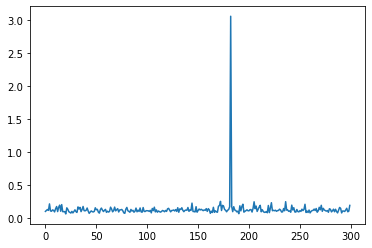

62591it [07:59, 143.90it/s]

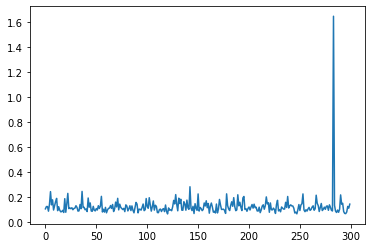

62800it [08:01, 144.02it/s]

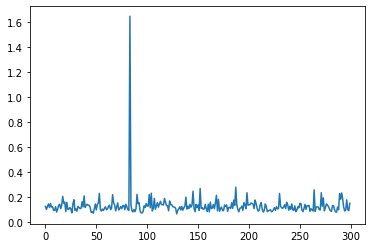

62995it [08:02, 143.19it/s]

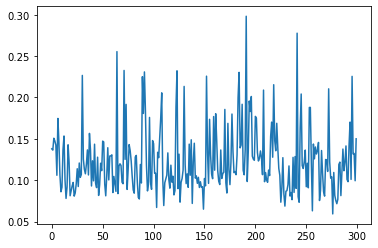

63190it [08:04, 142.99it/s]

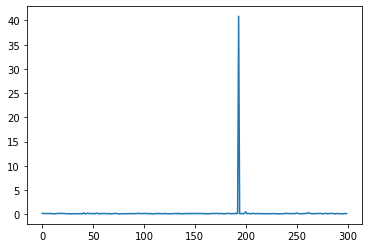

63400it [08:05, 143.52it/s]

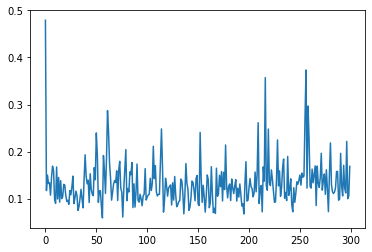

63594it [08:07, 143.22it/s]

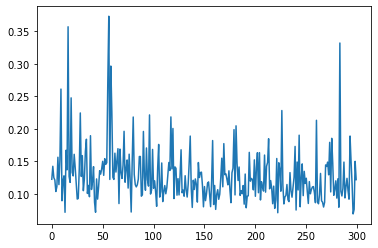

63789it [08:08, 143.42it/s]

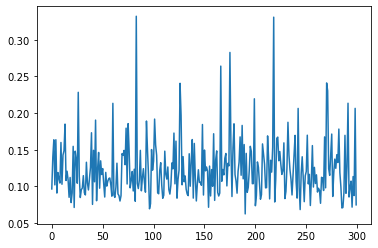

63998it [08:10, 143.55it/s]

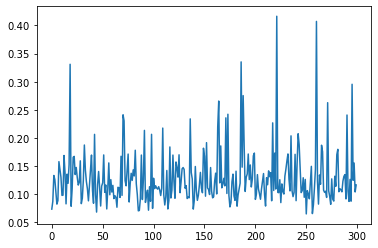

64193it [08:11, 143.42it/s]

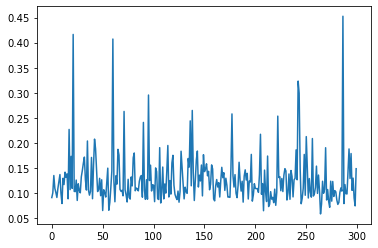

64388it [08:13, 142.23it/s]

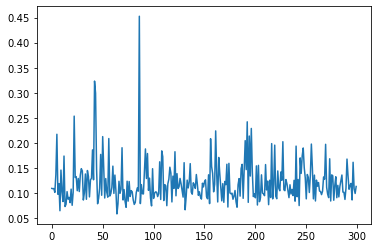

64598it [08:14, 143.76it/s]

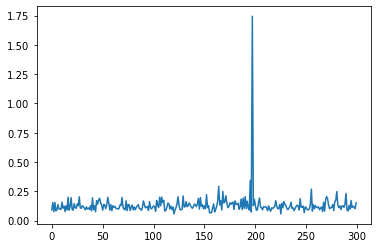

64792it [08:16, 142.49it/s]

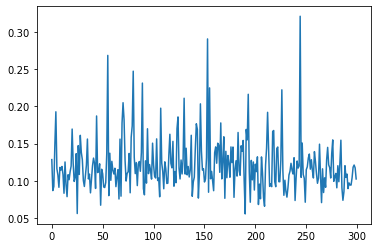

64987it [08:17, 142.42it/s]

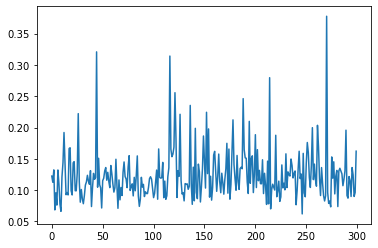

65195it [08:19, 142.58it/s]

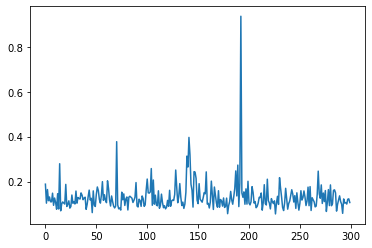

65390it [08:20, 143.35it/s]

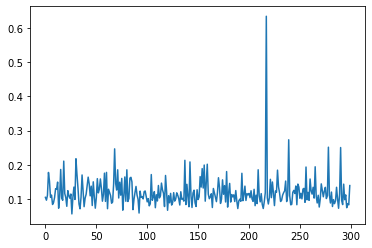

65600it [08:22, 142.94it/s]

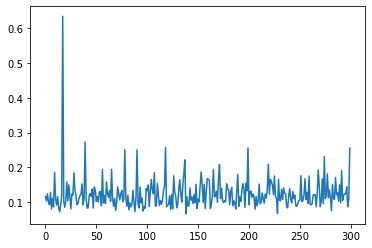

65795it [08:23, 142.90it/s]

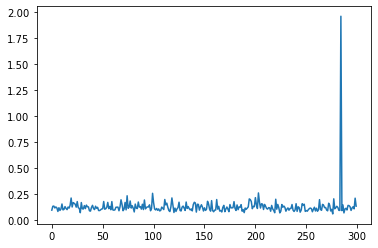

65989it [08:25, 141.87it/s]

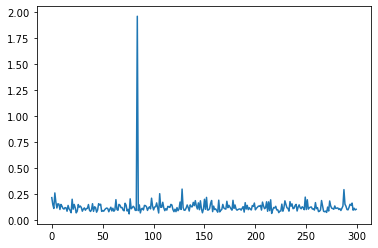

66199it [08:26, 142.89it/s]

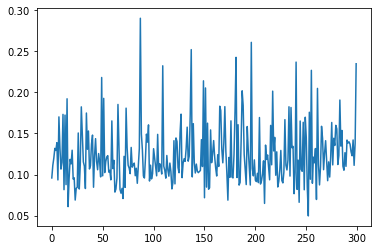

66388it [08:28, 141.38it/s]

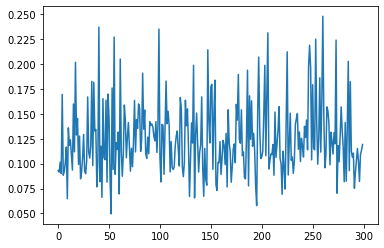

66598it [08:30, 142.82it/s]

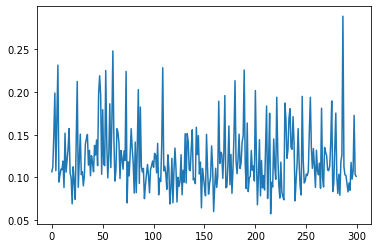

66792it [08:31, 142.18it/s]

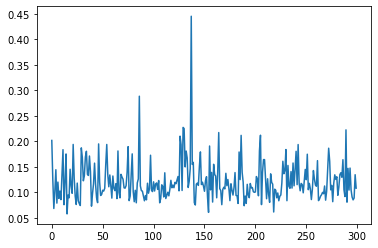

66987it [08:33, 142.48it/s]

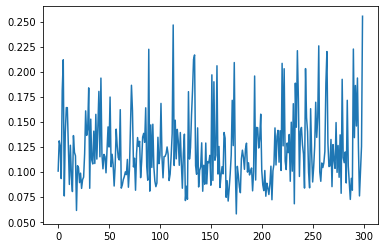

67196it [08:34, 142.58it/s]

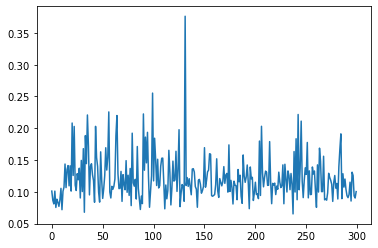

67391it [08:36, 143.48it/s]

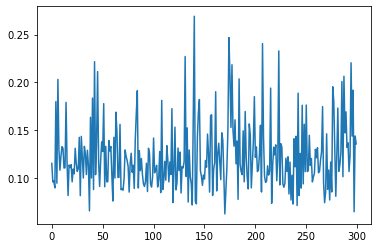

67600it [08:37, 143.43it/s]

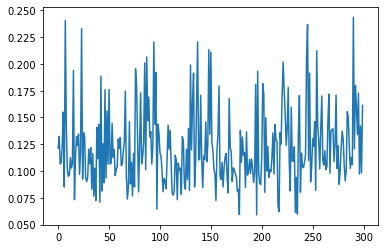

67795it [08:39, 143.06it/s]

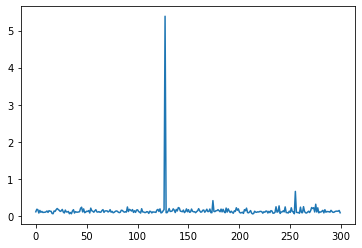

67989it [08:40, 142.94it/s]

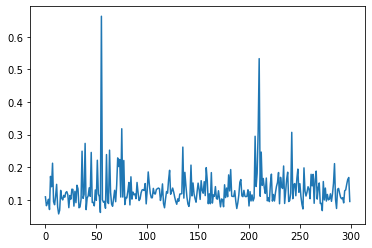

68195it [08:42, 132.62it/s]

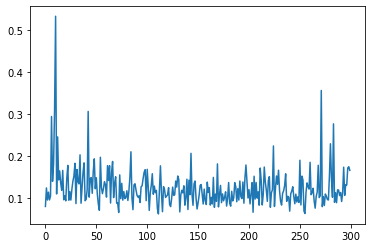

68390it [08:43, 134.30it/s]

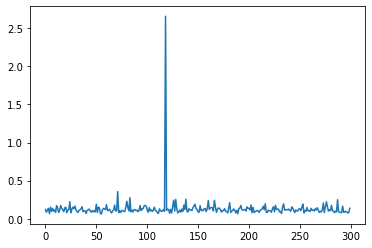

68595it [08:45, 130.58it/s]

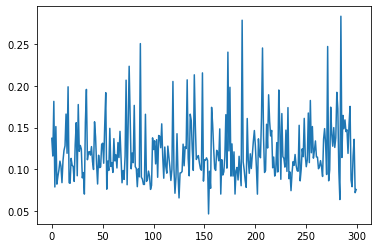

68793it [08:47, 138.81it/s]

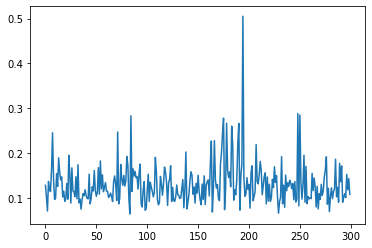

68986it [08:48, 142.71it/s]

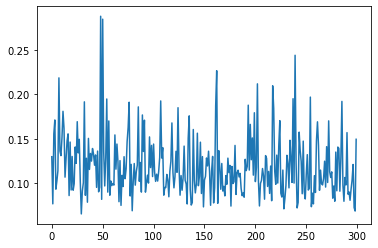

69195it [08:50, 143.25it/s]

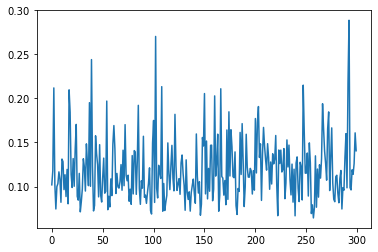

69390it [08:51, 140.83it/s]

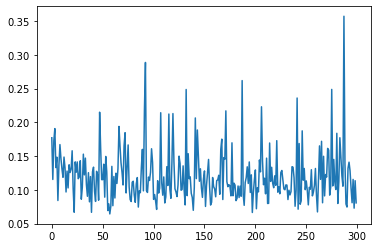

69599it [08:53, 142.40it/s]

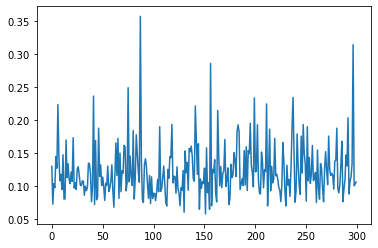

69794it [08:54, 142.22it/s]

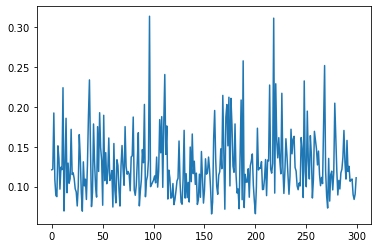

69988it [08:56, 142.08it/s]

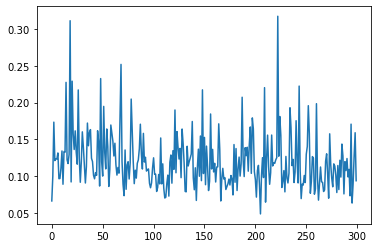

70198it [08:57, 142.51it/s]

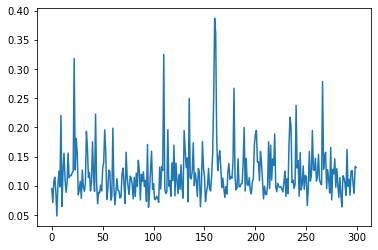

70393it [08:59, 142.23it/s]

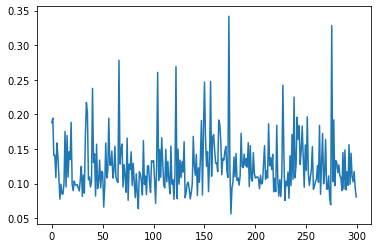

70588it [09:00, 142.22it/s]

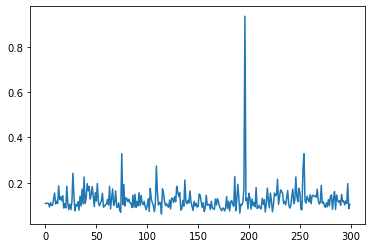

70798it [09:02, 142.39it/s]

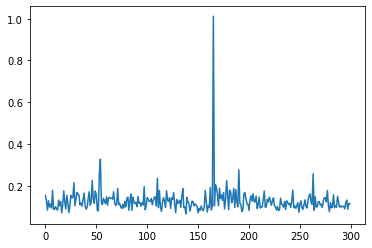

70993it [09:03, 142.19it/s]

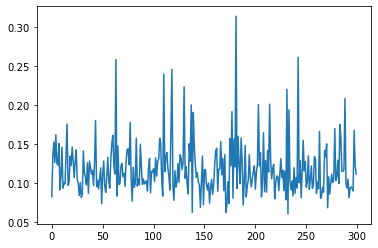

71188it [09:05, 142.65it/s]

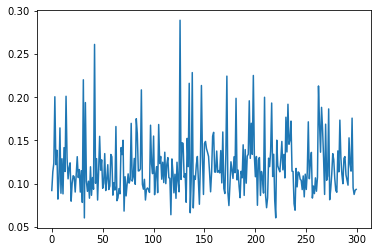

71398it [09:06, 142.58it/s]

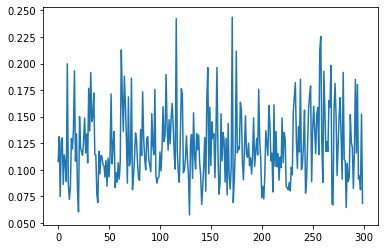

71593it [09:08, 143.13it/s]

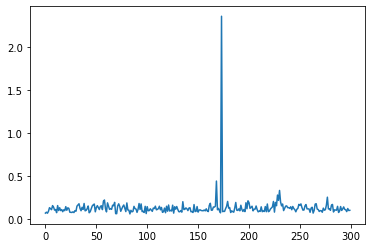

71788it [09:09, 142.54it/s]

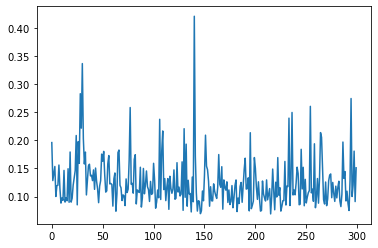

71998it [09:11, 143.20it/s]

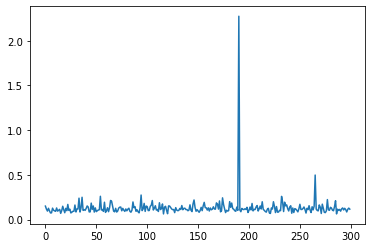

72193it [09:12, 142.22it/s]

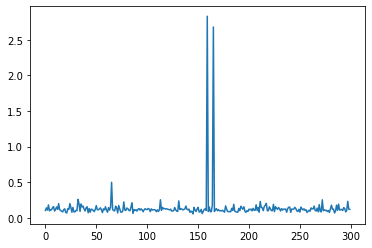

72398it [09:14, 142.04it/s]

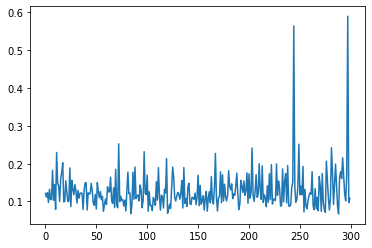

72593it [09:15, 142.72it/s]

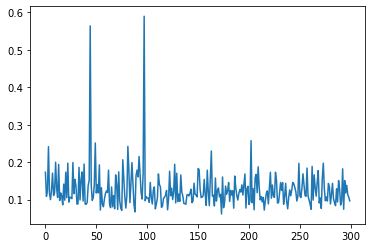

72787it [09:17, 143.26it/s]

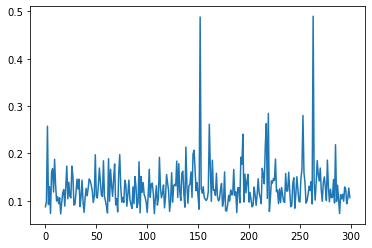

72996it [09:18, 142.47it/s]

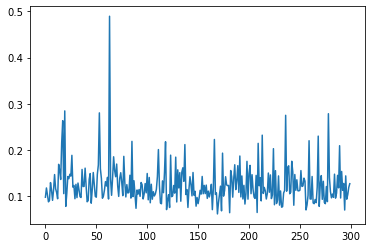

73190it [09:20, 142.32it/s]

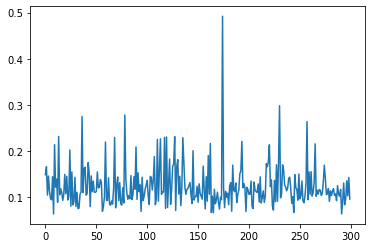

73397it [09:21, 123.64it/s]

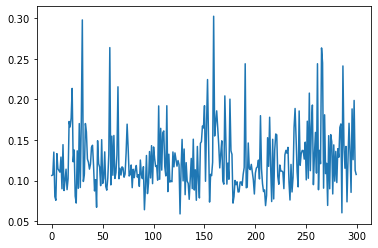

73600it [09:23, 132.35it/s]

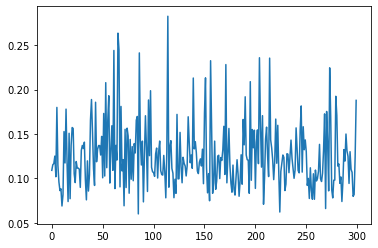

73796it [09:25, 128.47it/s]

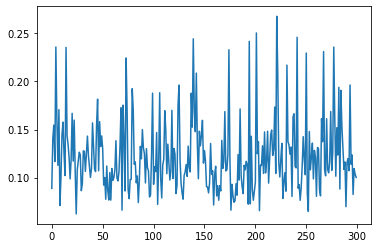

73989it [09:26, 142.49it/s]

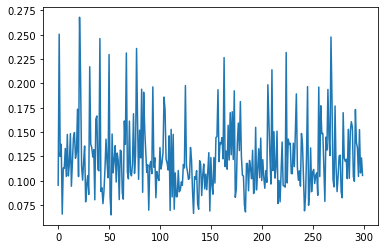

74198it [09:28, 139.59it/s]

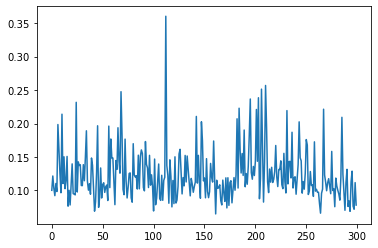

74392it [09:29, 142.66it/s]

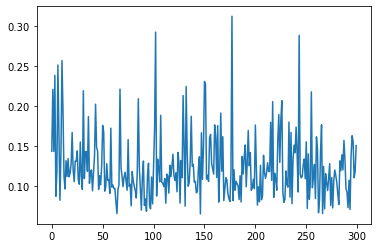

74587it [09:31, 139.20it/s]

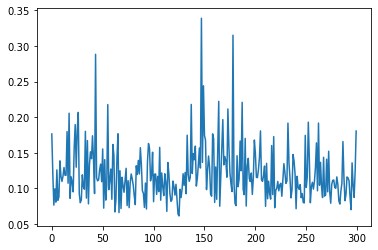

74796it [09:32, 139.13it/s]

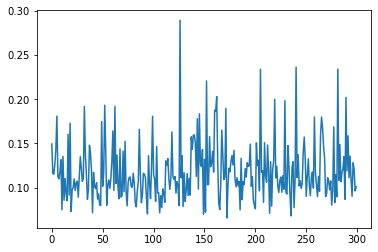

74989it [09:34, 141.16it/s]

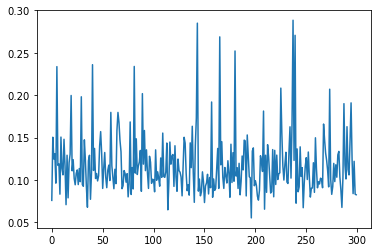

75197it [09:36, 141.87it/s]

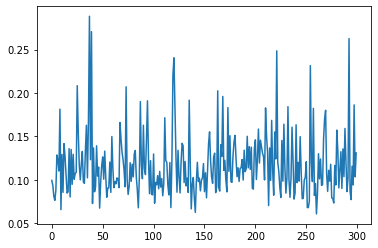

75392it [09:37, 141.00it/s]

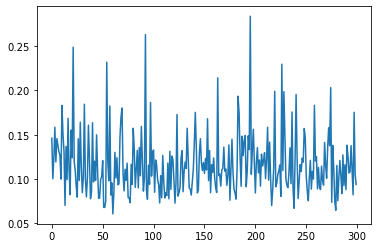

75587it [09:38, 142.78it/s]

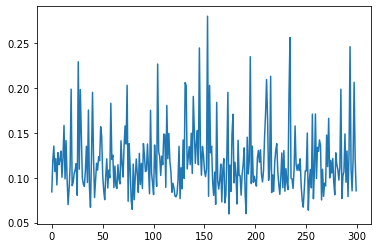

75797it [09:40, 141.70it/s]

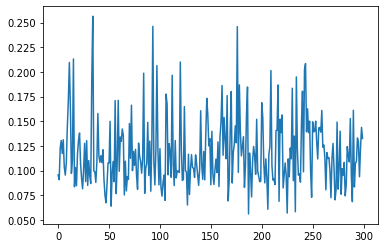

75991it [09:42, 141.40it/s]

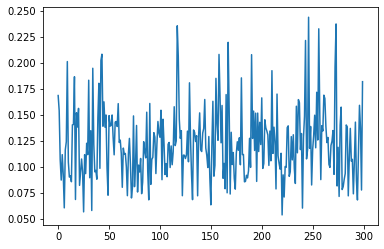

76186it [09:43, 141.34it/s]

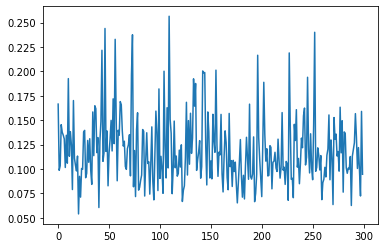

76396it [09:45, 142.98it/s]

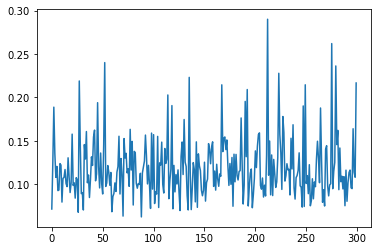

76591it [09:46, 141.62it/s]

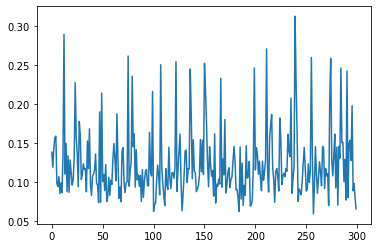

76800it [09:48, 143.47it/s]

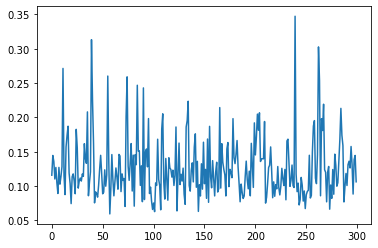

76995it [09:49, 142.16it/s]

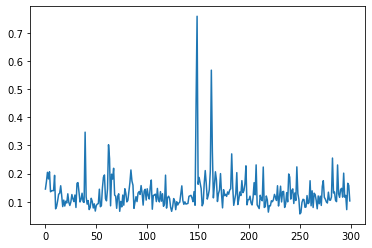

77190it [09:51, 142.25it/s]

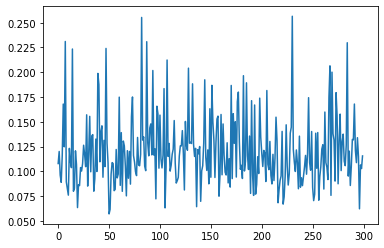

77400it [09:52, 142.35it/s]

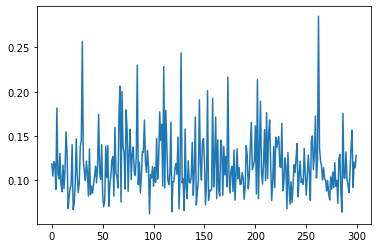

77595it [09:54, 142.80it/s]

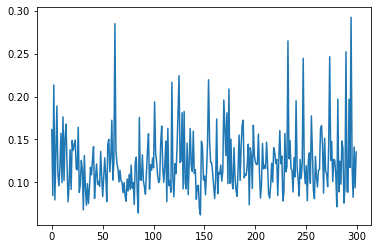

77790it [09:55, 141.72it/s]

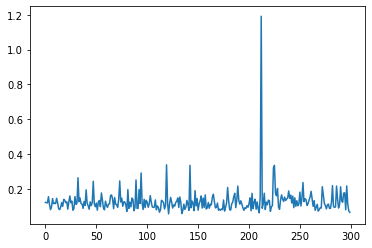

77998it [09:57, 138.65it/s]

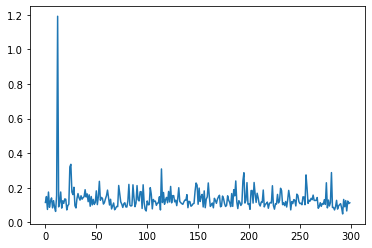

78192it [09:58, 141.48it/s]

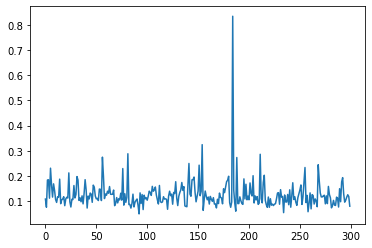

78400it [10:00, 139.77it/s]

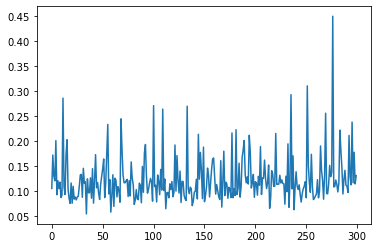

78595it [10:01, 141.84it/s]

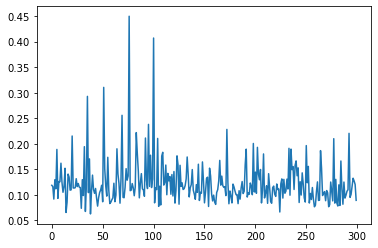

78790it [10:03, 142.96it/s]

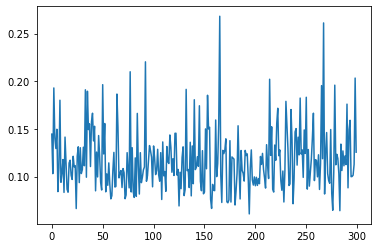

78999it [10:04, 142.45it/s]

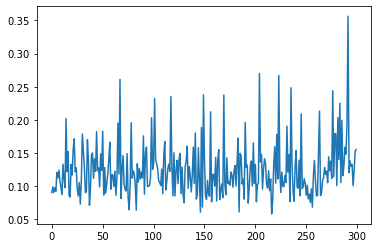

79194it [10:06, 141.97it/s]

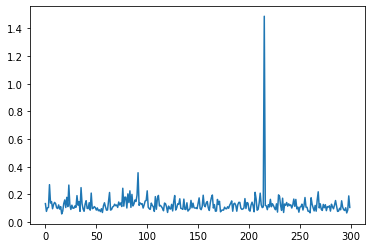

79389it [10:07, 142.09it/s]

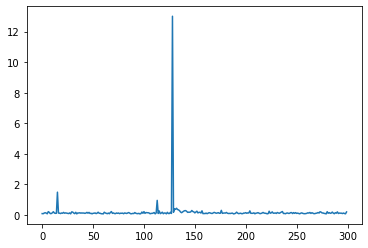

79599it [10:09, 143.05it/s]

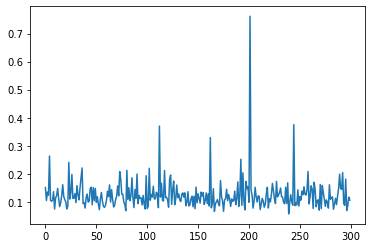

79794it [10:10, 142.39it/s]

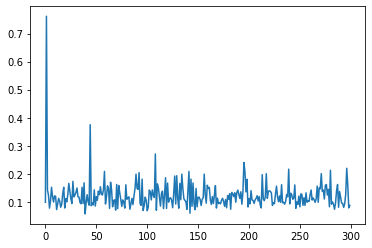

79989it [10:12, 142.76it/s]

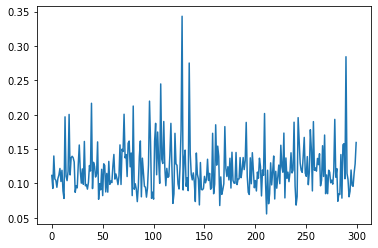

80199it [10:13, 142.33it/s]

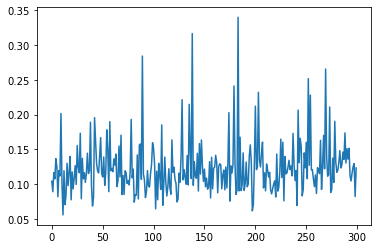

80394it [10:15, 143.21it/s]

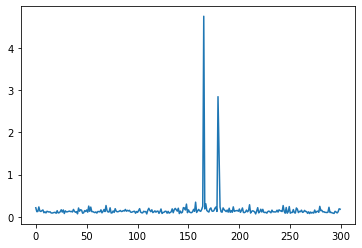

80588it [10:16, 141.25it/s]

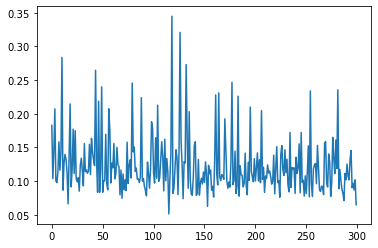

80797it [10:18, 142.06it/s]

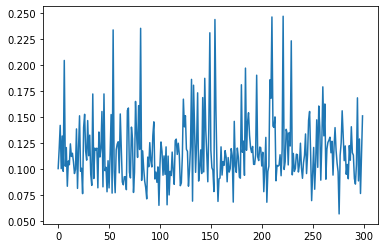

80986it [10:19, 139.09it/s]

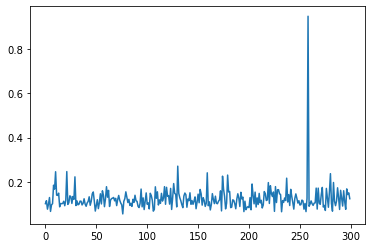

81195it [10:21, 143.42it/s]

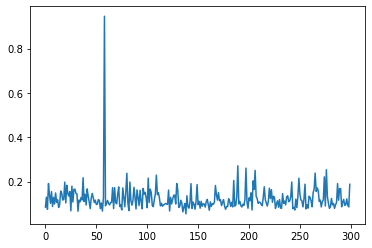

81389it [10:22, 142.32it/s]

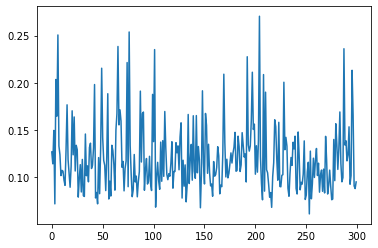

81599it [10:24, 141.38it/s]

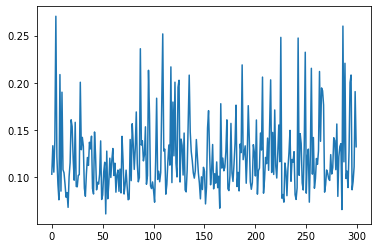

81793it [10:25, 140.75it/s]

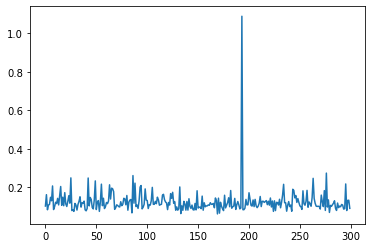

81988it [10:27, 141.98it/s]

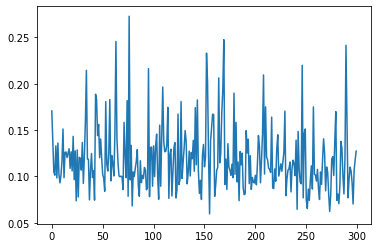

82198it [10:29, 141.60it/s]

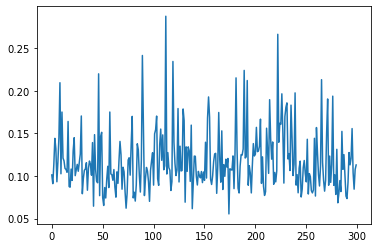

82393it [10:30, 141.90it/s]

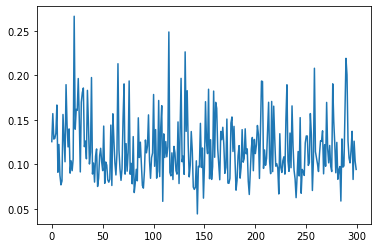

82587it [10:31, 141.44it/s]

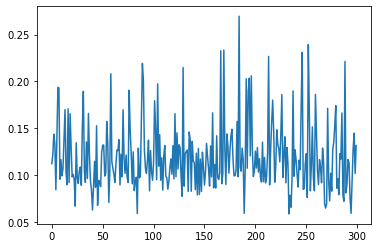

82797it [10:33, 143.01it/s]

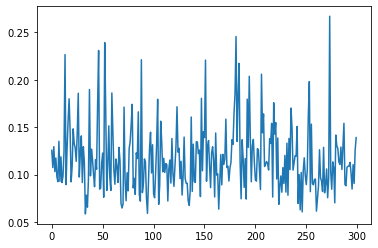

82992it [10:34, 141.59it/s]

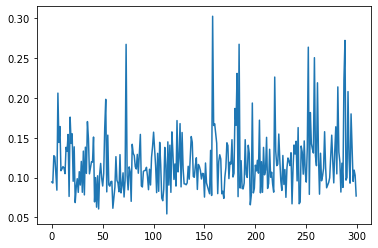

83187it [10:36, 142.58it/s]

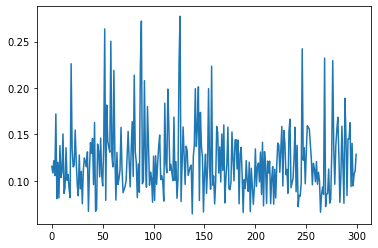

83397it [10:38, 142.05it/s]

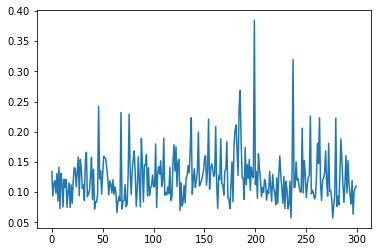

83592it [10:39, 142.70it/s]

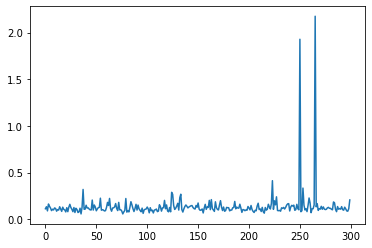

83787it [10:41, 141.92it/s]

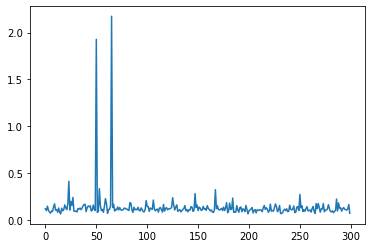

83997it [10:42, 143.69it/s]

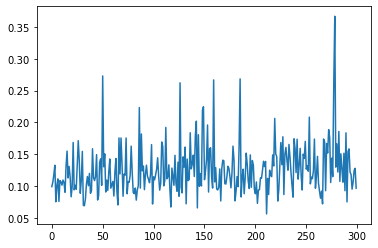

84192it [10:44, 142.50it/s]

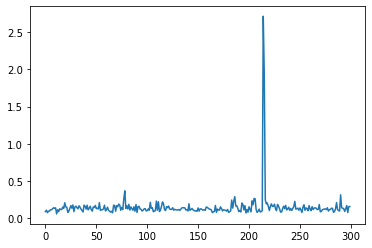

84387it [10:45, 140.15it/s]

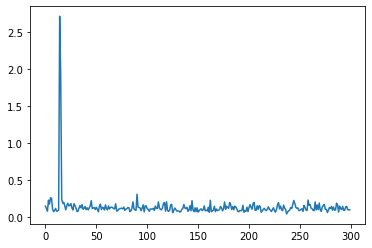

84597it [10:47, 141.90it/s]

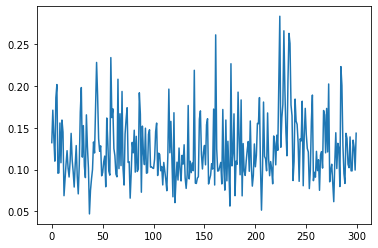

84792it [10:48, 142.64it/s]

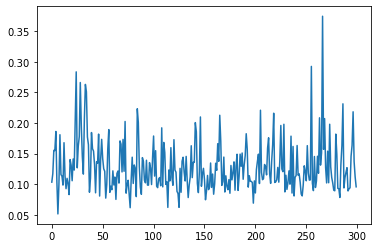

84987it [10:50, 141.39it/s]

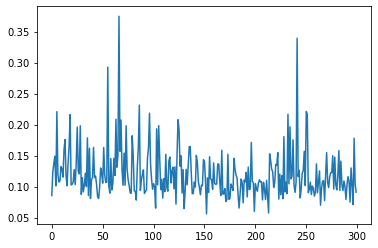

85197it [10:51, 143.44it/s]

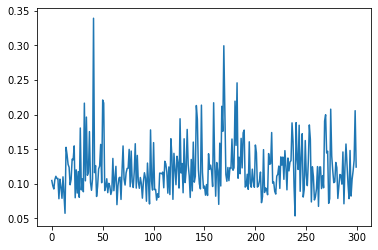

85392it [10:53, 141.85it/s]

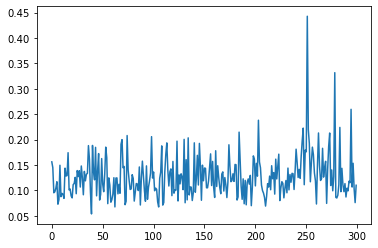

85600it [10:54, 143.03it/s]

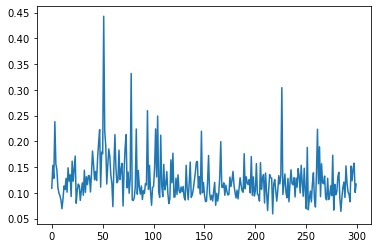

85795it [10:56, 142.56it/s]

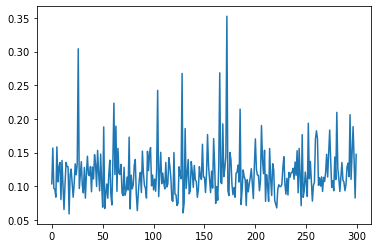

85990it [10:57, 143.01it/s]

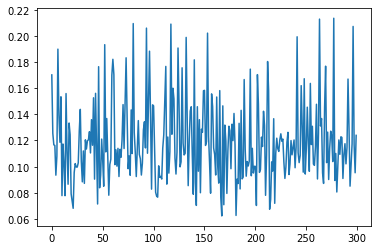

86200it [10:59, 142.16it/s]

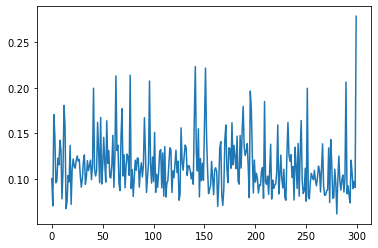

86395it [11:00, 143.21it/s]

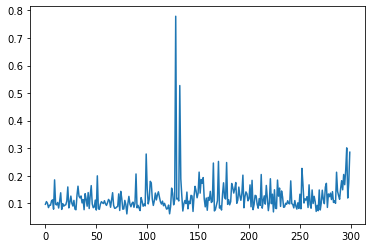

86590it [11:02, 142.34it/s]

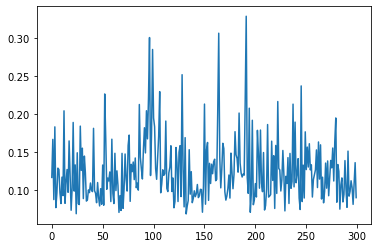

86800it [11:03, 142.19it/s]

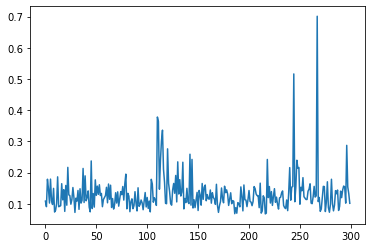

86995it [11:05, 141.08it/s]

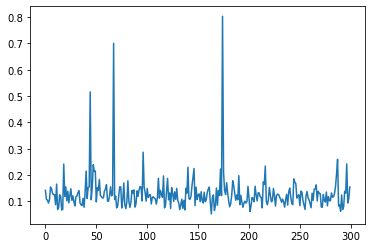

87190it [11:06, 143.18it/s]

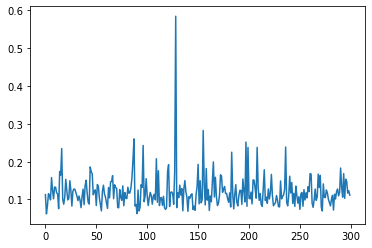

87400it [11:08, 142.08it/s]

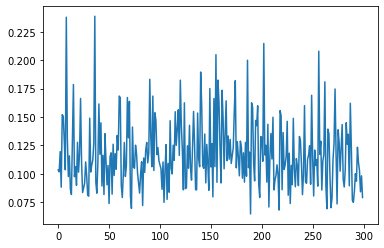

87594it [11:09, 142.45it/s]

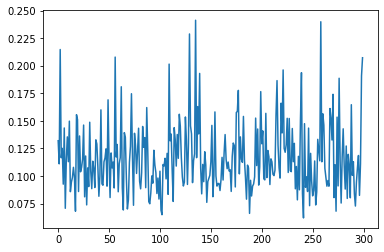

87789it [11:11, 141.60it/s]

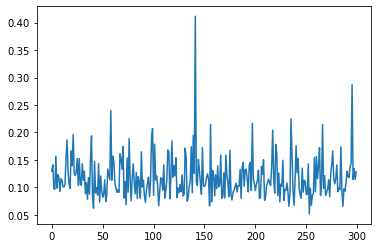

87999it [11:12, 143.43it/s]

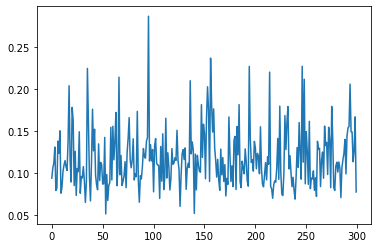

88194it [11:14, 140.24it/s]

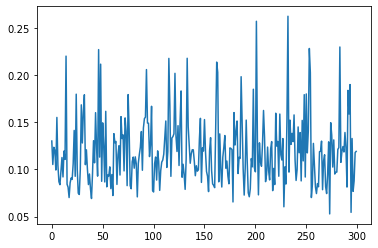

88389it [11:15, 142.32it/s]

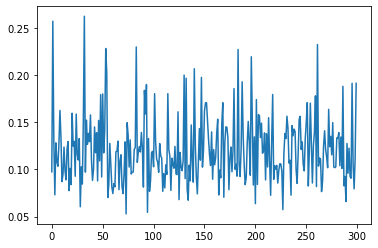

88595it [11:17, 139.72it/s]

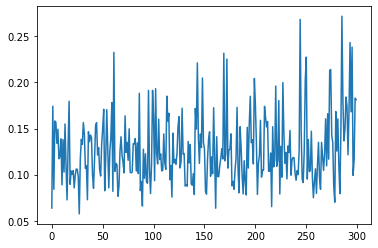

88793it [11:19, 128.36it/s]

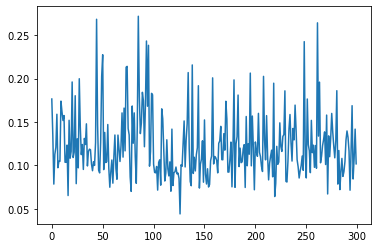

88988it [11:20, 137.71it/s]

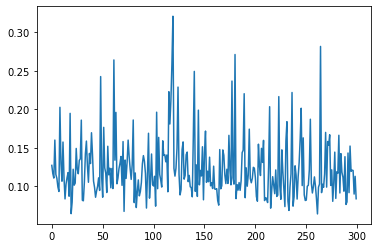

89199it [11:22, 123.36it/s]

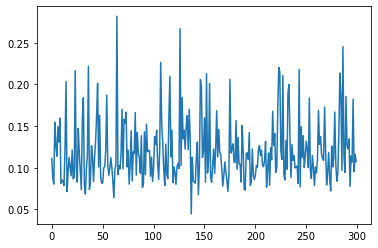

89390it [11:23, 128.49it/s]

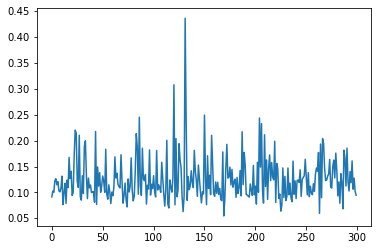

89597it [11:25, 140.48it/s]

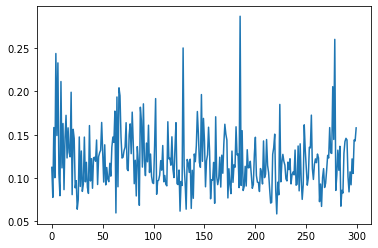

89790it [11:26, 141.18it/s]

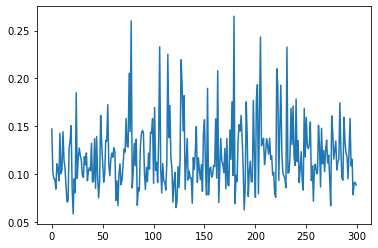

90000it [11:28, 142.35it/s]

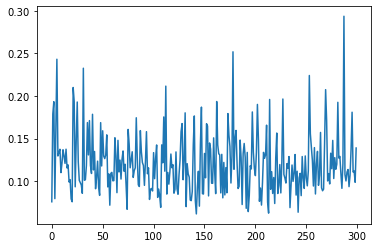

90194it [11:30, 141.92it/s]

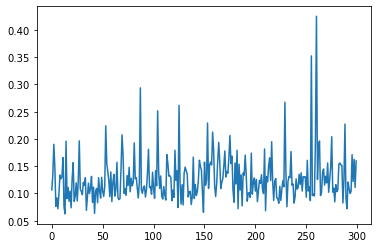

90389it [11:31, 142.09it/s]

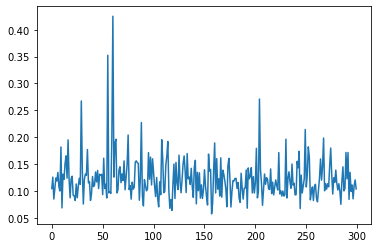

90598it [11:33, 142.20it/s]

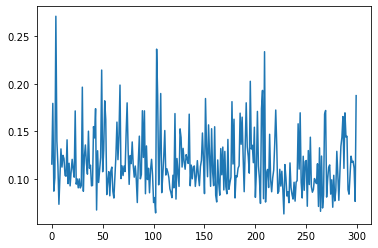

90793it [11:34, 141.85it/s]

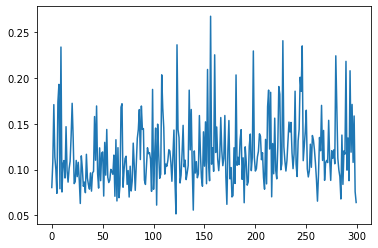

90987it [11:36, 141.10it/s]

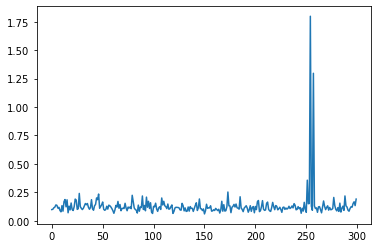

91197it [11:37, 142.21it/s]

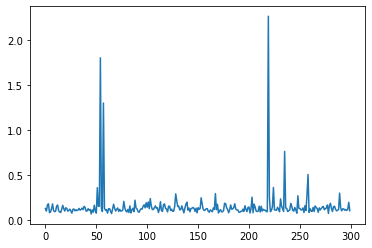

91391it [11:39, 142.18it/s]

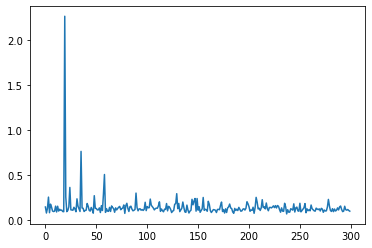

91586it [11:40, 142.69it/s]

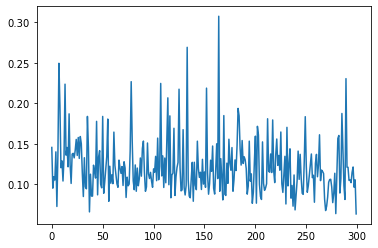

91795it [11:42, 142.45it/s]

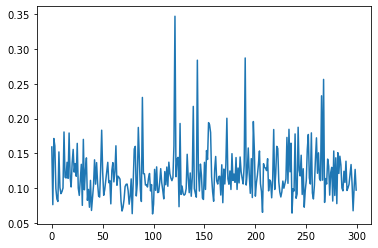

91990it [11:43, 142.65it/s]

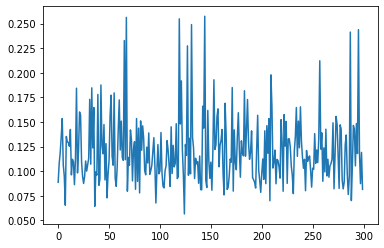

92199it [11:45, 141.79it/s]

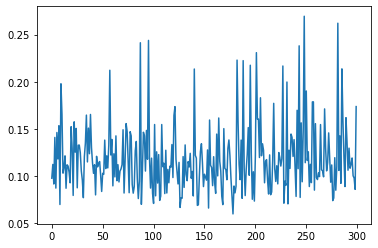

92394it [11:46, 142.79it/s]

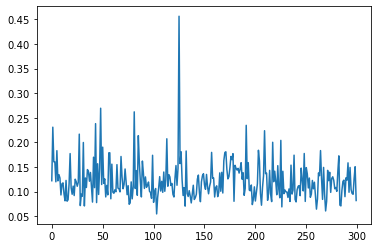

92588it [11:48, 142.45it/s]

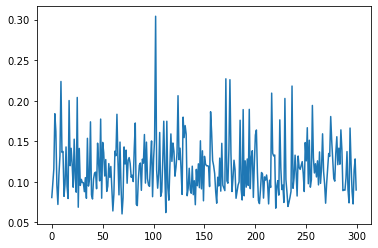

92798it [11:49, 143.12it/s]

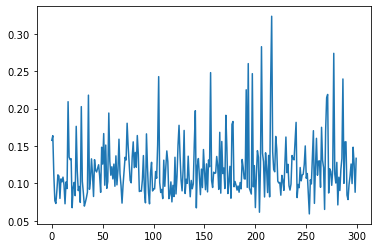

92992it [11:51, 142.06it/s]

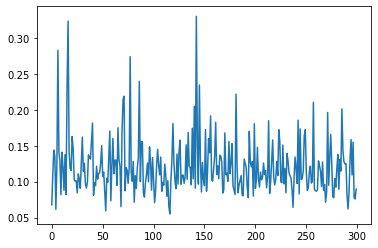

93187it [11:52, 142.19it/s]

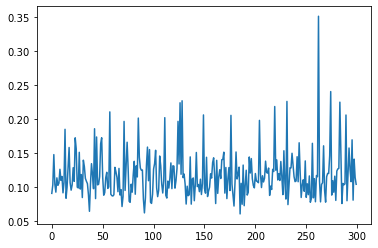

93390it [11:54, 139.43it/s]

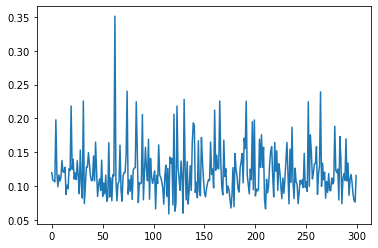

93599it [11:55, 143.42it/s]

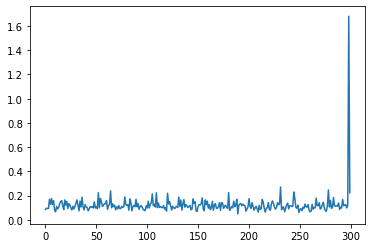

93793it [11:57, 142.34it/s]

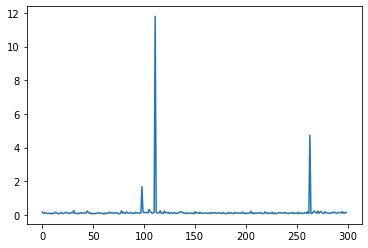

93988it [11:58, 142.74it/s]

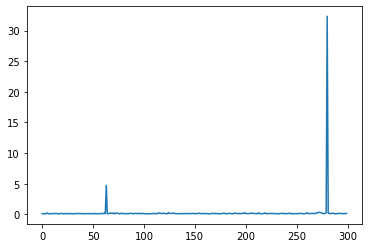

94197it [12:00, 142.08it/s]

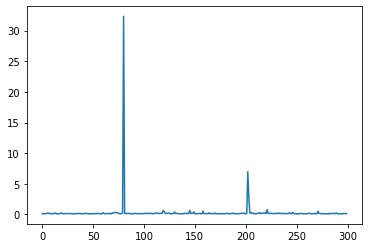

94392it [12:01, 143.23it/s]

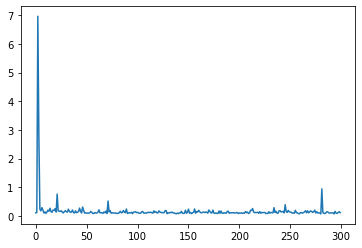

94587it [12:03, 142.50it/s]

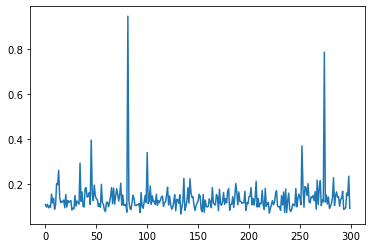

94796it [12:04, 142.95it/s]

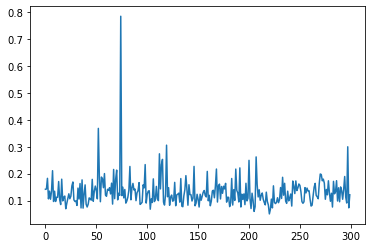

94991it [12:06, 142.15it/s]

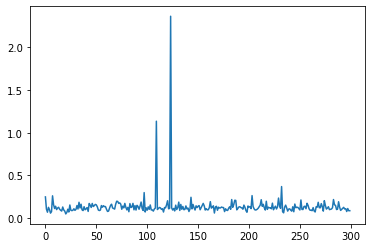

95168it [12:08, 130.70it/s]
0it [00:00, ?it/s]

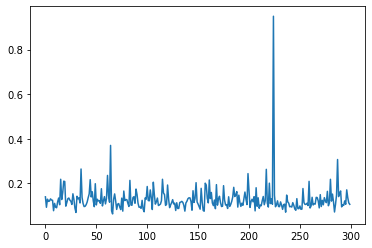

195it [00:05, 125.96it/s]

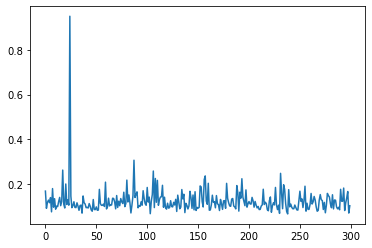

389it [00:07, 141.37it/s]

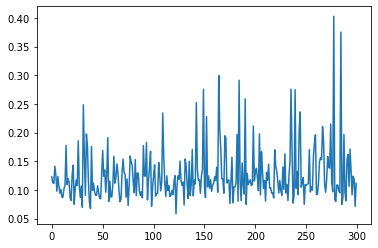

599it [00:08, 141.80it/s]

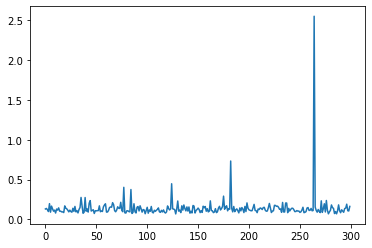

794it [00:10, 141.69it/s]

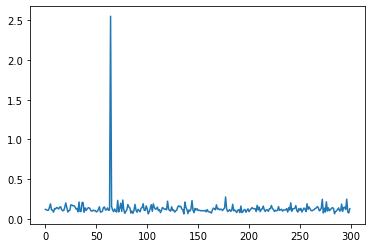

989it [00:12, 142.15it/s]

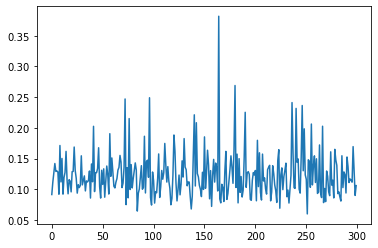

1199it [00:13, 142.45it/s]

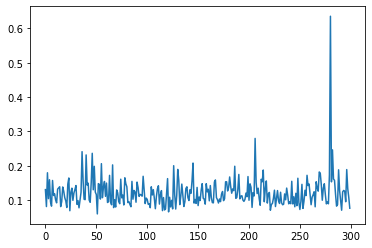

1394it [00:15, 142.48it/s]

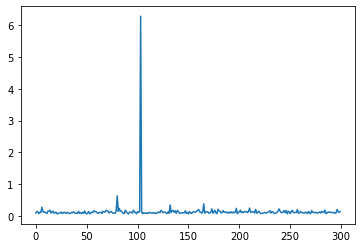

1587it [00:16, 141.47it/s]

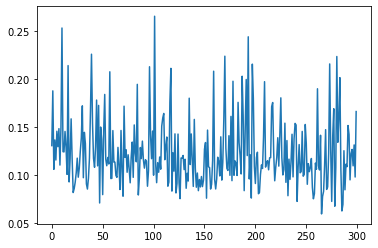

1797it [00:18, 143.03it/s]

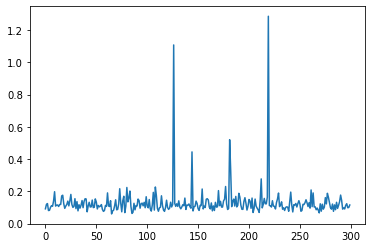

1992it [00:19, 142.57it/s]

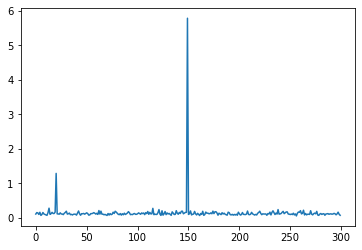

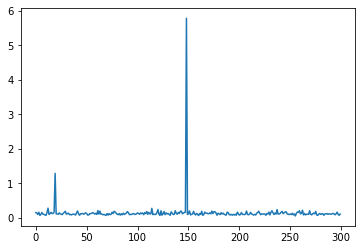

2187it [00:21, 142.12it/s]

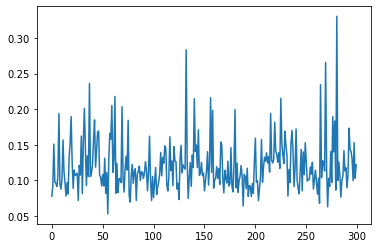

2397it [00:22, 141.87it/s]

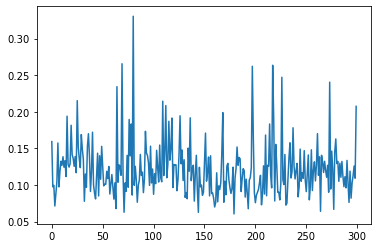

2592it [00:24, 142.66it/s]

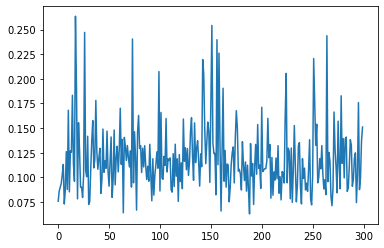

2787it [00:25, 141.16it/s]

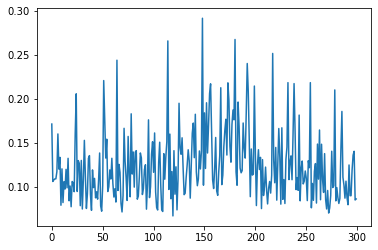

2997it [00:27, 143.64it/s]

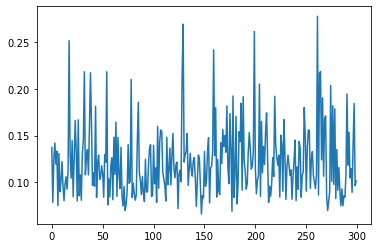

3192it [00:28, 141.96it/s]

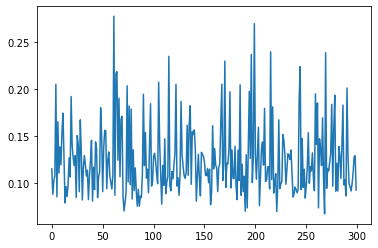

3387it [00:30, 143.77it/s]

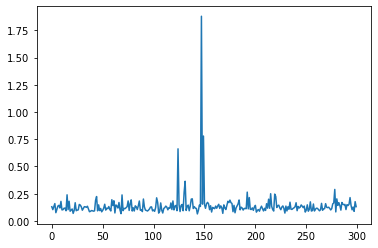

3595it [00:31, 143.06it/s]

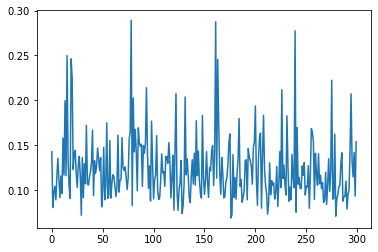

3790it [00:33, 143.75it/s]

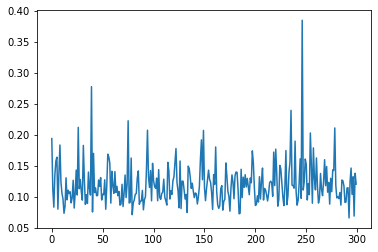

3999it [00:34, 143.08it/s]

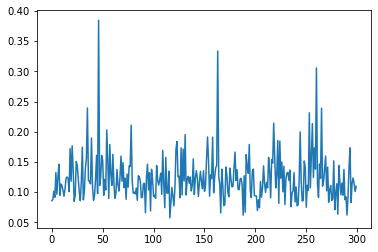

4194it [00:36, 142.67it/s]

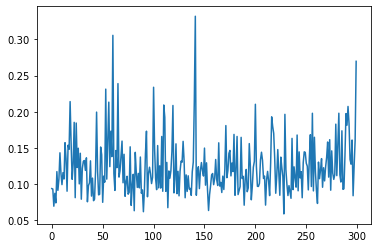

4388it [00:37, 142.28it/s]

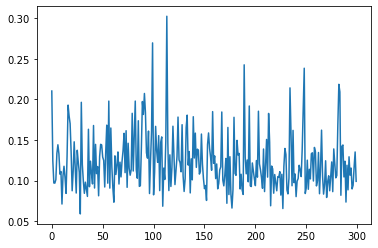

4598it [00:39, 142.85it/s]

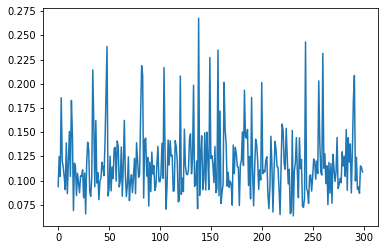

4793it [00:40, 142.19it/s]

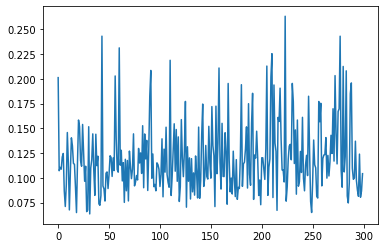

4988it [00:42, 142.94it/s]

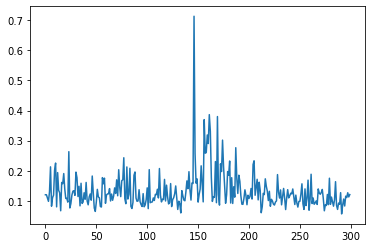

5197it [00:43, 142.91it/s]

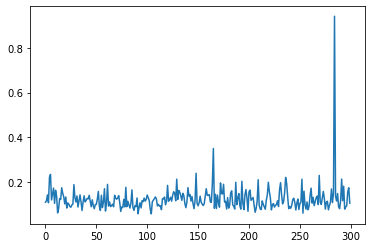

5392it [00:45, 143.62it/s]

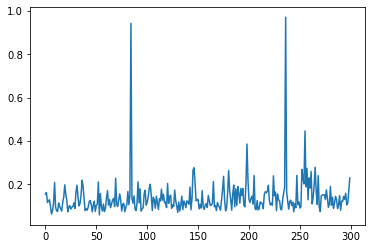

5586it [00:46, 142.35it/s]

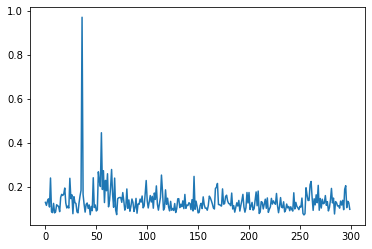

5796it [00:48, 144.06it/s]

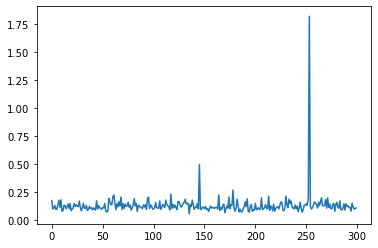

5991it [00:49, 143.02it/s]

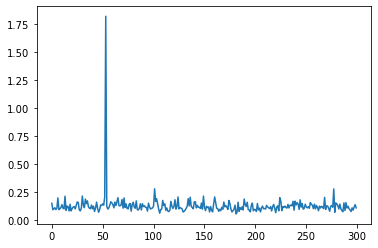

6186it [00:51, 143.50it/s]

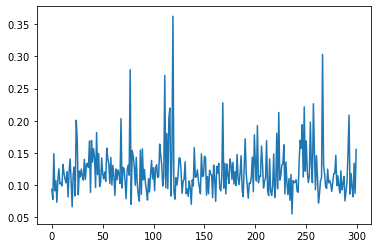

6395it [00:52, 143.07it/s]

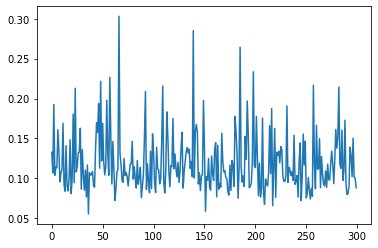

6588it [00:54, 142.82it/s]

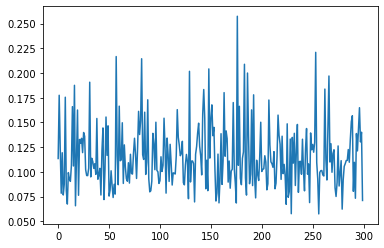

6797it [00:55, 143.12it/s]

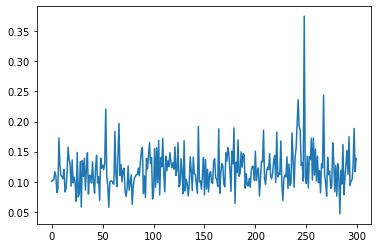

6992it [00:57, 143.20it/s]

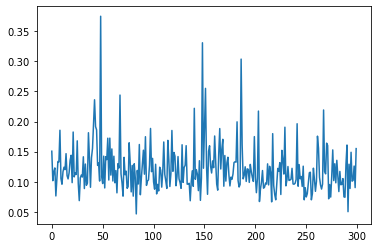

7186it [00:58, 143.27it/s]

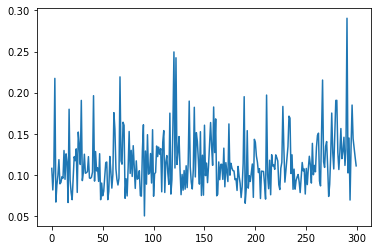

7396it [01:00, 143.42it/s]

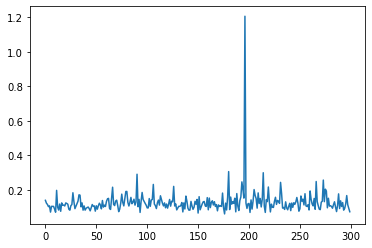

7591it [01:01, 143.05it/s]

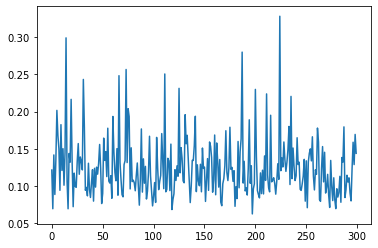

7786it [01:03, 143.76it/s]

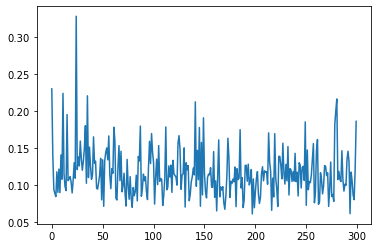

7995it [01:04, 142.90it/s]

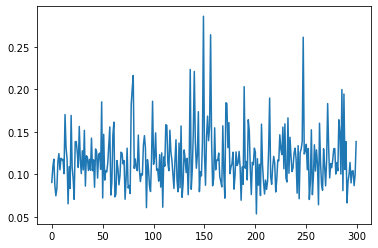

8189it [01:06, 143.02it/s]

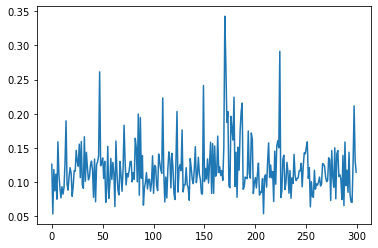

8399it [01:08, 143.11it/s]

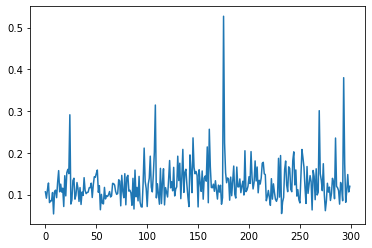

8594it [01:09, 142.56it/s]

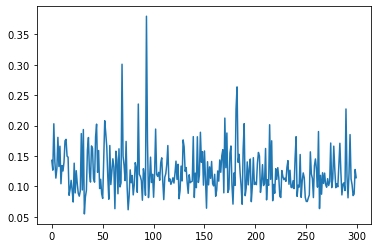

8789it [01:10, 142.76it/s]

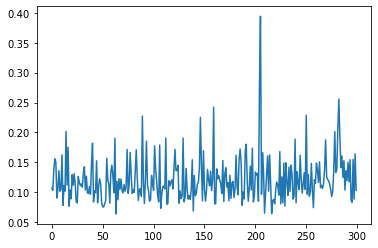

8993it [01:12, 126.22it/s]

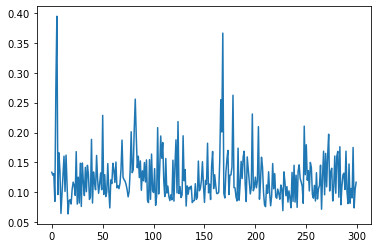

9188it [01:14, 135.63it/s]

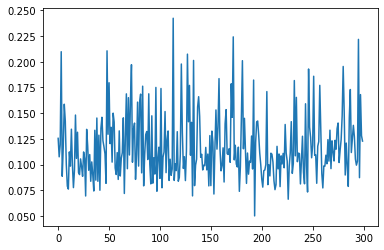

9399it [01:15, 134.43it/s]

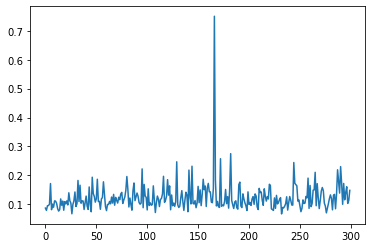

9593it [01:17, 143.16it/s]

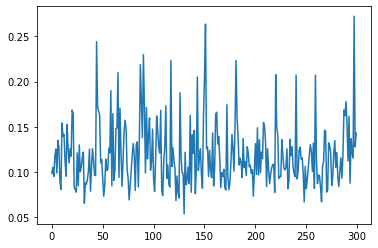

9788it [01:18, 143.03it/s]

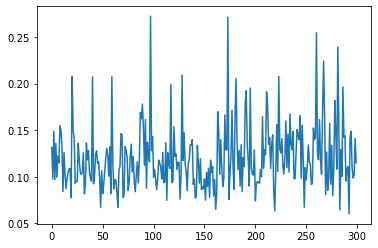

9997it [01:20, 143.12it/s]

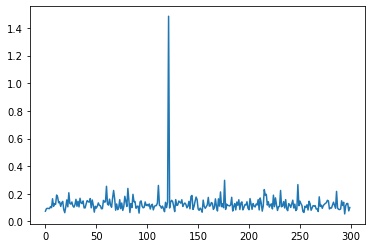

10192it [01:21, 142.44it/s]

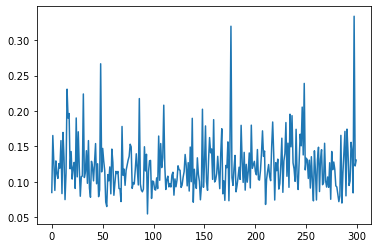

10387it [01:23, 143.10it/s]

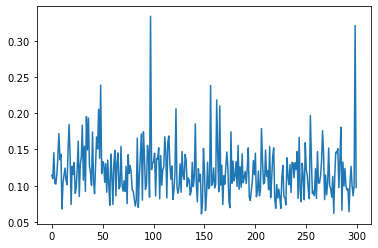

10597it [01:24, 142.37it/s]

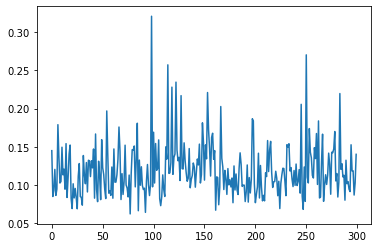

10792it [01:26, 142.77it/s]

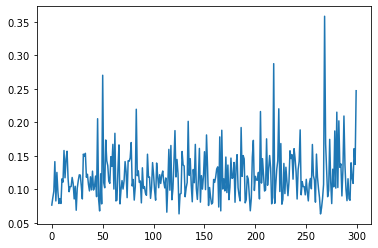

10987it [01:27, 143.49it/s]

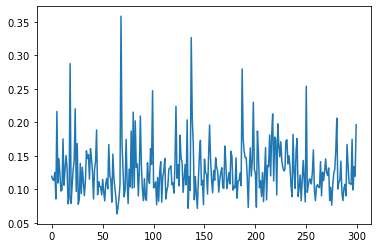

11197it [01:29, 143.50it/s]

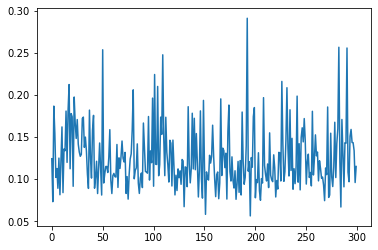

11392it [01:30, 142.97it/s]

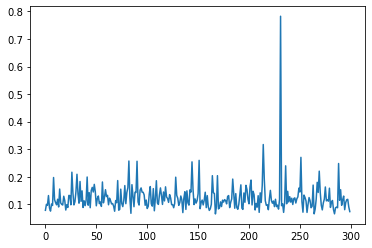

11587it [01:32, 143.63it/s]

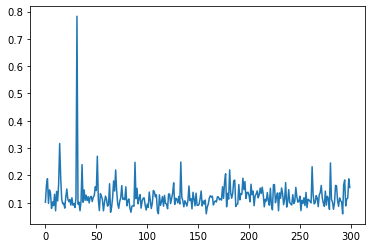

11797it [01:33, 143.62it/s]

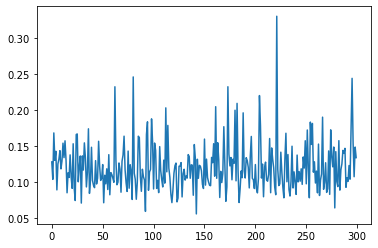

11992it [01:35, 143.15it/s]

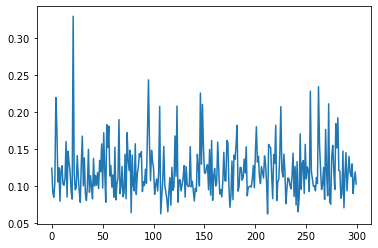

12187it [01:36, 142.60it/s]

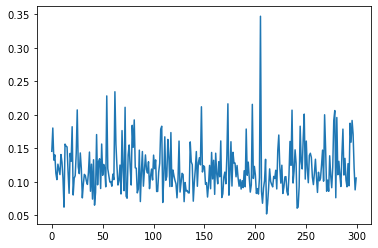

12397it [01:38, 143.89it/s]

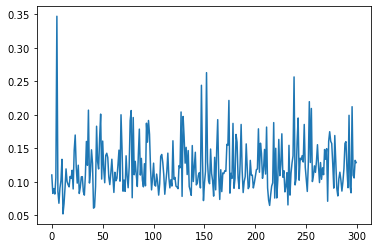

12592it [01:39, 143.37it/s]

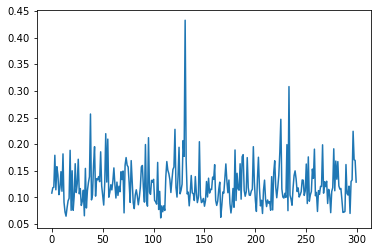

12787it [01:41, 143.09it/s]

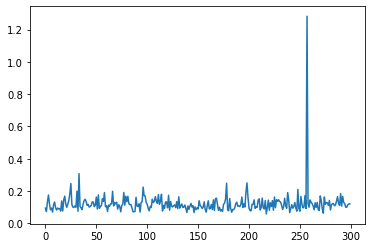

12997it [01:42, 142.85it/s]

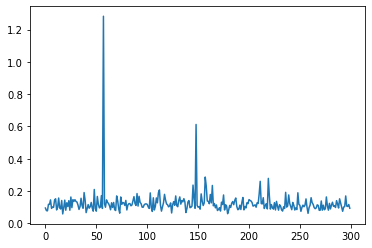

13192it [01:44, 136.52it/s]

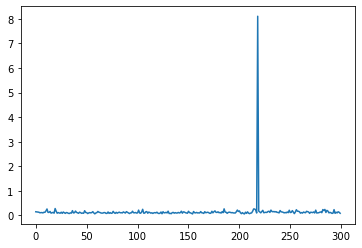

13398it [01:46, 141.58it/s]

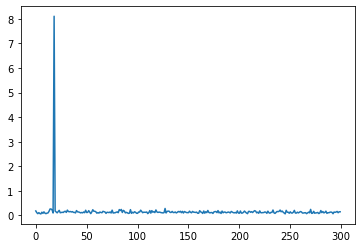

13593it [01:47, 142.78it/s]

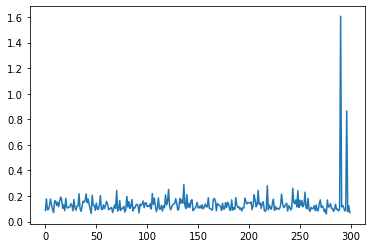

13788it [01:49, 143.12it/s]

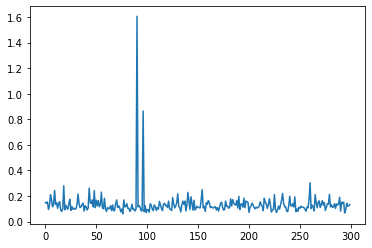

13998it [01:50, 142.85it/s]

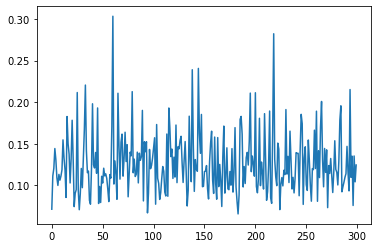

14193it [01:52, 142.36it/s]

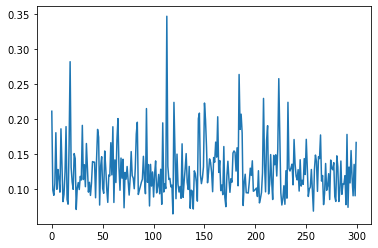

14387it [01:53, 142.78it/s]

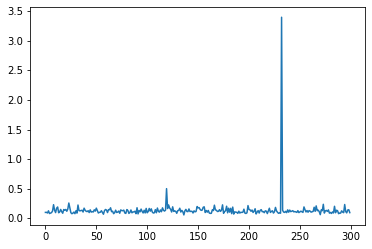

14597it [01:55, 142.22it/s]

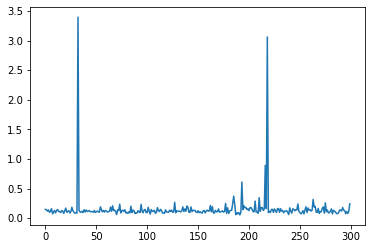

14792it [01:56, 142.62it/s]

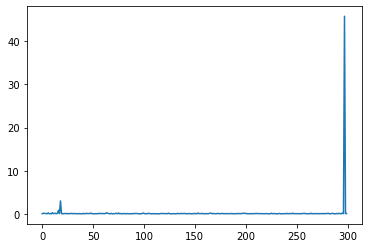

14987it [01:58, 142.75it/s]

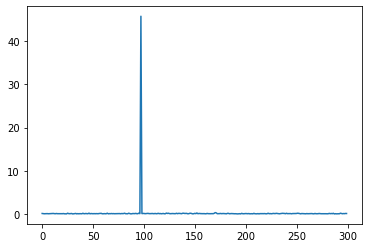

15197it [01:59, 142.77it/s]

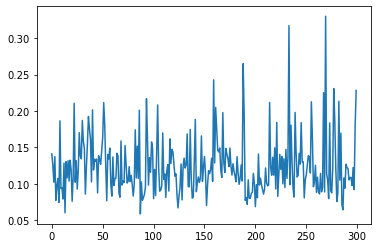

15392it [02:01, 142.50it/s]

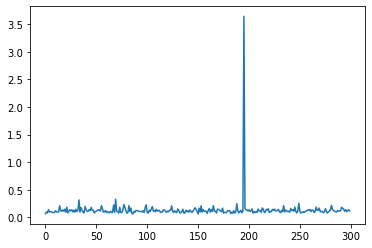

15587it [02:02, 143.09it/s]

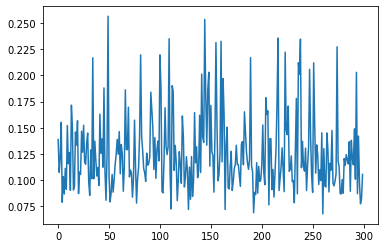

15797it [02:04, 142.30it/s]

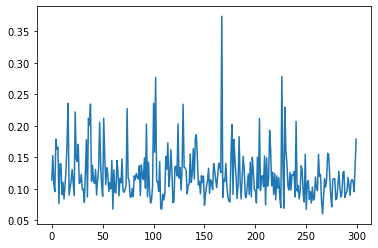

15992it [02:05, 142.79it/s]

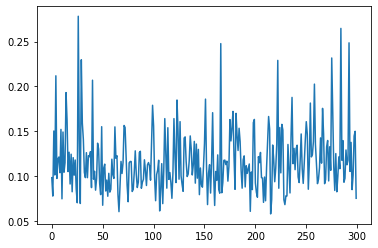

16187it [02:07, 142.47it/s]

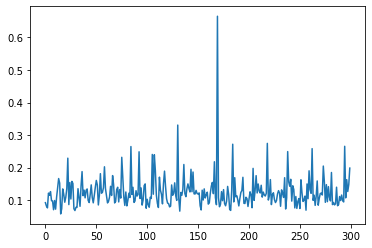

16397it [02:08, 142.49it/s]

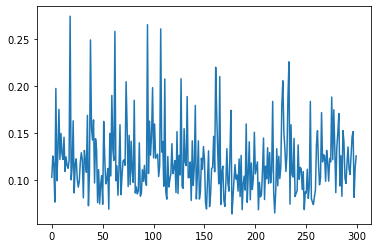

16591it [02:10, 143.23it/s]

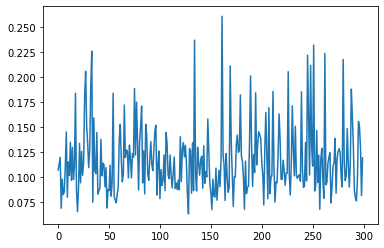

16786it [02:11, 142.45it/s]

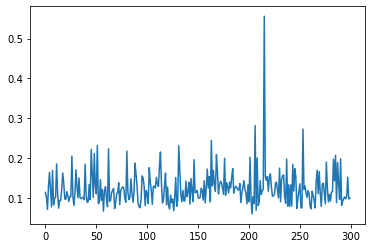

16996it [02:13, 143.53it/s]

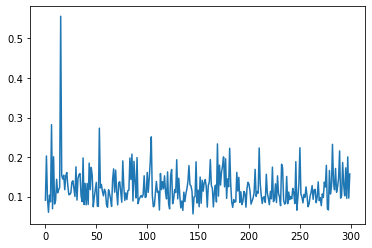

17191it [02:14, 142.74it/s]

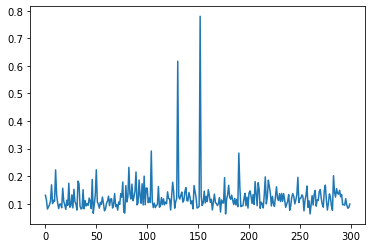

17386it [02:16, 140.36it/s]

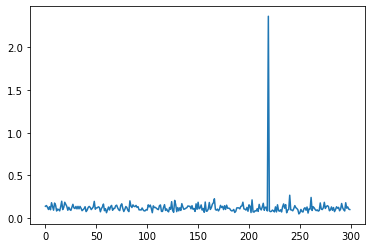

17596it [02:17, 143.06it/s]

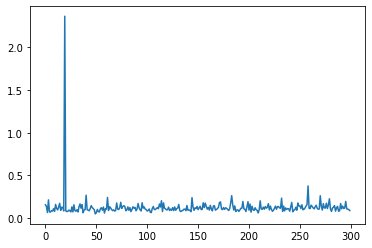

17791it [02:19, 142.73it/s]

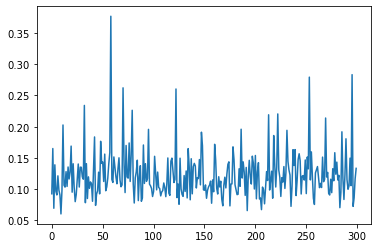

17986it [02:20, 142.79it/s]

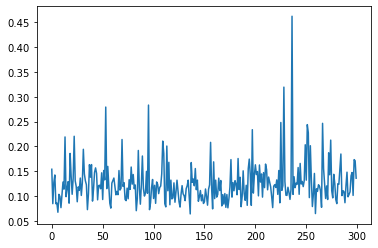

18196it [02:22, 143.10it/s]

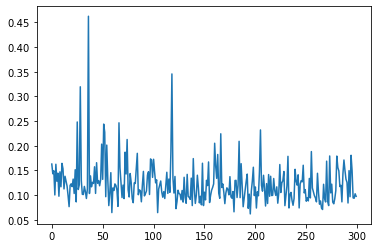

18391it [02:23, 142.93it/s]

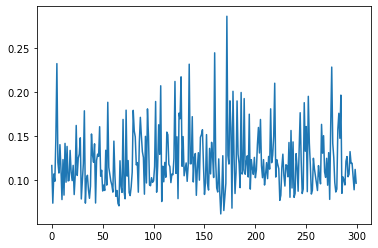

18586it [02:25, 143.15it/s]

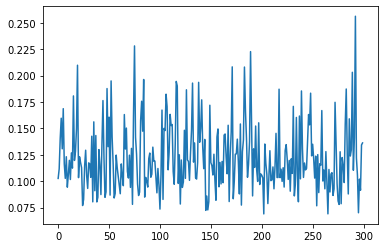

18794it [02:26, 142.94it/s]

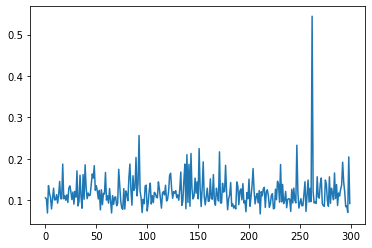

18989it [02:28, 142.82it/s]

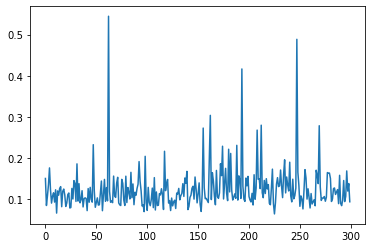

19198it [02:29, 142.74it/s]

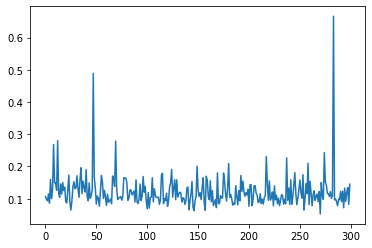

19393it [02:31, 143.39it/s]

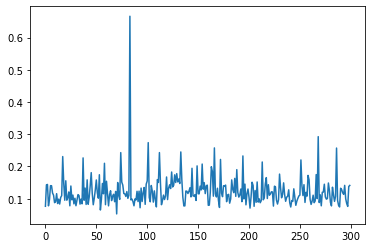

19587it [02:32, 142.67it/s]

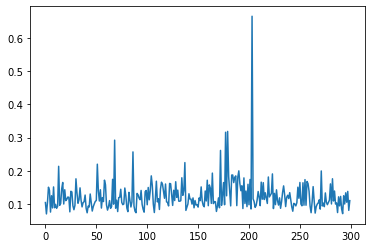

19797it [02:34, 143.75it/s]

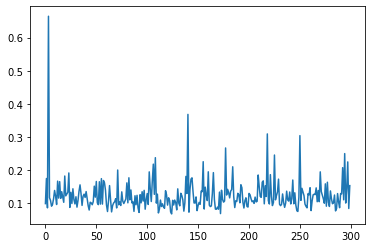

19991it [02:35, 142.72it/s]

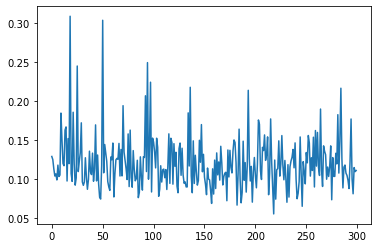

20186it [02:37, 142.69it/s]

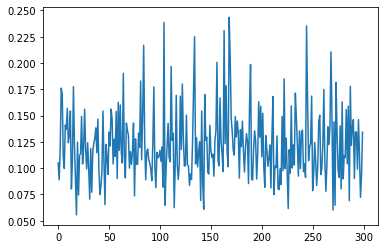

20395it [02:38, 142.21it/s]

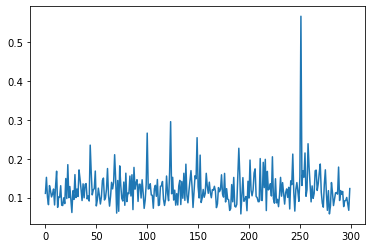

20590it [02:40, 142.98it/s]

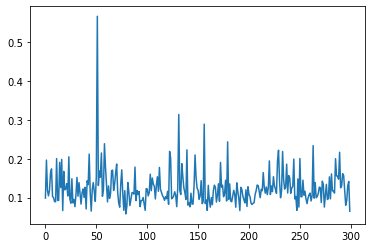

20799it [02:41, 143.00it/s]

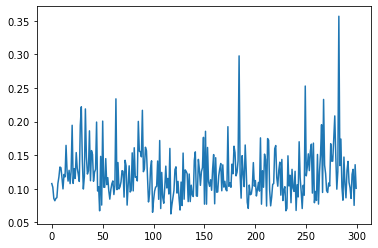

20994it [02:43, 142.01it/s]

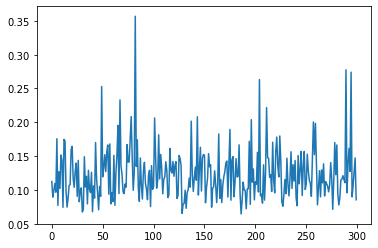

21188it [02:44, 142.39it/s]

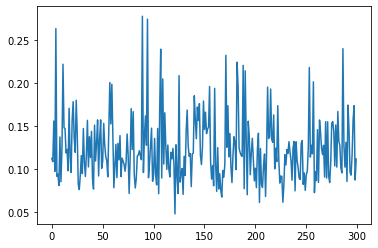

21398it [02:46, 141.53it/s]

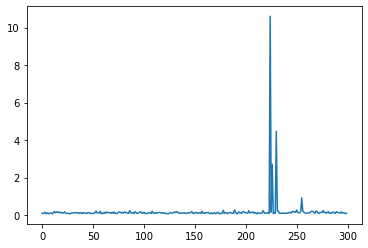

21593it [02:48, 140.49it/s]

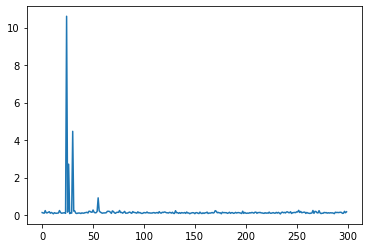

21788it [02:49, 142.69it/s]

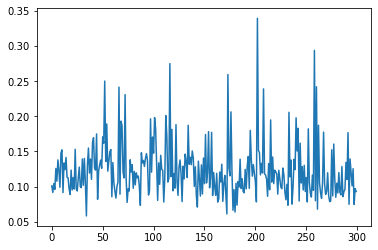

21998it [02:51, 142.94it/s]

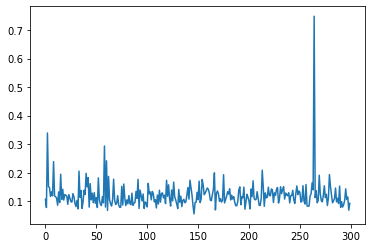

22193it [02:52, 143.72it/s]

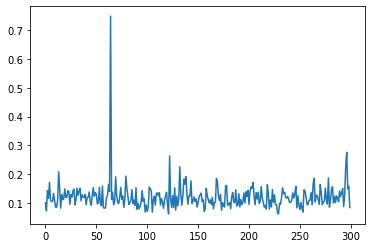

22388it [02:54, 142.74it/s]

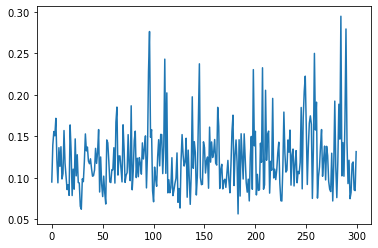

22598it [02:55, 142.65it/s]

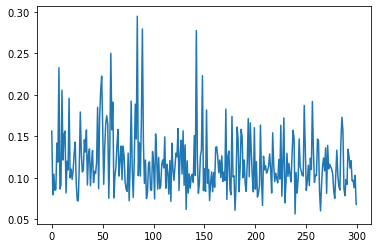

22793it [02:57, 143.44it/s]

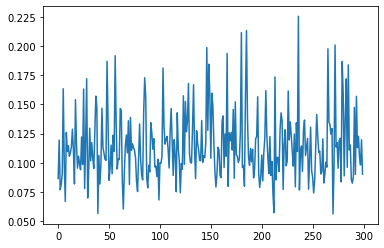

22988it [02:58, 143.38it/s]

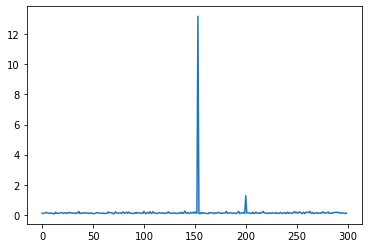

23198it [03:00, 143.26it/s]

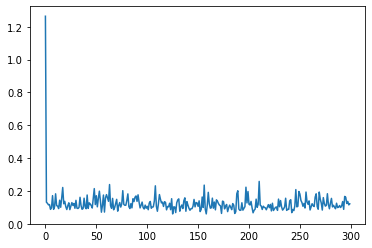

23393it [03:01, 142.31it/s]

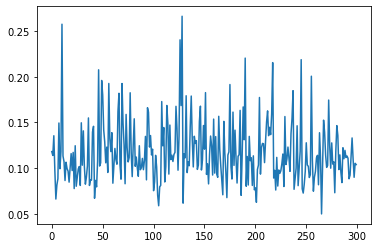

23588it [03:03, 143.16it/s]

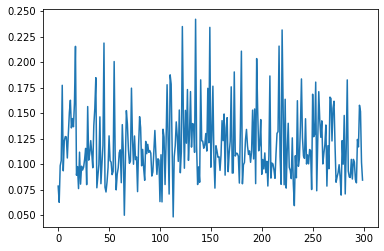

23798it [03:04, 143.37it/s]

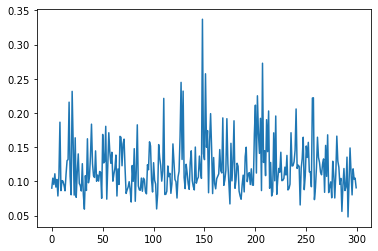

23993it [03:06, 143.27it/s]

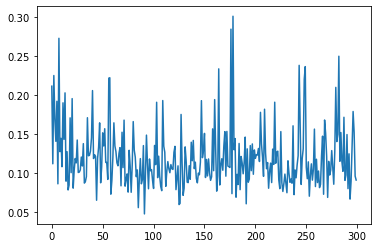

24192it [03:07, 136.75it/s]

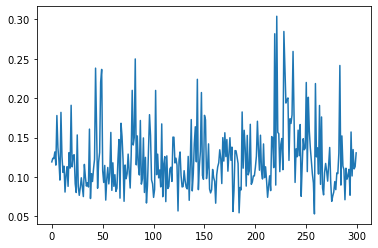

24394it [03:09, 140.01it/s]

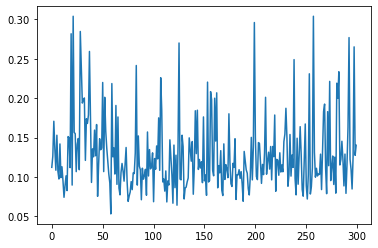

24599it [03:10, 138.47it/s]

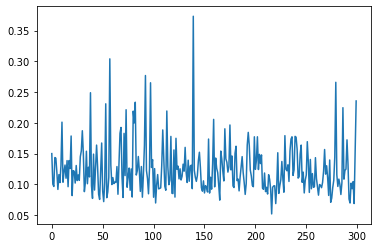

24796it [03:12, 118.77it/s]

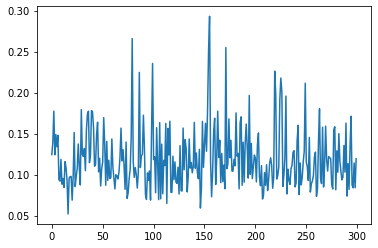

24992it [03:14, 115.89it/s]

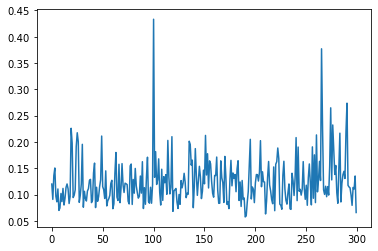

25187it [03:15, 133.93it/s]

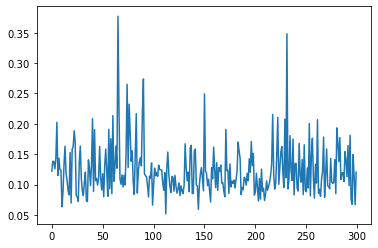

25394it [03:17, 140.79it/s]

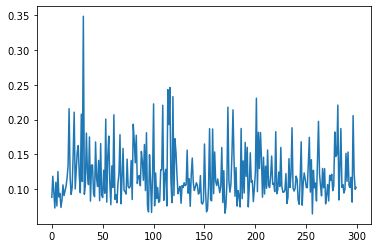

25589it [03:18, 141.33it/s]

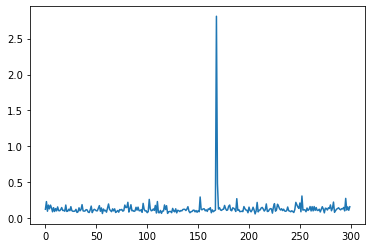

25799it [03:20, 142.15it/s]

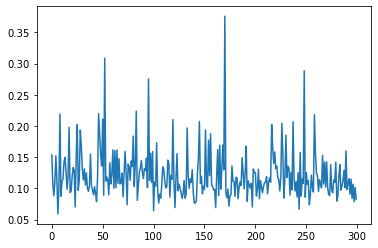

25994it [03:22, 143.11it/s]

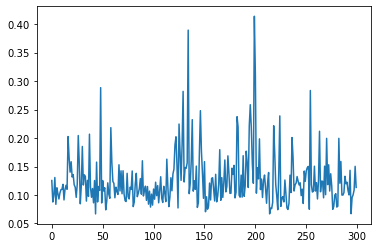

26189it [03:23, 141.50it/s]

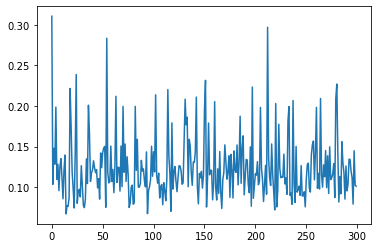

26399it [03:25, 141.95it/s]

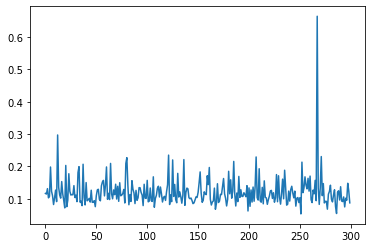

26594it [03:26, 133.84it/s]

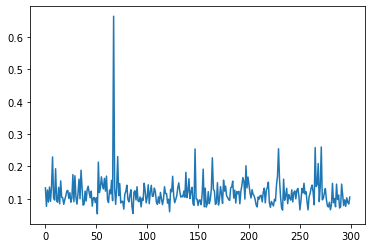

26800it [03:28, 138.66it/s]

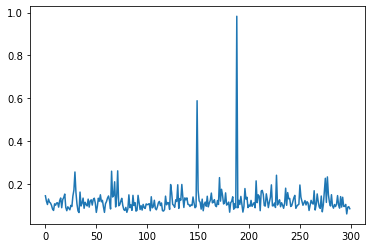

26994it [03:29, 141.66it/s]

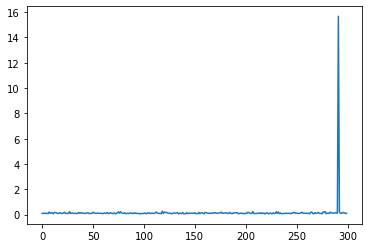

27189it [03:31, 142.01it/s]

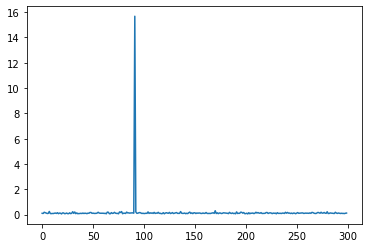

27399it [03:32, 141.86it/s]

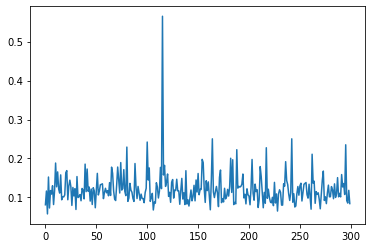

27600it [03:34, 126.68it/s]

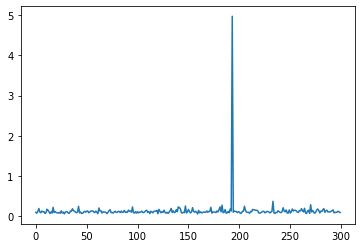

27791it [03:35, 142.30it/s]

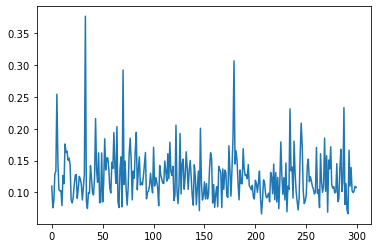

28000it [03:37, 142.46it/s]

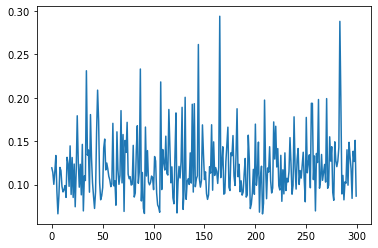

28195it [03:38, 141.51it/s]

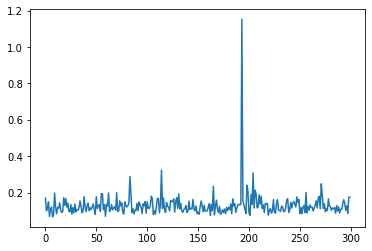

28390it [03:40, 141.62it/s]

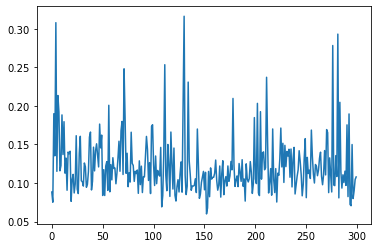

28600it [03:41, 142.31it/s]

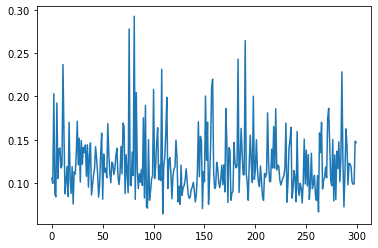

28795it [03:43, 142.64it/s]

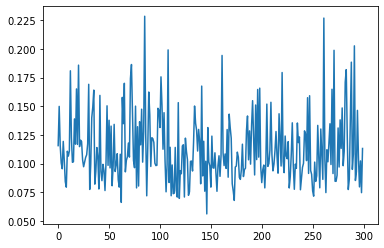

28990it [03:44, 138.06it/s]

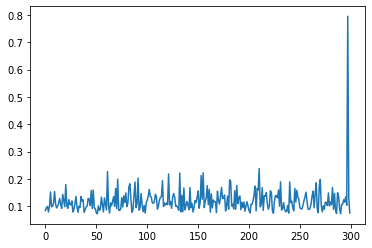

29196it [03:46, 141.11it/s]

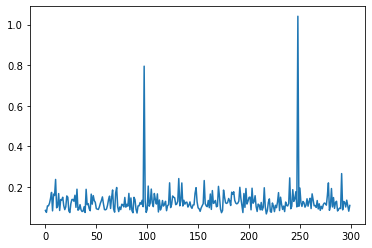

29391it [03:47, 142.42it/s]

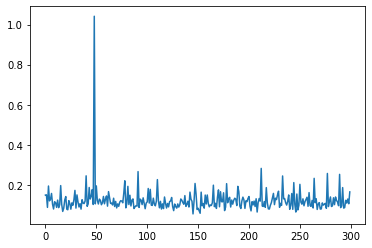

29586it [03:49, 143.69it/s]

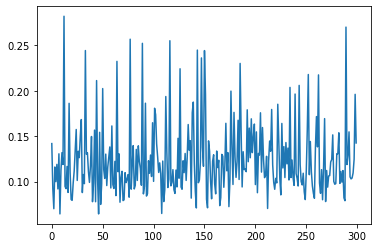

29795it [03:50, 142.16it/s]

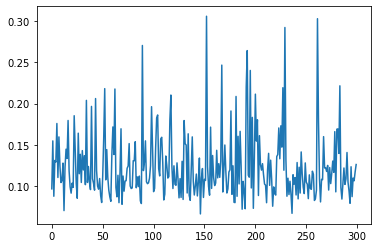

29990it [03:52, 141.96it/s]

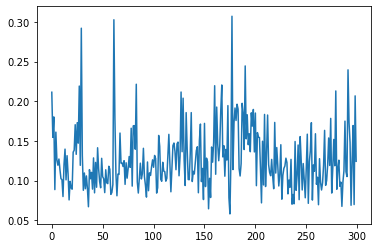

30200it [03:54, 142.87it/s]

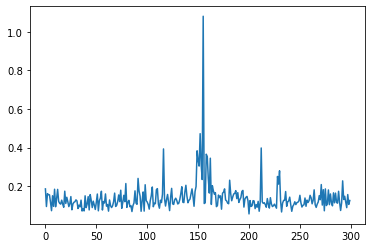

30395it [03:55, 142.91it/s]

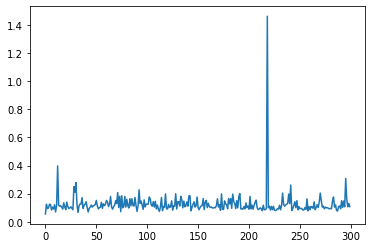

30589it [03:57, 142.90it/s]

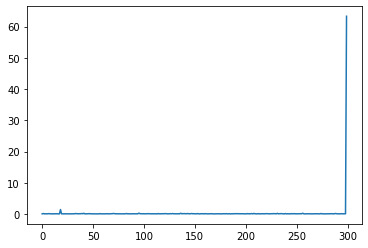

30799it [03:58, 143.57it/s]

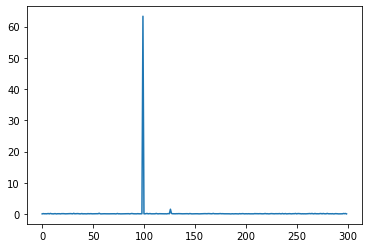

30994it [04:00, 143.11it/s]

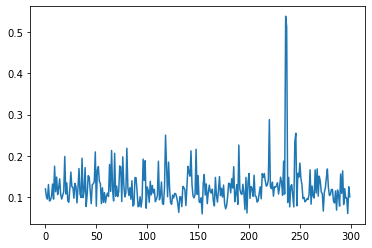

31189it [04:01, 143.15it/s]

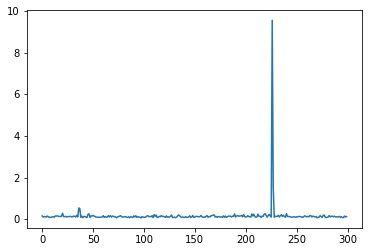

31399it [04:03, 142.90it/s]

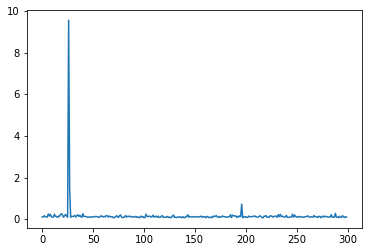

31594it [04:04, 142.79it/s]

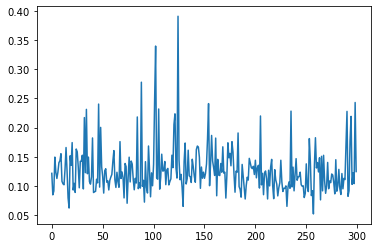

31789it [04:06, 142.00it/s]

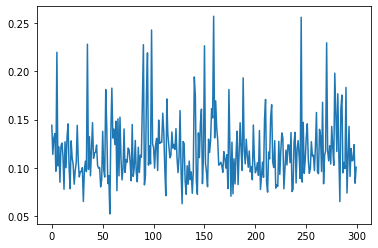

31998it [04:07, 142.44it/s]

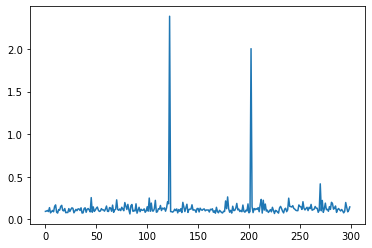

32193it [04:09, 142.02it/s]

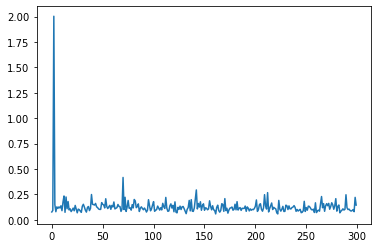

32388it [04:10, 142.61it/s]

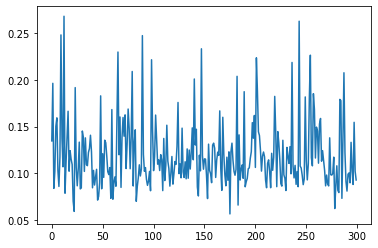

32598it [04:12, 142.20it/s]

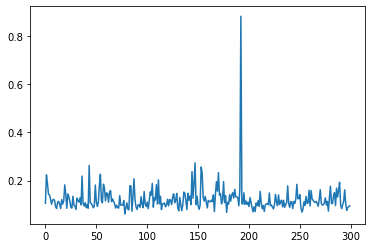

32793it [04:13, 142.93it/s]

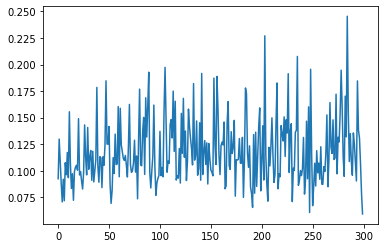

32988it [04:15, 142.54it/s]

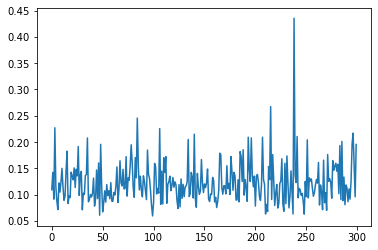

33198it [04:16, 141.83it/s]

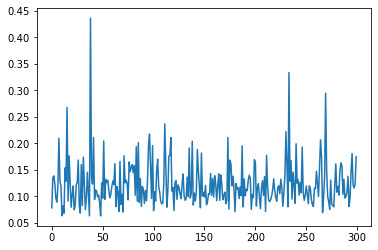

33393it [04:18, 142.39it/s]

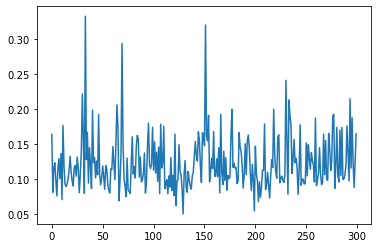

33588it [04:19, 142.50it/s]

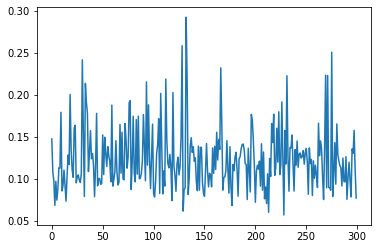

33798it [04:21, 142.30it/s]

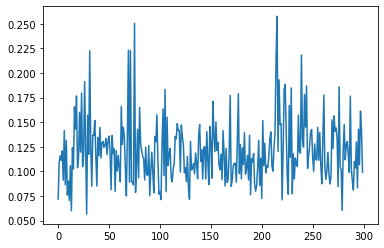

33993it [04:22, 143.10it/s]

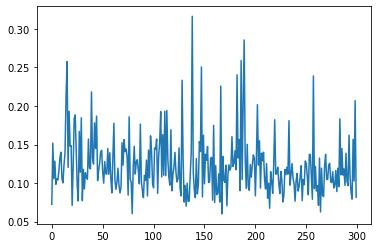

34188it [04:24, 142.25it/s]

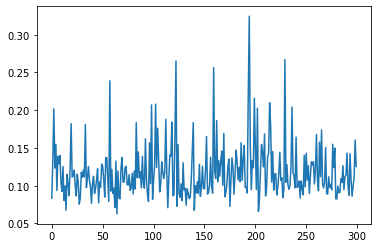

34398it [04:25, 142.25it/s]

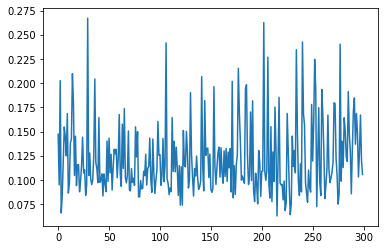

34592it [04:27, 142.11it/s]

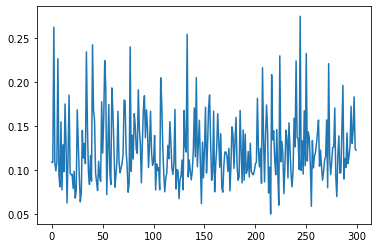

34787it [04:28, 143.16it/s]

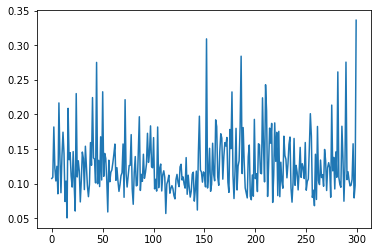

34997it [04:30, 143.35it/s]

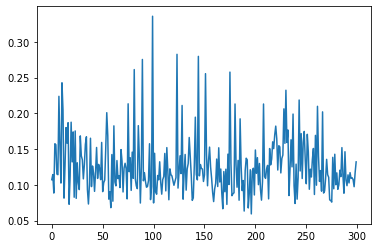

35192it [04:31, 143.36it/s]

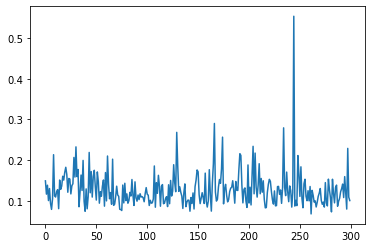

35387it [04:33, 142.42it/s]

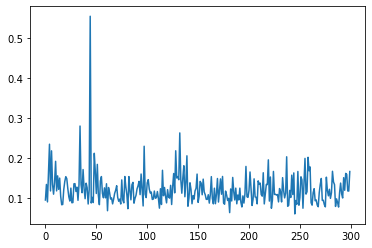

35597it [04:34, 143.40it/s]

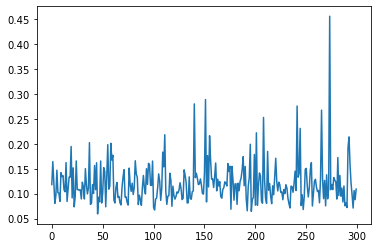

35792it [04:36, 143.40it/s]

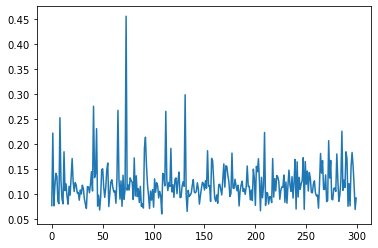

35986it [04:37, 142.10it/s]

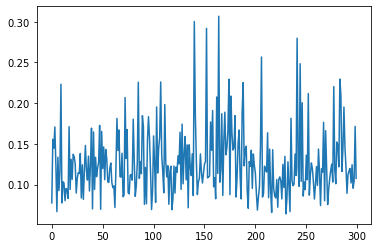

36196it [04:39, 141.78it/s]

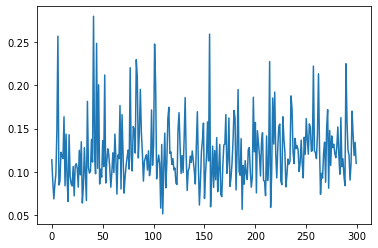

36391it [04:40, 142.48it/s]

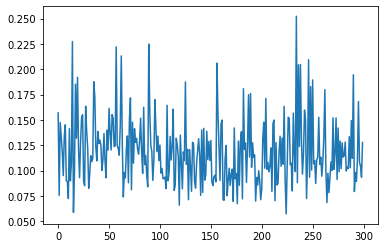

36586it [04:42, 142.61it/s]

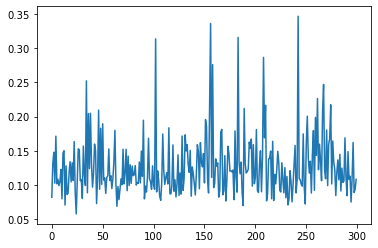

36796it [04:43, 142.88it/s]

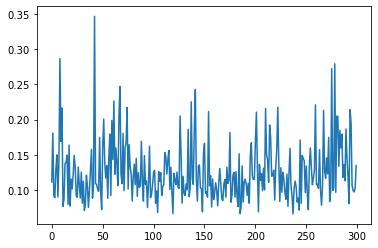

36991it [04:45, 141.75it/s]

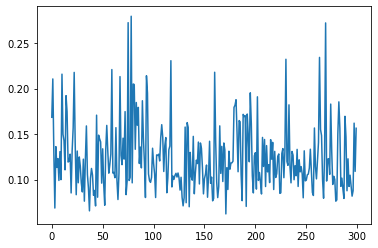

37186it [04:46, 142.69it/s]

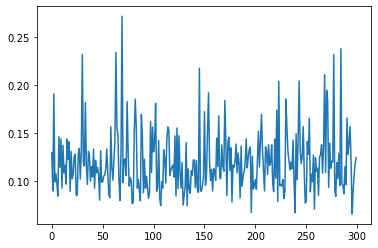

37396it [04:48, 143.16it/s]

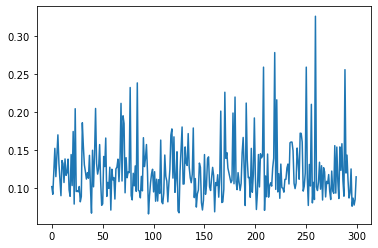

37591it [04:49, 140.57it/s]

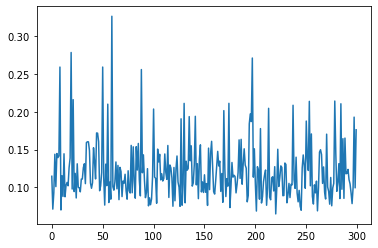

37786it [04:51, 142.51it/s]

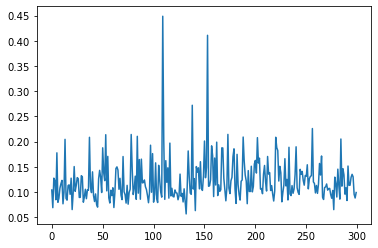

37996it [04:52, 143.73it/s]

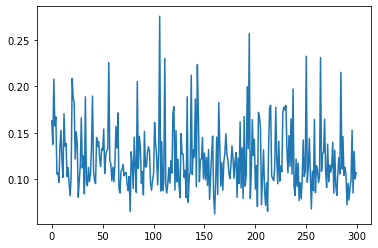

38191it [04:54, 142.10it/s]

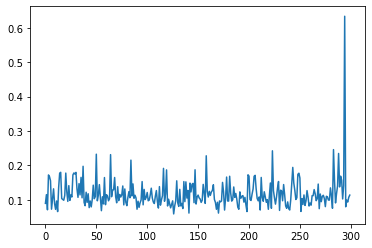

38386it [04:55, 140.44it/s]

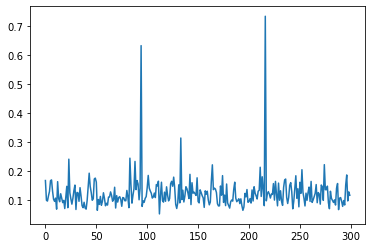

38595it [04:57, 142.44it/s]

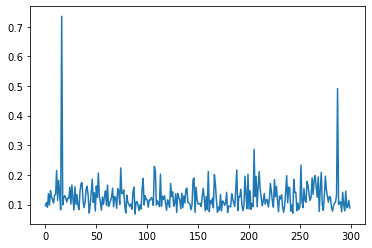

38790it [04:58, 143.49it/s]

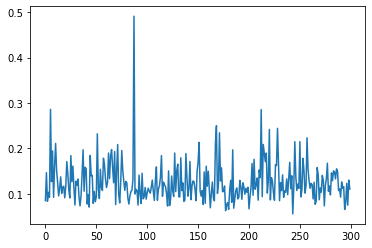

39000it [05:00, 143.39it/s]

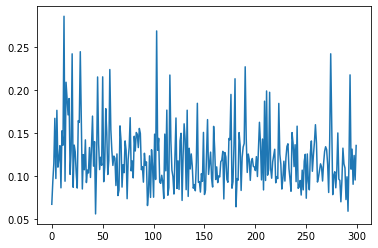

39195it [05:01, 143.14it/s]

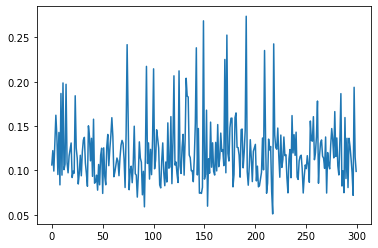

39390it [05:03, 143.01it/s]

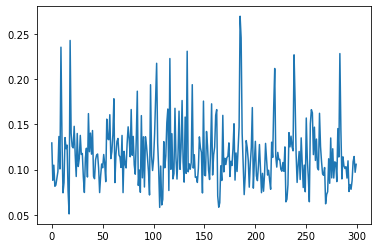

39600it [05:05, 144.07it/s]

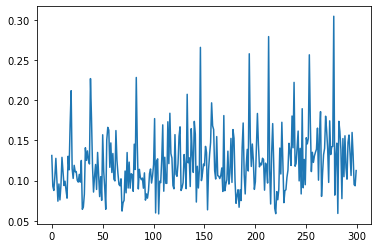

39793it [05:06, 141.85it/s]

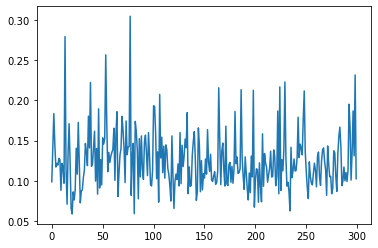

39988it [05:07, 143.05it/s]

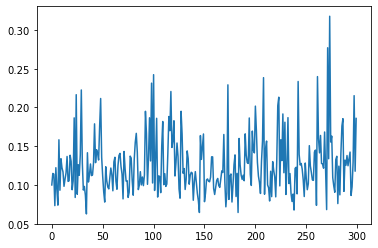

40198it [05:09, 142.31it/s]

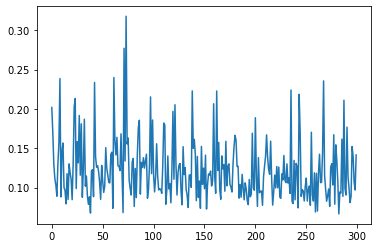

40392it [05:10, 143.24it/s]

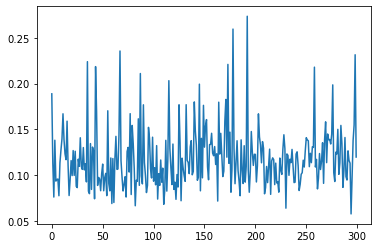

40594it [05:12, 118.89it/s]

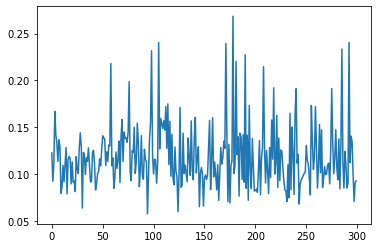

40798it [05:14, 109.57it/s]

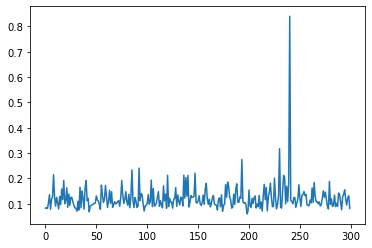

40989it [05:15, 134.41it/s]

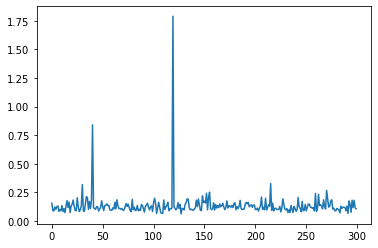

41196it [05:17, 143.02it/s]

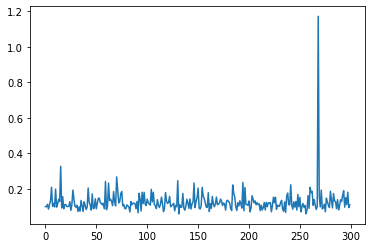

41390it [05:19, 142.51it/s]

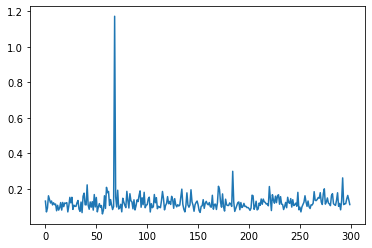

41600it [05:20, 143.54it/s]

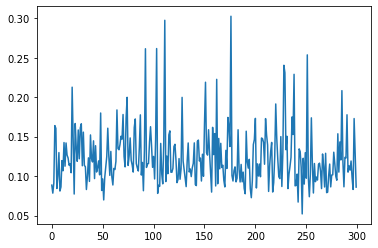

41794it [05:22, 143.06it/s]

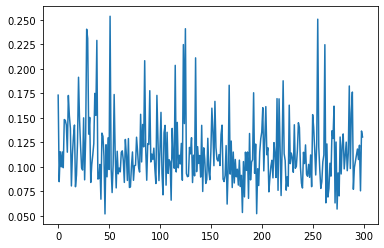

41988it [05:23, 142.18it/s]

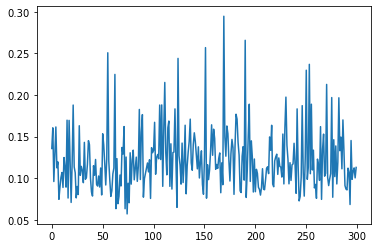

42197it [05:25, 142.52it/s]

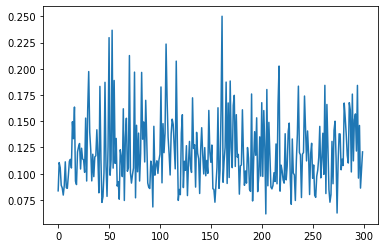

42392it [05:26, 142.40it/s]

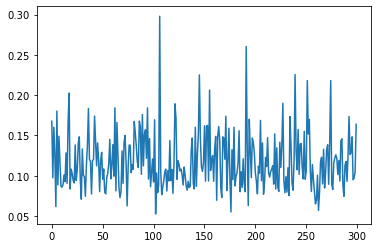

42586it [05:28, 142.29it/s]

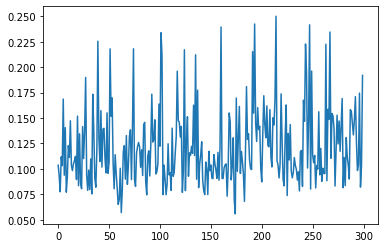

42796it [05:29, 143.15it/s]

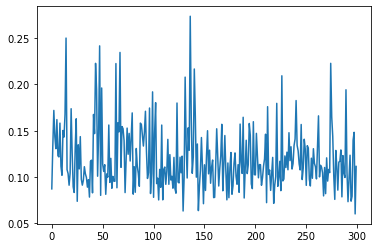

42990it [05:31, 143.39it/s]

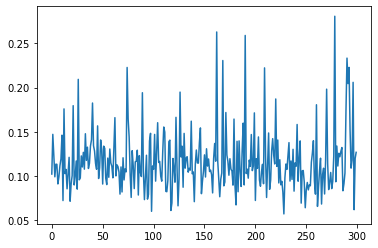

43200it [05:32, 143.96it/s]

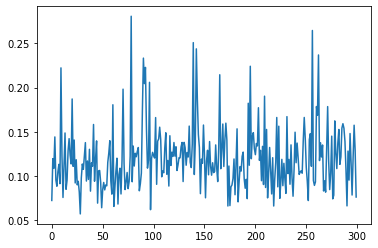

43394it [05:34, 143.13it/s]

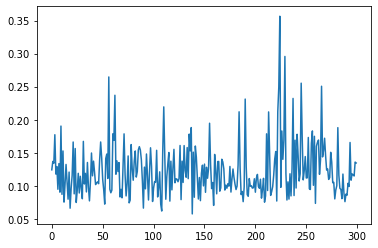

43589it [05:35, 142.62it/s]

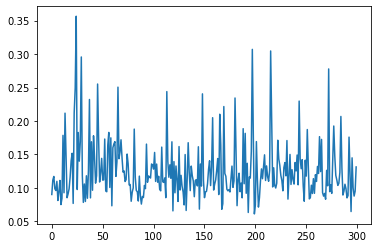

43798it [05:37, 139.33it/s]

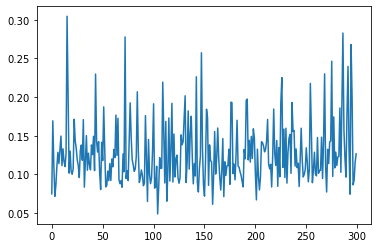

43992it [05:38, 142.78it/s]

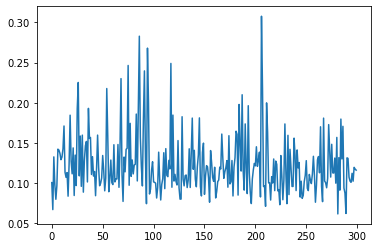

44186it [05:40, 142.51it/s]

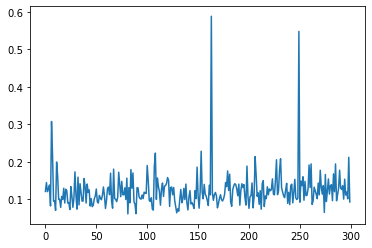

44396it [05:41, 142.38it/s]

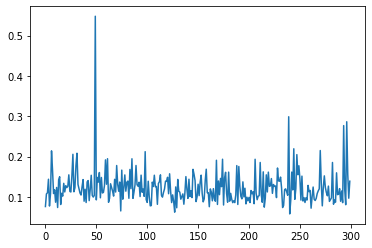

44590it [05:43, 143.50it/s]

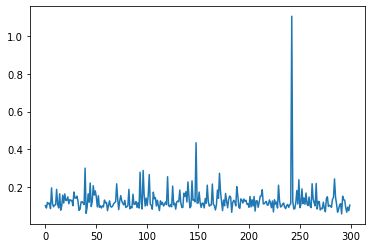

44799it [05:44, 138.54it/s]

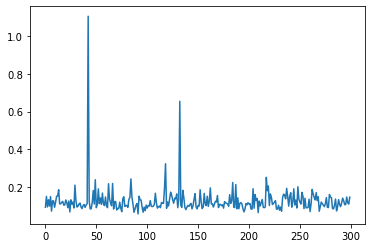

44991it [05:46, 141.42it/s]

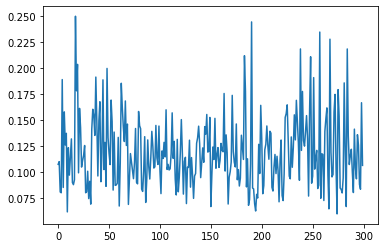

45200it [05:47, 142.53it/s]

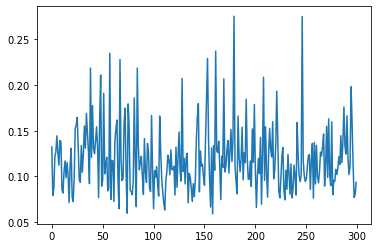

45394it [05:49, 142.45it/s]

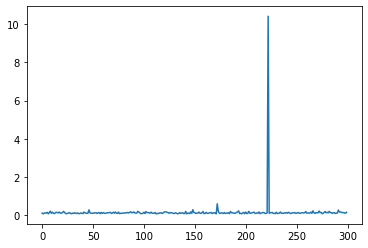

45589it [05:50, 142.99it/s]

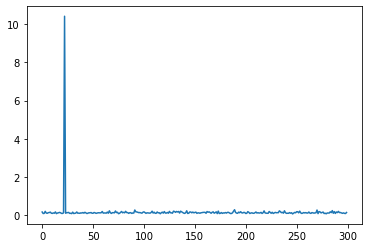

45798it [05:52, 143.07it/s]

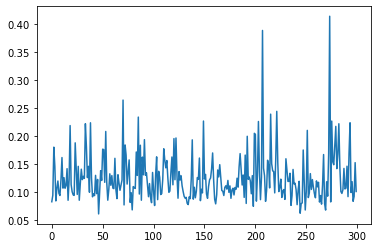

45993it [05:53, 142.33it/s]

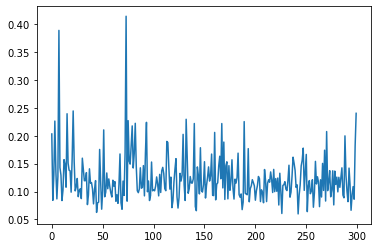

46187it [05:55, 142.61it/s]

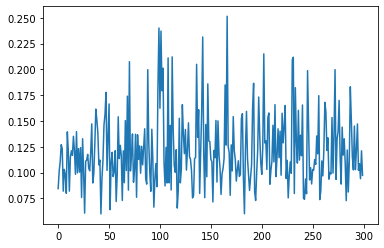

46397it [05:56, 142.30it/s]

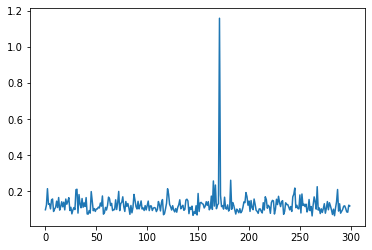

46592it [05:58, 142.30it/s]

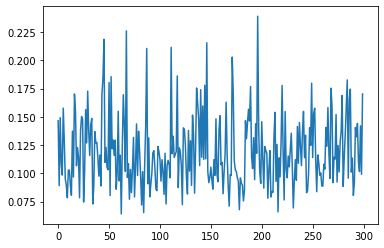

46787it [05:59, 143.02it/s]

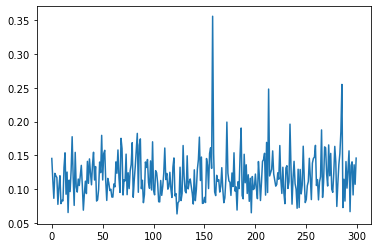

46996it [06:01, 142.75it/s]

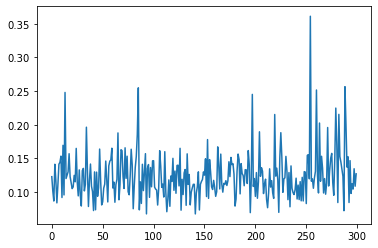

47191it [06:02, 143.40it/s]

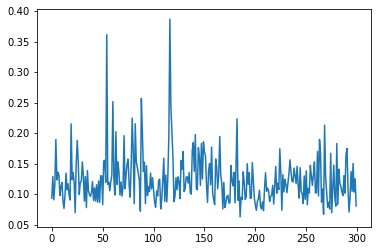

47400it [06:04, 143.75it/s]

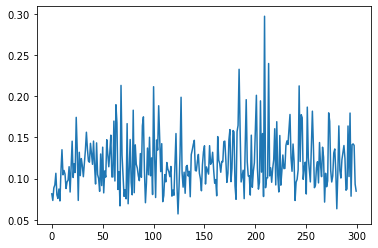

47595it [06:06, 142.96it/s]

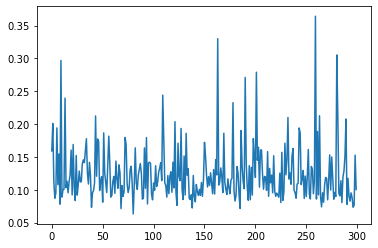

47789it [06:07, 142.47it/s]

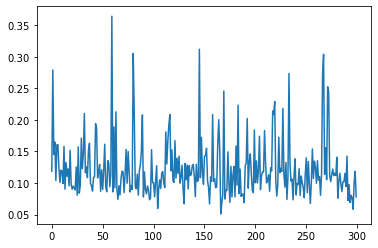

47999it [06:09, 143.63it/s]

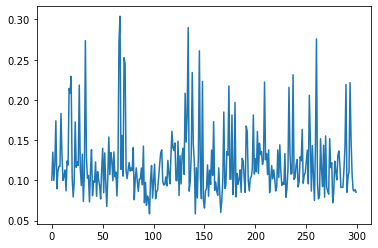

48193it [06:10, 143.16it/s]

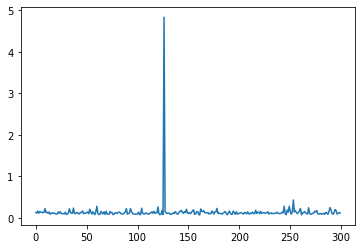

48388it [06:11, 142.64it/s]

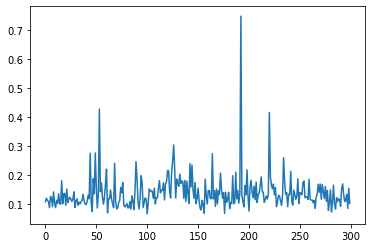

48594it [06:13, 141.98it/s]

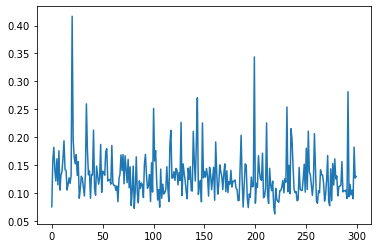

48789it [06:15, 143.17it/s]

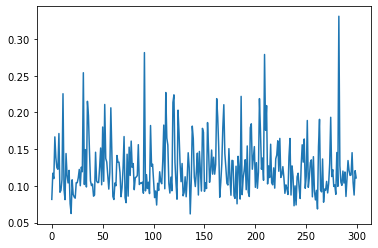

48998it [06:16, 141.73it/s]

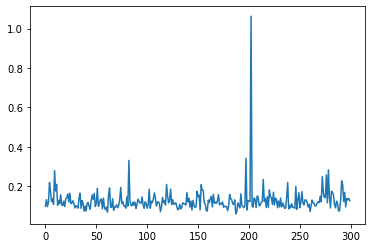

49193it [06:18, 143.10it/s]

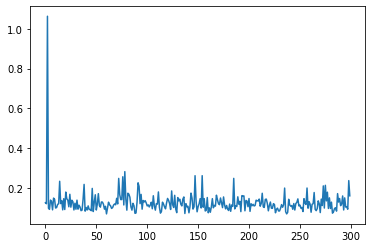

49388it [06:19, 143.01it/s]

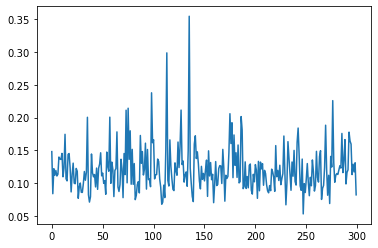

49597it [06:21, 141.80it/s]

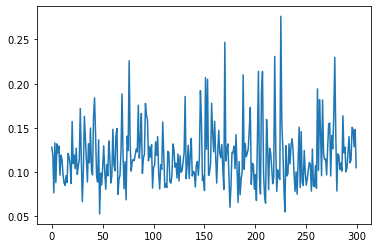

49791it [06:22, 142.22it/s]

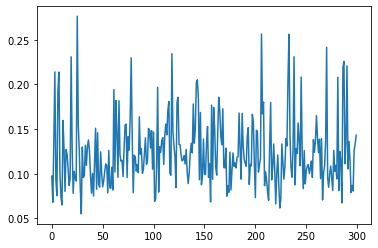

49986it [06:24, 142.86it/s]

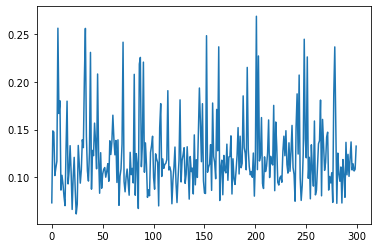

50196it [06:25, 142.97it/s]

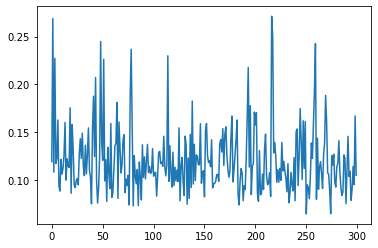

50390it [06:27, 143.01it/s]

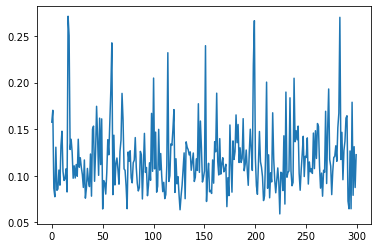

50600it [06:28, 143.13it/s]

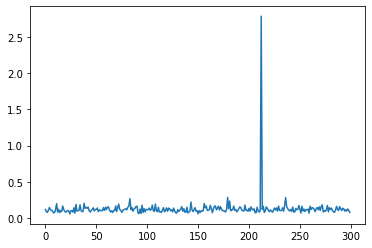

50795it [06:30, 142.28it/s]

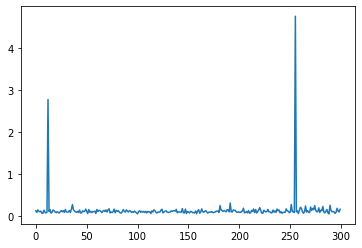

51000it [06:31, 130.13it/s]

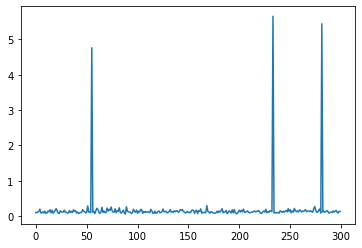

51194it [06:33, 142.23it/s]

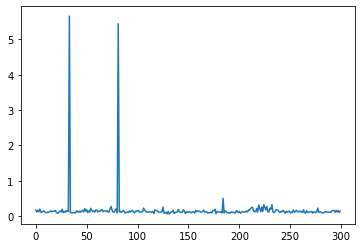

51389it [06:34, 142.43it/s]

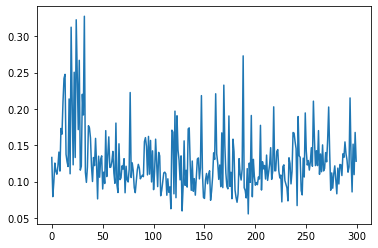

51599it [06:36, 143.57it/s]

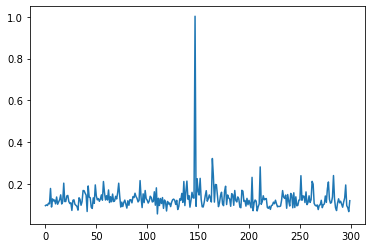

51794it [06:37, 142.83it/s]

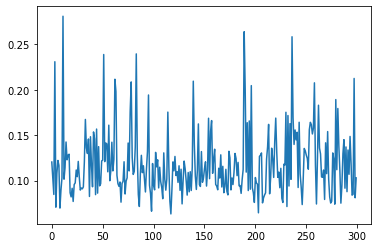

51989it [06:39, 142.50it/s]

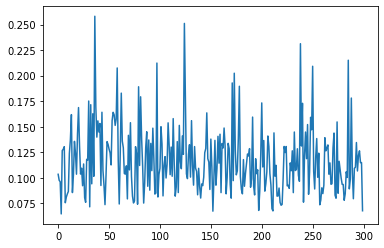

52199it [06:40, 142.67it/s]

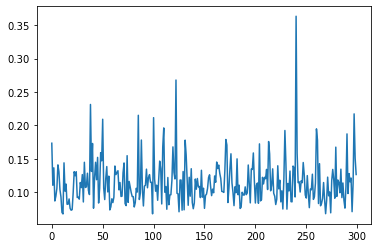

52394it [06:42, 143.16it/s]

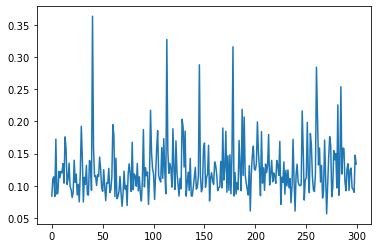

52589it [06:43, 141.86it/s]

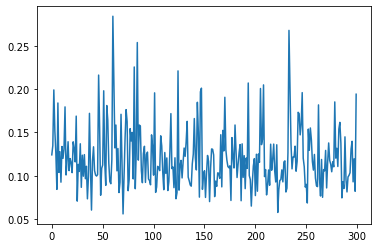

52799it [06:45, 143.81it/s]

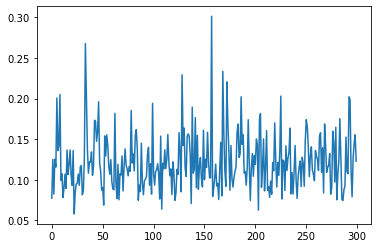

52993it [06:46, 142.38it/s]

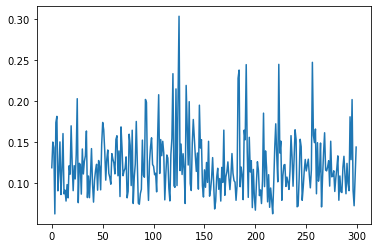

53188it [06:48, 143.52it/s]

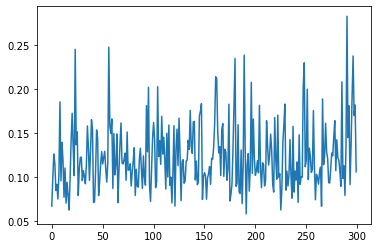

53398it [06:49, 143.09it/s]

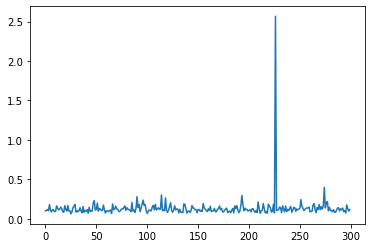

53591it [06:51, 142.90it/s]

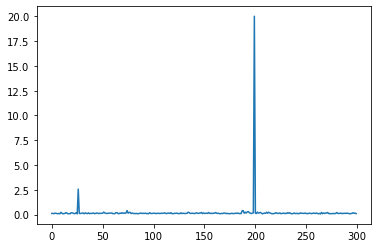

53800it [06:52, 142.75it/s]

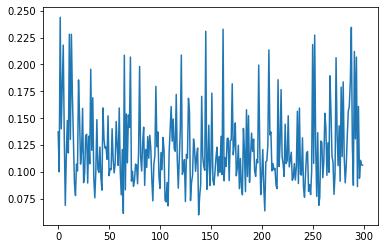

53995it [06:54, 142.93it/s]

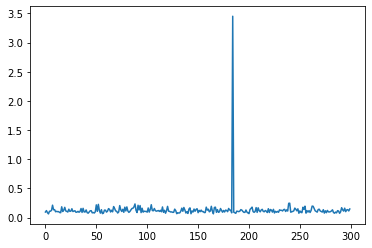

54190it [06:55, 142.23it/s]

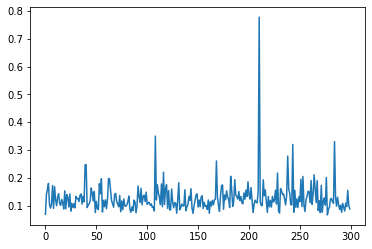

54400it [06:57, 143.79it/s]

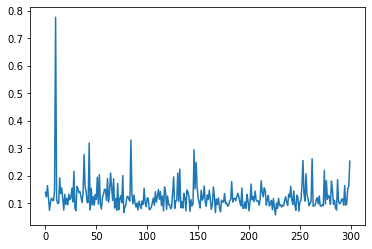

54595it [06:58, 142.74it/s]

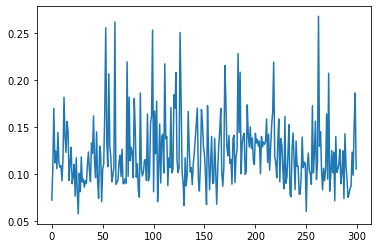

54790it [07:00, 143.55it/s]

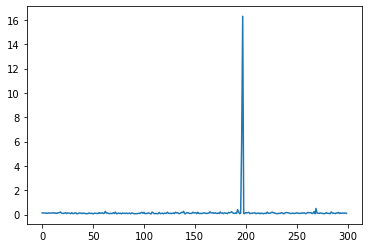

55000it [07:01, 142.88it/s]

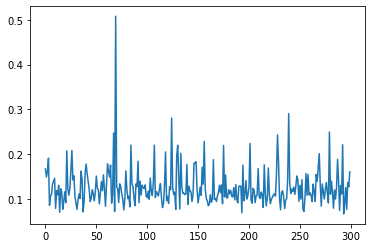

55195it [07:03, 142.83it/s]

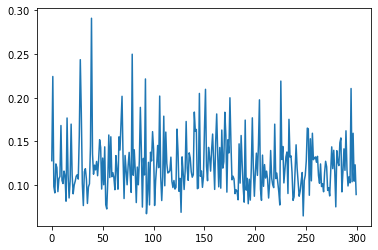

55390it [07:04, 142.56it/s]

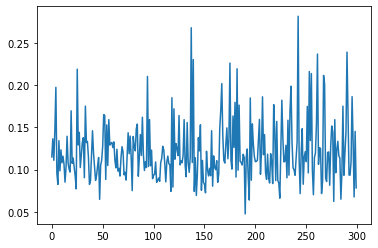

55600it [07:06, 143.02it/s]

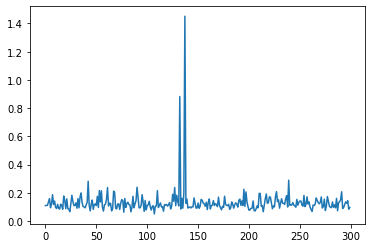

55794it [07:07, 142.98it/s]

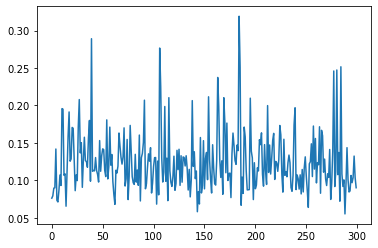

55989it [07:09, 142.13it/s]

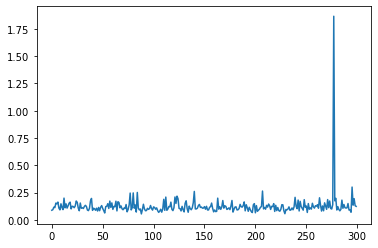

56199it [07:11, 143.19it/s]

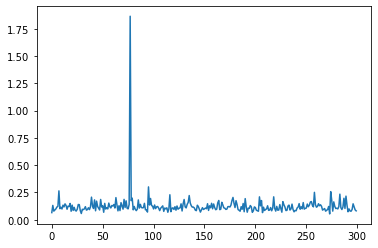

56389it [07:12, 123.15it/s]

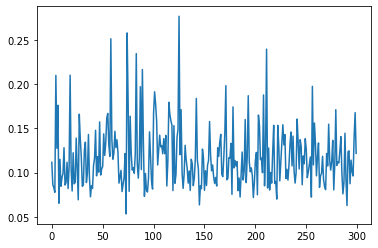

56598it [07:14, 122.32it/s]

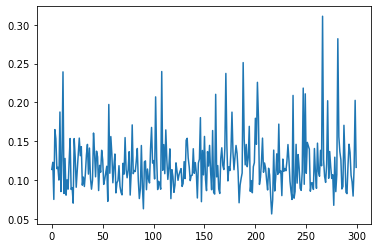

56790it [07:15, 134.68it/s]

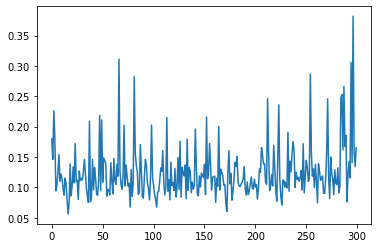

56993it [07:17, 141.44it/s]

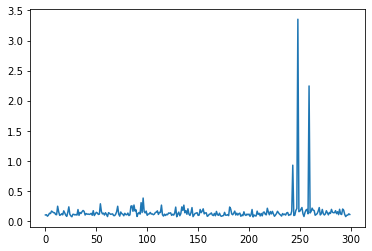

57188it [07:18, 142.50it/s]

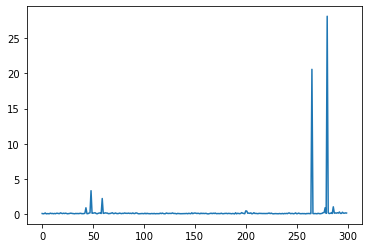

57397it [07:20, 143.52it/s]

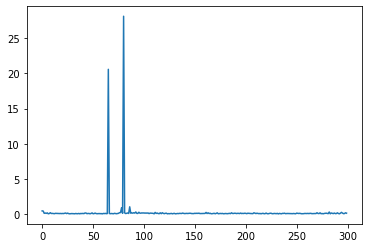

57592it [07:21, 142.45it/s]

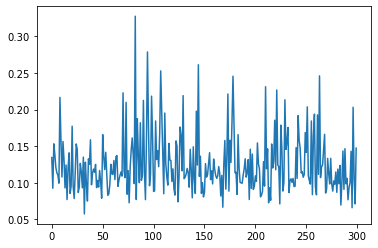

57786it [07:23, 143.83it/s]

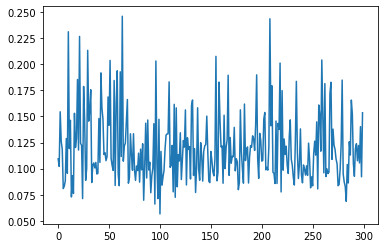

57996it [07:24, 144.09it/s]

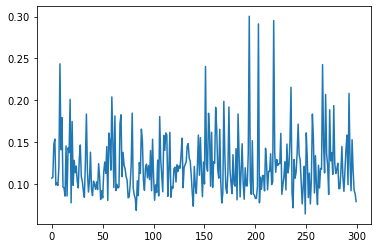

58187it [07:26, 139.68it/s]

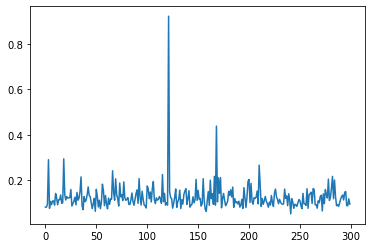

58397it [07:28, 143.02it/s]

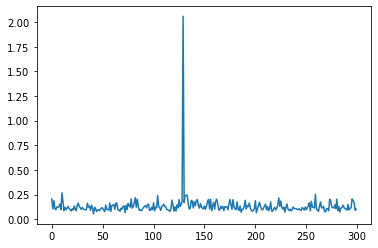

58588it [07:29, 137.43it/s]

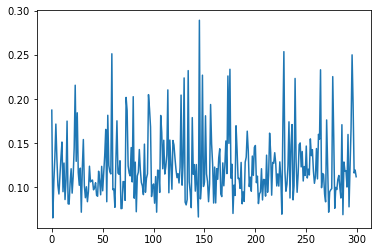

58790it [07:31, 140.25it/s]

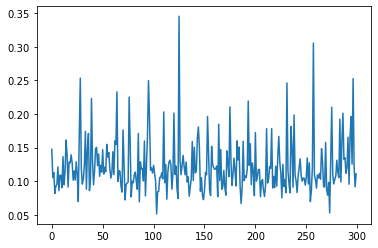

58993it [07:32, 129.45it/s]

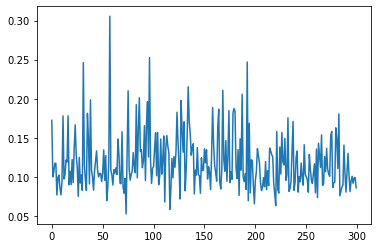

59187it [07:34, 144.25it/s]

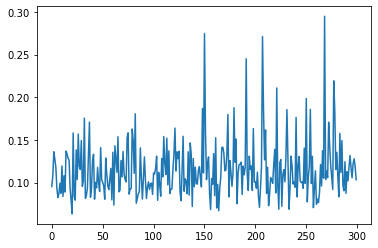

59396it [07:35, 144.04it/s]

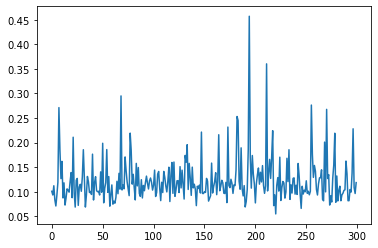

59590it [07:37, 137.95it/s]

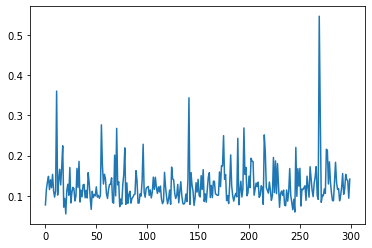

59794it [07:38, 141.27it/s]

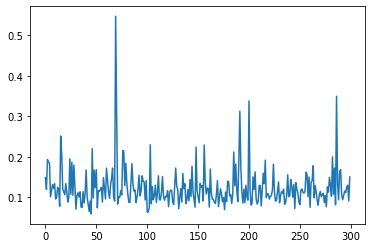

60000it [07:40, 140.86it/s]

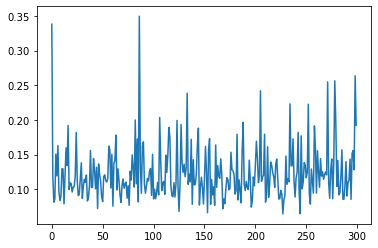

60194it [07:41, 141.81it/s]

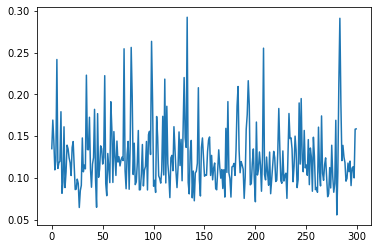

60398it [07:43, 143.14it/s]

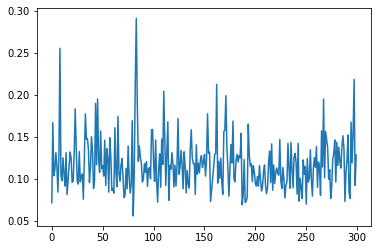

60593it [07:44, 143.93it/s]

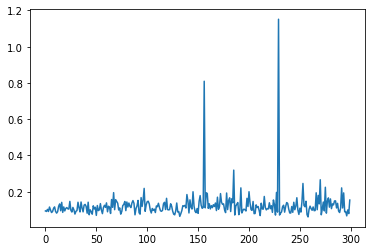

60788it [07:46, 142.68it/s]

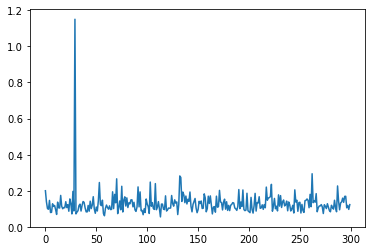

60998it [07:47, 138.35it/s]

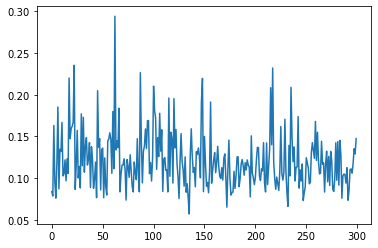

61192it [07:49, 143.88it/s]

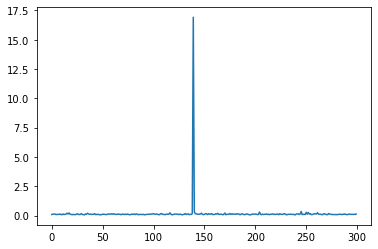

61387it [07:50, 144.05it/s]

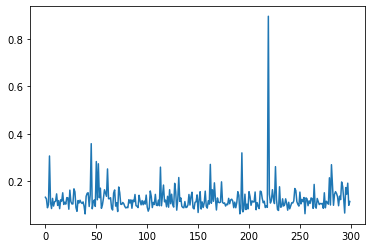

61597it [07:52, 144.57it/s]

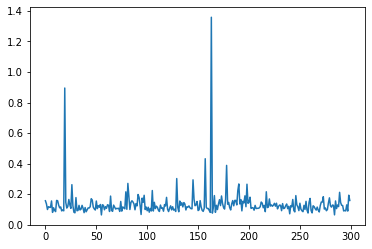

61791it [07:53, 143.03it/s]

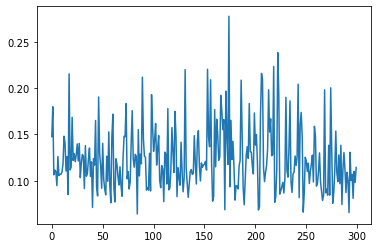

61986it [07:55, 144.35it/s]

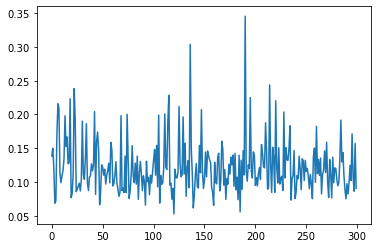

62195it [07:56, 144.49it/s]

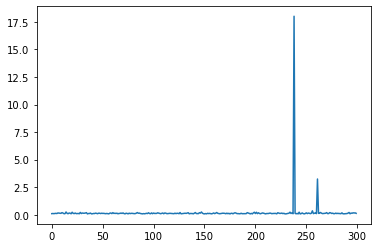

62390it [07:58, 143.71it/s]

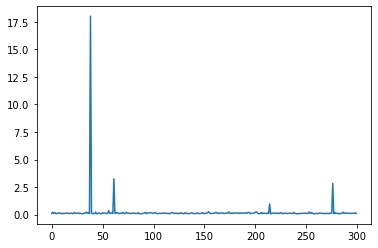

62599it [07:59, 143.74it/s]

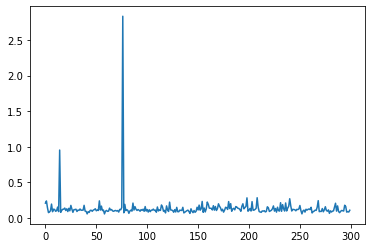

62794it [08:01, 144.32it/s]

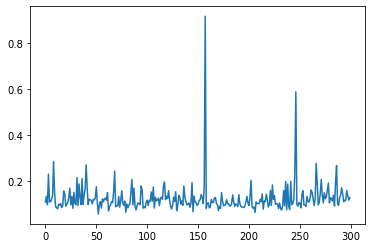

62988it [08:02, 142.24it/s]

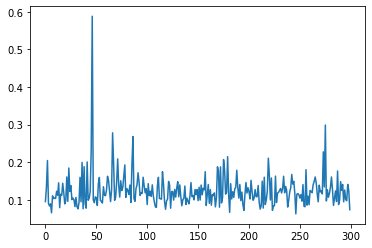

63198it [08:04, 144.89it/s]

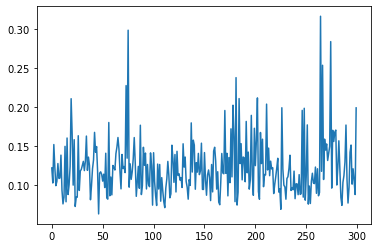

63393it [08:05, 143.30it/s]

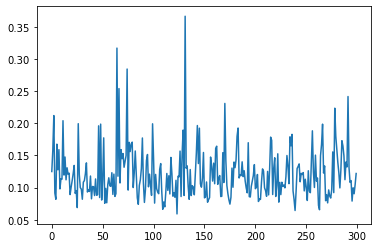

63588it [08:07, 142.51it/s]

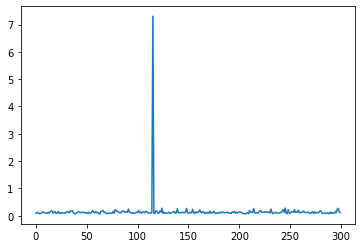

63797it [08:08, 144.39it/s]

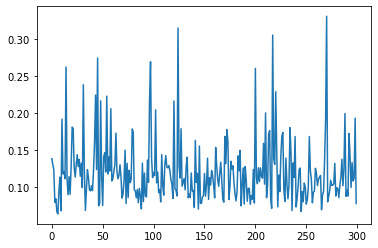

63992it [08:10, 142.77it/s]

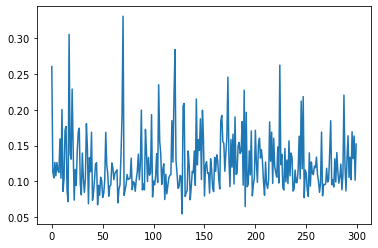

64186it [08:11, 144.11it/s]

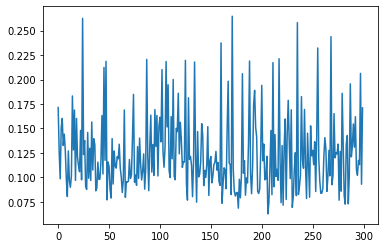

64396it [08:13, 144.98it/s]

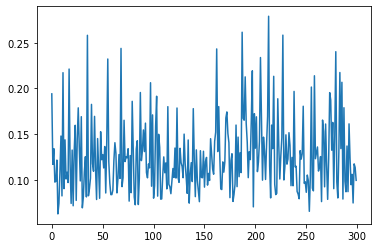

64588it [08:14, 137.71it/s]

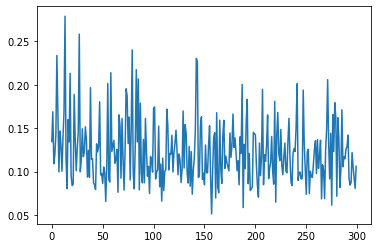

64791it [08:16, 139.70it/s]

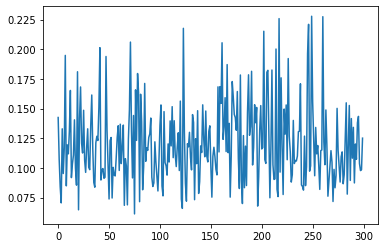

64993it [08:18, 133.13it/s]

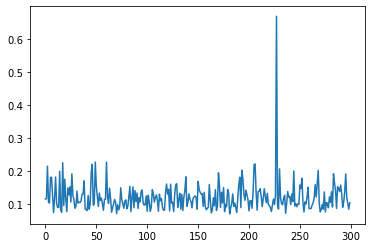

65187it [08:19, 144.98it/s]

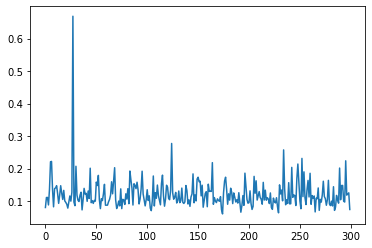

65396it [08:21, 144.53it/s]

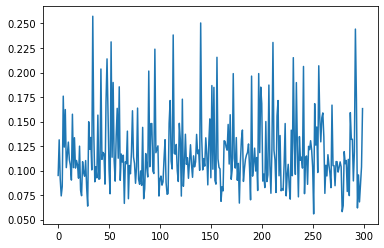

65591it [08:22, 145.54it/s]

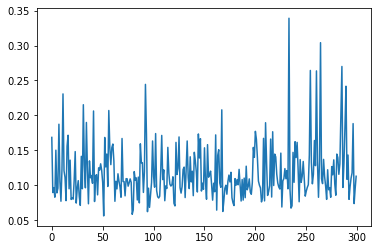

65800it [08:24, 143.35it/s]

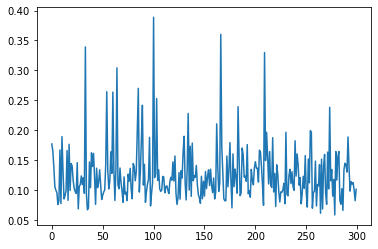

65994it [08:25, 142.69it/s]

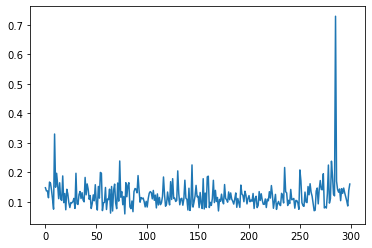

66188it [08:27, 143.43it/s]

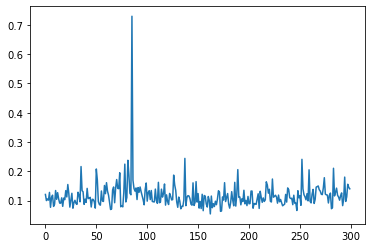

66398it [08:28, 142.80it/s]

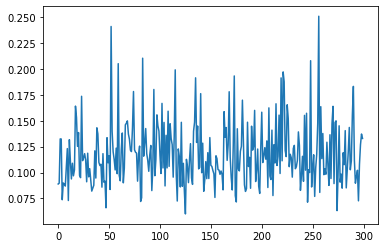

66592it [08:30, 142.35it/s]

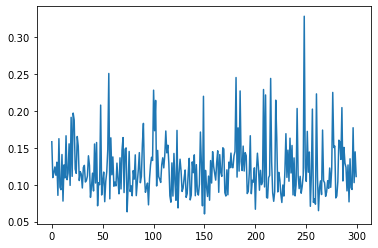

66787it [08:31, 142.42it/s]

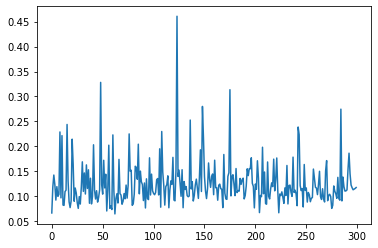

66997it [08:33, 143.46it/s]

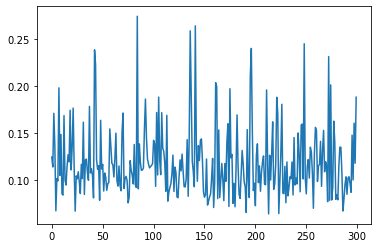

67191it [08:34, 142.41it/s]

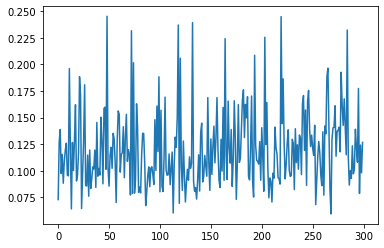

67399it [08:36, 142.86it/s]

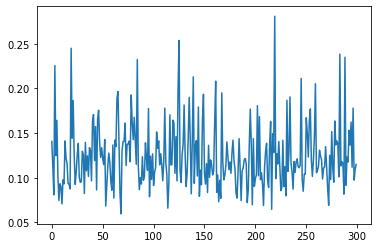

67594it [08:37, 141.60it/s]

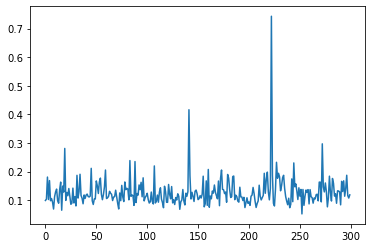

67789it [08:39, 141.72it/s]

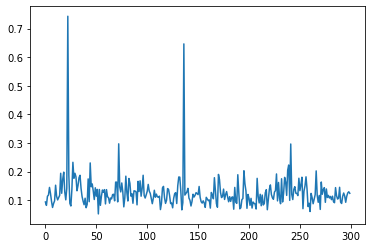

67999it [08:40, 141.40it/s]

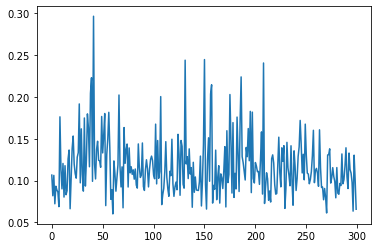

68191it [08:42, 141.27it/s]

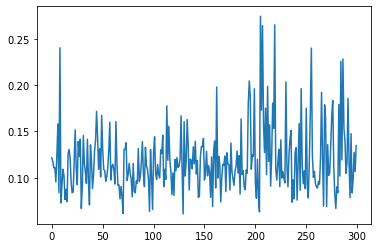

68397it [08:43, 139.73it/s]

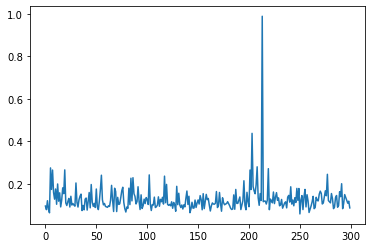

68598it [08:45, 138.69it/s]

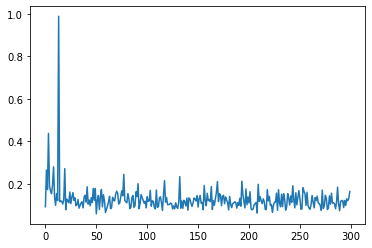

68797it [08:47, 138.36it/s]

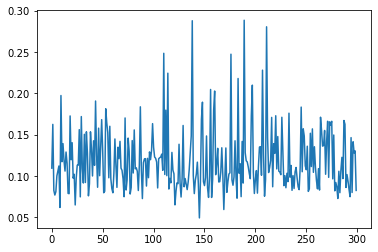

68997it [08:48, 138.27it/s]

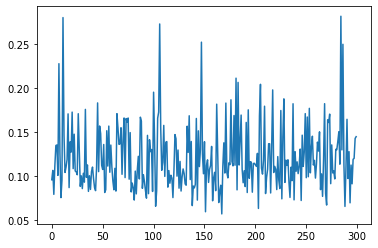

69196it [08:50, 135.54it/s]

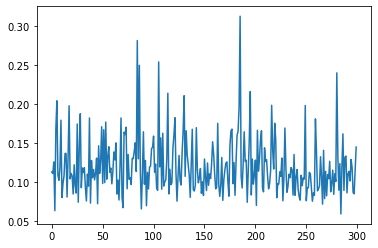

69398it [08:51, 135.24it/s]

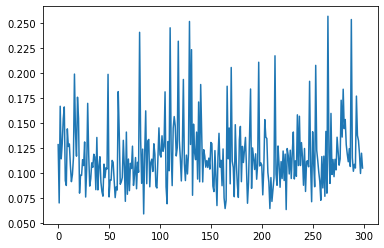

69591it [08:53, 141.20it/s]

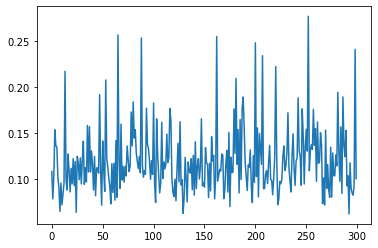

69800it [08:54, 141.62it/s]

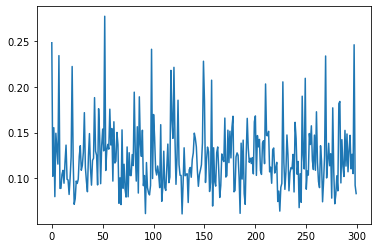

69993it [08:56, 139.10it/s]

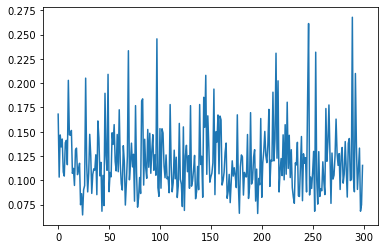

70199it [08:57, 138.18it/s]

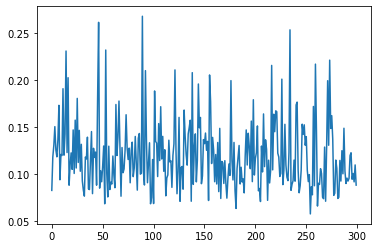

70388it [08:59, 137.18it/s]

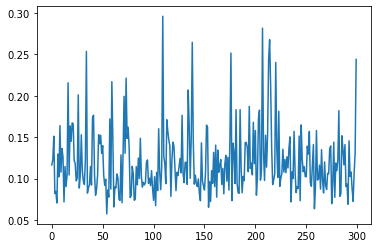

70593it [09:00, 141.77it/s]

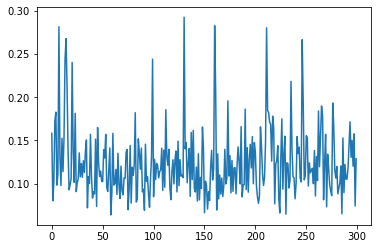

70794it [09:02, 135.05it/s]

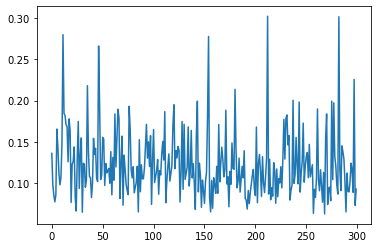

70998it [09:04, 139.98it/s]

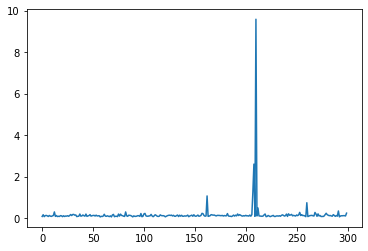

71192it [09:05, 139.15it/s]

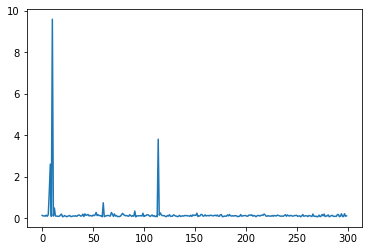

71400it [09:07, 141.52it/s]

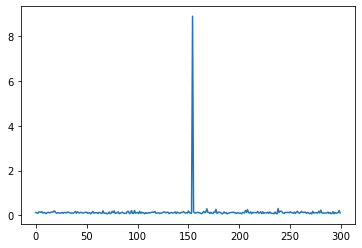

71594it [09:08, 140.41it/s]

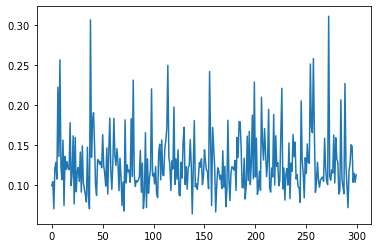

71797it [09:10, 139.53it/s]

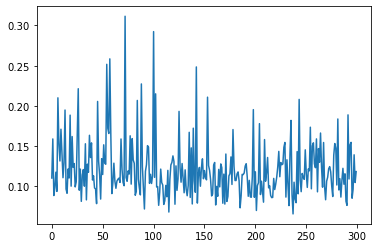

71991it [09:11, 139.26it/s]

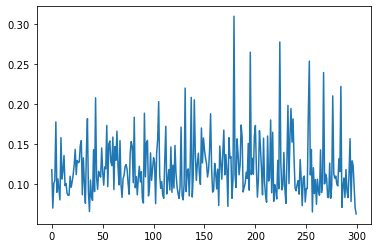

72191it [09:13, 126.90it/s]

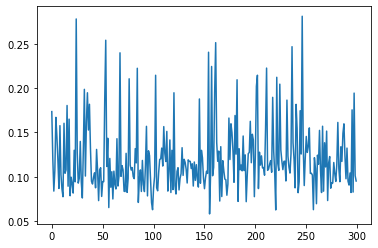

72390it [09:15, 127.84it/s]

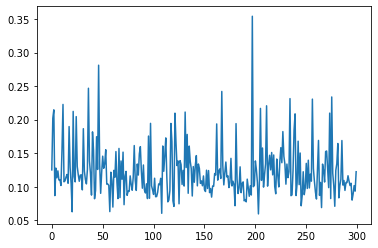

72588it [09:16, 127.83it/s]

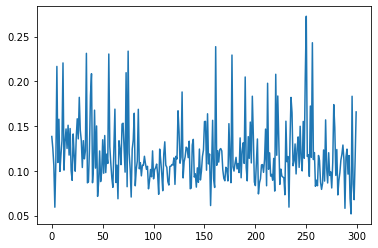

72799it [09:18, 139.11it/s]

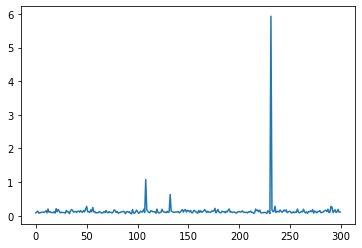

72999it [09:20, 140.48it/s]

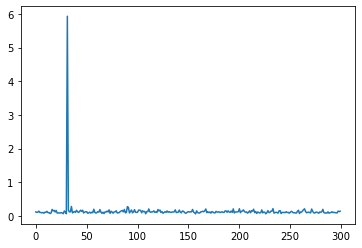

73193it [09:21, 140.22it/s]

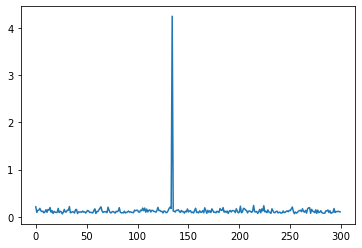

73400it [09:23, 136.22it/s]

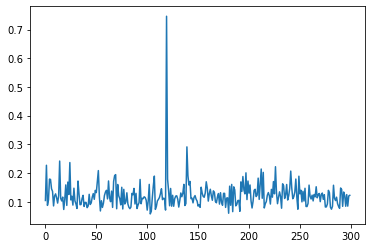

73597it [09:24, 137.77it/s]

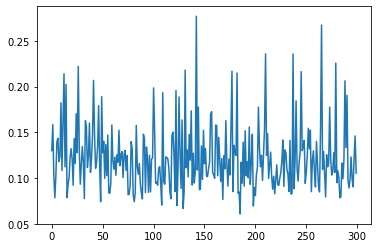

73787it [09:26, 139.09it/s]

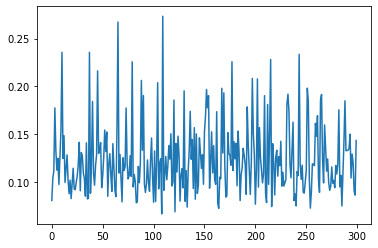

73993it [09:27, 137.35it/s]

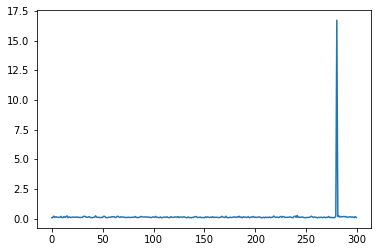

74194it [09:29, 135.90it/s]

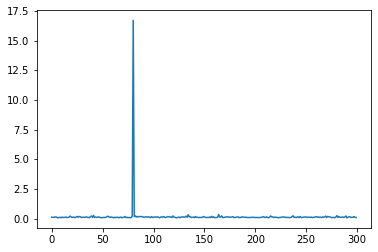

74397it [09:30, 140.40it/s]

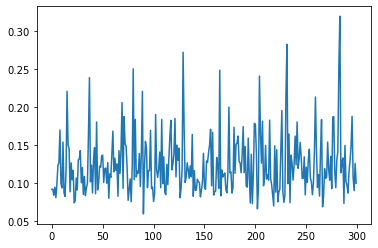

74589it [09:32, 139.73it/s]

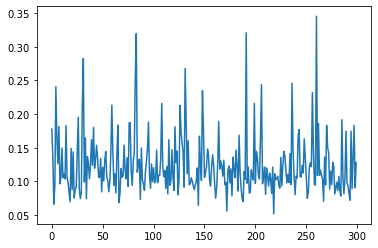

74795it [09:33, 139.19it/s]

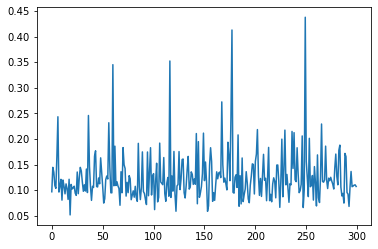

74996it [09:35, 136.94it/s]

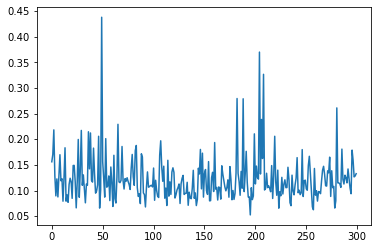

75192it [09:37, 138.33it/s]

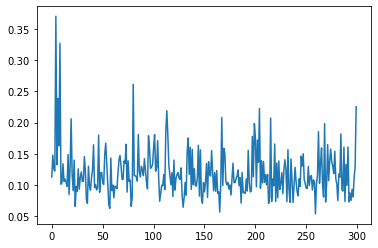

75392it [09:38, 134.10it/s]

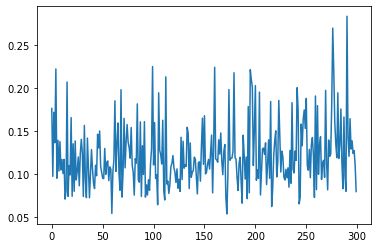

75594it [09:40, 138.09it/s]

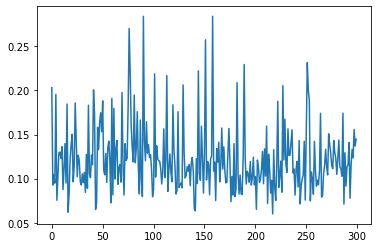

75800it [09:41, 139.29it/s]

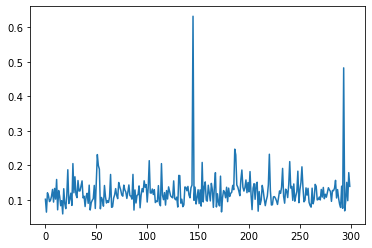

75988it [09:43, 137.59it/s]

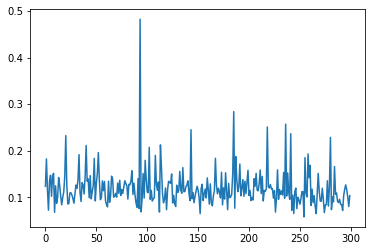

76198it [09:45, 134.21it/s]

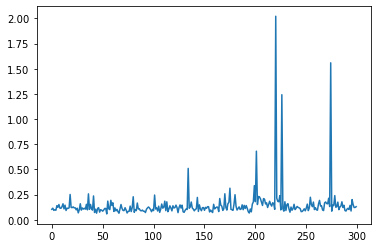

76388it [09:46, 127.15it/s]

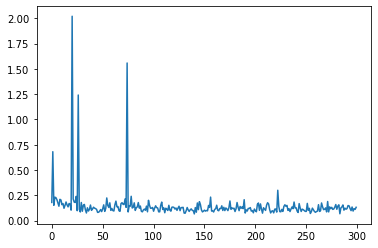

76600it [09:48, 136.76it/s]

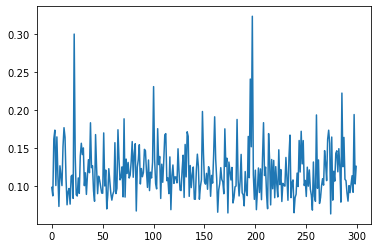

76798it [09:49, 138.96it/s]

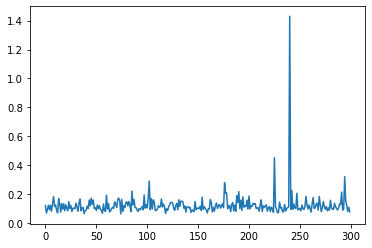

76996it [09:51, 138.17it/s]

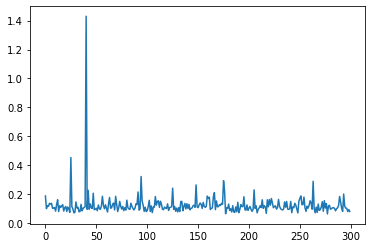

77196it [09:52, 134.14it/s]

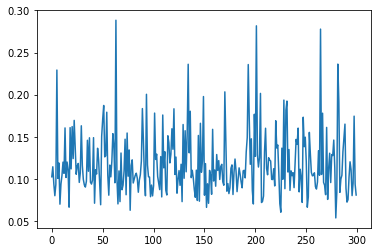

77386it [09:54, 140.04it/s]

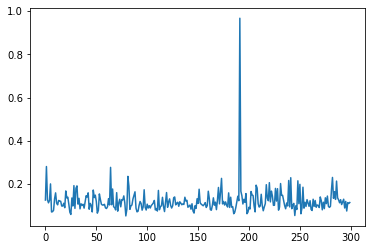

77590it [09:55, 140.27it/s]

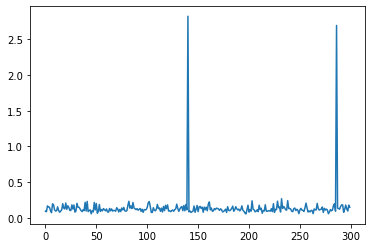

77799it [09:57, 140.90it/s]

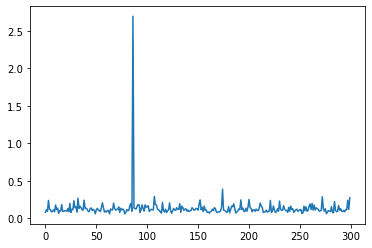

77990it [09:58, 141.24it/s]

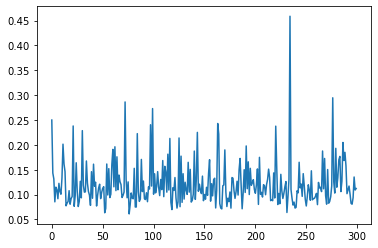

78195it [10:00, 138.87it/s]

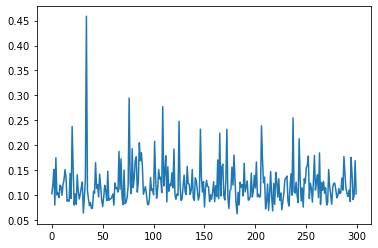

78388it [10:02, 140.41it/s]

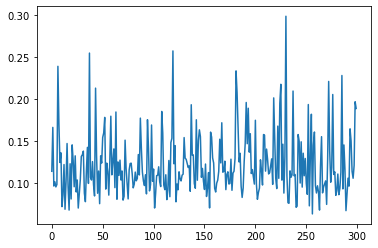

78593it [10:03, 139.98it/s]

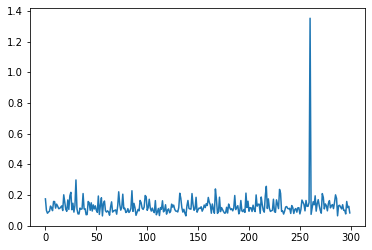

78788it [10:05, 141.82it/s]

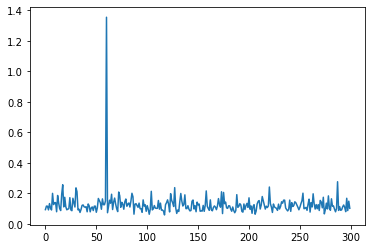

78997it [10:06, 139.91it/s]

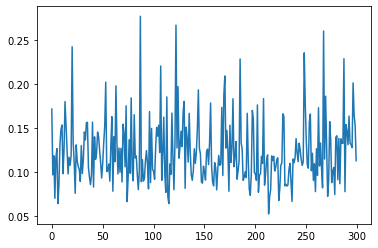

79190it [10:08, 139.98it/s]

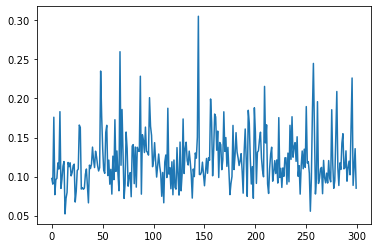

79395it [10:09, 140.49it/s]

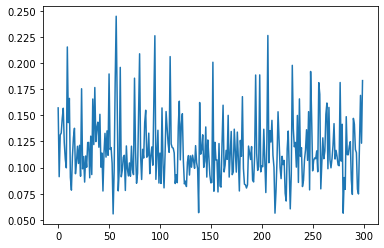

79590it [10:11, 140.80it/s]

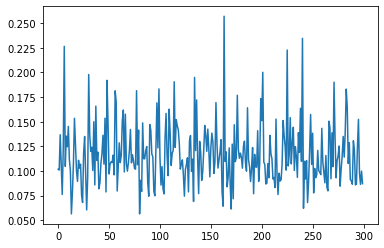

79798it [10:12, 140.49it/s]

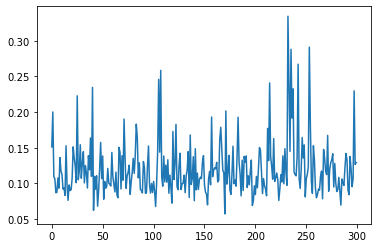

79992it [10:14, 140.95it/s]

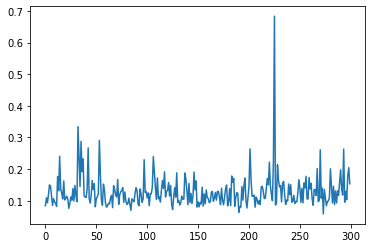

80194it [10:15, 140.15it/s]

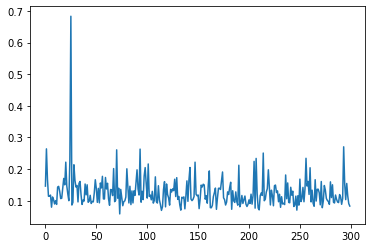

80388it [10:17, 140.35it/s]

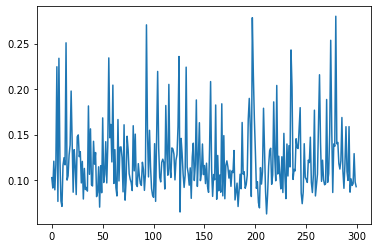

80595it [10:19, 140.80it/s]

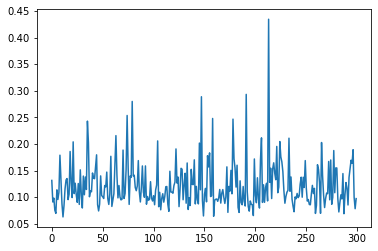

80790it [10:20, 141.41it/s]

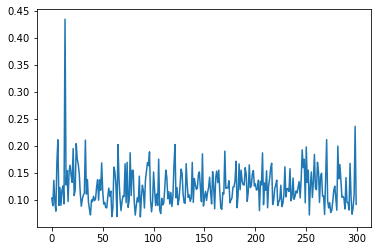

80999it [10:22, 141.46it/s]

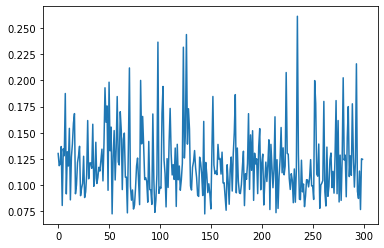

81192it [10:23, 140.73it/s]

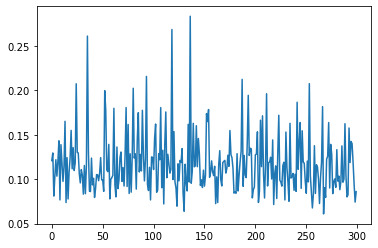

81386it [10:25, 141.63it/s]

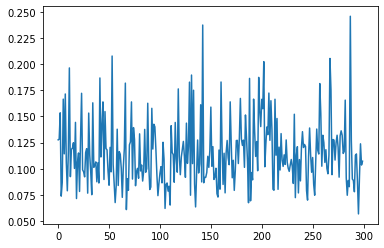

81596it [10:26, 141.55it/s]

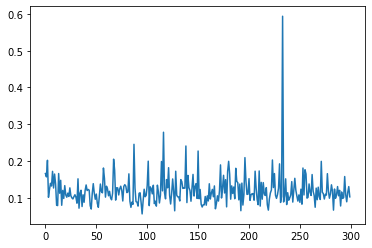

81790it [10:28, 141.65it/s]

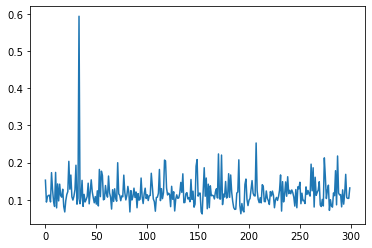

82000it [10:29, 141.90it/s]

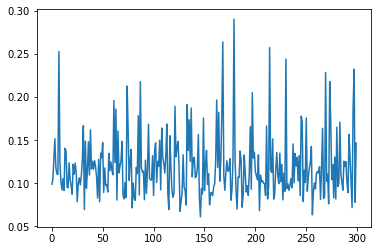

82190it [10:31, 141.01it/s]

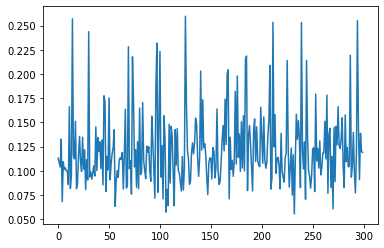

82399it [10:32, 142.28it/s]

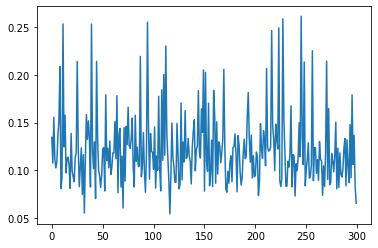

82593it [10:34, 141.16it/s]

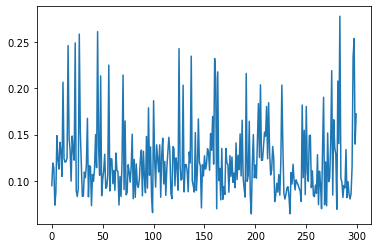

82788it [10:35, 142.32it/s]

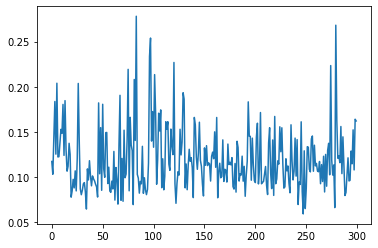

82996it [10:37, 142.28it/s]

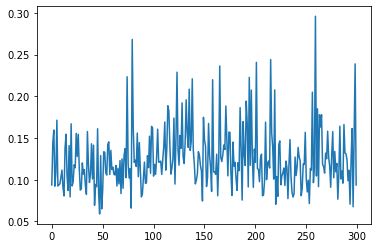

83190it [10:38, 141.32it/s]

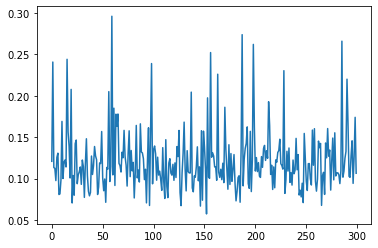

83398it [10:40, 141.64it/s]

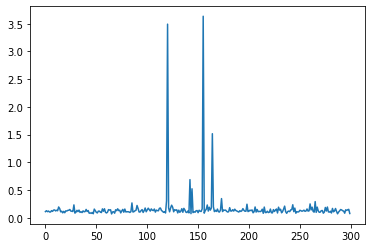

83593it [10:41, 141.36it/s]

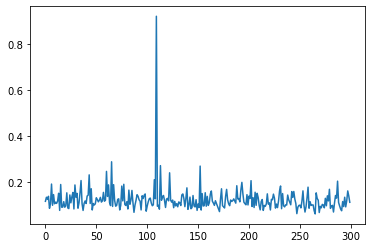

83786it [10:43, 141.61it/s]

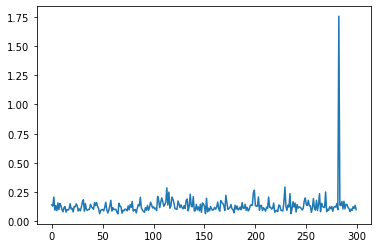

83989it [10:44, 140.41it/s]

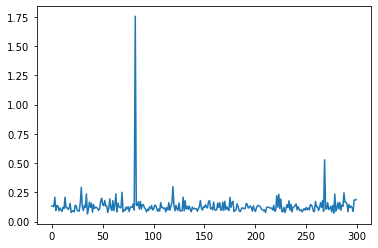

84198it [10:46, 140.23it/s]

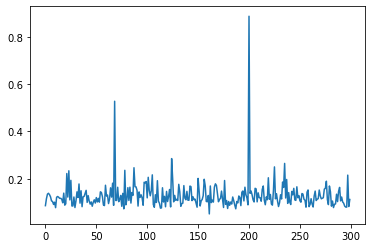

84393it [10:48, 141.55it/s]

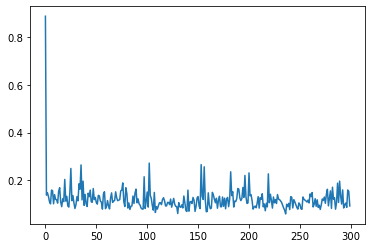

84587it [10:49, 141.17it/s]

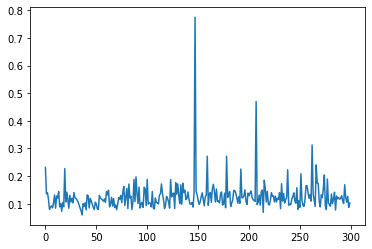

84797it [10:51, 142.03it/s]

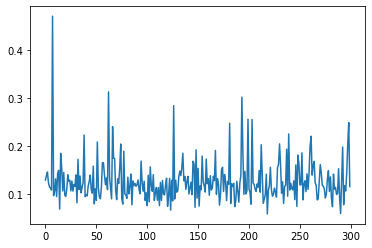

84991it [10:52, 141.56it/s]

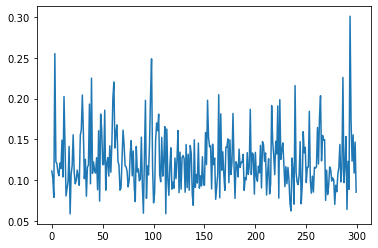

85186it [10:54, 141.92it/s]

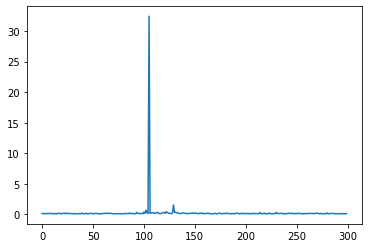

85396it [10:55, 142.20it/s]

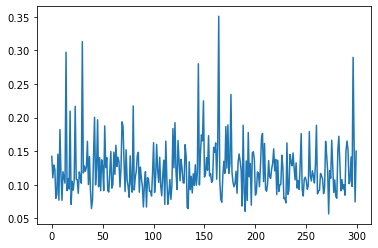

85591it [10:57, 142.09it/s]

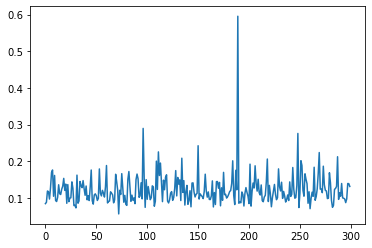

85799it [10:58, 141.33it/s]

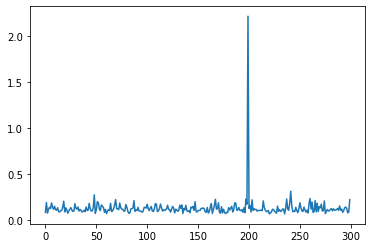

85994it [11:00, 142.46it/s]

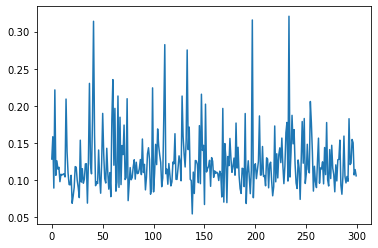

86188it [11:01, 141.89it/s]

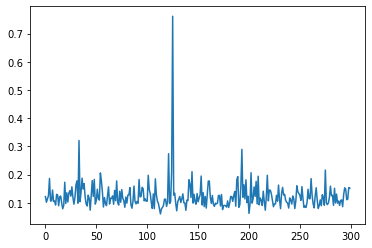

86398it [11:03, 143.49it/s]

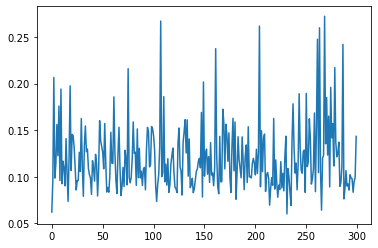

86592it [11:04, 142.56it/s]

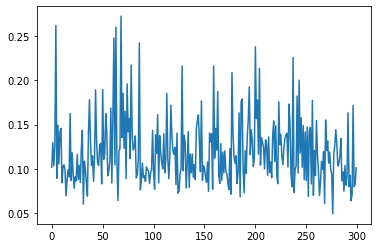

86797it [11:06, 137.95it/s]

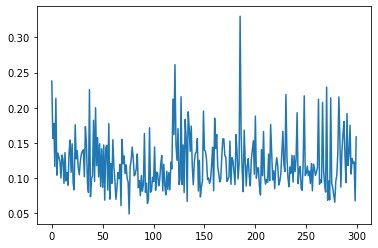

86990it [11:07, 141.52it/s]

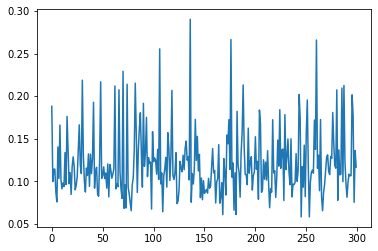

87199it [11:09, 142.53it/s]

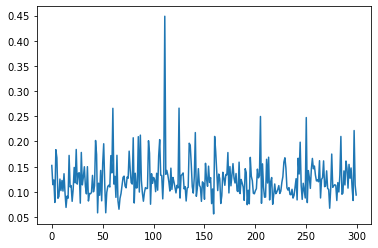

87393it [11:10, 141.73it/s]

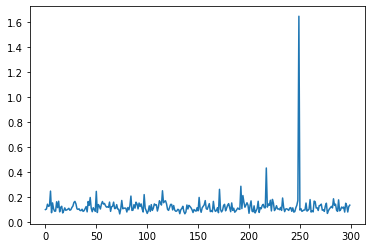

87598it [11:12, 124.27it/s]

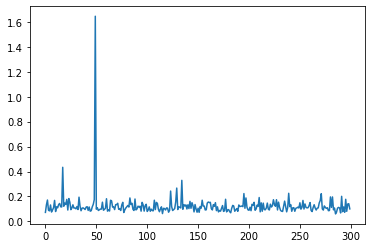

87789it [11:14, 131.01it/s]

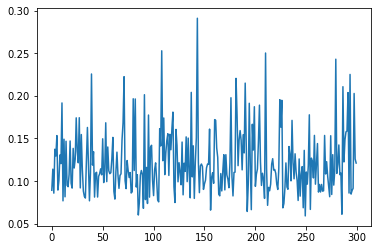

87999it [11:15, 132.67it/s]

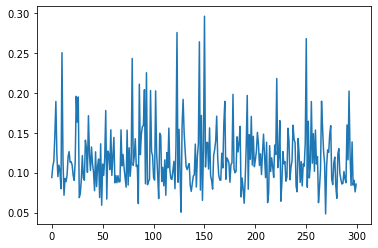

88199it [11:17, 139.31it/s]

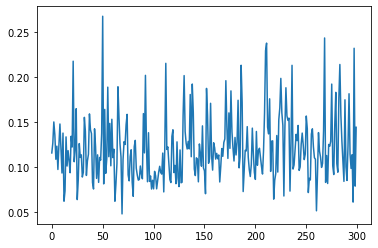

88389it [11:18, 138.49it/s]

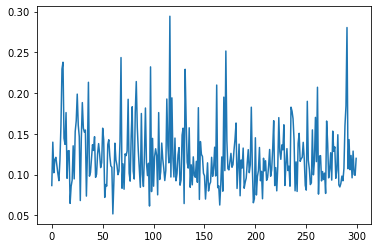

88596it [11:20, 140.97it/s]

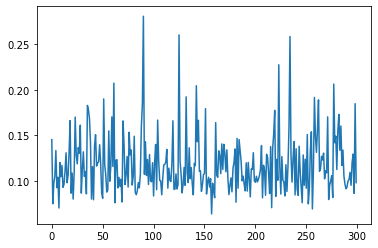

88790it [11:22, 140.02it/s]

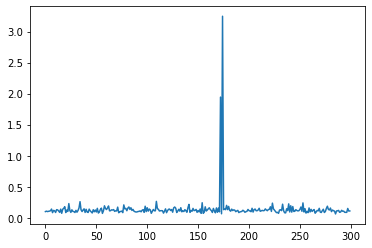

89000it [11:23, 142.06it/s]

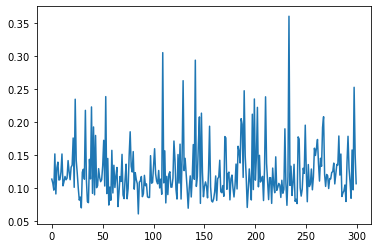

89195it [11:25, 141.52it/s]

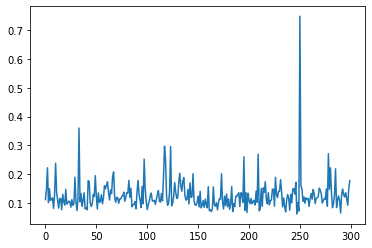

89389it [11:26, 141.43it/s]

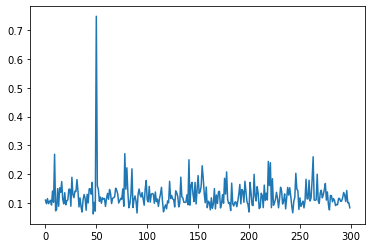

89594it [11:28, 137.43it/s]

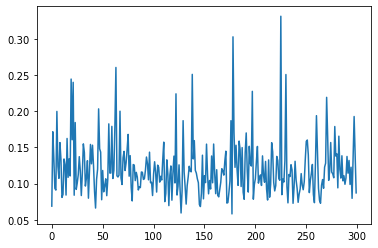

89788it [11:29, 141.75it/s]

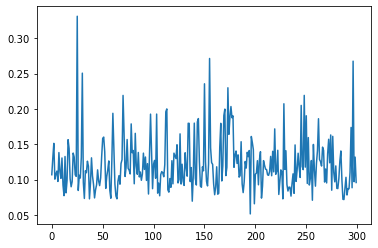

89998it [11:31, 141.35it/s]

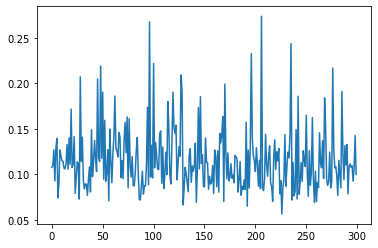

90193it [11:32, 133.13it/s]

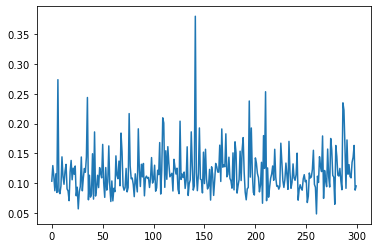

90389it [11:34, 134.04it/s]

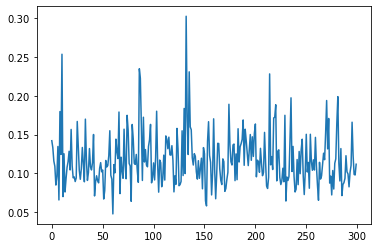

90589it [11:36, 121.08it/s]

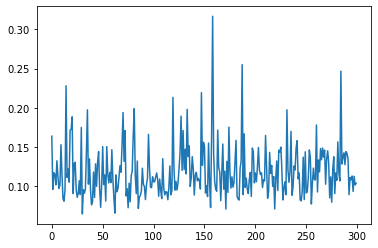

90800it [11:37, 136.80it/s]

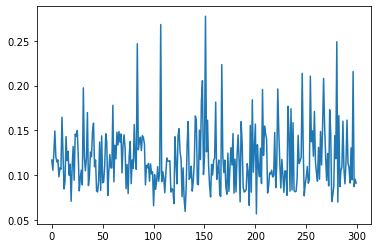

90993it [11:39, 141.16it/s]

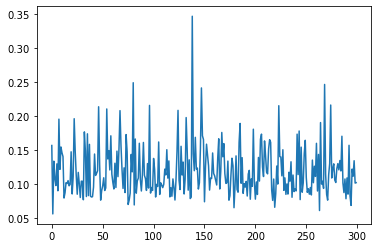

91187it [11:40, 140.64it/s]

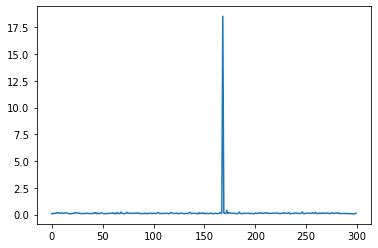

91389it [11:42, 136.11it/s]

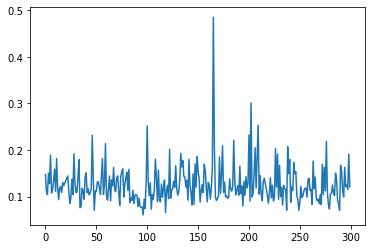

91593it [11:43, 137.89it/s]

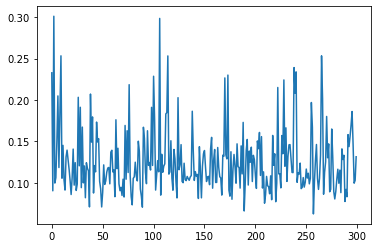

91800it [11:45, 138.24it/s]

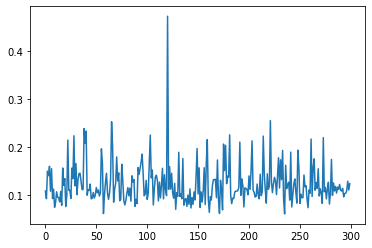

91987it [11:46, 134.25it/s]

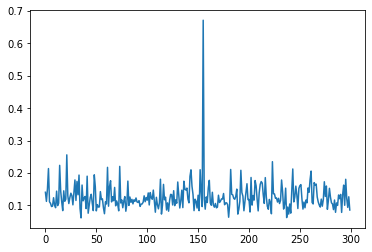

92191it [11:48, 134.90it/s]

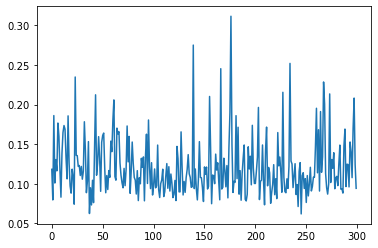

92394it [11:50, 139.33it/s]

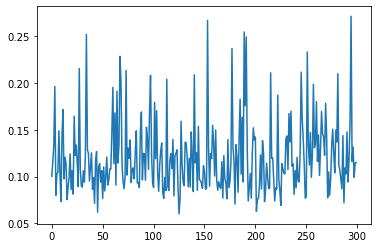

92599it [11:51, 140.36it/s]

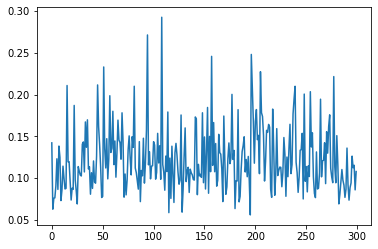

92790it [11:53, 137.42it/s]

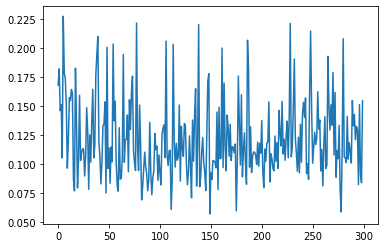

92996it [11:54, 141.03it/s]

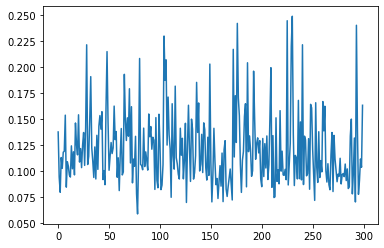

93191it [11:56, 140.31it/s]

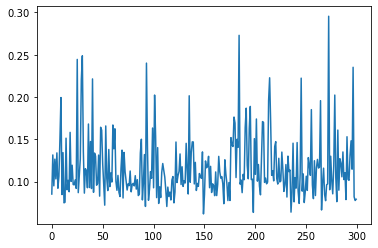

93386it [11:57, 141.61it/s]

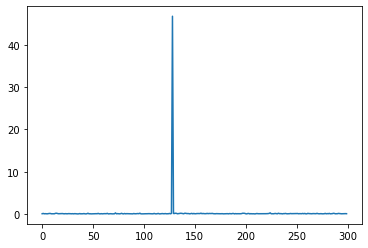

93594it [11:59, 143.13it/s]

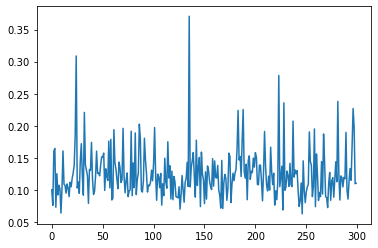

93789it [12:00, 141.72it/s]

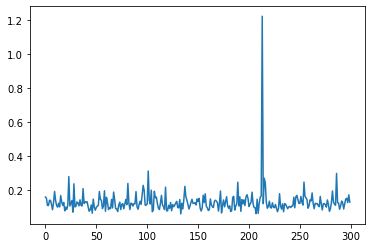

93998it [12:02, 141.85it/s]

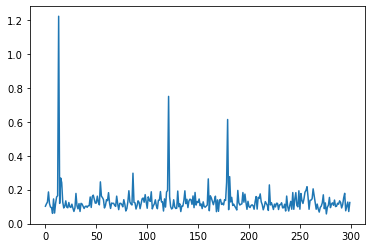

94193it [12:03, 141.67it/s]

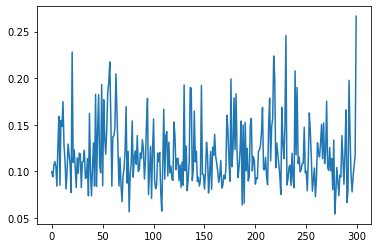

94388it [12:05, 141.75it/s]

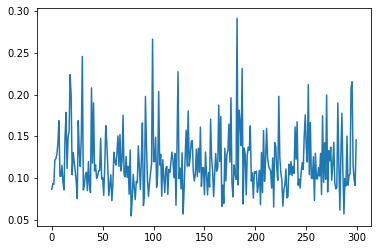

94598it [12:07, 142.62it/s]

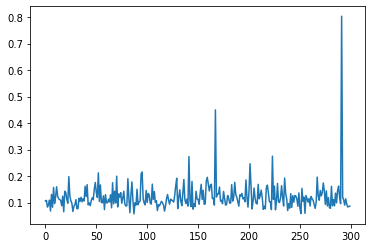

94793it [12:08, 141.11it/s]

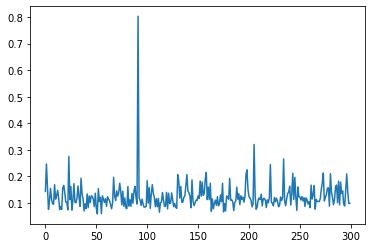

94988it [12:09, 141.90it/s]

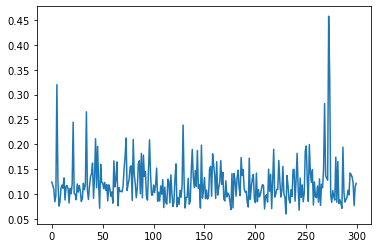

95168it [12:11, 130.05it/s]
0it [00:00, ?it/s]

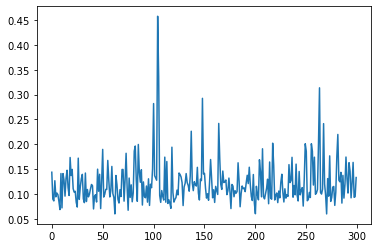

193it [00:05, 127.59it/s]

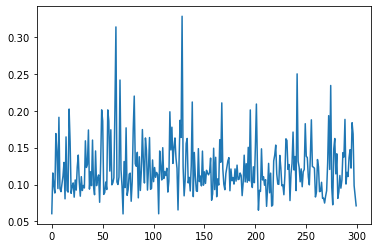

388it [00:06, 140.32it/s]

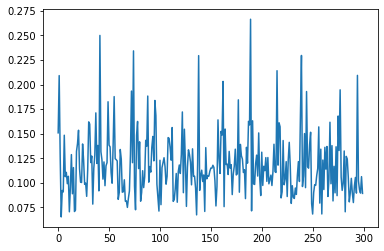

598it [00:08, 142.08it/s]

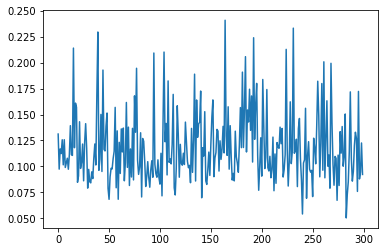

792it [00:09, 140.49it/s]

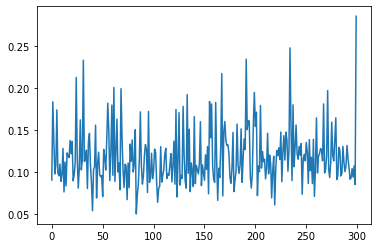

986it [00:11, 140.94it/s]

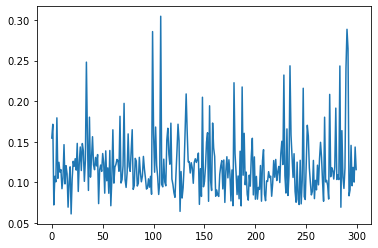

1195it [00:12, 141.42it/s]

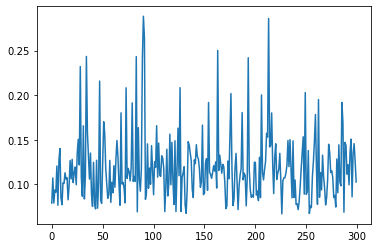

1388it [00:14, 141.86it/s]

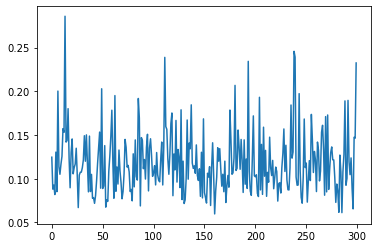

1598it [00:16, 141.58it/s]

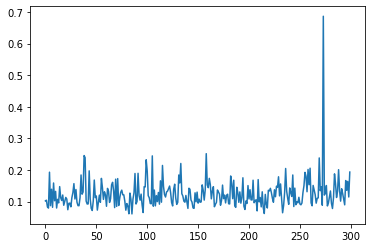

1793it [00:17, 141.52it/s]

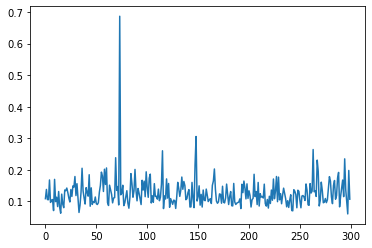

1987it [00:19, 141.24it/s]

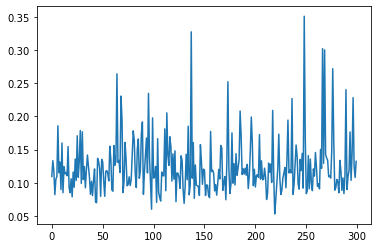

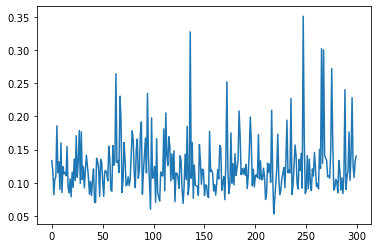

2197it [00:20, 141.87it/s]

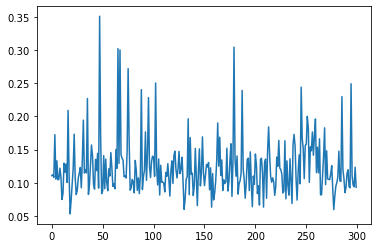

2390it [00:22, 141.46it/s]

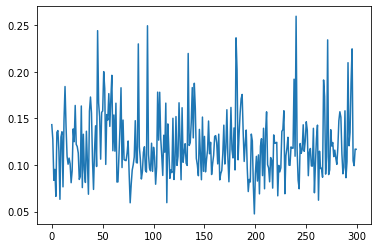

2600it [00:23, 142.14it/s]

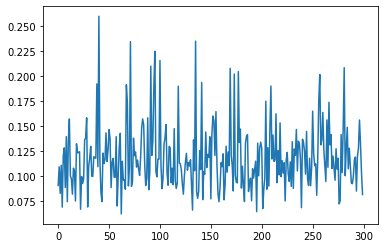

2794it [00:25, 142.64it/s]

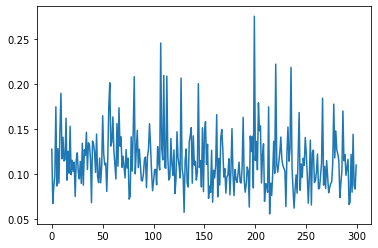

2988it [00:26, 142.18it/s]

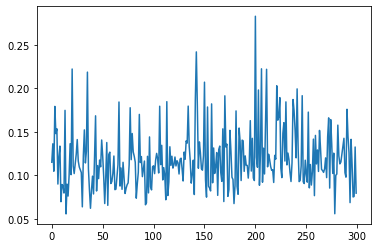

3197it [00:28, 142.73it/s]

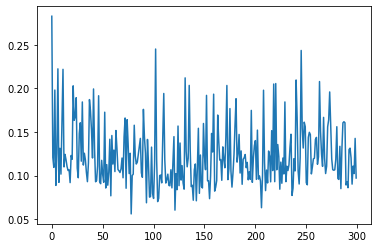

3392it [00:29, 142.17it/s]

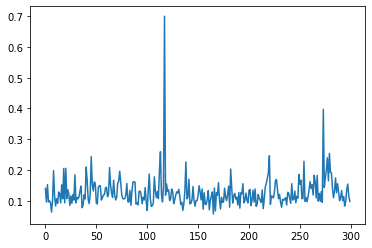

3600it [00:31, 142.88it/s]

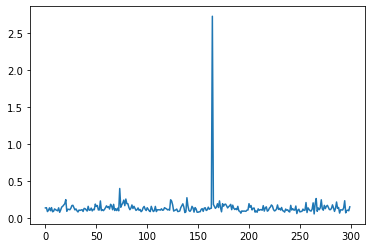

3795it [00:32, 142.07it/s]

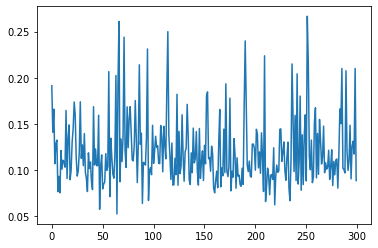

3988it [00:34, 143.05it/s]

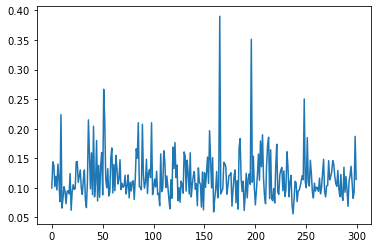

4197it [00:35, 140.58it/s]

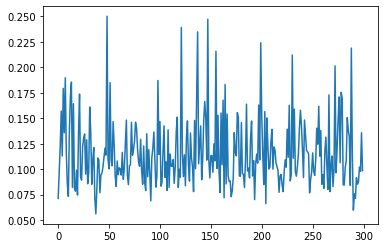

4391it [00:37, 142.52it/s]

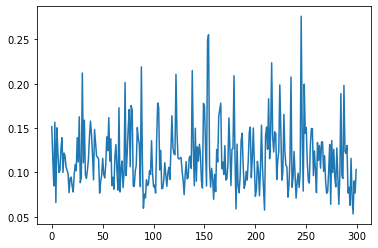

4586it [00:38, 141.94it/s]

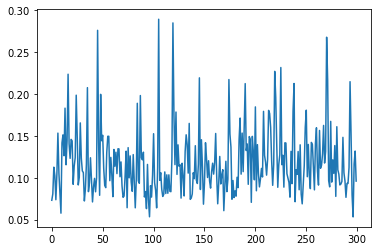

4795it [00:40, 142.22it/s]

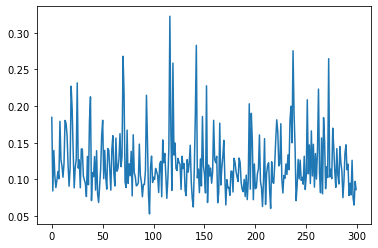

4990it [00:41, 142.56it/s]

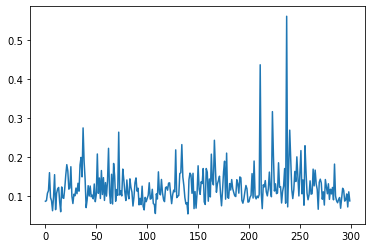

5199it [00:43, 142.76it/s]

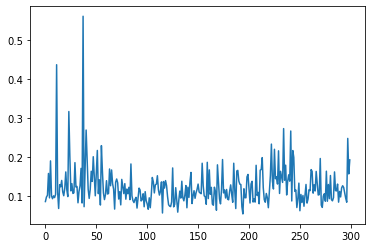

5394it [00:44, 142.61it/s]

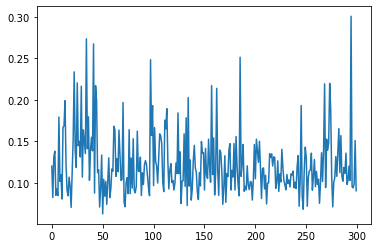

5587it [00:46, 142.45it/s]

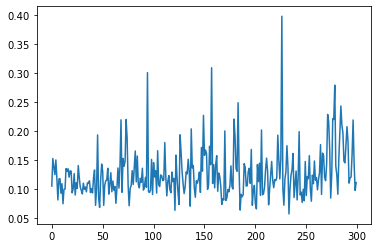

5794it [00:48, 141.42it/s]

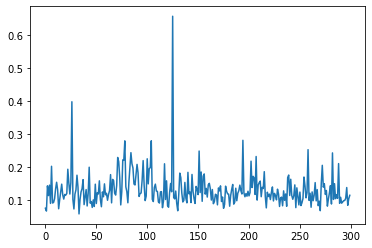

5996it [00:49, 139.22it/s]

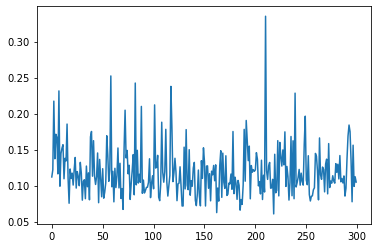

6192it [00:51, 136.88it/s]

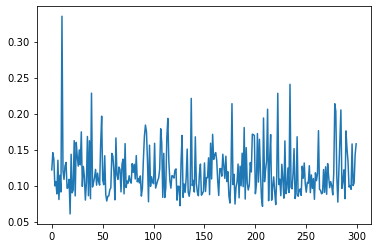

6396it [00:52, 139.36it/s]

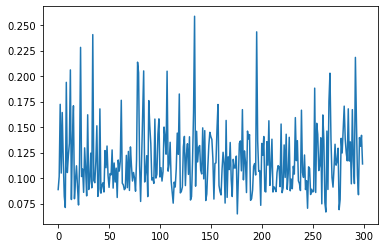

6599it [00:54, 137.03it/s]

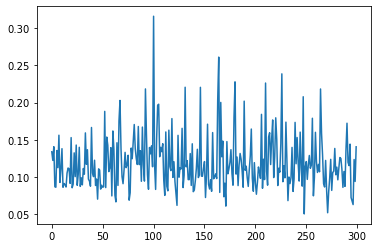

6789it [00:55, 138.82it/s]

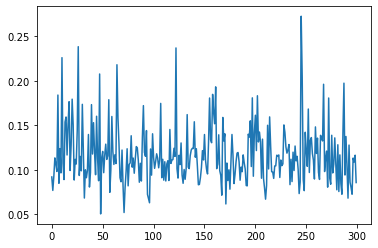

6996it [00:57, 141.17it/s]

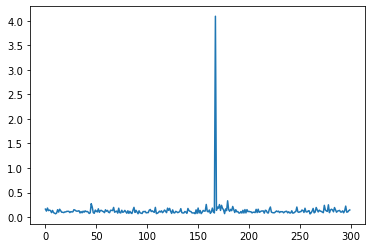

7200it [00:58, 137.59it/s]

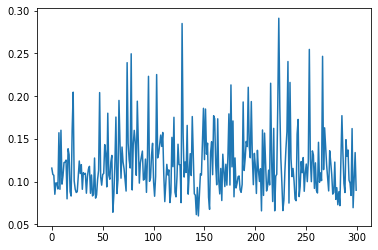

7392it [01:00, 128.23it/s]

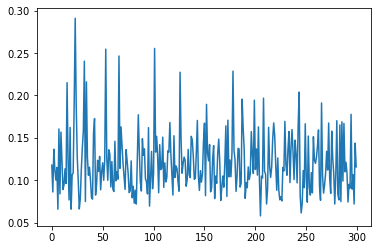

7599it [01:02, 128.46it/s]

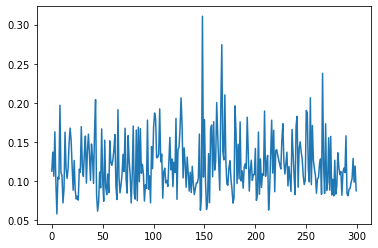

7795it [01:04, 129.18it/s]

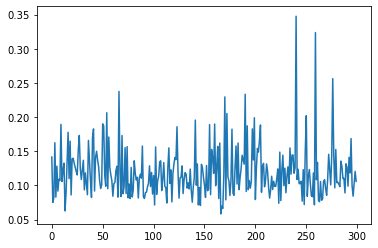

7986it [01:05, 141.00it/s]

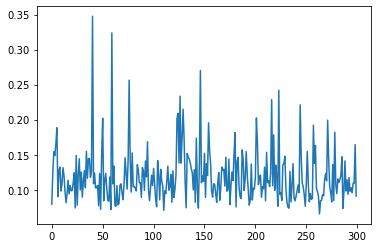

8187it [01:07, 133.82it/s]

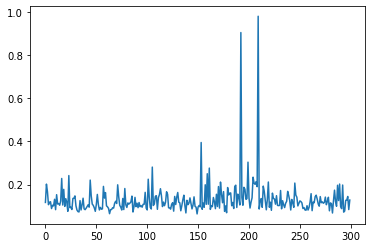

8388it [01:08, 140.29it/s]

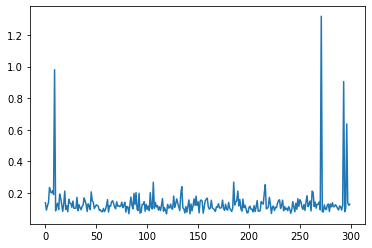

8590it [01:10, 140.31it/s]

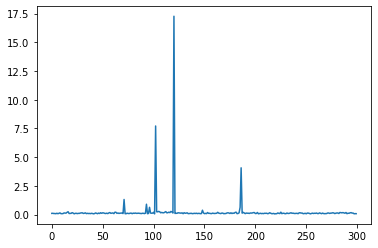

8791it [01:11, 135.36it/s]

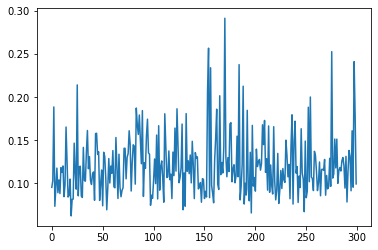

8987it [01:13, 137.63it/s]

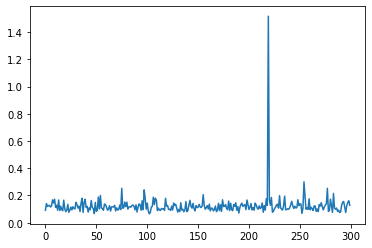

9195it [01:14, 141.87it/s]

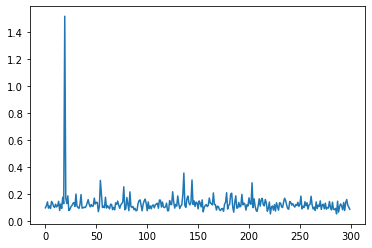

9386it [01:16, 139.00it/s]

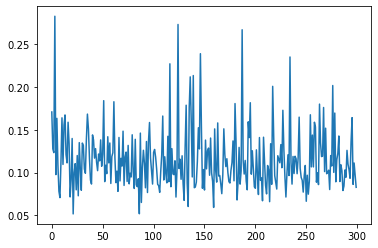

9596it [01:18, 141.30it/s]

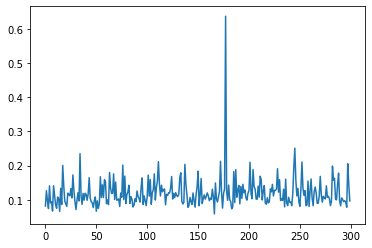

9795it [01:19, 135.03it/s]

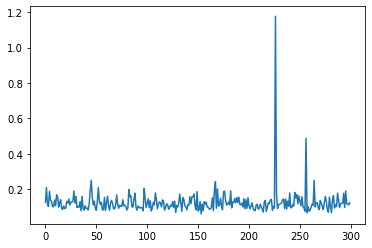

9997it [01:21, 140.62it/s]

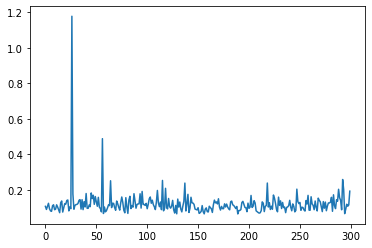

10196it [01:22, 136.16it/s]

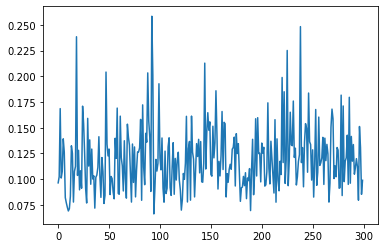

10397it [01:24, 138.14it/s]

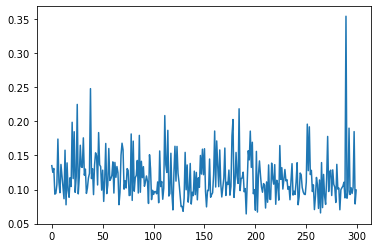

10588it [01:25, 139.58it/s]

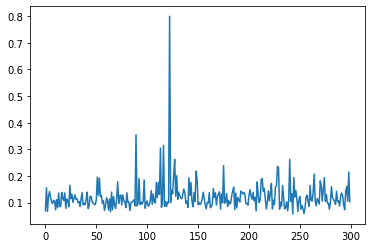

10797it [01:27, 137.74it/s]

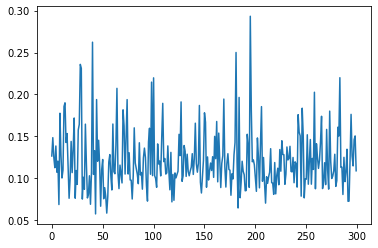

10993it [01:29, 136.60it/s]

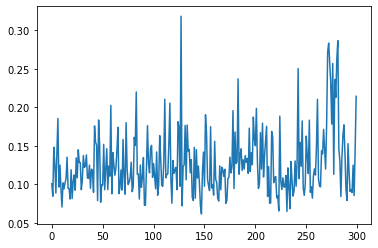

11200it [01:30, 141.66it/s]

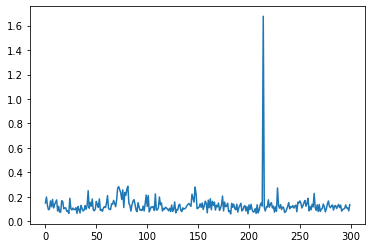

11392it [01:32, 140.54it/s]

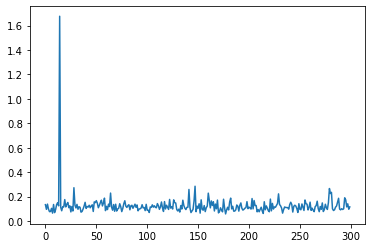

11600it [01:33, 140.88it/s]

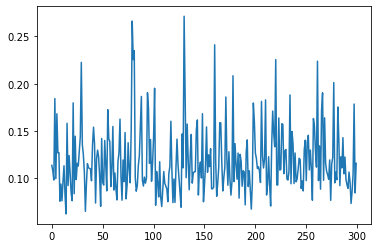

11787it [01:35, 136.56it/s]

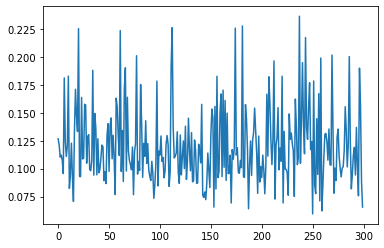

11992it [01:36, 141.54it/s]

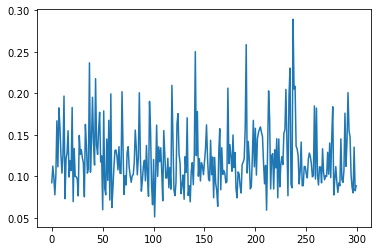

12196it [01:38, 136.06it/s]

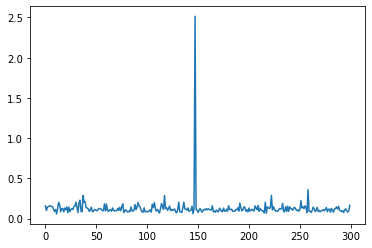

12387it [01:39, 131.48it/s]

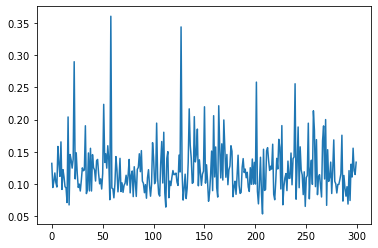

12598it [01:41, 134.43it/s]

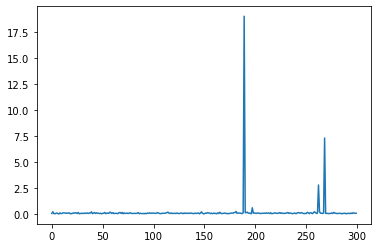

12788it [01:42, 139.06it/s]

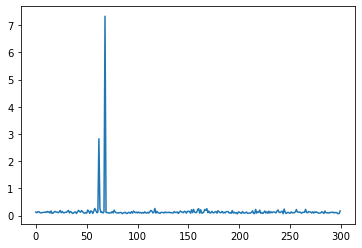

12995it [01:44, 140.85it/s]

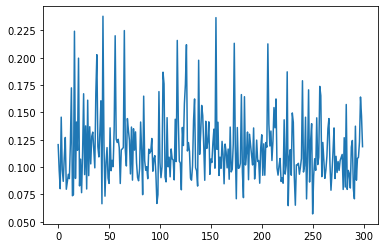

13189it [01:46, 139.57it/s]

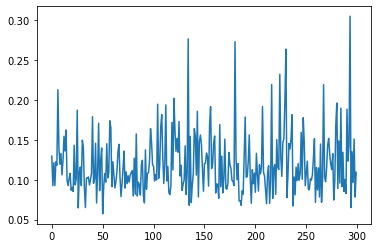

13396it [01:47, 140.47it/s]

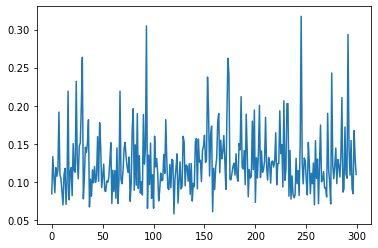

13590it [01:49, 140.58it/s]

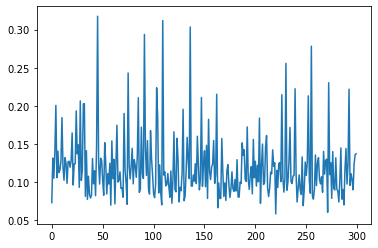

13796it [01:50, 140.75it/s]

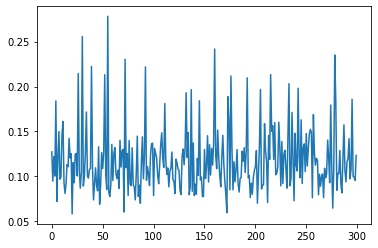

13987it [01:52, 139.58it/s]

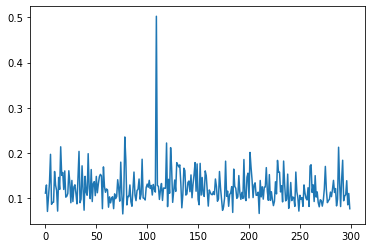

14191it [01:53, 141.19it/s]

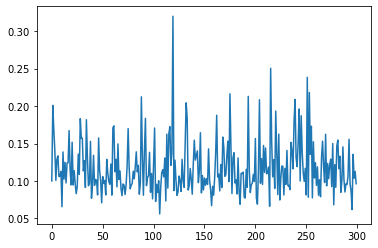

14398it [01:55, 137.27it/s]

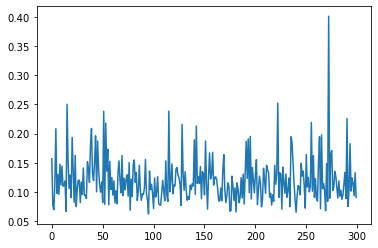

14597it [01:56, 139.09it/s]

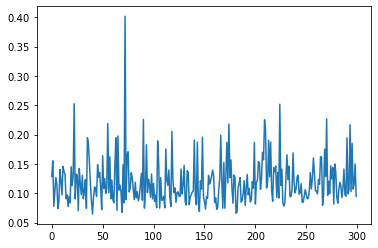

14798it [01:58, 136.44it/s]

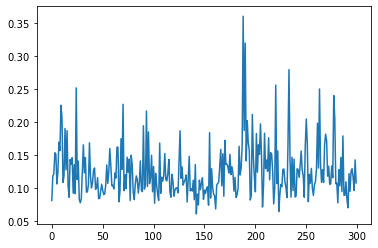

14988it [02:00, 138.46it/s]

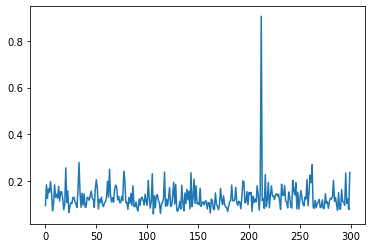

15197it [02:01, 138.82it/s]

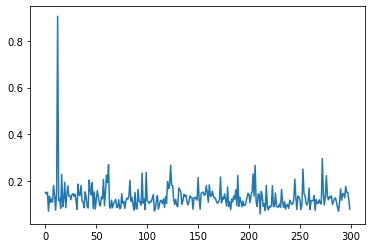

15389it [02:03, 139.71it/s]

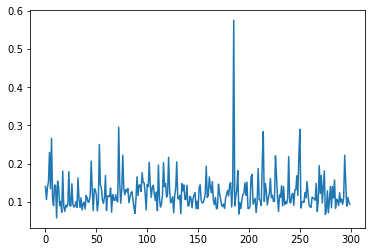

15591it [02:04, 140.14it/s]

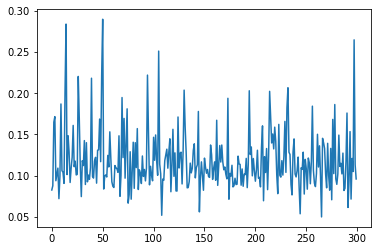

15795it [02:06, 139.47it/s]

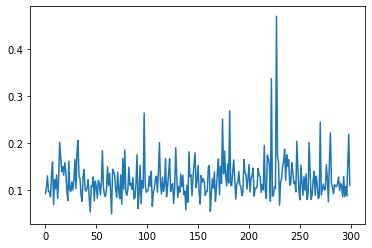

15997it [02:07, 137.56it/s]

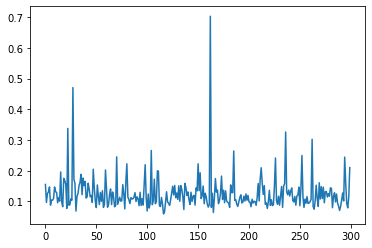

16188it [02:09, 140.79it/s]

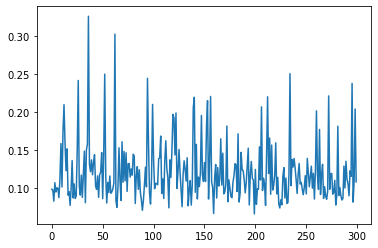

16391it [02:10, 138.63it/s]

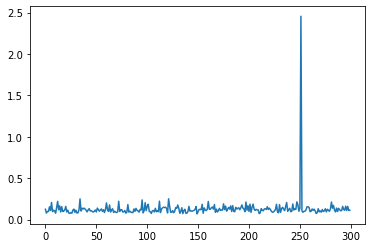

16593it [02:12, 139.81it/s]

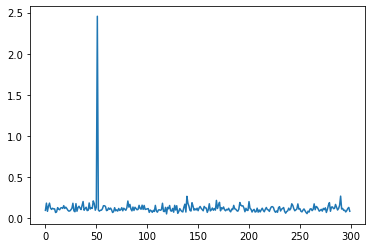

16794it [02:13, 139.22it/s]

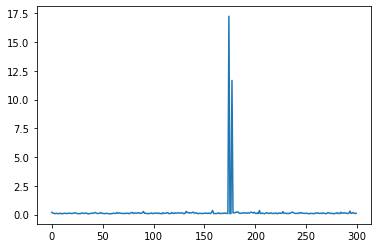

16994it [02:15, 136.66it/s]

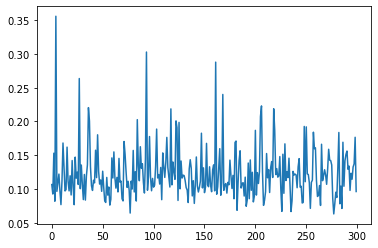

17194it [02:17, 137.32it/s]

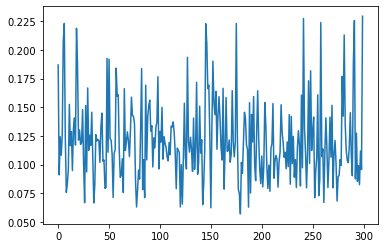

17280it [02:17, 125.44it/s]


KeyboardInterrupt: 

In [48]:
# iteration loop
nb_epochs = 2000 
batch_size = 512
losses = []

bestLoss = np.float("inf")
bestModel = None
for i in range(nb_epochs):

    for i, data in tqdm(enumerate(trainloader)):
        x_train_sub, y_train_sub = data
        x_train_sub = x_train_sub.cuda()
        y_train_sub = y_train_sub.cuda()
        pre = model(x_train_sub)

        # train on subset
        optimizer.zero_grad()

        # loss
        mse = mse_loss(pre, y_train_sub)
        kl = kl_loss(model)
        cost = mse + kl_weight*kl

        # train
        cost.backward()
        optimizer.step()

        # append loss
        lossVal = cost.detach().item()
        losses.append(lossVal)

        if (i % 200 == 0) | (i == nb_epochs-1):
            plt.plot(losses[-300:])
            plt.show()

        if lossVal < bestLoss:
            bestLoss = lossVal
            bestModel = copy.deepcopy(model)



C:\Users\eek31\AppData\Local\Continuum\anaconda3\envs\my-rdkit-env\lib\site-packages\ipykernel_launcher.py:6: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  
  0%|                                                                                         | 0/2000 [00:00<?, ?it/s]

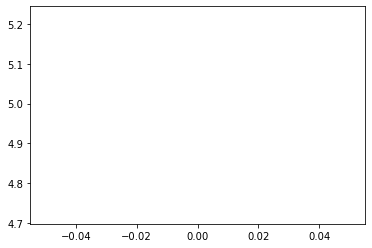

 10%|███████▉                                                                       | 200/2000 [00:24<03:14,  9.24it/s]

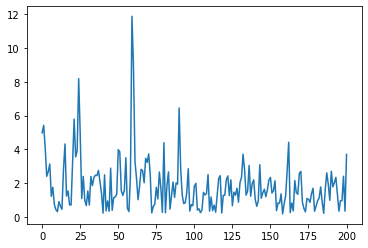

 20%|███████████████▊                                                               | 400/2000 [00:46<02:39, 10.04it/s]

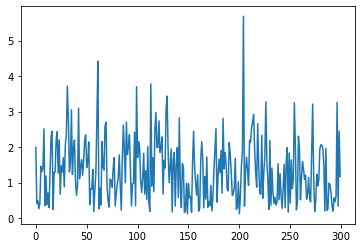

 30%|███████████████████████▋                                                       | 599/2000 [01:07<02:17, 10.15it/s]

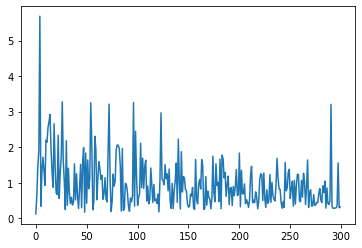

 40%|███████████████████████████████▌                                               | 800/2000 [01:27<02:04,  9.66it/s]

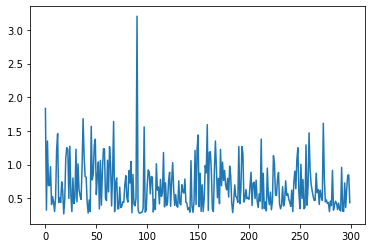

 50%|███████████████████████████████████████                                       | 1000/2000 [01:47<01:48,  9.18it/s]

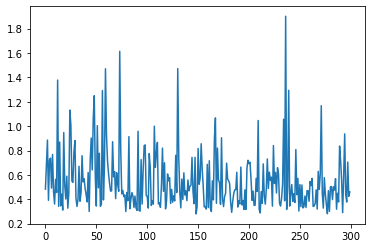

 60%|██████████████████████████████████████████████▊                               | 1200/2000 [02:08<01:20,  9.91it/s]

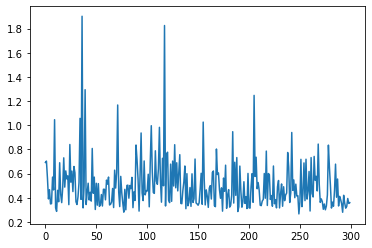

 70%|██████████████████████████████████████████████████████▌                       | 1400/2000 [02:28<00:56, 10.55it/s]

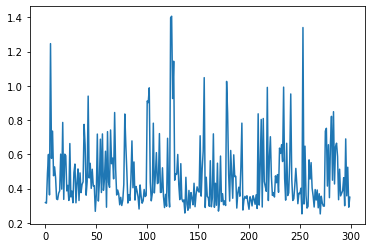

 80%|██████████████████████████████████████████████████████████████▎               | 1599/2000 [02:46<00:35, 11.14it/s]

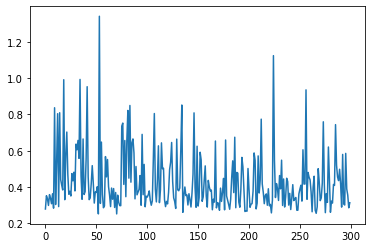

 90%|██████████████████████████████████████████████████████████████████████▏       | 1799/2000 [03:05<00:17, 11.50it/s]

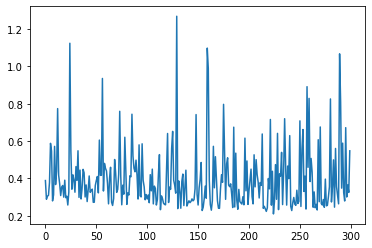

100%|█████████████████████████████████████████████████████████████████████████████▉| 1999/2000 [03:22<00:00, 11.72it/s]

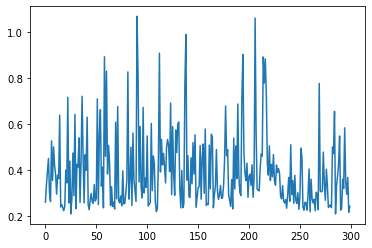

100%|██████████████████████████████████████████████████████████████████████████████| 2000/2000 [03:23<00:00,  9.84it/s]


In [16]:
# iteration loop
nb_epochs = 2000 
batch_size = 512
losses = []

bestLoss = np.float("inf")
bestModel = None
for i in tqdm(range(nb_epochs)):
    """ pick subgraphs """
    sub_idx = np.random.choice(np.arange(0, len(x_train)), size = batch_size, replace=True)
    x_train_sub, y_train_sub = x_train[sub_idx], y_train[sub_idx]
    train_data_size = x_train_sub.shape[0]

    # train on subset
    optimizer.zero_grad()

    # move to cuda
    x_train_sub = torch.Tensor(x_train_sub).cuda()
    y_train_sub = torch.Tensor(y_train_sub).cuda()

    # get out and loss
    pre = model(x_train_sub)

    # loss
    mse = mse_loss(pre, y_train_sub)
    kl = kl_loss(model)
    cost = mse + kl_weight*kl

    # train
    cost.backward()
    optimizer.step()
    
    # append loss
    lossVal = cost.detach().item()
    losses.append(lossVal)

    if (i % 200 == 0) | (i == nb_epochs-1):
        plt.plot(losses[-300:])
        plt.show()
        
    if lossVal < bestLoss:
        bestLoss = lossVal
        bestModel = copy.deepcopy(model)



In [17]:
# # try summing up losses per run
# nb_epochs = 10
# batch_size = 256
# losses = []

# bestLoss = np.float("inf")
# bestModel = None
# for i in tqdm(range(nb_epochs)):
#     """ pick subgraphs """
    
#     costs = None
#     for i in range(0, x_train.shape[0], batch_size):
#         count = 0
#         xinput = x_train[i:i+batch_size]
#         xinput = torch.from_numpy(xinput).type(torch.FloatTensor)
#         yinput = y_train[i:i+batch_size]

#         # move to cuda
#         x_train_sub = torch.Tensor(xinput).cuda()
#         y_train_sub = torch.Tensor(yinput).cuda()

#         # get out and loss
#         pre = model(x_train_sub)

#         # loss
#         mse = mse_loss(pre, y_train_sub)
#         kl = kl_loss(model)
#         cost = mse + kl_weight*kl

#         if costs is None:
#             costs = cost
#         else:
#             costs += cost

#         count += 1
            
#     # train
#     optimizer.zero_grad()
#     costs.backward()
#     optimizer.step()

#     # append loss
#     lossVal = costs.detach().item() / count
#     losses.append(lossVal)
    
#     plt.plot(losses)
#     plt.show()

# #     if (i % 200 == 0) | (i == nb_epochs-1):
# #         plt.plot(losses[-300:])
# #         plt.show()
        
#     if lossVal < bestLoss:
#         bestLoss = lossVal
#         bestModel = copy.deepcopy(model)


In [49]:
bestLoss

0.044215962290763855

In [50]:
pre = bestModel(x_train_sub)

# loss
mse = mse_loss(pre, y_train_sub)
kl = kl_loss(model)
cost = mse + kl_weight*kl

cost

tensor([0.0569], device='cuda:0', grad_fn=<AddBackward0>)

100%|█████████████████████████████████████████████████████████████████████████████| 5948/5948 [00:48<00:00, 122.17it/s]


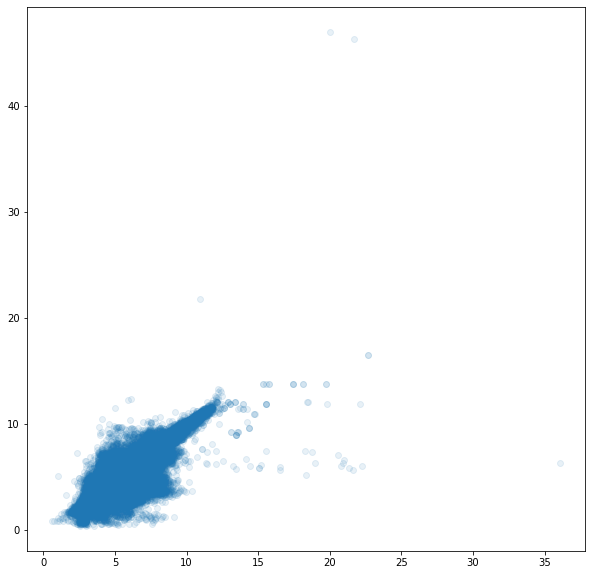

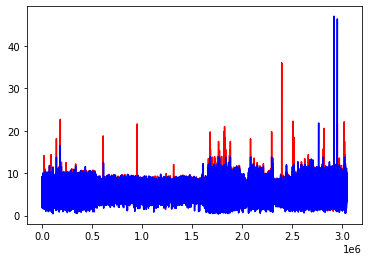

0.11377289146184921

In [51]:
"""
visualise regression output
"""

# get batch by batch
values = []
labels = []
for i in tqdm(range(0, x_train.shape[0], batch_size)):
    xinput = x_train[i:i+batch_size]
    xinput = torch.from_numpy(xinput).type(torch.FloatTensor).cuda()

    yinput = y_train[i:i+batch_size]

    preds = bestModel(xinput)
    values.extend(
        list(preds[:, 0].cpu().data.numpy())
    )

    labels.extend(
        list(yinput.flatten())
    )


# visualise
plt.figure(figsize=(10, 10))
plt.scatter(values, labels, alpha=0.1)
plt.show()

plt.plot(values, "r")
plt.plot(labels, "b")
plt.show()

"""
check error
"""
input_dict = {"y_true": torch.tensor(labels), "y_pred": torch.tensor(values)}
evaluator.eval(input_dict)["mae"]

In [55]:
torch.save(bestModel, os.path.join(args.checkpoint_dir, 'bnn-bbp-checkpoint.pt'))

## evaluate on test dataset

In [5]:
"""
Load BNNModel
"""
bestModel = torch.load(os.path.join(args.checkpoint_dir, 'bnn-bbp-checkpoint.pt'))
bestModel

Sequential(
  (0): BayesLinear(prior_mu=0, prior_sigma=0.1, in_features=600, out_features=100, bias=True)
  (1): ReLU()
  (2): BayesLinear(prior_mu=0, prior_sigma=0.1, in_features=100, out_features=100, bias=True)
  (3): ReLU()
  (4): BayesLinear(prior_mu=0, prior_sigma=0.1, in_features=100, out_features=100, bias=True)
  (5): ReLU()
  (6): BayesLinear(prior_mu=0, prior_sigma=0.1, in_features=100, out_features=1, bias=True)
)

In [6]:
"""
Load GNN Model
"""

device = torch.device("cuda:" + str(args.device)) if torch.cuda.is_available() else torch.device("cpu")

shared_params = {
    'num_layers': args.num_layers,
    'emb_dim': args.emb_dim,
    'drop_ratio': args.drop_ratio,
    'graph_pooling': args.graph_pooling
}


modelName = "gin-virtual"
gnn_type = "gin"
virtual_node = True
   
# load checkpoint data
filename = os.path.join(args.checkpoint_dir, "models", modelName, "checkpoint", 'checkpoint.pt')
checkpoint = torch.load(filename)

# load model
gnnmodel = GNN(gnn_type = gnn_type, virtual_node = virtual_node, **shared_params).to(device)
gnnmodel.load_state_dict(checkpoint["model_state_dict"])
# model.eval()    


<All keys matched successfully>

In [7]:
"""
Load Valid Datasets and extract graph embeddings
"""

def getGraphEmbedding(model, batch):
    with torch.no_grad():
        # get intermediate outputs
        h_node = model.gnn_node(batch)
        # GRAPH EMBEDDING
        h_graph = model.pool(h_node, batch.batch)
        # output
        output = model.graph_pred_linear(h_graph).view(-1)

    return h_graph, output

dataset = PygPCQM4MDataset(root = 'dataset/')
split_idx = dataset.get_idx_split()

# get loader dataset
valid_loader = DataLoader(dataset[split_idx["valid"]], batch_size=args.batch_size, shuffle=False, num_workers = args.num_workers)

"""
Get intermediate graph embeddings and visualise
"""
graphEmbeddingsList = []
y_true = []
y_pred = []
for step, batch in enumerate(tqdm(valid_loader, desc="Iteration")):

    # put batch to cuda
    batch = batch.to(device)

    # get embedding
    h_graph, pred = getGraphEmbedding(gnnmodel, batch)

    # collate prediction
    pred_np = pred.detach().cpu().numpy()
    y_pred.extend(pred_np)

    # collate graph embedding
    h_graph_np = h_graph.detach().cpu().numpy()
    graphEmbeddingsList.append(h_graph_np)

    # collate label
    label = batch.y.detach().cpu().numpy()
    y_true.extend(label)
    
    
"""
Combine Graph Embeddings
"""
Ndata = len(y_true)
dim = 600
graphEmbeddings = np.zeros((Ndata, dim))

Nval = 1487

# load separately as np.concatenate is too slow
for step in tqdm(range(Nval)):

    h_graph_np = graphEmbeddingsList[step]
    
    minVal = step*256
    maxVal = min((step+1)*256, Ndata)
    graphEmbeddings[minVal:maxVal, :] = h_graph_np
    
graphEmbeddings.shape

100%|█████████████████████████████████████████████████████████████████████████████| 1487/1487 [00:01<00:00, 888.55it/s]


(380670, 600)

100%|█████████████████████████████████████████████████████████████████████████████| 1487/1487 [00:02<00:00, 530.31it/s]


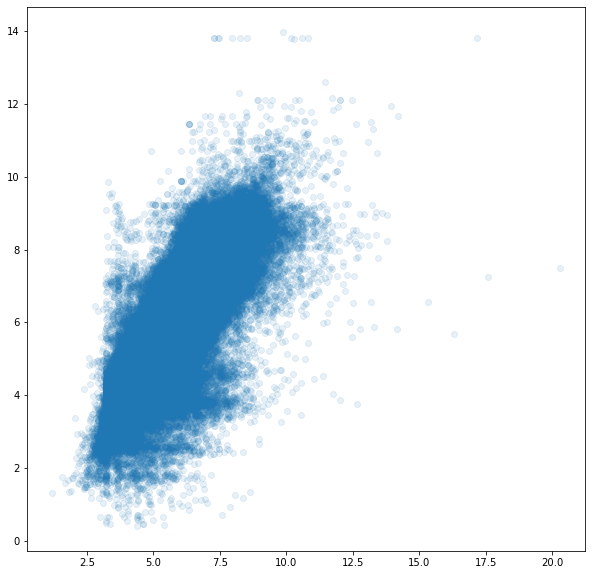

0.5099166631698608

In [8]:
"""
Evaluate
"""

# get x test
x_test = graphEmbeddings
y_test = y_true

# get evaluator
batch_size = 256
evaluator = PCQM4MEvaluator()

# evaluate per batch
values, noises, labels = [], [], []
# get batch by batch
for i in tqdm(range(0, x_test.shape[0], batch_size)):
    xinput = x_test[i:i+batch_size]
    xinput = torch.from_numpy(xinput).type(torch.FloatTensor).cuda()
    
    yinput = y_test[i:i+batch_size]
    
    preds = bestModel(xinput)
    values.extend(
        list(preds[:, 0].cpu().data.numpy())
    )
    labels.extend(
        yinput
    )
       
values = np.array(values)

# visualise

plt.figure(figsize=(10, 10))
plt.scatter(values, labels, alpha=0.1)
plt.show()

"""
check error
"""
input_dict = {"y_true": torch.tensor(labels), "y_pred": torch.tensor(values)}
evaluator.eval(input_dict)["mae"]

In [30]:
"""
run a few times to extract uncertainty
"""
valuesList = []

for _ in range(10):
    values = []
    # get batch by batch
    for i in tqdm(range(0, x_test.shape[0], batch_size)):
        xinput = x_test[i:i+batch_size]
        xinput = torch.from_numpy(xinput).type(torch.FloatTensor).cuda()

        yinput = y_test[i:i+batch_size]

        preds = bestModel(xinput)
        values.extend(
            list(preds[:, 0].cpu().data.numpy())
        )
        
    valuesList.append(values)
    
valuesList = np.array(valuesList)

100%|█████████████████████████████████████████████████████████████████████████████| 1487/1487 [00:01<00:00, 834.65it/s]


0.50974440574646


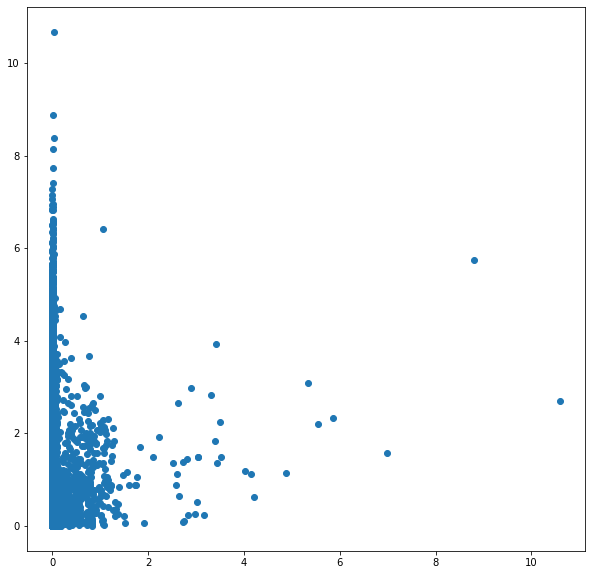

In [31]:
predmean = valuesList.mean(axis=0)
predstd = valuesList.std(axis=0)

"""
check error
"""
input_dict = {"y_true": torch.tensor(labels), "y_pred": torch.tensor(predmean)}
print(evaluator.eval(input_dict)["mae"])

errors = abs(predmean - labels)

plt.figure(figsize=(10, 10))
plt.scatter(predstd, errors)